In [33]:
import io
from IPython.display import Image
from IPython.display import SVG
import cairosvg
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
import seaborn as sns
from sklearn.linear_model import LinearRegression
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 10)
sns.set_context(context='talk', font_scale=1)

# Functions for each run

In [34]:
def plots(path):
    workers = Image(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/workers.png', width=1000, height=1000)
    accum_tasks = SVG(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/myplots.tasks-accum.svg')
    task_cap = SVG(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/myplots.tasks-capacities.svg')
    tasks = SVG(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/myplots.tasks.svg')
    time_man = SVG(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/myplots.time-manager.svg')
    time_work = SVG(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/myplots.time-workers.svg')
    time_stack = SVG(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/myplots.times-stacked.svg')
    transfer = SVG(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/myplots.transfer.svg')
    work_accum = SVG(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/myplots.workers-accum.svg')
    work_disk = SVG(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/myplots.workers-disk.svg')
    worker_svg = SVG(filename=f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/myplots.workers.svg')
    return workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg

In [35]:
def tables(path):
    tasks_t = pd.read_csv(f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/df_0_tasks.csv')
    transfers_t = pd.read_csv(f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/df_0_transfers.csv')
    workers_t = pd.read_csv(f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/df_0_workers.csv')

    with open(f'/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info/{path}/vine-logs/performance', 'r') as f:
        lines = f.readlines()
    lines[0] = lines[0][2:]  
    # join lines back to a string buffer and load with pandas
    data = ''.join(lines)
    performance = pd.read_csv(io.StringIO(data), sep=' ')
    
    col = workers_t.columns.get_loc('DISCONNECTION')
    workers_t.insert(col+1, 'Conn_time', np.nan)
    workers_t.loc[:, ('Conn_time')] = workers_t.loc[:, ('DISCONNECTION')] - workers_t.loc[:, ('CONNECTION')]

    col_p = performance.columns.get_loc('timestamp')
    performance.insert(col_p+1, 'lifetime', np.nan)
    performance.loc[:, ('lifetime')] = performance.loc[:, ('timestamp')] - performance.timestamp.min()

    '''transfers_t.columns = ['worker_id', 'hostport', 'time', 'direction', 'filetype', 'filename', 
                       'size', 'wall_time', 'start_time']'''

    col_t = transfers_t.columns.get_loc('wall_time')
    transfers_t.insert(col_t+1, 'size_per_time', np.nan)
    transfers_t.loc[:, ('size_per_time')] = (transfers_t.loc[:, ('size')]) /  (transfers_t.loc[:, ('wall_time')])
    
    return tasks_t, transfers_t, workers_t, performance

In [36]:
def print_properties(task_t, transfer_t, worker_t, performance_t):
    # total amount so it gets messed up with condor_rm trick
    print(f'Workers on this run = {len(worker_t)}')
    
    act_time = (worker_t.iloc[len(workers_t)-1]["DISCONNECTION"] - worker_t.iloc[0]["CONNECTION"])
    print(f'total workers active time = {act_time/60} mins, {act_time/3600} hours')

    print(f'Mean worker connection time = {(np.mean(worker_t.Conn_time))/60} mins, {(np.mean(worker_t.Conn_time))/3600} hours')
    print(f'# tasks on this run = {len(task_t)}')

In [37]:
def plot_worker_times(workers_t):
    fig1, ax1 = plt.subplots()
    ax1.scatter(workers_t.index, workers_t.Conn_time)
    ax1.set_yscale('log')
    ax1.set_xlabel('Worker')
    ax1.set_ylabel('Connection time')
    ax1.set_title('Worker Connection Time')
    worker_conn_time = fig1

    plt.show()

    return worker_conn_time

In [38]:
def transfer_time(transfers_t):
    transfer_cache = transfers_t[transfers_t.direction == 'CACHE_UPDATE']
    transfer_notcache = transfers_t[transfers_t.direction != 'CACHE_UPDATE']
    
    fig, ax = plt.subplots(1, 3, figsize=(20, 6), sharey=True)
    global_min = min(transfers_t.size_per_time.min(), transfer_cache.size_per_time.min(), transfer_notcache.size_per_time.min())
    global_max = max(transfers_t.size_per_time.max(), transfer_cache.size_per_time.max(), transfer_notcache.size_per_time.max())
    norm = colors.Normalize(vmin=global_min, vmax=global_max)
    
    im1 = ax[0].scatter(transfers_t.wall_time, transfers_t['size']/1000, marker='.', cmap='PuRd', c=np.log10(transfers_t.size_per_time), 
                        label='all transfers')
    ax[0].legend(loc='upper right')
    ax[0].set_xlabel('Wall time (s)')
    ax[0].set_ylabel('Size (GB)')
    
    im2 = ax[1].scatter(transfer_cache.wall_time, transfer_cache['size']/1000, marker='.', cmap='PuRd', 
                        c=np.log10(transfer_cache.size_per_time), label='cache update transfers')
    ax[1].legend(loc='upper right')
    ax[1].set_xlabel('Wall time (s)')
    
    im3 = ax[2].scatter(transfer_notcache.wall_time, transfer_notcache['size']/1000, marker='.', cmap='PuRd', 
                        c=np.log10(transfer_notcache.size_per_time), label='input & output transfers')
    ax[2].legend(loc='upper right')
    ax[2].set_xlabel('Wall time (s)')
    
    #fig.colorbar(im1, ax=ax.ravel().tolist(), orientation='vertical', shrink=1, label=r'log(slope/(GB/s))')
    fig.subplots_adjust(wspace=0.08, right=0.85)

    cbar_ax = fig.add_axes([0.86, 0.15, 0.02, 0.7])
    fig.colorbar(im1, cax=cbar_ax, label=r'log(slope/(MB/s))')
    transfer_time = fig
    plt.show()
   

    return transfer_time

In [97]:
def task_hist(task_t, performance, bin_min=0, bin_max=1000, bin_step=100):
    prepro = task_t[task_t.category == 'preprocessing']
    pro = task_t[task_t.category == 'processing']
    accum = task_t[task_t.category == 'accumulating']

    df = performance[performance.workers_busy == performance.workers_busy.max()]
    
    plateau = task_t[(task_t.time_worker_start >= (df.lifetime.min()/1e6)) & (task_t.time_worker_end  <= (df.lifetime.max()/1e6))]
    prepro_pl = plateau[plateau.category == 'preprocessing']
    pro_pl = plateau[plateau.category == 'processing']
    accum_pl = plateau[plateau.category == 'accumulating']

    vary = task_t[(task_t.time_worker_start < (df.lifetime.min()/1e6)) | (task_t.time_worker_end > (df.lifetime.max()/1e6))]
    prepro_vr = vary[vary.category == 'preprocessing']
    pro_vr = vary[vary.category == 'processing']
    accum_vr = vary[vary.category == 'accumulating']

    # actually plot
    fig, axs = plt.subplots(1, 3, figsize=(32, 8), sharey=True)
   # axs[0].hist(tasks_t.measured_wall_time, bins=np.arange(bin_min, bin_max, bin_step), alpha=0.5,
               # label=f'All tasks (n = {len(tasks_t)})')
    axs[0].hist(prepro.measured_wall_time, color='#006c67', bins=np.arange(bin_min, bin_max, bin_step), histtype='step', linewidth=2,
                label=f'Preprocessing tasks (n = {len(prepro)})')
    axs[0].hist(pro.measured_wall_time, color='#c76d7e', bins=np.arange(bin_min, bin_max, bin_step), histtype='step', linewidth=2,
                label=f'Processing tasks (n = {len(pro)})')
    axs[0].axvline(np.median(pro.measured_wall_time), color='#c76d7e', linestyle='--',
                   label=f'Processing median = {np.median(pro.measured_wall_time):.2f} s')
    #axs[0].axvline(np.percentile(pro.measured_wall_time, 25), color='#c76d7e', linestyle='--')
    #axs[0].axvline(np.percentile(pro.measured_wall_time, 75), color='#c76d7e', linestyle='--')
    axs[0].hist(accum.measured_wall_time, bins=np.arange(bin_min, bin_max, bin_step), histtype='step', linewidth=2,
                color='#34173a', label=f'Accumulation tasks (n = {len(accum)})')
    axs[0].set_title(rf'All tasks, $n_\mathrm{{workers}} \leq {performance.workers_busy.max()}$', fontsize=26)
    axs[0].legend(loc='upper right', fontsize=19)
   
   # axs[1].hist(plateau.measured_wall_time, bins=np.arange(bin_min, bin_max, bin_step), alpha=0.5,
              #  label=f'All tasks (n = {len(plateau)})')
    axs[1].hist(prepro_pl.measured_wall_time, color='#006c67', bins=np.arange(bin_min, bin_max, bin_step), histtype='step', linewidth=2,
                label=f'Preprocessing tasks (n = {len(prepro_pl)})')
    axs[1].hist(pro_pl.measured_wall_time, color='#c76d7e', bins=np.arange(bin_min, bin_max, bin_step), histtype='step', linewidth=2,
                label=f'Processing tasks (n = {len(pro_pl)})')
    axs[1].axvline(np.median(pro_pl.measured_wall_time), color='#c76d7e', linestyle='--',
                   label=f'Processing median = {np.median(pro_pl.measured_wall_time):.2f} s')
    #axs[1].axvline(np.percentile(pro_pl.measured_wall_time, 25), color='#c76d7e', linestyle='--')
    #axs[1].axvline(np.percentile(pro_pl.measured_wall_time, 75), color='#c76d7e', linestyle='--')
    axs[1].hist(accum_pl.measured_wall_time, bins=np.arange(bin_min, bin_max, bin_step), histtype='step', linewidth=2,
                color='#34173a', label=f'Accumulation tasks (n = {len(accum_pl)})')
    #axs[1].set_ylabel('Task count')
    axs[1].set_title(rf'$n_\mathrm{{workers}} = {performance.workers_busy.max()}$', fontsize=26)
    axs[1].legend(loc='upper right', fontsize=19)

    # subplot 3, varied worker #
   # axs[2].hist(vary.measured_wall_time, bins=np.arange(bin_min, bin_max, bin_step), alpha=0.5,
            #    label=f'All tasks (n = {len(vary)})')
    axs[2].hist(prepro_vr.measured_wall_time, color='#006c67', bins=np.arange(bin_min, bin_max, bin_step), histtype='step', linewidth=2,
                label=f'Preprocessing tasks (n = {len(prepro_vr)})')
    axs[2].hist(pro_vr.measured_wall_time, color='#c76d7e', bins=np.arange(bin_min, bin_max, bin_step), histtype='step', linewidth=2,
                label=f'Processing tasks (n = {len(pro_vr)})')
    axs[2].axvline(np.median(pro_vr.measured_wall_time), color='#c76d7e', linestyle='--',
                   label=f'Processing median = {np.median(pro_vr.measured_wall_time):.2f} s')
    #axs[2].axvline(np.percentile(pro_vr.measured_wall_time, 25), color='#c76d7e', linestyle='--')
    #axs[2].axvline(np.percentile(pro_vr.measured_wall_time, 75), color='#c76d7e', linestyle='--')
    axs[2].hist(accum_vr.measured_wall_time, bins=np.arange(bin_min, bin_max, bin_step), histtype='step', linewidth=2,
                color='#34173a', label=f'Accumulation tasks (n = {len(accum_vr)})')
    #axs[2].set_ylabel('Task count')
    axs[2].set_title(rf'$n_\mathrm{{workers}} < {performance.workers_busy.max()}$', fontsize=26)
    axs[2].legend(loc='upper right', fontsize=19)

    axs[0].set_ylabel('Task count', fontsize=24)
    for ax in axs:
        ax.tick_params(axis='both', which='major', labelsize=20)
        ax.tick_params(axis='both', which='minor', labelsize=20)
        ax.set_xlabel('Time to run task attempt (s)', fontsize=24)
        #ax.semilogy(())

    fig.subplots_adjust(wspace=0.05, right=0.85)
    plt.show()

    return fig
    

# Display Plots of each run

## Run 2025/07/30 163654

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* dataset = ../../input_samples/sample_jsons/signal_samples/private_UL/UL17_tHq_b1_NDSkim.json
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* got to final merger
* 48 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20post71

In [8]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-30T163654')

In [9]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-30T163654')

In [10]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 46
total workers active time = 3.963683764139811 mins, 0.06606139606899686 hours
Mean worker connection time = 2.990980608221413 mins, 0.04984967680369022 hours
# tasks on this run = 93


In [11]:
workers

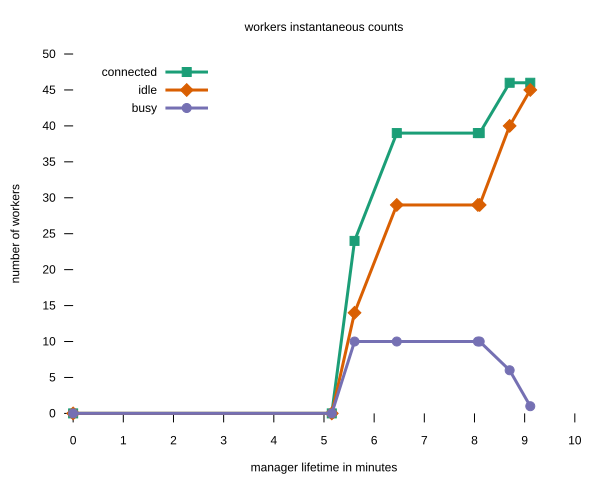

In [12]:
worker_svg

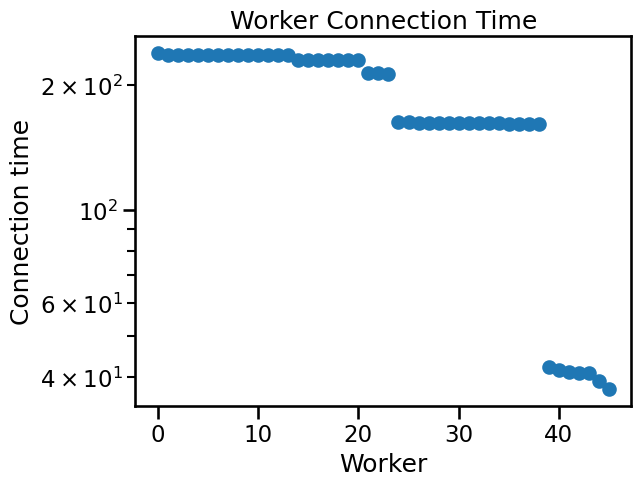

In [13]:
worker_conn_time = plot_worker_times(workers_t)

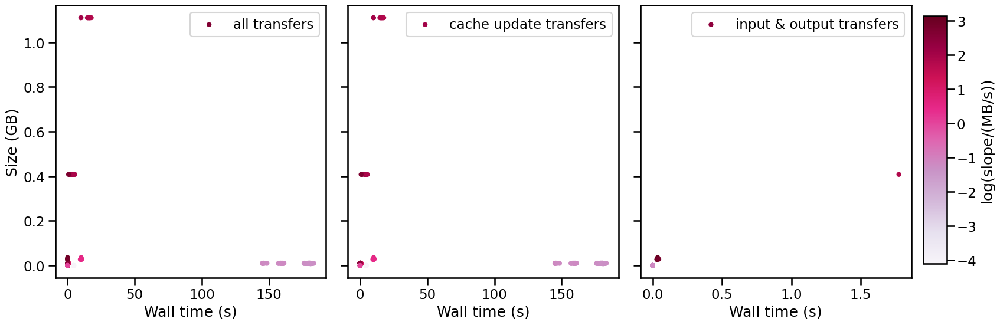

In [14]:
transfer_time_plot = transfer_time(transfers_t)

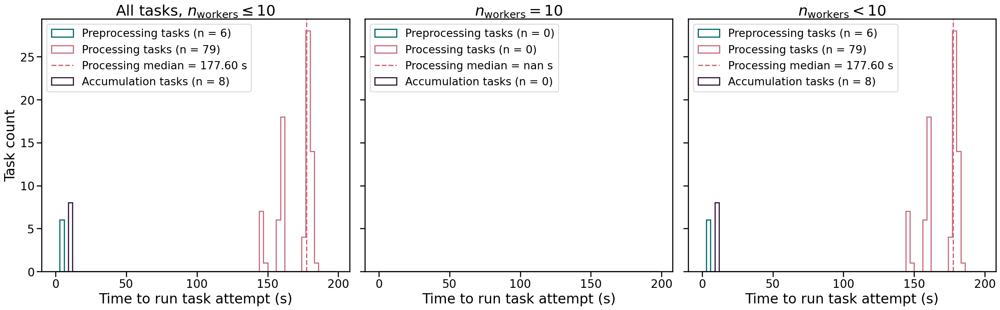

In [16]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 200, 3)

## Run 2025/07/23 145033

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 5 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20post71

In [8]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-23T145033')

In [9]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-23T145033')

In [10]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 6
total workers active time = 427.848012983799 mins, 7.13080021639665 hours
Mean worker connection time = 356.4845284395748 mins, 5.941408807326246 hours
# tasks on this run = 3646


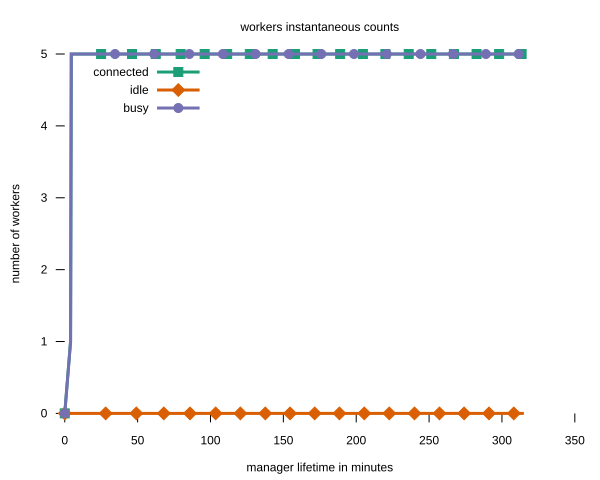

In [11]:
worker_svg

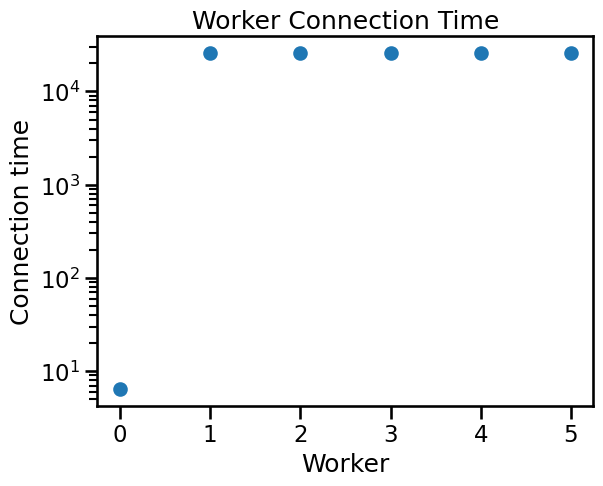

In [12]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


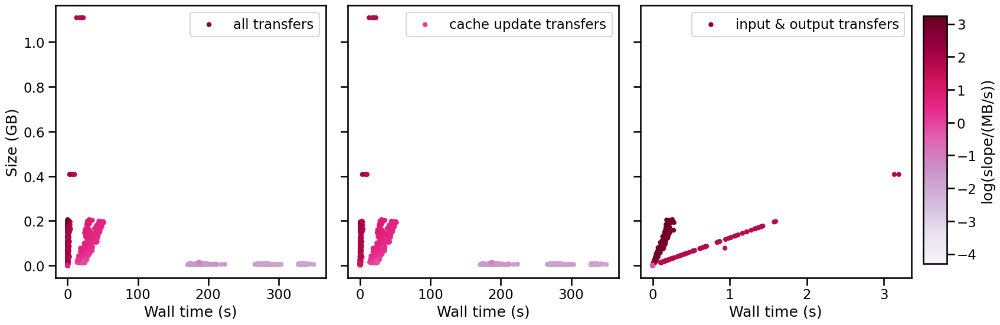

In [13]:
transfer_time_plot = transfer_time(transfers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


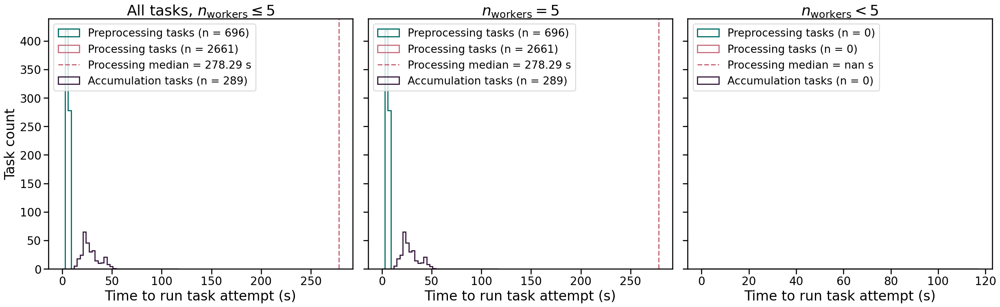

In [14]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 120, 3)

## Run 2025/07/23 041103

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 10 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20post71

In [540]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-23T041103')

In [541]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-23T041103')

In [17]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 13
total workers active time = 621.7552568991978 mins, 10.36258761498663 hours
Mean worker connection time = 478.139563476428 mins, 7.9689927246071335 hours
# tasks on this run = 5250


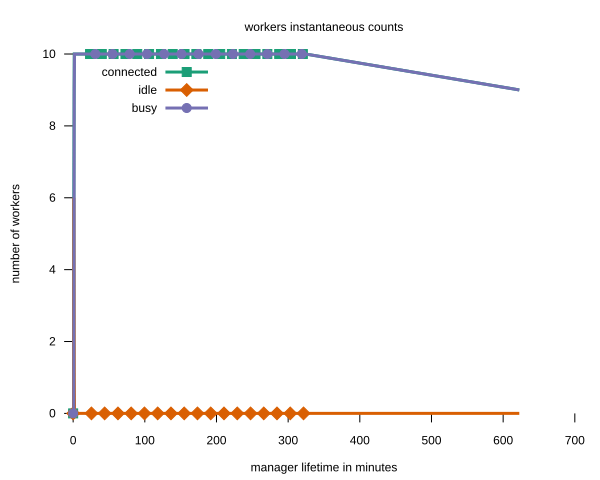

In [18]:
worker_svg

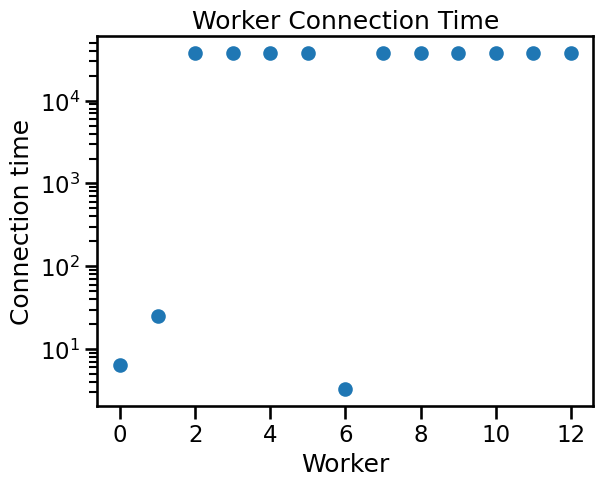

In [19]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


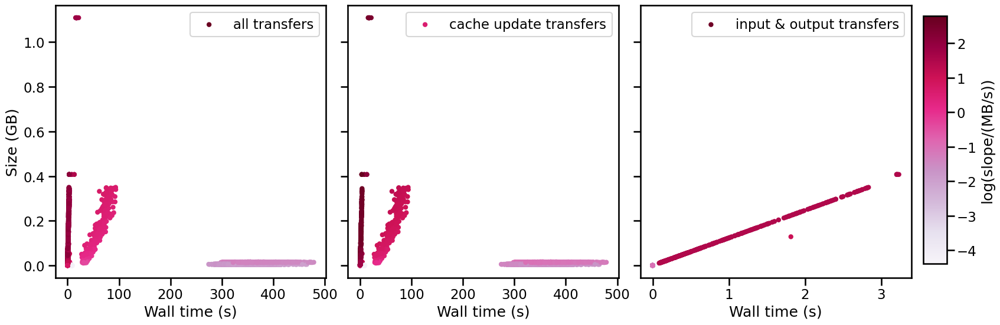

In [20]:
transfer_time_plot = transfer_time(transfers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


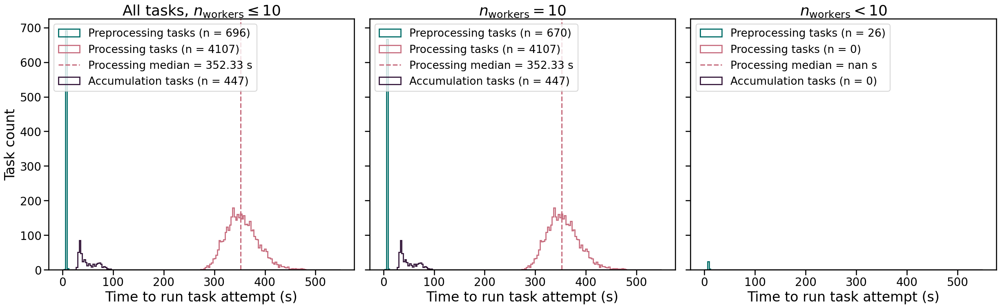

<Figure size 640x480 with 0 Axes>

In [542]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 550, 3)
#plt.savefig('task_time_25_fail.png', dpi=400)

## Run 2025/07/22 220059

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 15 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20post71

In [30]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-22T220059')

In [31]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-22T220059')

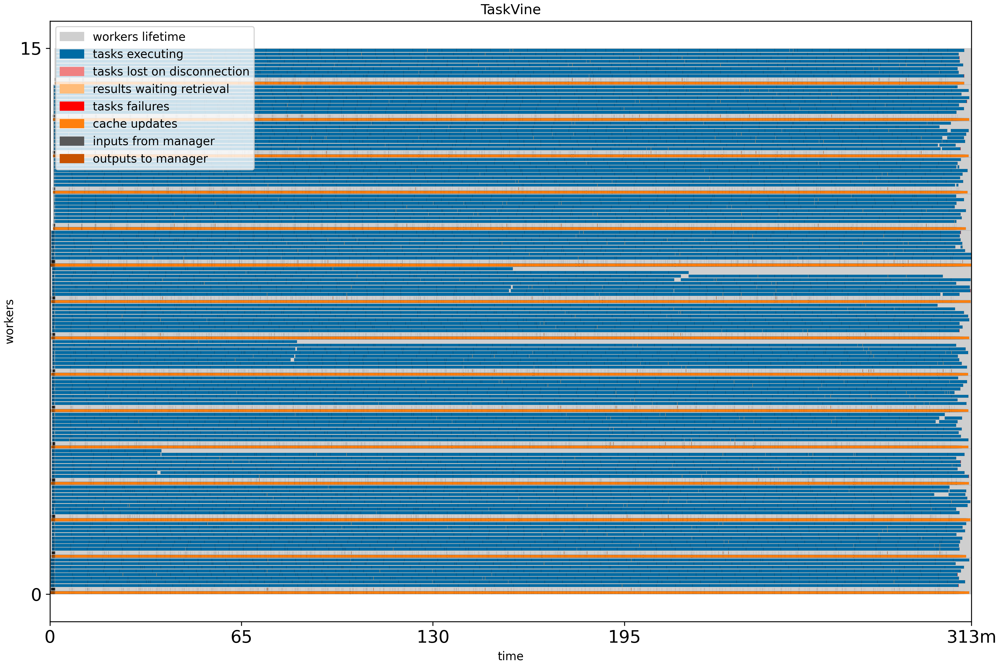

In [32]:
workers

In [24]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 16
total workers active time = 361.51270050207773 mins, 6.025211675034629 hours
Mean worker connection time = 338.5197277031839 mins, 5.641995461719731 hours
# tasks on this run = 7633


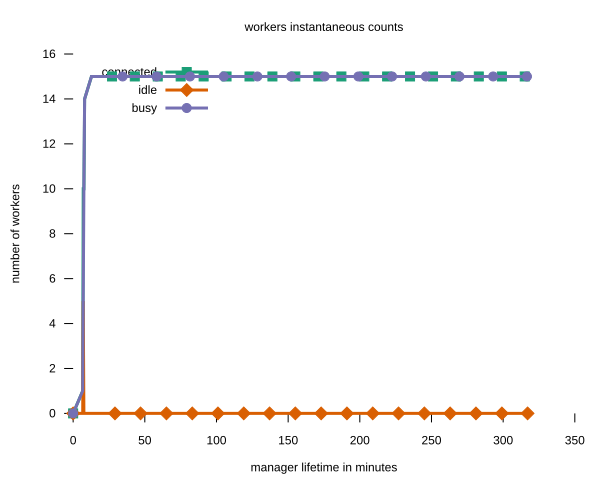

In [25]:
worker_svg

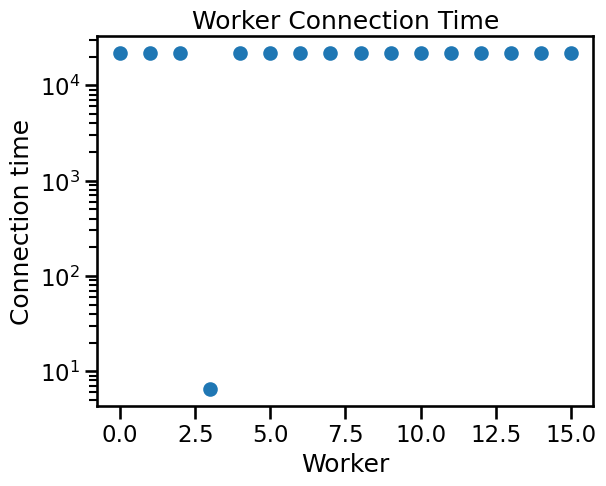

In [26]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


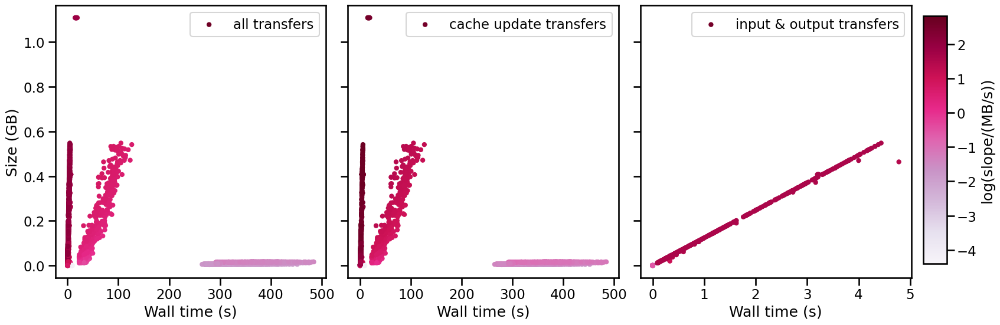

In [27]:
transfer_time_plot = transfer_time(transfers_t)

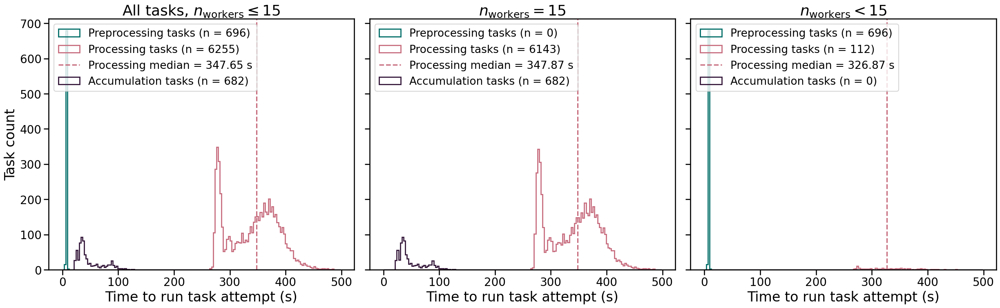

In [28]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 500, 3)

## Run 2025/07/22 201157

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 47 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20post71

In [29]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-22T201157')

In [30]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-22T201157')

In [31]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 53
total workers active time = 106.35998054742814 mins, 1.7726663424571356 hours
Mean worker connection time = 93.92852742821916 mins, 1.5654754571369858 hours
# tasks on this run = 9637


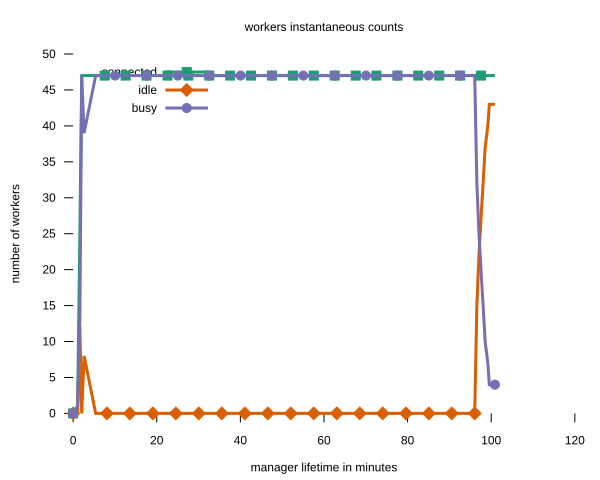

In [32]:
worker_svg

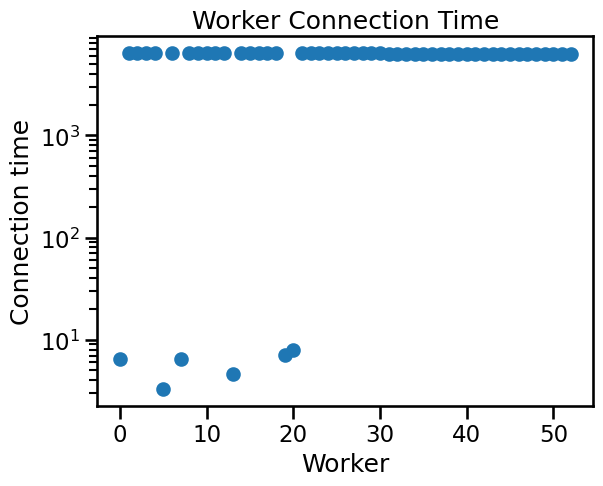

In [33]:
worker_conn_time = plot_worker_times(workers_t)

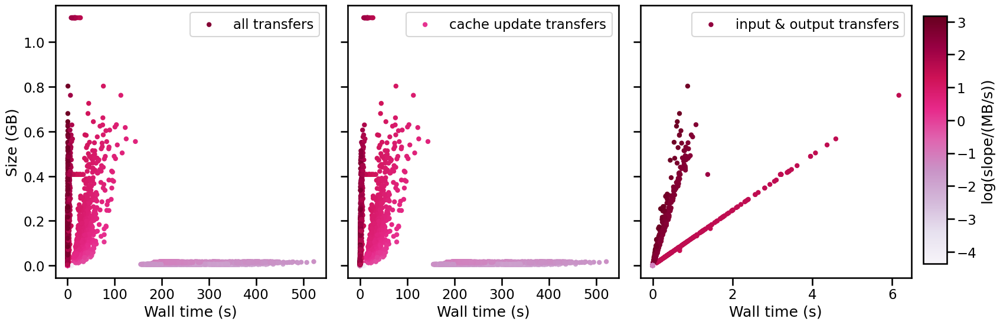

In [34]:
transfer_time_plot = transfer_time(transfers_t)

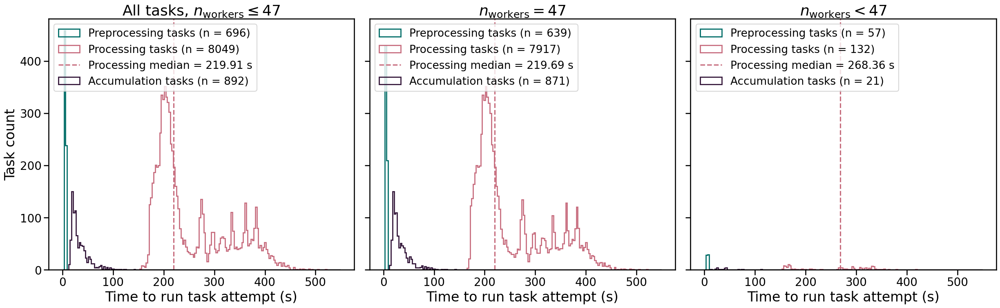

In [35]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 550, 3)

## Run 2025/07/22 165120

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 30 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20p

In [36]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-22T165120')

In [37]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-22T165120')

In [38]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 32
total workers active time = 167.3476719180743 mins, 2.7891278653012384 hours
Mean worker connection time = 156.5756985531499 mins, 2.6095949758858317 hours
# tasks on this run = 9637


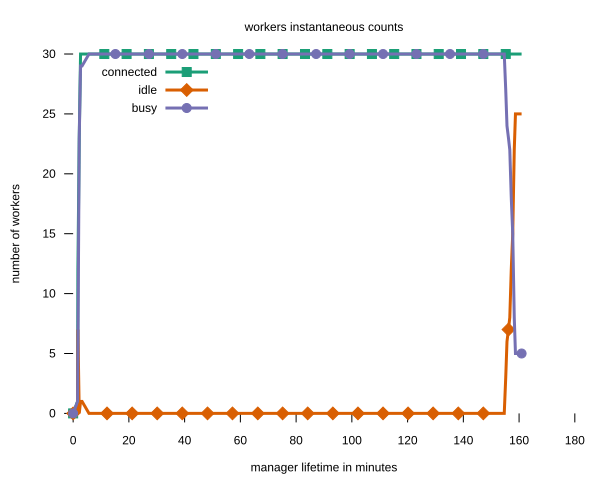

In [39]:
worker_svg

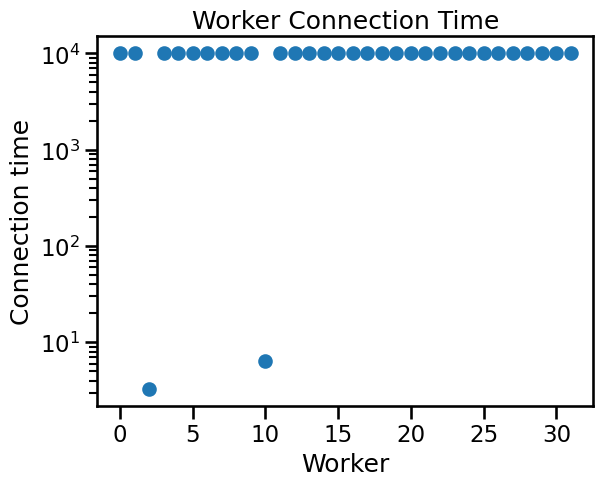

In [40]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


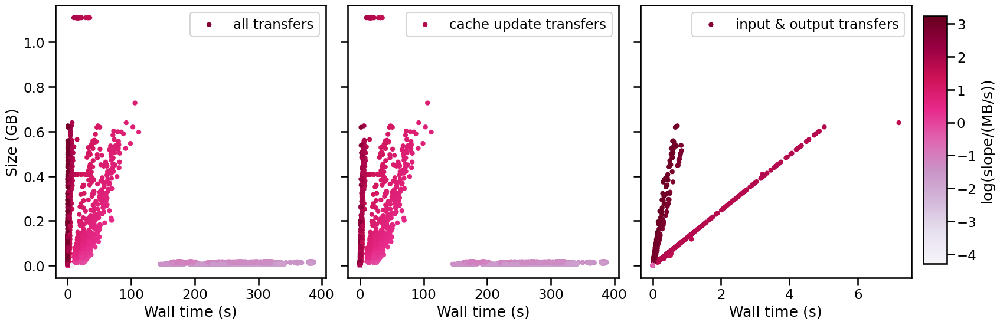

In [41]:
transfer_time_plot = transfer_time(transfers_t)

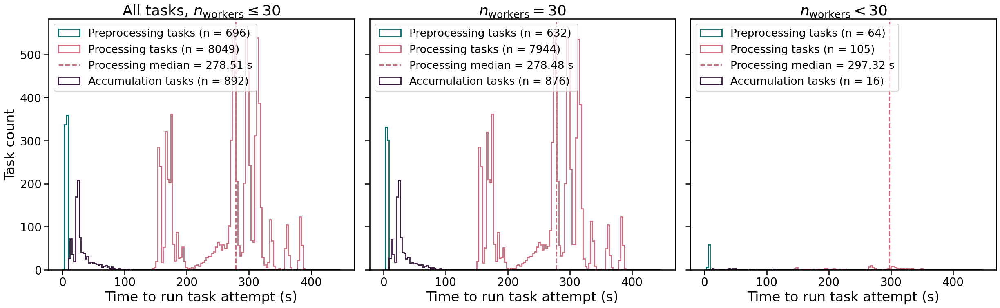

In [42]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 450, 3)

## Run 2025/07/22 142752

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 35 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20p

In [530]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-22T142752')

In [531]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-22T142752')

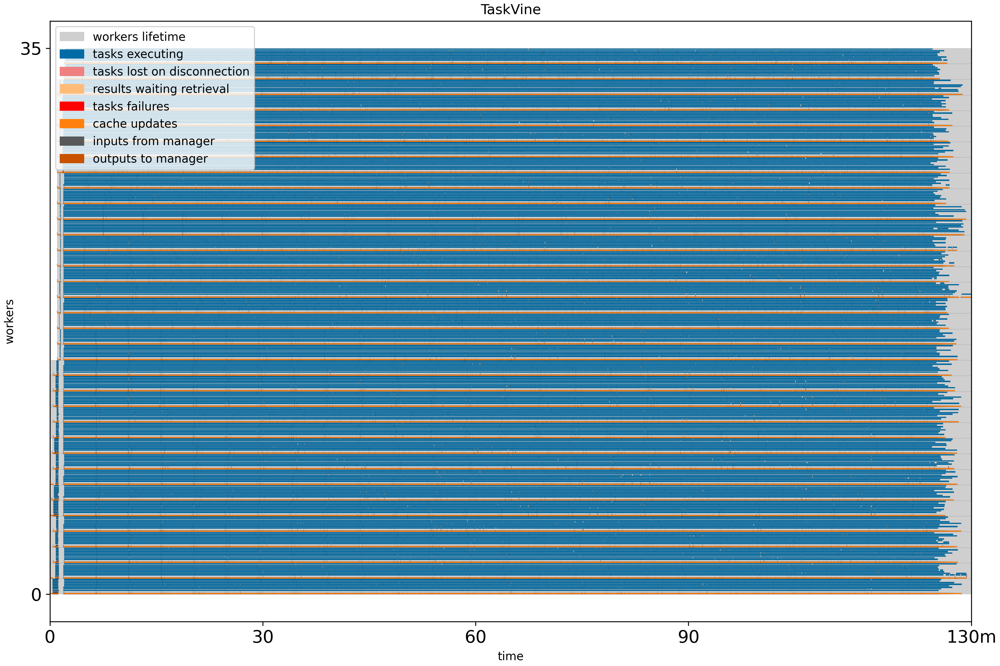

In [532]:
workers

In [45]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 37
total workers active time = 140.8010090470314 mins, 2.34668348411719 hours
Mean worker connection time = 132.55181320164655 mins, 2.209196886694109 hours
# tasks on this run = 9640


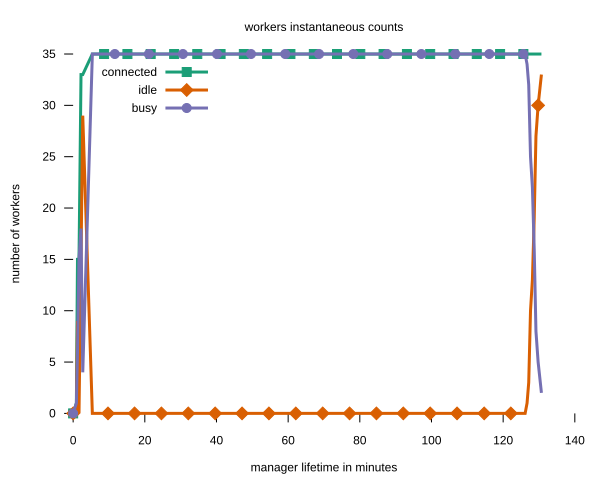

In [46]:
worker_svg

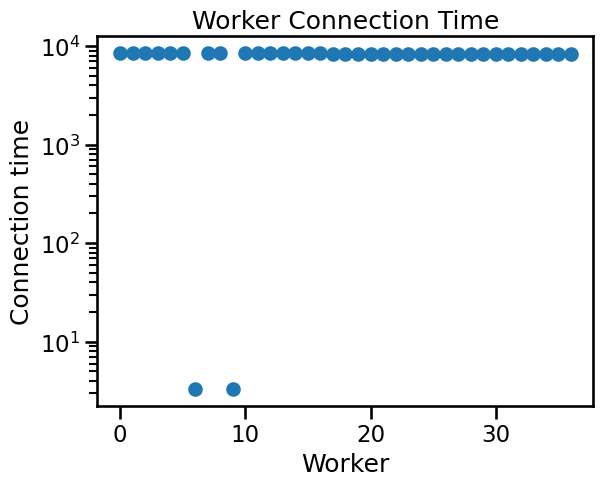

In [47]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


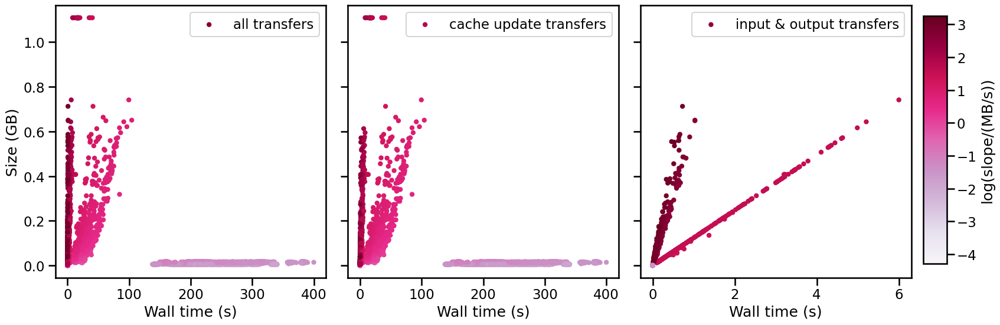

In [48]:
transfer_time_plot = transfer_time(transfers_t)

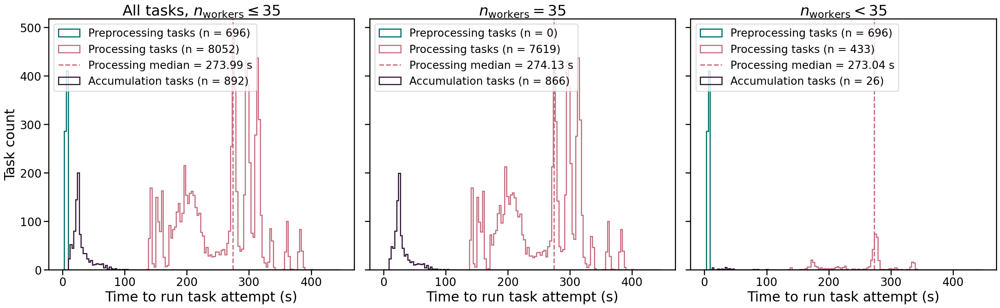

In [49]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 450, 3)

## Run 2025/07/22 081346

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 25 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* bad run
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20p

In [527]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-22T081346')

In [528]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-22T081346')

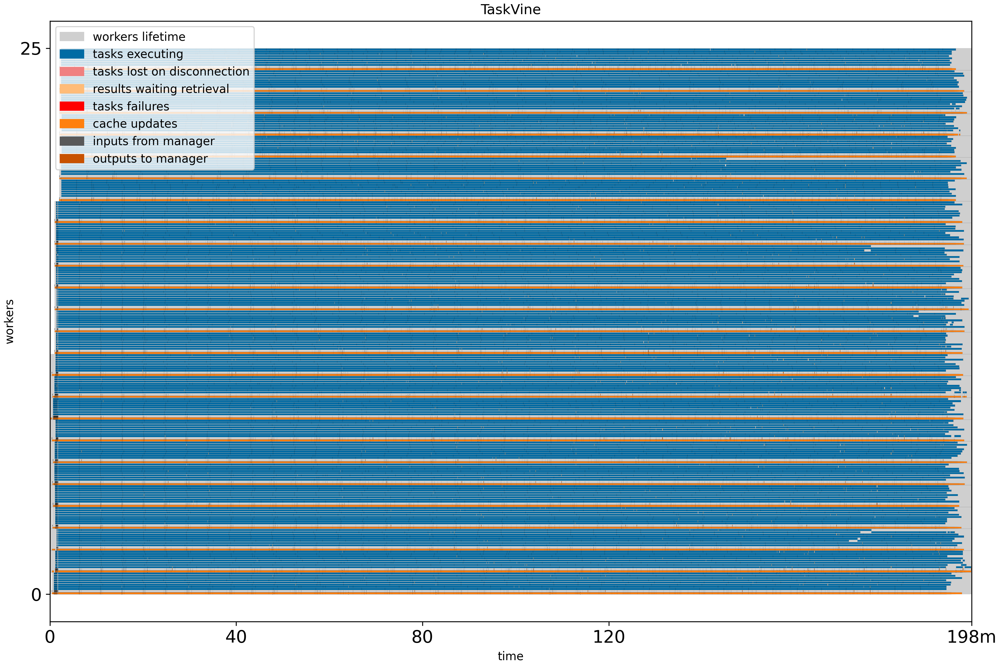

In [529]:
workers

In [52]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 30
total workers active time = 314.5788622816403 mins, 5.242981038027338 hours
Mean worker connection time = 282.4627909709348 mins, 4.707713182848913 hours
# tasks on this run = 9639


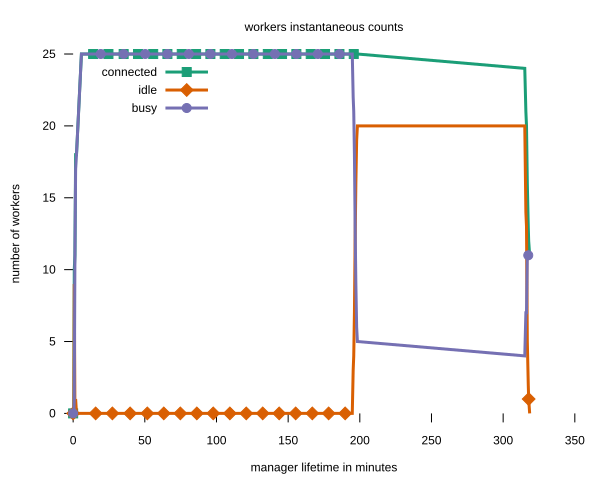

In [53]:
worker_svg

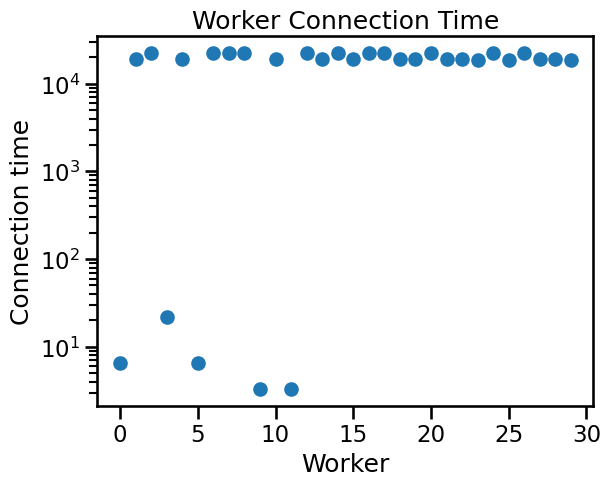

In [54]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


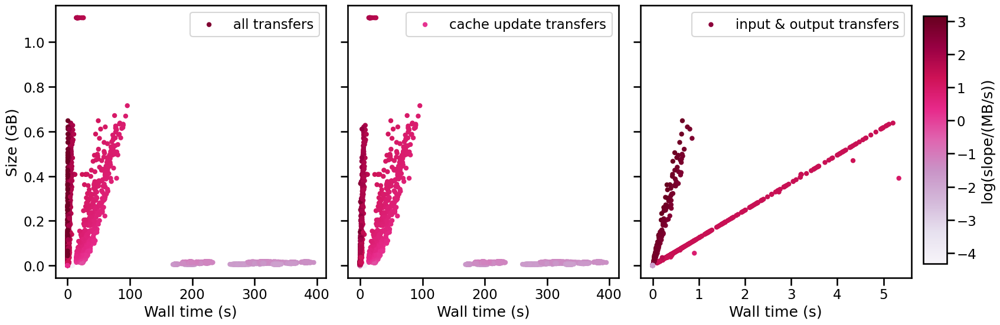

In [55]:
transfer_time_plot = transfer_time(transfers_t)

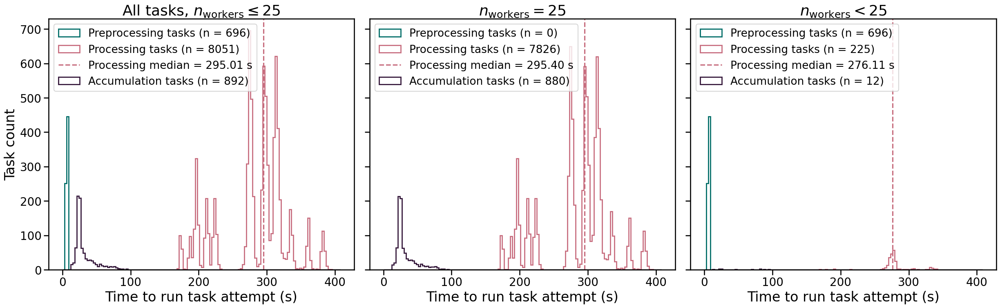

In [56]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 410, 3)

## Run 2025/07/22 040108 -- Chosen other single run

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 20 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* bad run
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20p

In [98]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-22T040108')

In [99]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-22T040108')

In [100]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 23
total workers active time = 250.45877426862717 mins, 4.1743129044771194 hours
Mean worker connection time = 216.70734402476876 mins, 3.611789067079479 hours
# tasks on this run = 9640


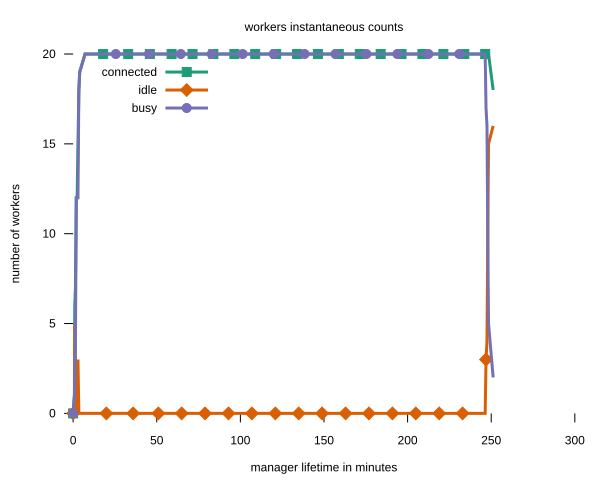

In [101]:
worker_svg

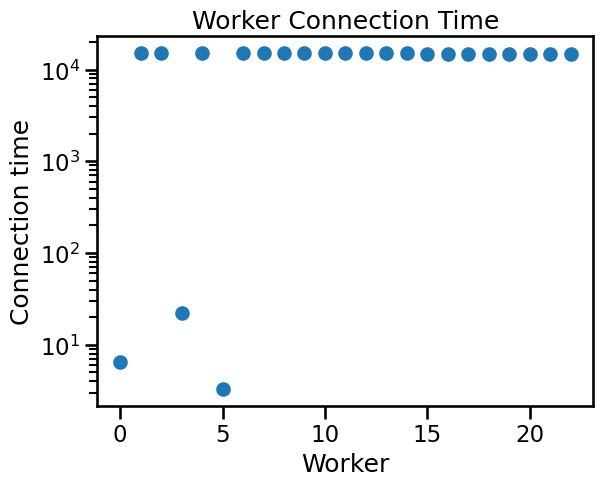

In [102]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


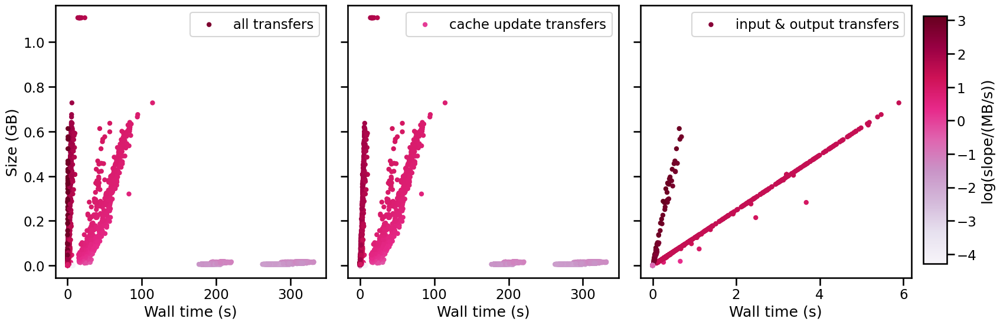

In [103]:
transfer_time_plot = transfer_time(transfers_t)
transfer_time_plot.savefig('poster_figs/transfer_time_25.png', dpi=400)

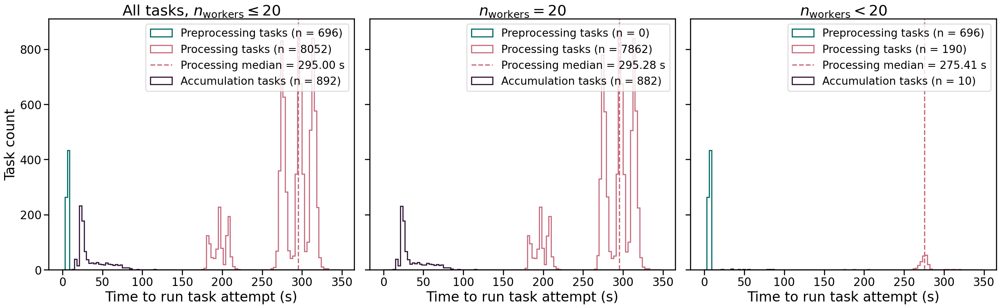

In [104]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 350, 3)
#task_time_hist.savefig('poster_figs/task_time_hist_25.png', dpi=400)

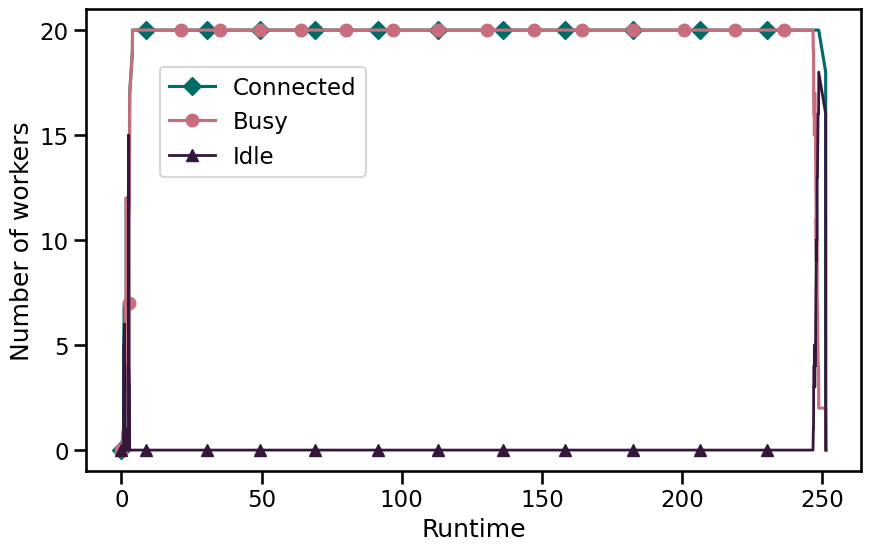

In [525]:
plt.figure(figsize=(10,6))

plt.plot(performance_t.lifetime/6e7, performance_t.workers_connected, marker='D', label="Connected", markevery=800, color='#006c67')
plt.plot(performance_t.lifetime/6e7, performance_t.workers_busy, marker='o', label="Busy", markevery=600, color='#c76d7e')
plt.plot(performance_t.lifetime/6e7, performance_t.workers_idle, marker='^', label="Idle", markevery=800, color='#34173a', linewidth=2)
plt.yticks(np.arange(0, 21, 5))
plt.legend(bbox_to_anchor=(0.08, 0.9), loc='upper left')
plt.xlabel("Runtime")
plt.ylabel("Number of workers")
#plt.savefig('poster_figs/worker_conn_25.png', dpi=400)

## Run 2025/07/22 022121

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 60 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* bad run
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20p

In [65]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-22T022121')

In [66]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-22T022121')

In [67]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 66
total workers active time = 96.87356934944789 mins, 1.6145594891574648 hours
Mean worker connection time = 87.58518132994872 mins, 1.4597530221658122 hours
# tasks on this run = 9638


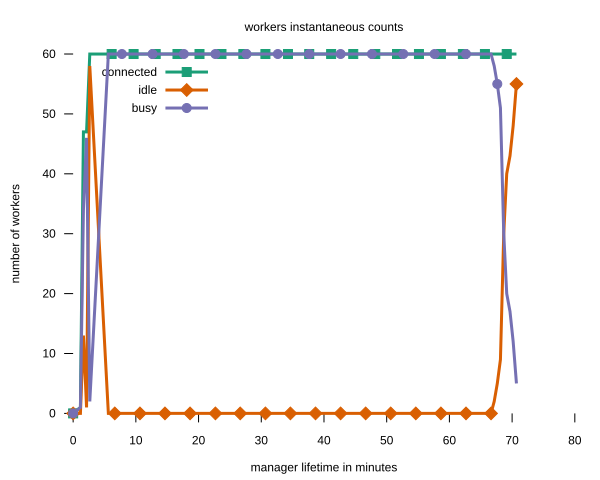

In [68]:
worker_svg

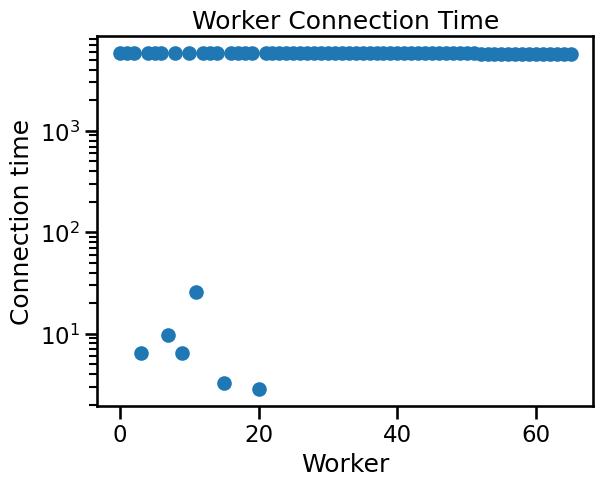

In [69]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


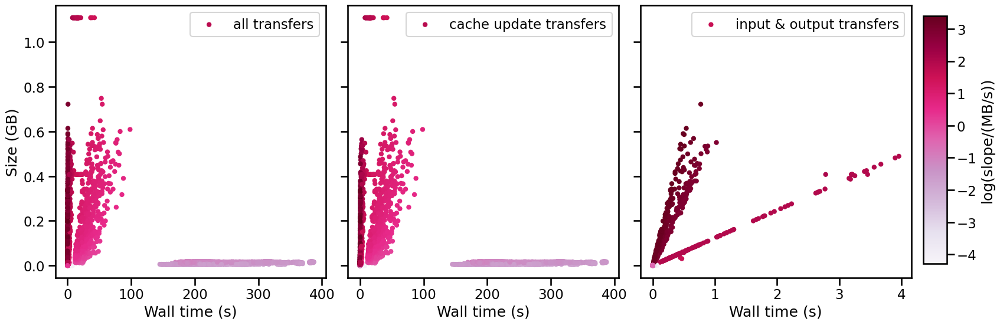

In [70]:
transfer_time_plot = transfer_time(transfers_t)

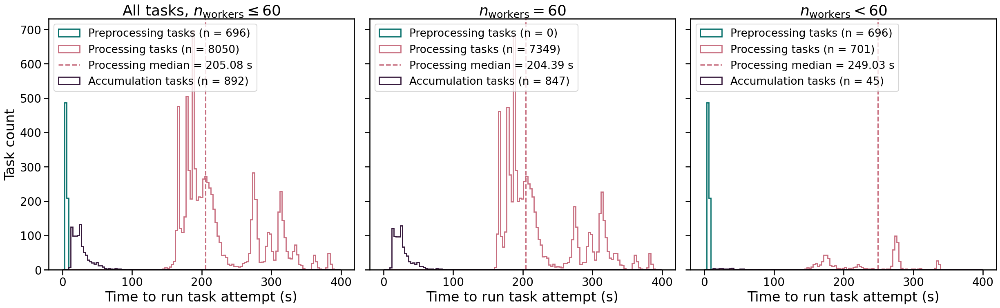

In [71]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 400, 3)

## Run 2025/07/22 001121

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 40 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* bad run
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20p

In [72]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-22T001121')

In [73]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-22T001121')

In [74]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 43
total workers active time = 127.06255133549372 mins, 2.1177091889248953 hours
Mean worker connection time = 117.87468606640202 mins, 1.9645781011067003 hours
# tasks on this run = 9638


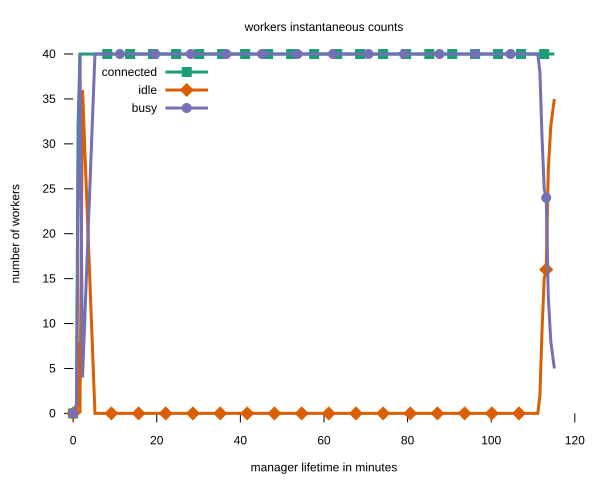

In [75]:
worker_svg

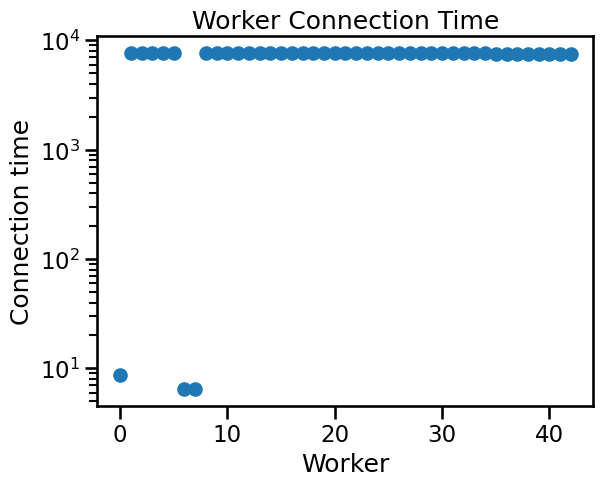

In [76]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


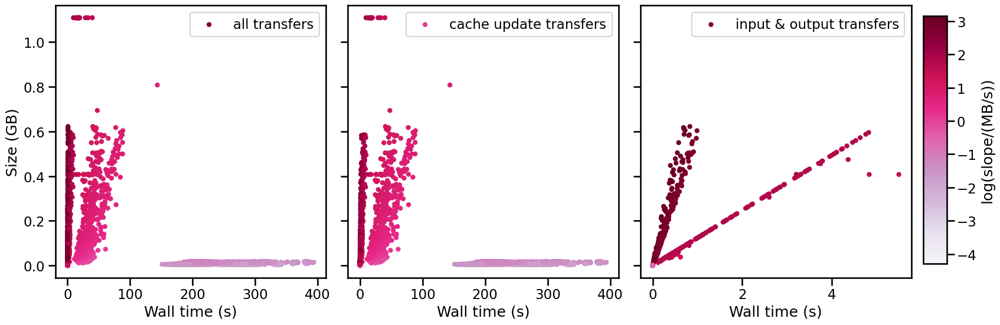

In [77]:
transfer_time_plot = transfer_time(transfers_t)

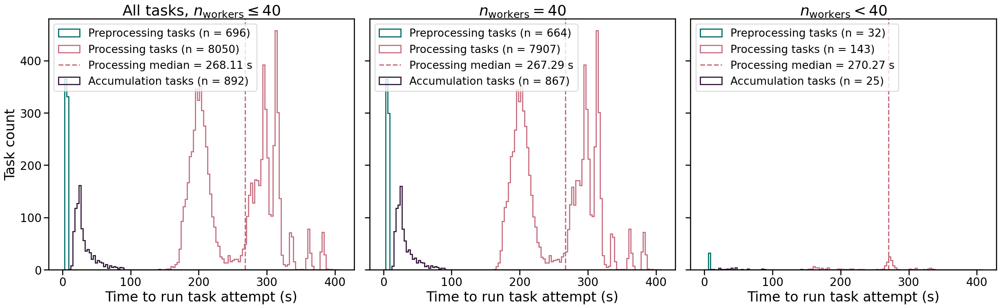

In [78]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 410, 3)

## Run 2025/07/21 215551

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 45 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* bad run
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20post71

In [79]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-21T215551')

In [80]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-21T215551')

In [81]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 49
total workers active time = 126.55391686757406 mins, 2.109231947792901 hours
Mean worker connection time = 105.46160061489157 mins, 1.757693343581526 hours
# tasks on this run = 9639


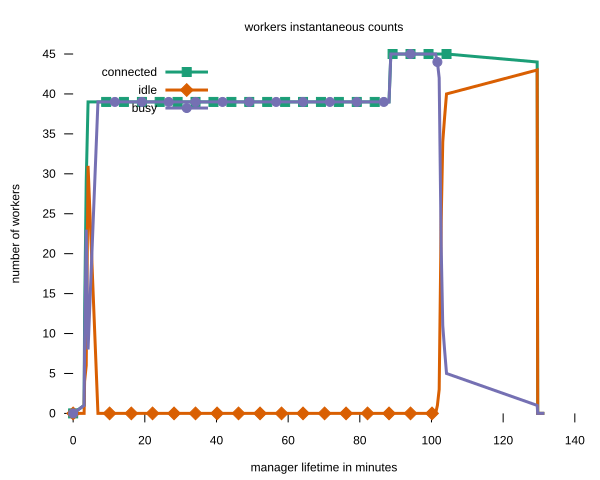

In [82]:
worker_svg

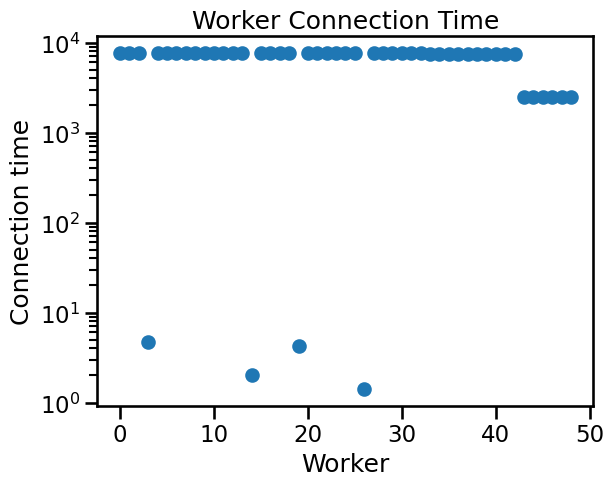

In [83]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


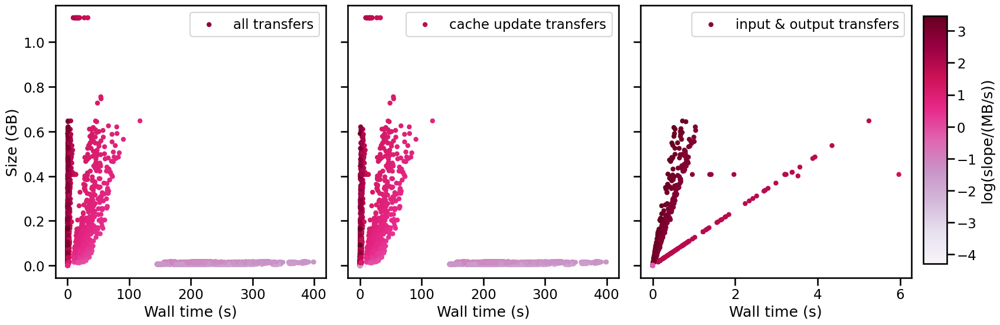

In [84]:
transfer_time_plot = transfer_time(transfers_t)

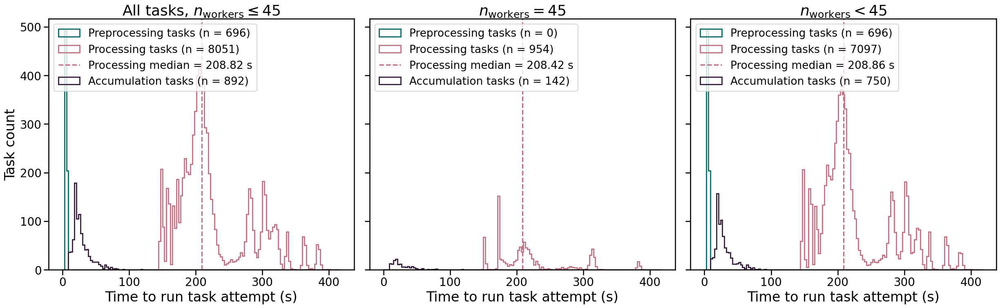

In [85]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 420, 3)

## Run 2025/07/21 201025

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 50 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20post71

In [86]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-21T201025')

In [87]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-21T201025')

In [88]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 53
total workers active time = 101.24688051541646 mins, 1.6874480085902743 hours
Mean worker connection time = 95.17952572662125 mins, 1.5863254287770208 hours
# tasks on this run = 9641


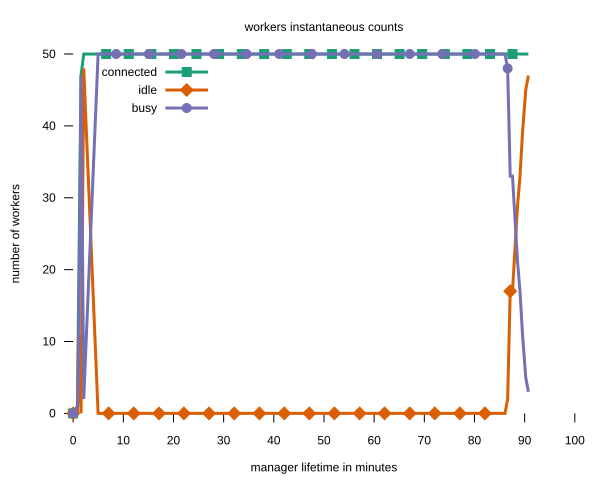

In [89]:
worker_svg

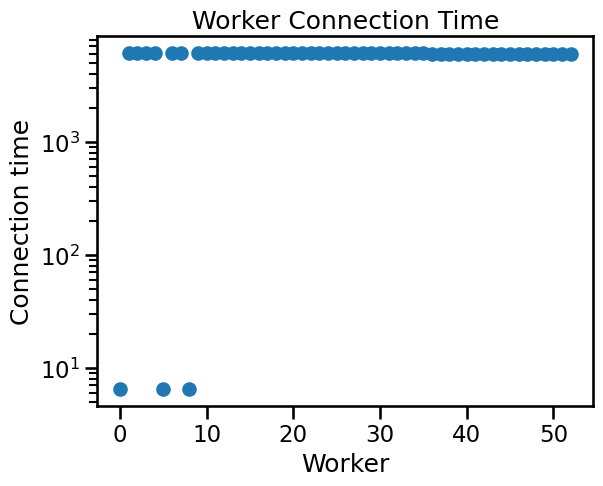

In [90]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


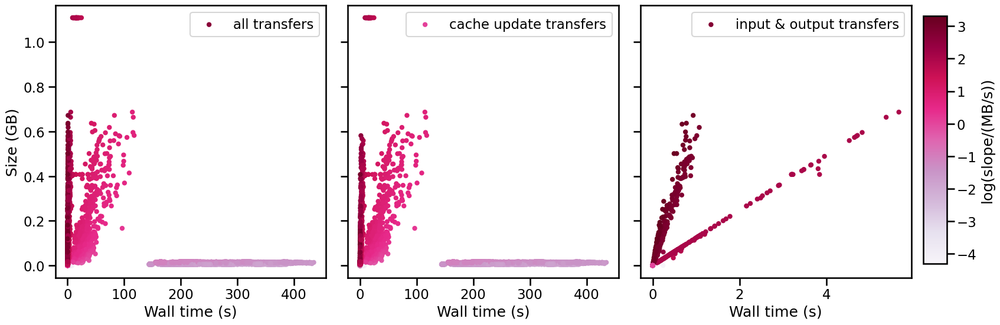

In [91]:
transfer_time_plot = transfer_time(transfers_t)

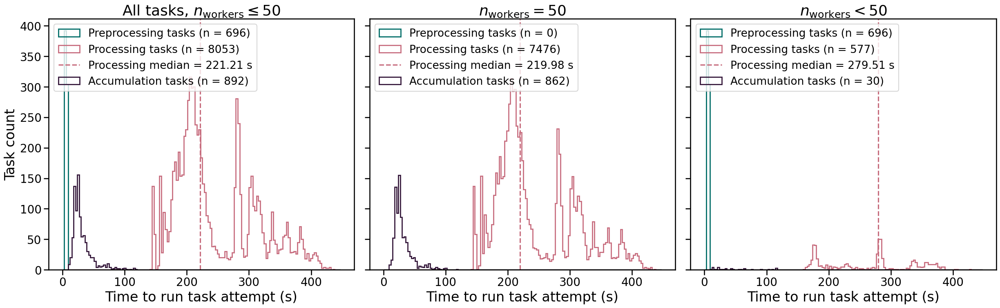

In [92]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 450, 3)

## Run 2025/07/21 181859

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 55 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20post71

In [93]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-21T181859')

In [94]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-21T181859')

In [95]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 66
total workers active time = 109.188087952137 mins, 1.8198014658689499 hours
Mean worker connection time = 90.62708374243793 mins, 1.510451395707299 hours
# tasks on this run = 9638


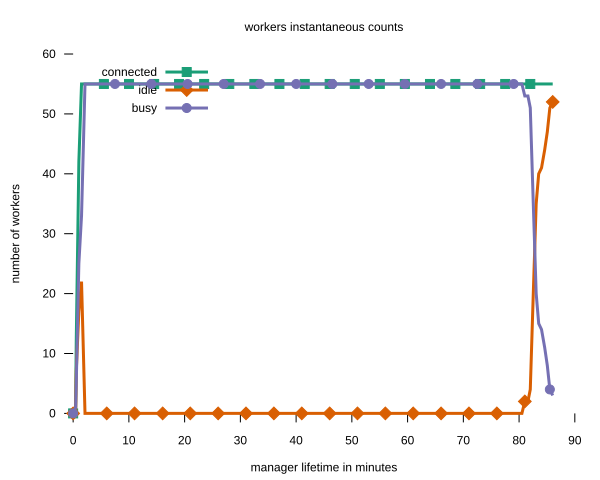

In [96]:
worker_svg

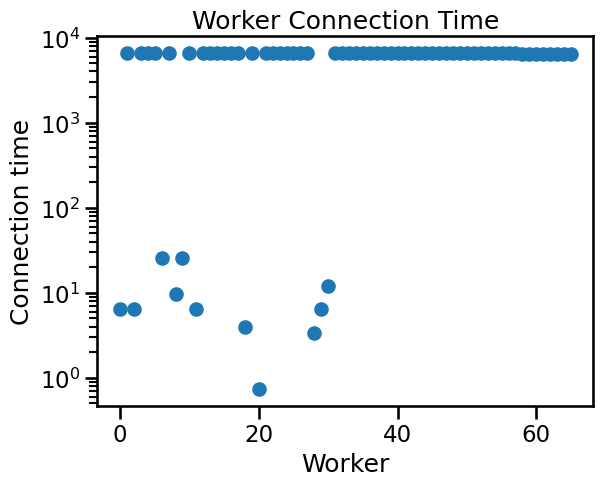

In [97]:
worker_conn_time = plot_worker_times(workers_t)

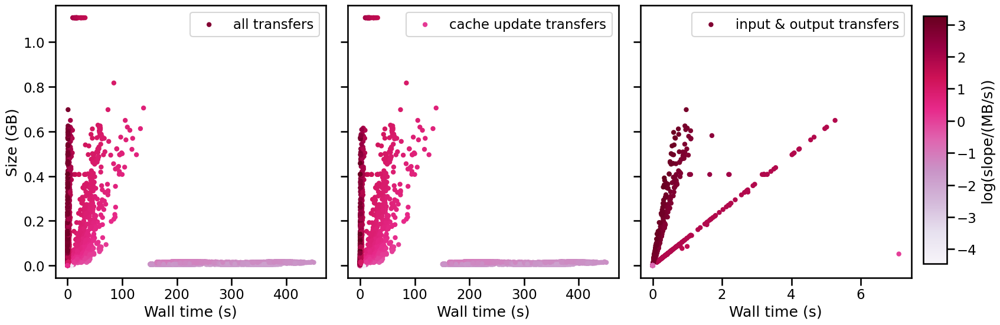

In [98]:
transfer_time_plot = transfer_time(transfers_t)

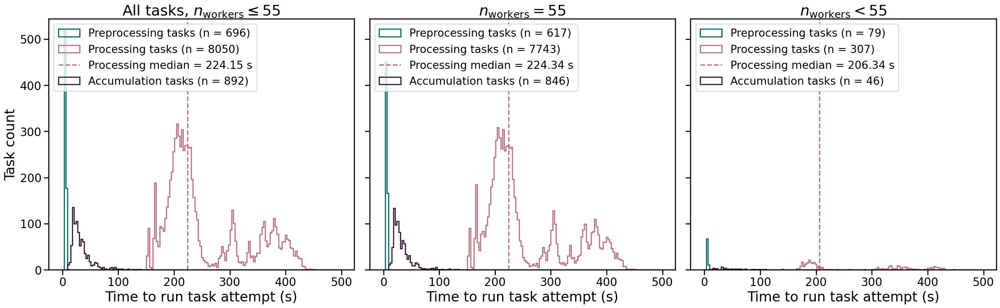

In [99]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 500, 3)

## Run 2025/07/21 160746

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 62 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea
* IMAGE=hub.opensciencegrid.org/coffea-casa/cc-analysis-alma9:2025.07.20post71

In [100]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-21T160746')

In [101]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-21T160746')

In [102]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 69
total workers active time = 129.12077671686808 mins, 2.1520129452811347 hours
Mean worker connection time = 115.4672329613552 mins, 1.9244538826892532 hours
# tasks on this run = 9638


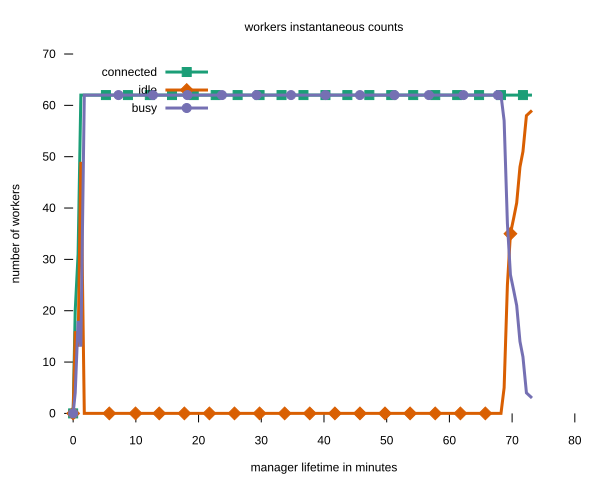

In [103]:
worker_svg

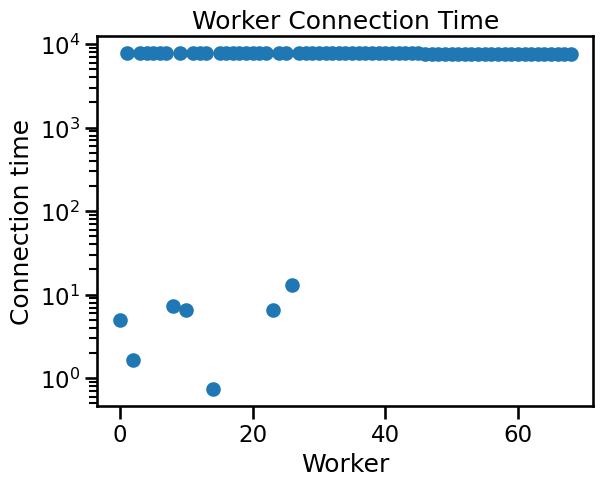

In [104]:
worker_conn_time = plot_worker_times(workers_t)

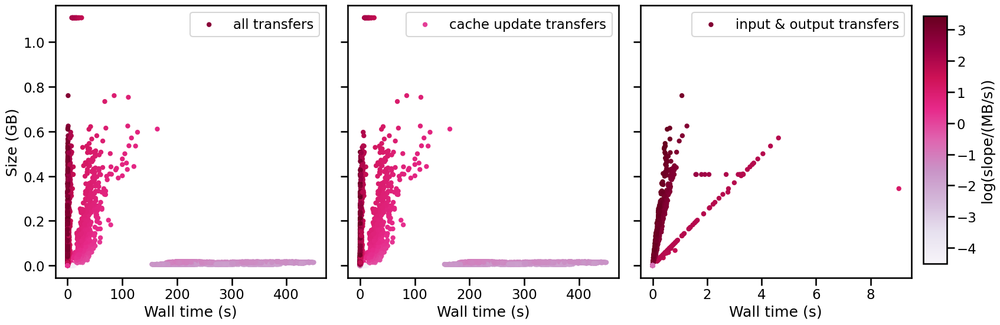

In [105]:
transfer_time_plot = transfer_time(transfers_t)

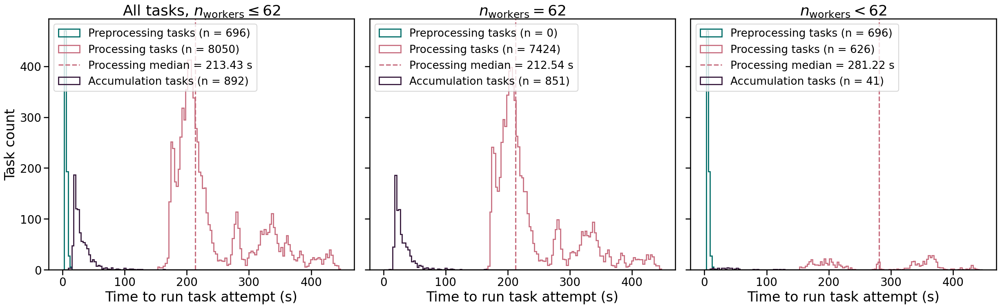

In [106]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 450, 3)

## New VAs Image

## Run 2025/07/20 062350

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 15 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea

In [107]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-20T062350')

In [108]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-20T062350')

In [109]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 16
total workers active time = 561.5968098163605 mins, 9.359946830272674 hours
Mean worker connection time = 525.8602125503123 mins, 8.764336875838538 hours
# tasks on this run = 8875


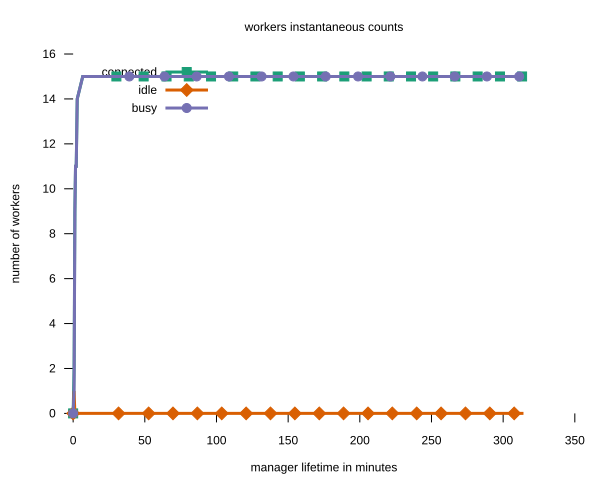

In [110]:
worker_svg

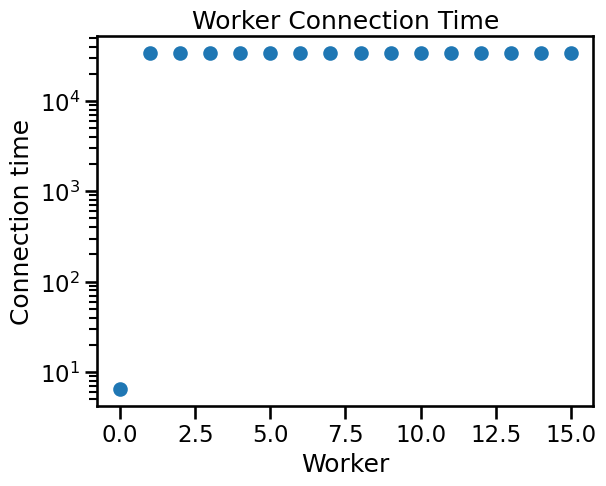

In [111]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


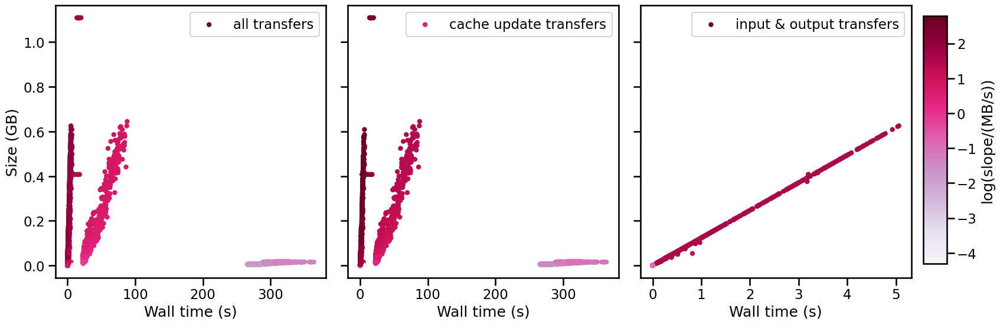

In [112]:
transfer_time_plot = transfer_time(transfers_t)

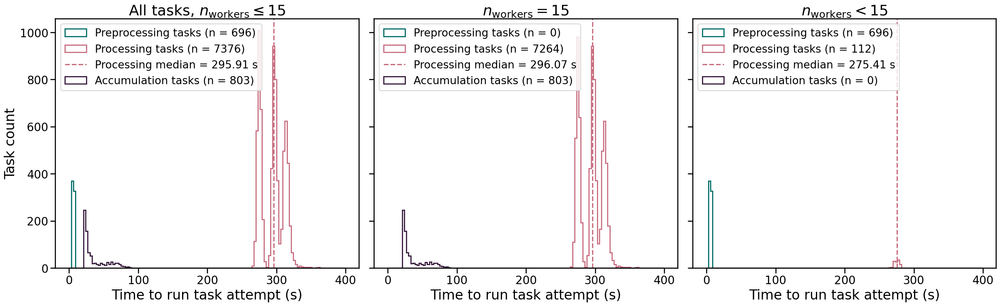

In [113]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 400, 3)

## Run 2025/07/20 033705

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* went till server disconnection
* 40 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea

In [114]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-20T033705')

In [115]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-20T033705')

In [116]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 53
total workers active time = 162.49189701477687 mins, 2.7081982835796143 hours
Mean worker connection time = 122.27649972843673 mins, 2.037941662140612 hours
# tasks on this run = 9638


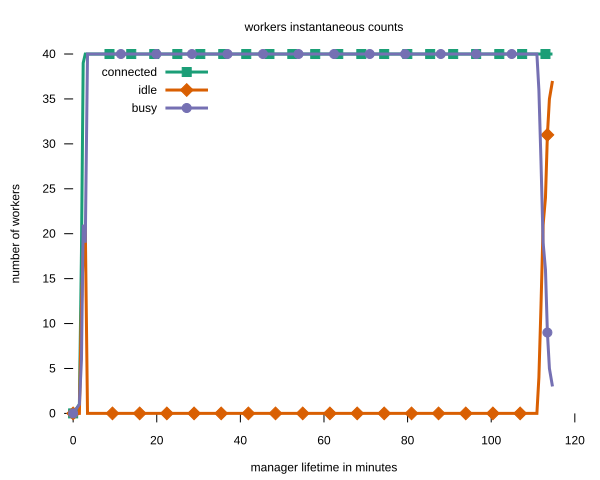

In [117]:
worker_svg

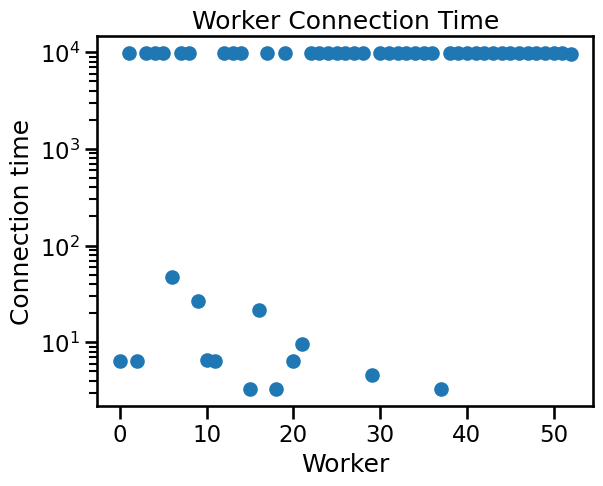

In [118]:
worker_conn_time = plot_worker_times(workers_t)

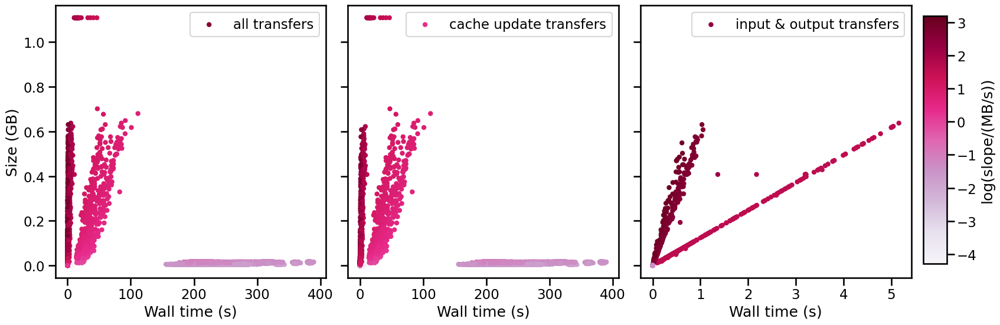

In [119]:
transfer_time_plot = transfer_time(transfers_t)

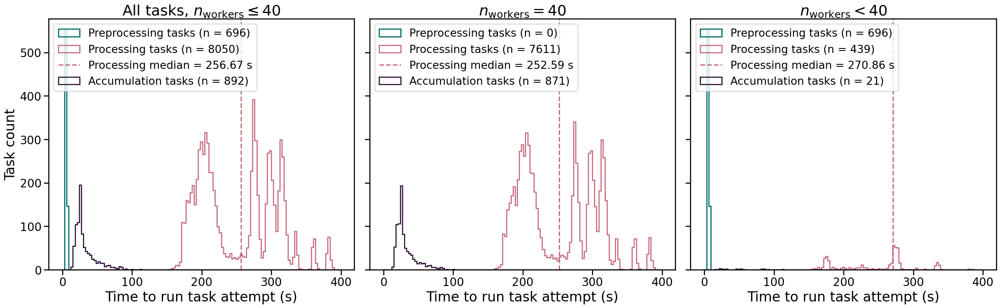

In [120]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 400, 3)

## Run 2025/07/20 000313

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* went till server disconnection
* 25 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea

In [121]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-20T000313')

In [122]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-20T000313')

In [123]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 27
total workers active time = 211.0716591000557 mins, 3.5178609850009286 hours
Mean worker connection time = 194.99262068050882 mins, 3.2498770113418134 hours
# tasks on this run = 9639


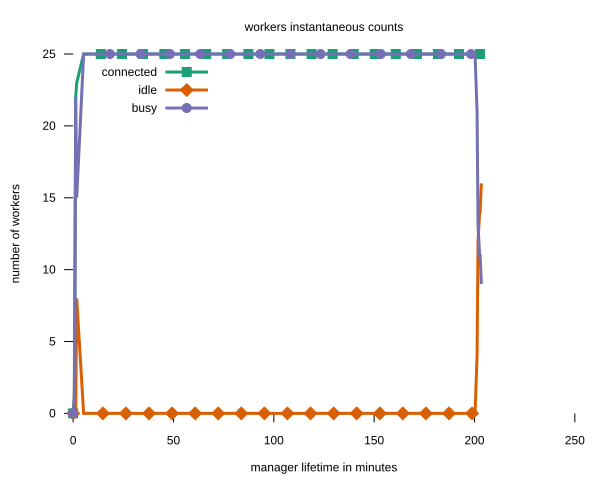

In [124]:
worker_svg

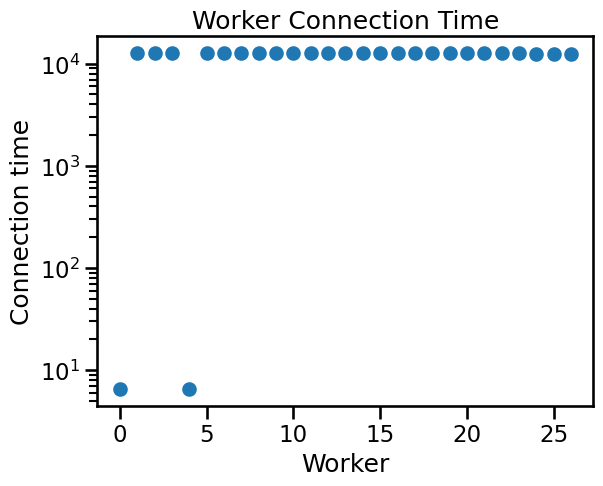

In [125]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


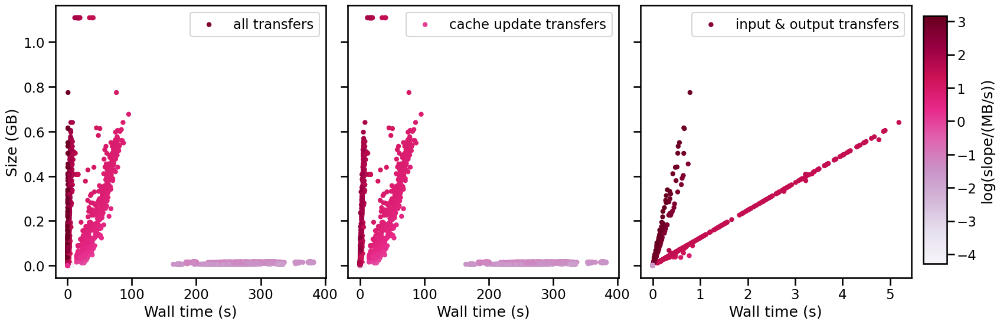

In [126]:
transfer_time_plot = transfer_time(transfers_t)

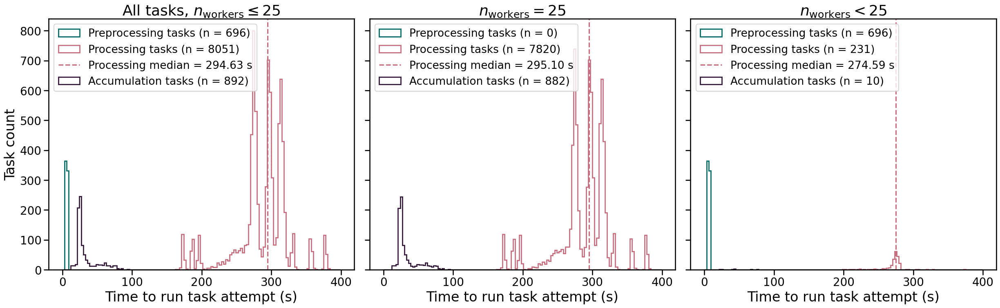

In [127]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 400, 3)

## Run 2025/07/19 183420

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* went till server disconnection
* 20 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea

In [128]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-19T183420')

In [129]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-19T183420')

In [130]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 24
total workers active time = 325.60955541531246 mins, 5.426825923588541 hours
Mean worker connection time = 270.4435545134876 mins, 4.5073925752247925 hours
# tasks on this run = 9641


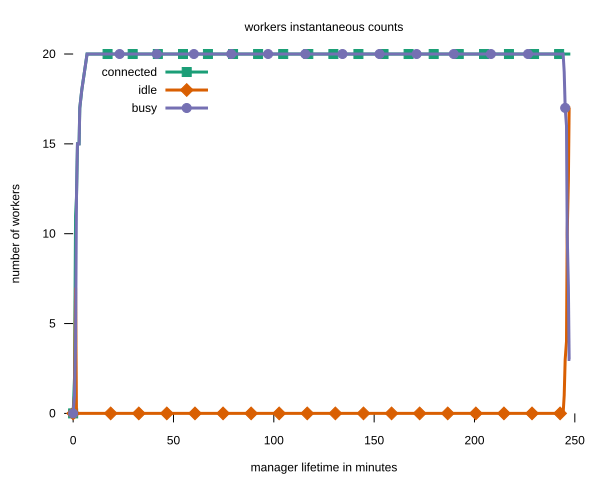

In [131]:
worker_svg

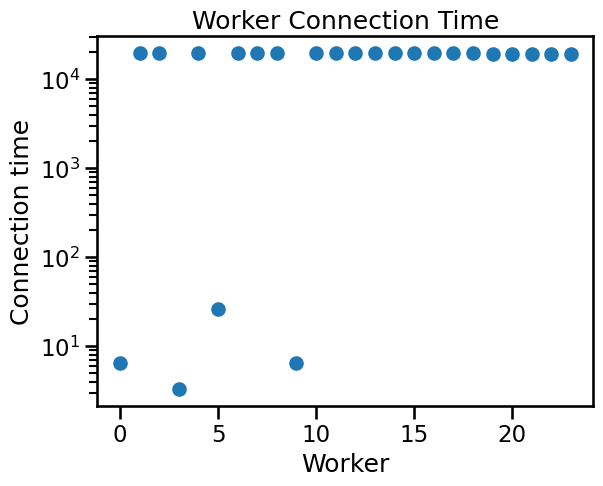

In [132]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


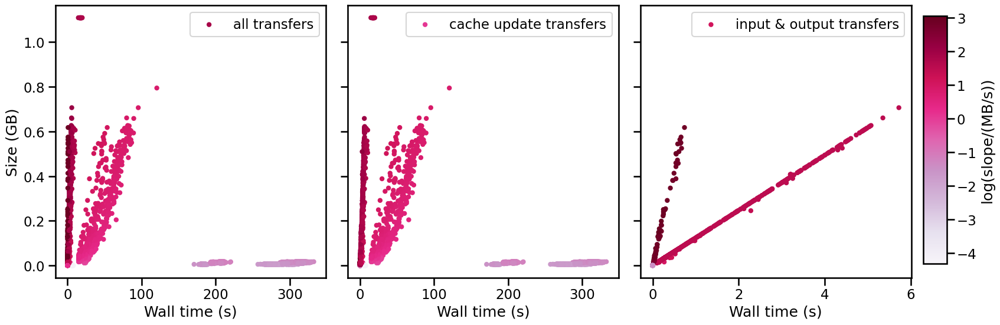

In [133]:
transfer_time_plot = transfer_time(transfers_t)

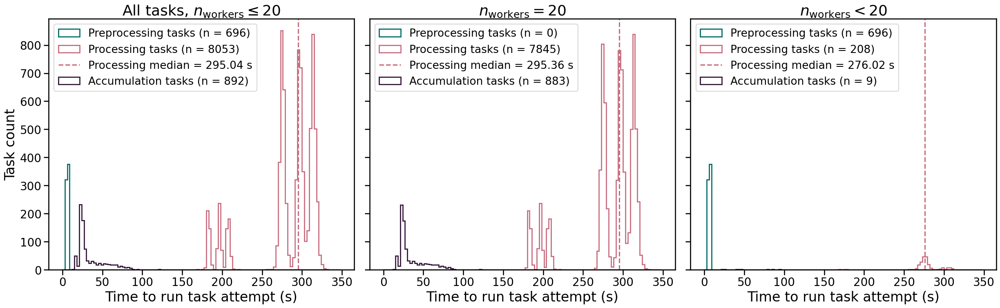

In [134]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 350, 3)

## Run 2025/07/19 053345

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard kill
* 10 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea

In [135]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-19T053345')

In [136]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-19T053345')

In [137]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 11
total workers active time = 661.6740477363269 mins, 11.027900795605447 hours
Mean worker connection time = 600.3948299942596 mins, 10.006580499904326 hours
# tasks on this run = 6665


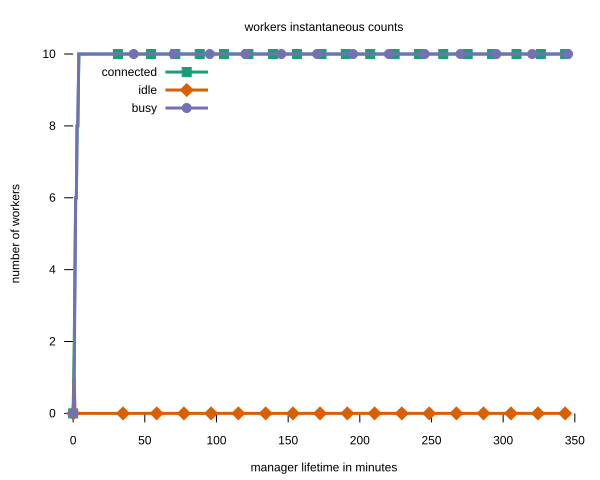

In [138]:
worker_svg

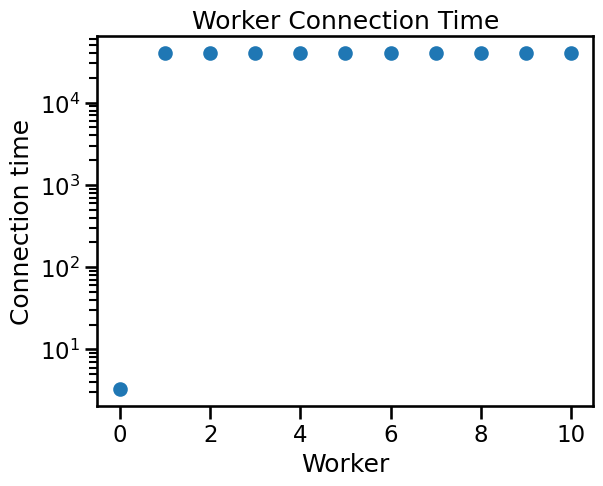

In [139]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


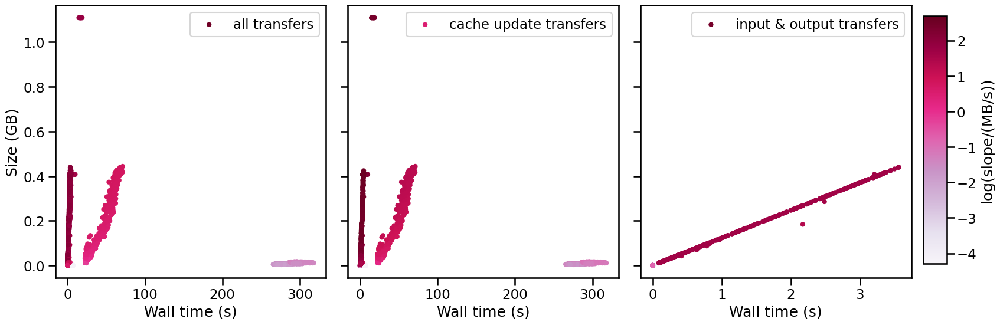

In [140]:
transfer_time_plot = transfer_time(transfers_t)

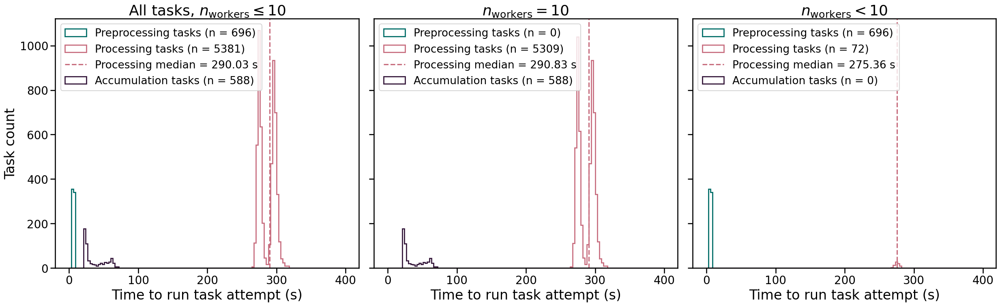

In [141]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 400, 3)

## Run 2025/07/18 212703

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* went till server disconnection
* 50 workers
* redirector: root://xcache.cmsaf-dev.flatiron.hollandhpc.org/
* calendar coffea

In [142]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-18T212703')

In [143]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-18T212703')

In [144]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 50
total workers active time = 480.726350680987 mins, 8.012105844683118 hours
Mean worker connection time = 246.88825213392573 mins, 4.114804202232095 hours
# tasks on this run = 9640


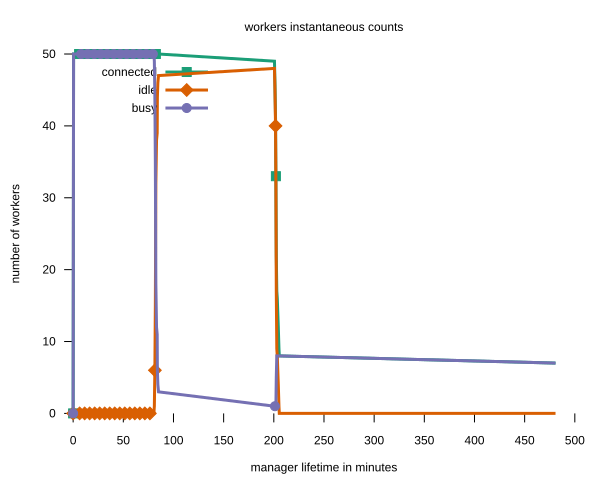

In [145]:
worker_svg

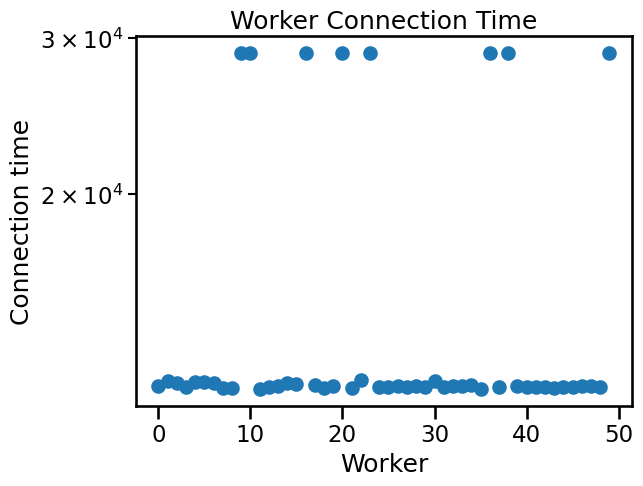

In [146]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


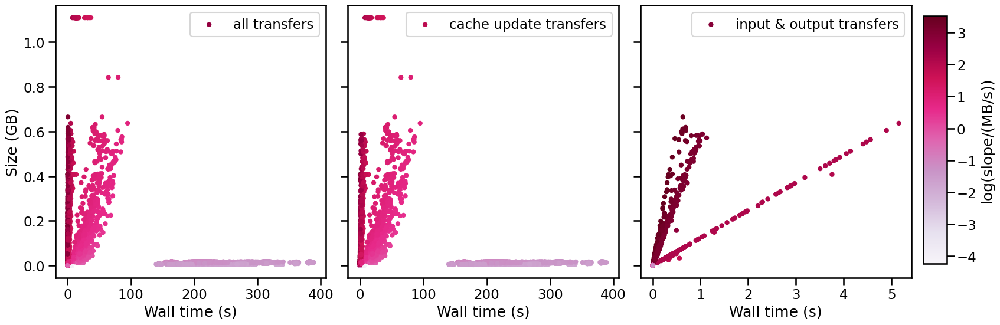

In [147]:
transfer_time_plot = transfer_time(transfers_t)

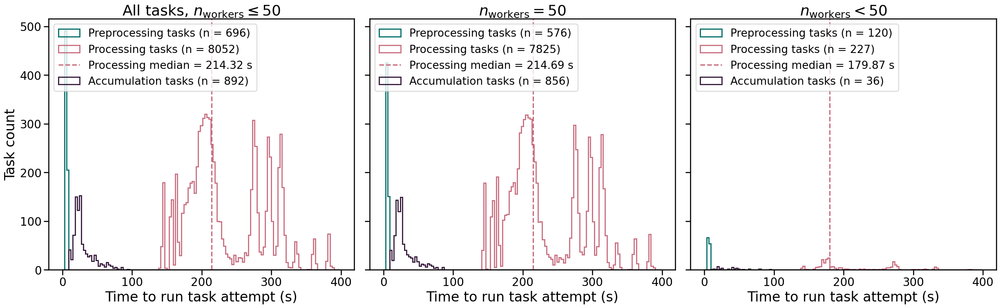

In [148]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 400, 3)

## Run 2025/07/18 200124

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* died midway bc of file access issues
* 50 workers
* redirector: root://xrootd-local.unl.edu/
* calendar coffea

In [24]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-18T200124')

In [25]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-18T200124')

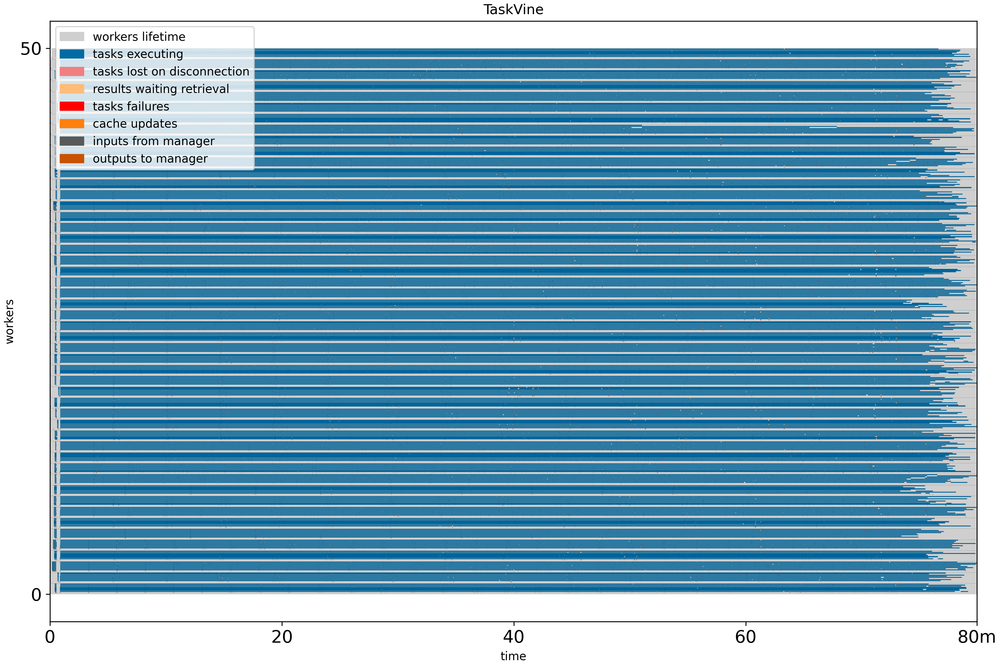

In [26]:
workers

In [151]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 50
total workers active time = 79.94063231945037 mins, 1.3323438719908396 hours
Mean worker connection time = 79.88496642549832 mins, 1.3314161070916386 hours
# tasks on this run = 9326


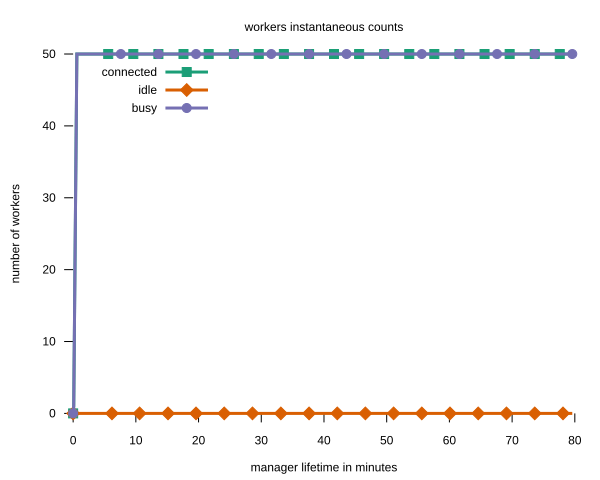

In [152]:
worker_svg

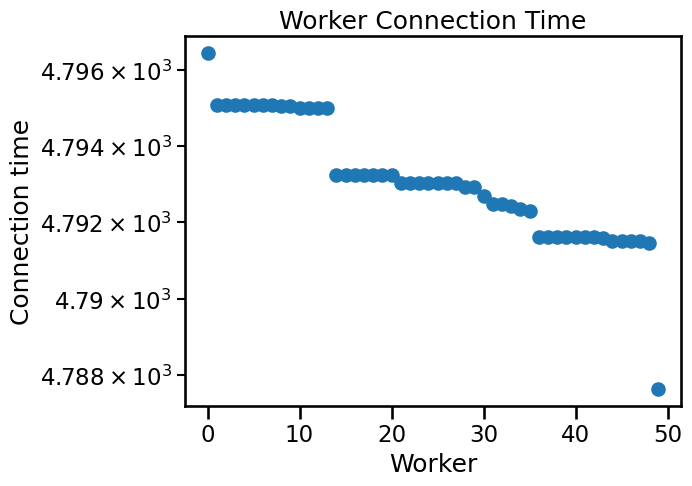

In [153]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


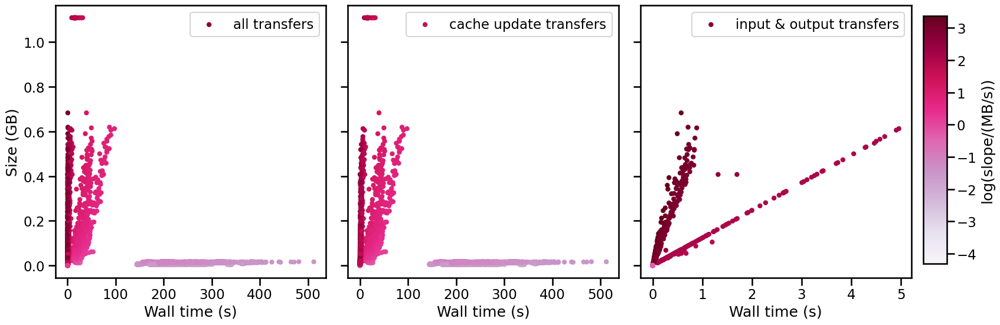

In [154]:
transfer_time_plot = transfer_time(transfers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


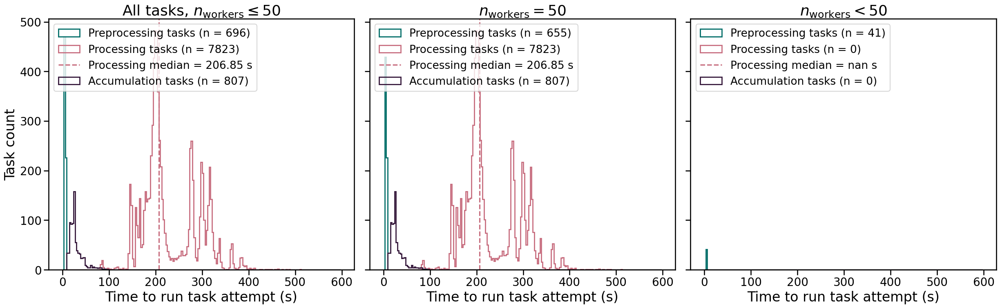

In [155]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 600, 3)

## Switch to Calendar Coffea but may be cooked by data access issue

## Run 2025/07/24 024241

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* died at 60%
* 5 workers
* coffea v0.7
* redirector: root://xrootd-local.unl.edu/

In [27]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-24T024241')

In [28]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-24T024241')

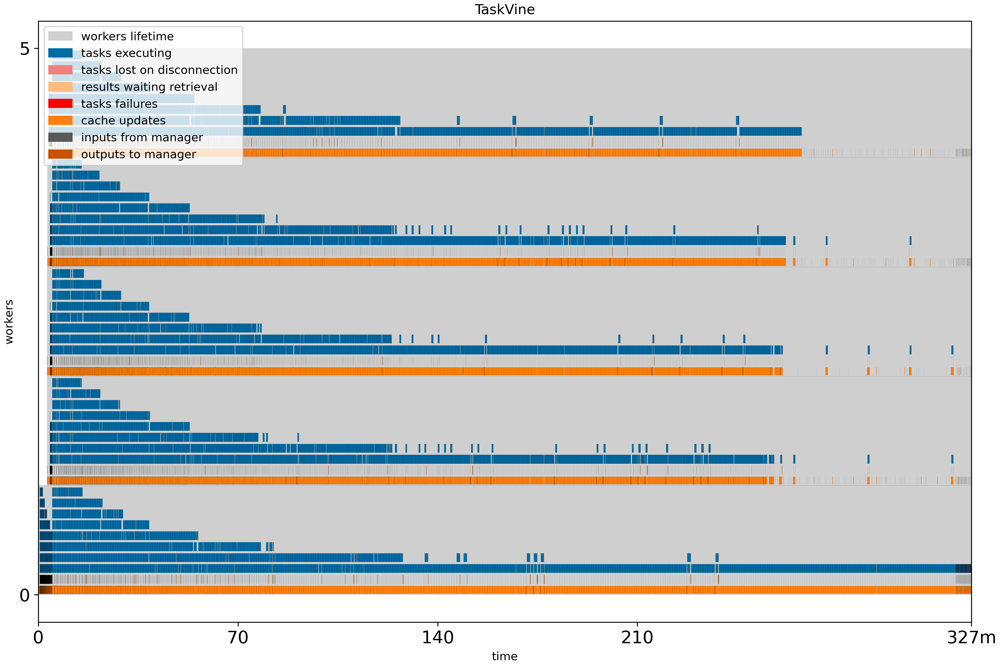

In [29]:
workers

In [158]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 5
total workers active time = 327.2580197175344 mins, 5.454300328625573 hours
Mean worker connection time = 324.69173672517144 mins, 5.411528945419524 hours
# tasks on this run = 5343


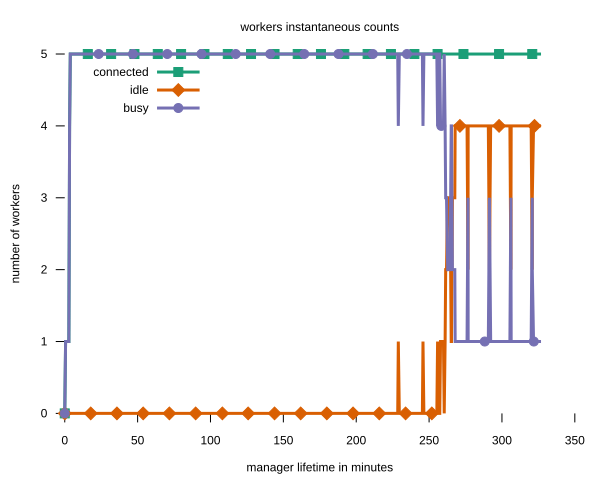

In [159]:
worker_svg

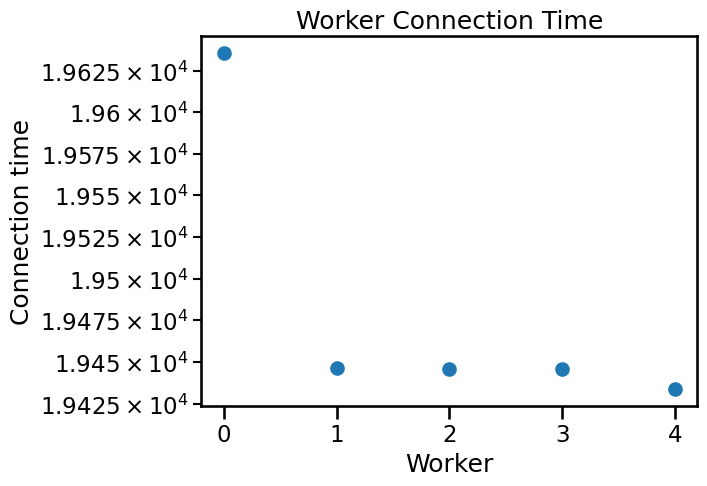

In [160]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


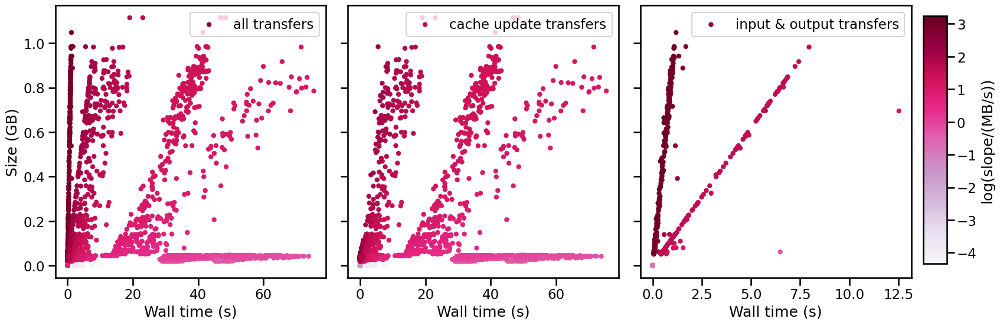

In [161]:
transfer_time_plot = transfer_time(transfers_t)

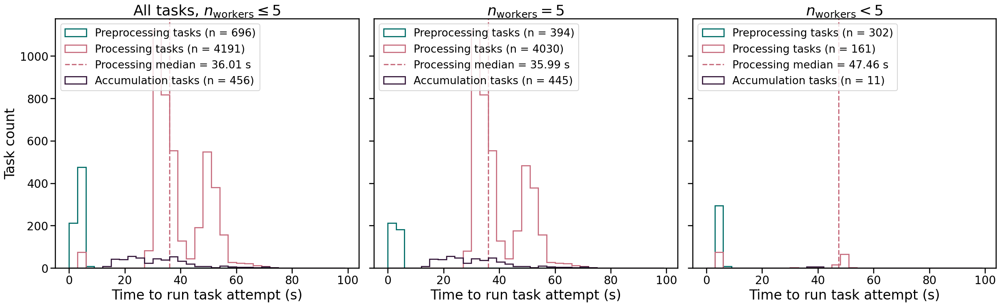

In [162]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 100, 3)

## Run 2025/07/18 171027

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* completed until server disconnection
* 20 workers
* redirector: root://xrootd-local.unl.edu/

In [163]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-18T171027')

In [164]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-18T171027')

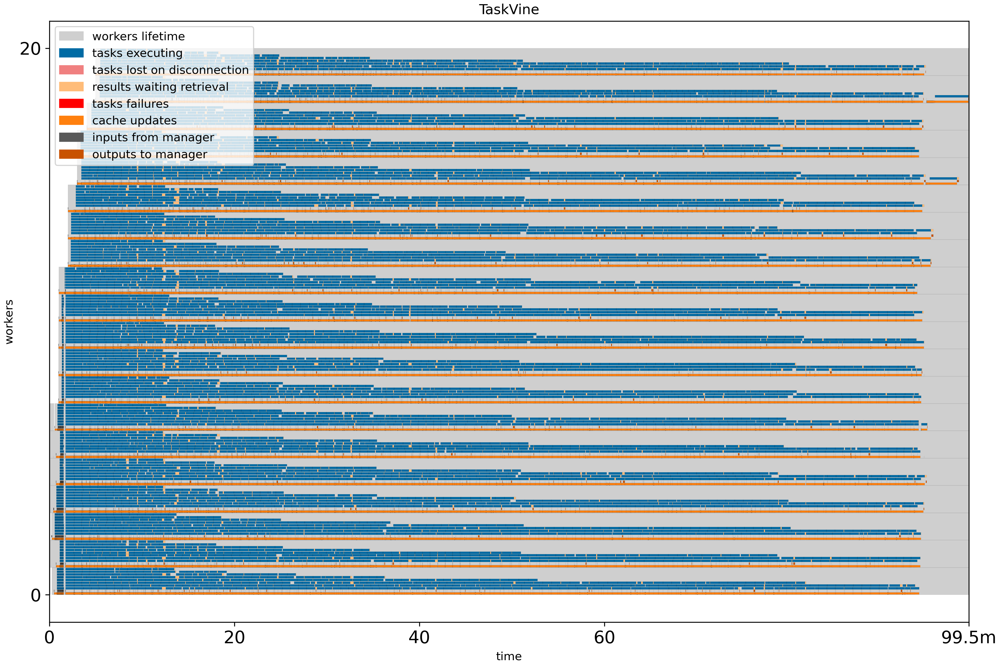

In [165]:
workers

In [166]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 23
total workers active time = 99.36491323312124 mins, 1.6560818872186873 hours
Mean worker connection time = 85.02081819703614 mins, 1.417013636617269 hours
# tasks on this run = 9642


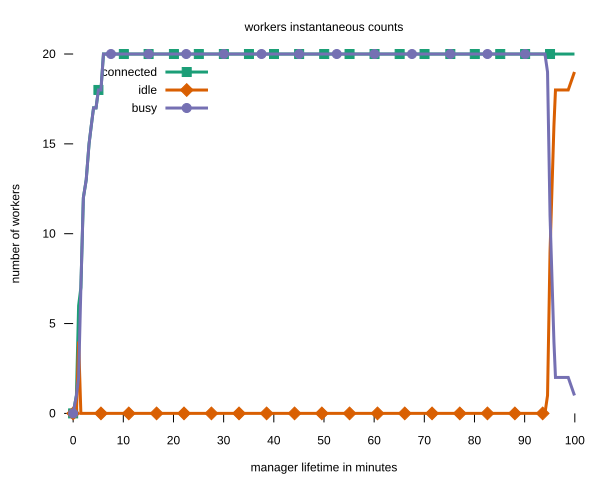

In [167]:
worker_svg

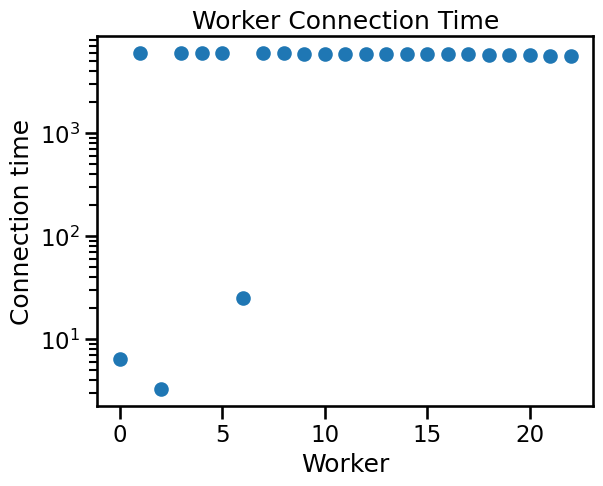

In [168]:
worker_conn_time = plot_worker_times(workers_t)

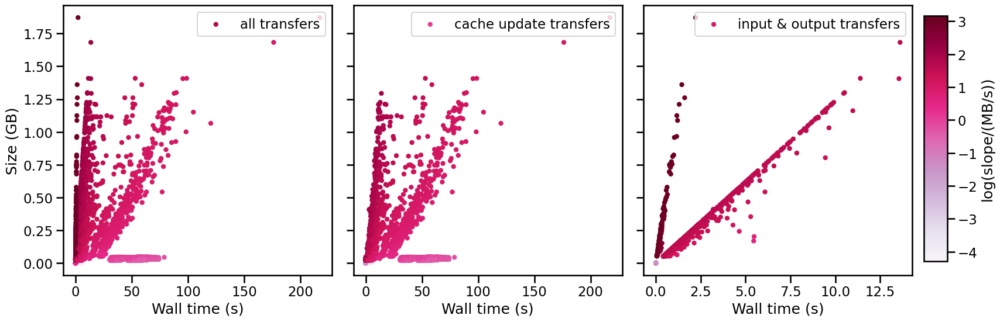

In [169]:
transfer_time_plot = transfer_time(transfers_t)

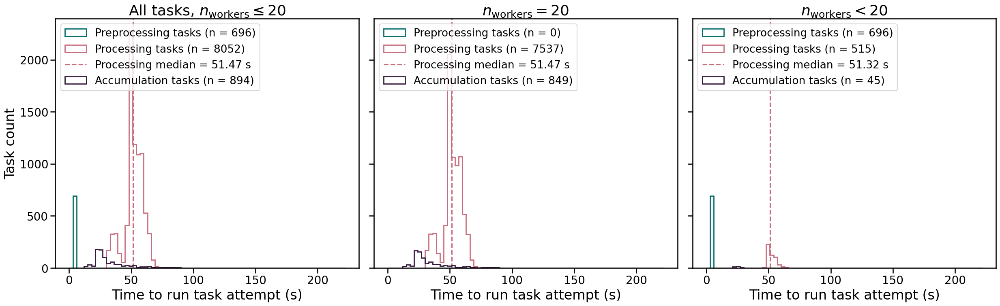

In [170]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 225, 3)

## Run 2025/07/18 155413

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* completed until server disconnection
* 25 workers
* redirector: root://xrootd-local.unl.edu/

In [171]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-18T155413')

In [172]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-18T155413')

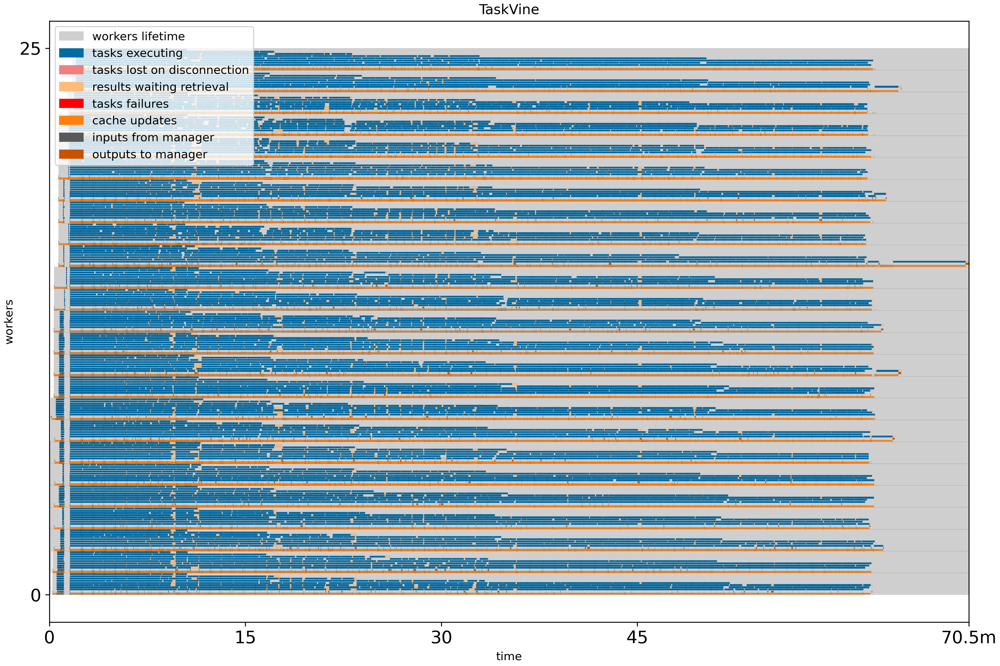

In [173]:
workers

In [174]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 27
total workers active time = 70.37223210334778 mins, 1.1728705350557964 hours
Mean worker connection time = 64.68787393349189 mins, 1.0781312322248648 hours
# tasks on this run = 9642


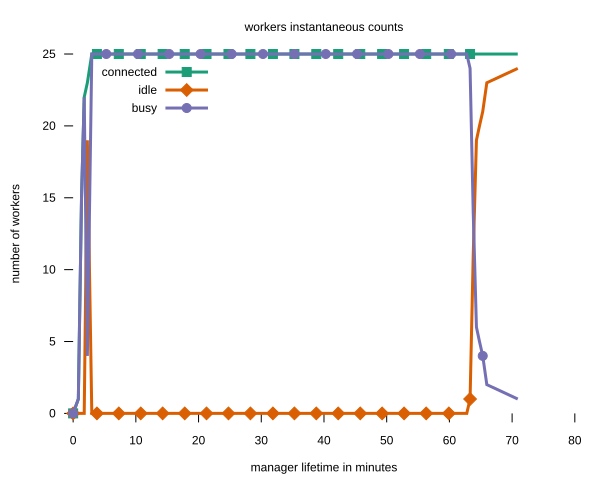

In [175]:
worker_svg

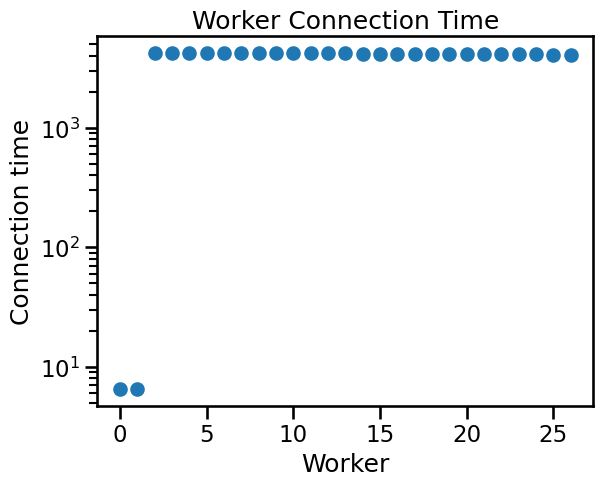

In [176]:
worker_conn_time = plot_worker_times(workers_t)

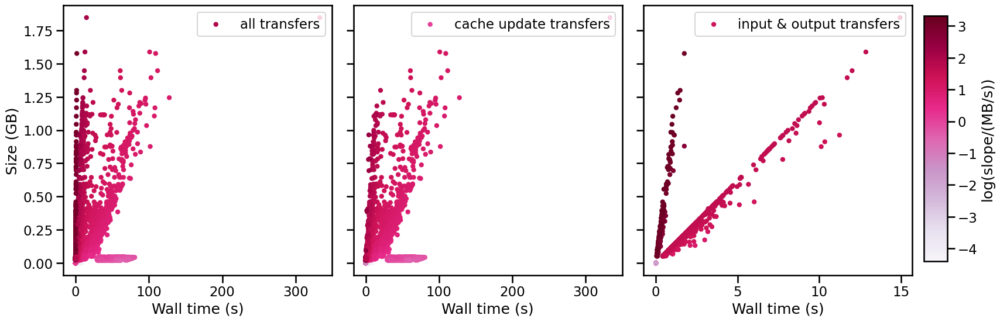

In [177]:
transfer_time_plot = transfer_time(transfers_t)

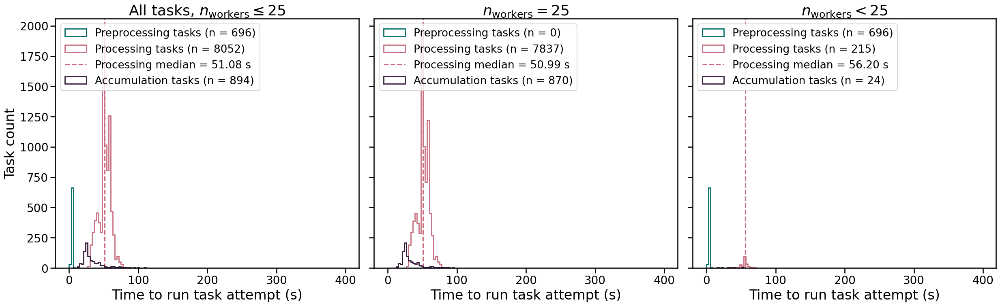

In [178]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 400, 3)

## Run 2025/07/18 144856

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* completed until server disconnection
* 30 workers
* redirector: root://xrootd-local.unl.edu/

In [179]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-18T144856')

In [180]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-18T144856')

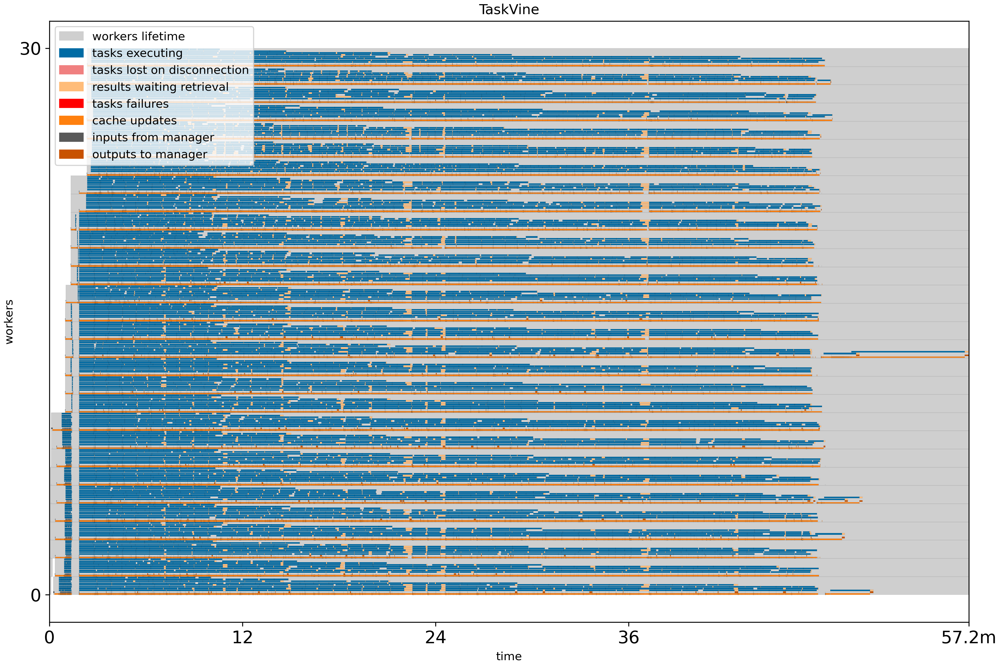

In [181]:
workers

In [182]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 32
total workers active time = 57.13355003197988 mins, 0.9522258338663313 hours
Mean worker connection time = 52.553338602433605 mins, 0.8758889767072267 hours
# tasks on this run = 9642


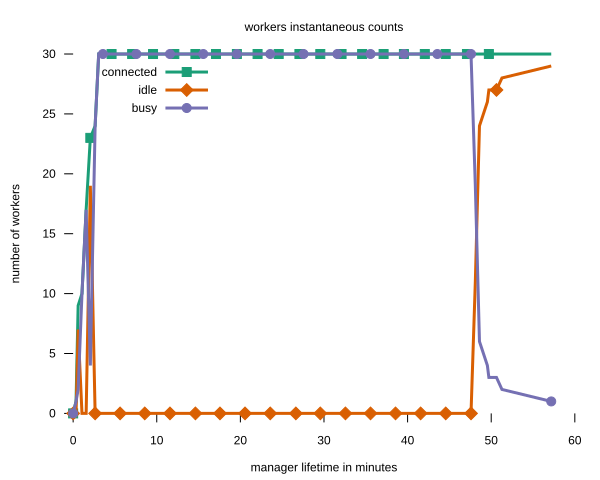

In [183]:
worker_svg

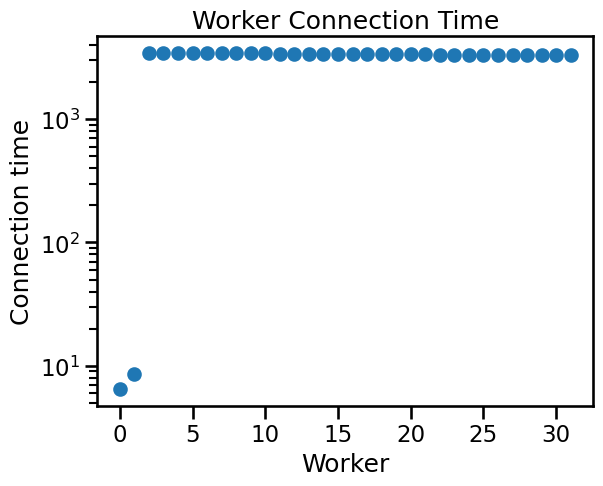

In [184]:
worker_conn_time = plot_worker_times(workers_t)

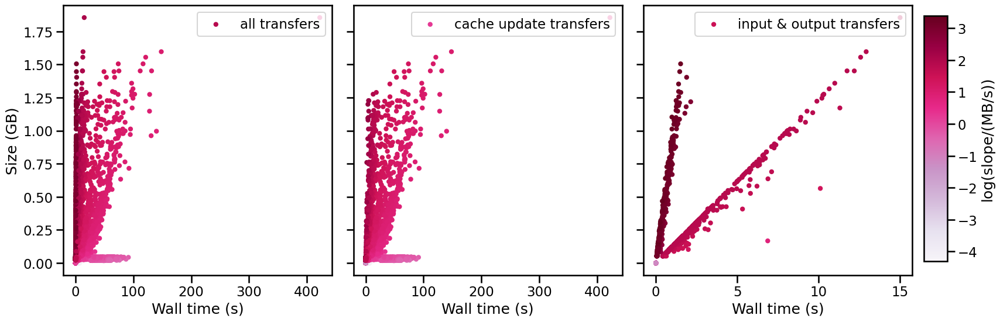

In [185]:
transfer_time_plot = transfer_time(transfers_t)

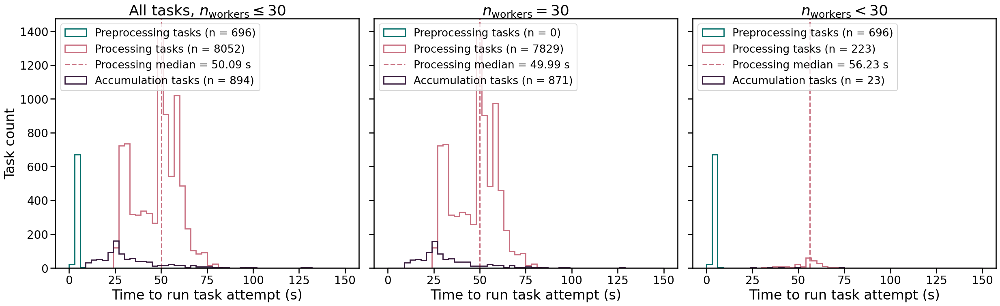

In [186]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 151, 3)

## Run 2025/07/18 043307

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to ^C
* 15 workers
* redirector: root://xrootd-local.unl.edu/

In [187]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-18T043307')

In [188]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-18T043307')

In [189]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 16
total workers active time = 554.1947760184606 mins, 9.236579600307676 hours
Mean worker connection time = 390.1838721329967 mins, 6.503064535549945 hours
# tasks on this run = 9631


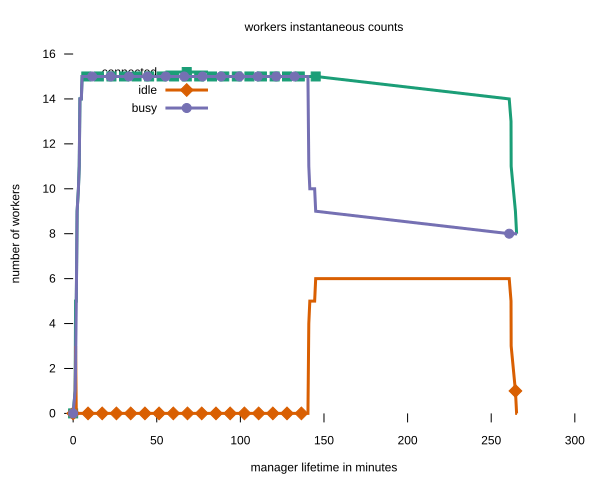

In [190]:
worker_svg

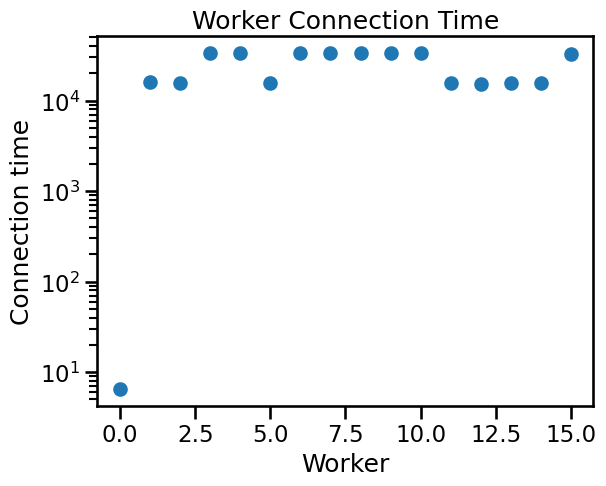

In [191]:
worker_conn_time = plot_worker_times(workers_t)

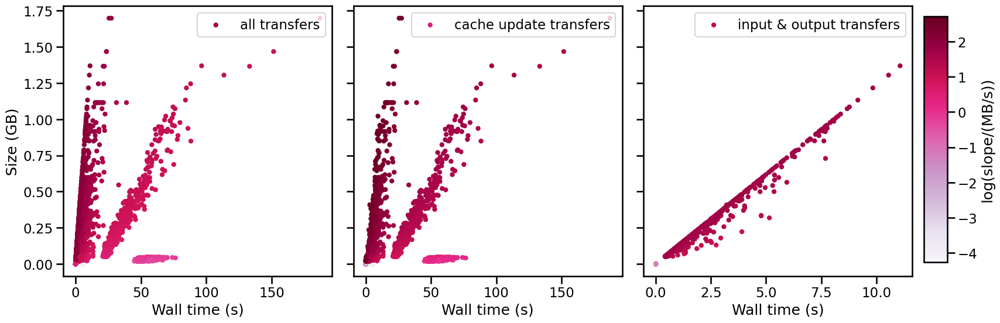

In [192]:
transfer_time_plot = transfer_time(transfers_t)

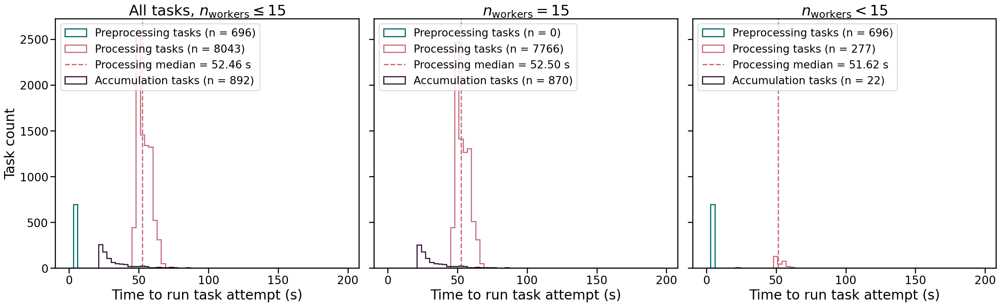

In [193]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 200, 3)

## Run 2025/07/17 232202

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to ^C
* 10 workers
* redirector: root://xrootd-local.unl.edu/

In [194]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-17T232202')

In [195]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-17T232202')

In [196]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 11
total workers active time = 298.42536596457165 mins, 4.973756099409528 hours
Mean worker connection time = 270.3553752425945 mins, 4.505922920709909 hours
# tasks on this run = 9409


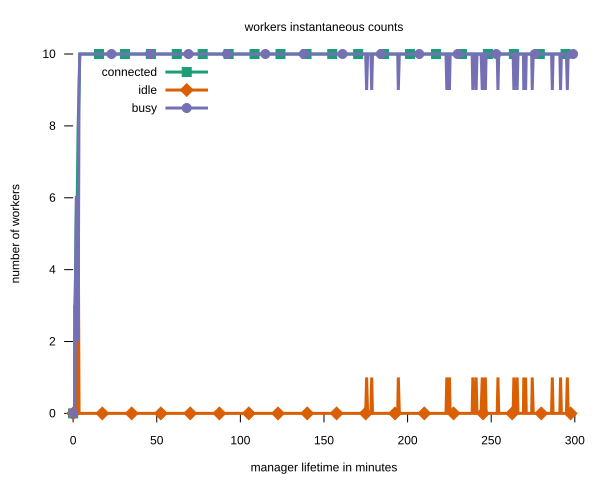

In [197]:
worker_svg

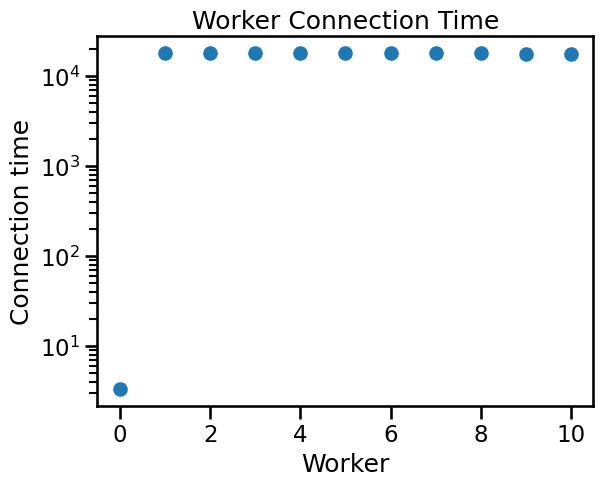

In [198]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


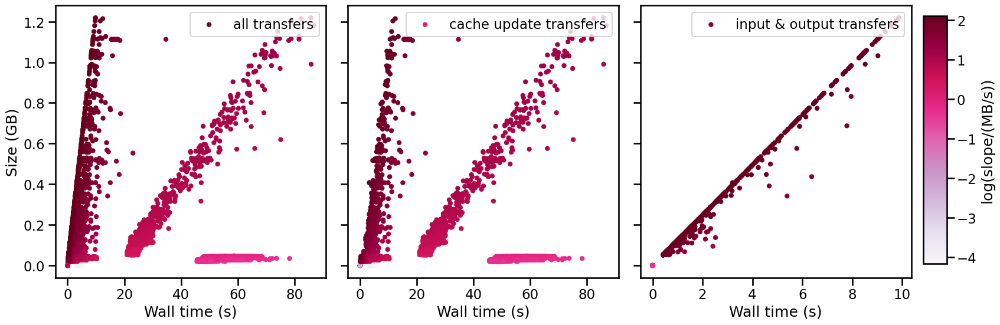

In [199]:
transfer_time_plot = transfer_time(transfers_t)

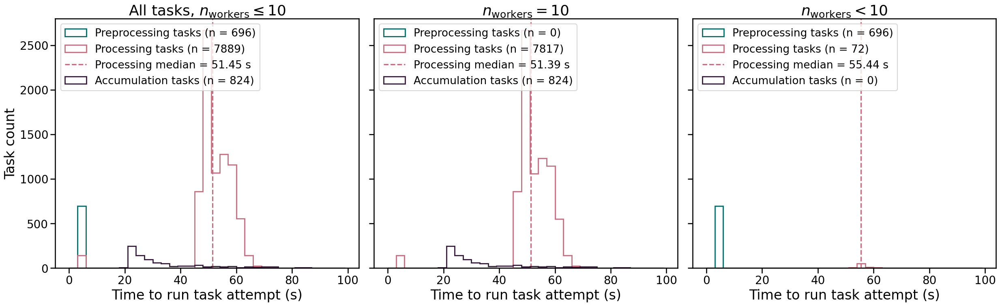

In [200]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 100, 3)

## Run 2025/07/17 220213 

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* completed until server disconnection
* 35 workers
* redirector: root://xrootd-local.unl.edu/

In [201]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-17T220213')

In [202]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-17T220213')

In [203]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 36
total workers active time = 39.67015693187714 mins, 0.6611692821979522 hours
Mean worker connection time = 38.09705948697196 mins, 0.6349509914495326 hours
# tasks on this run = 9642


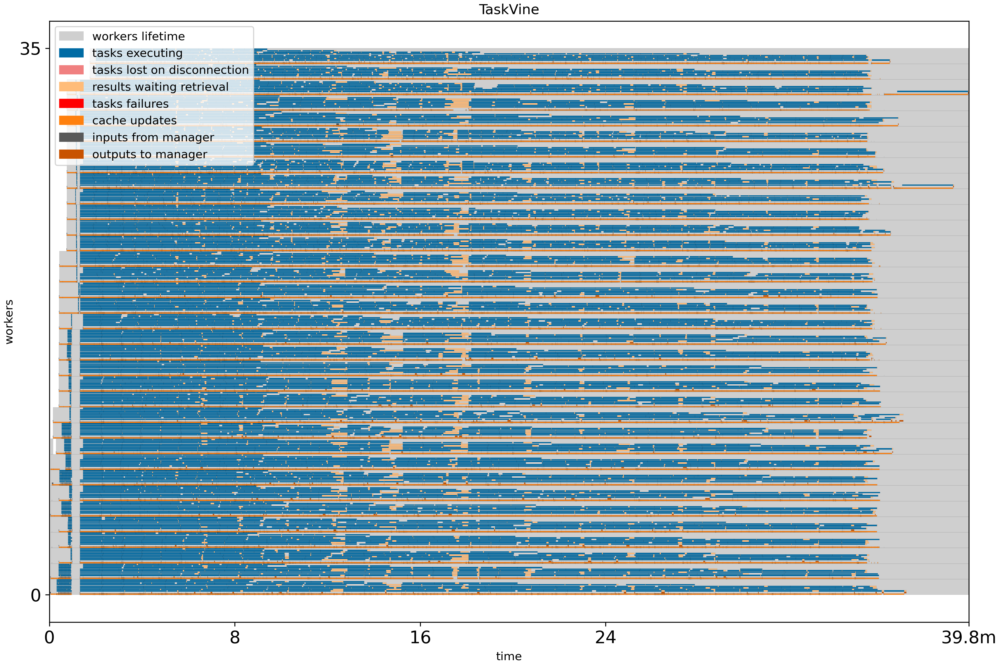

In [204]:
workers

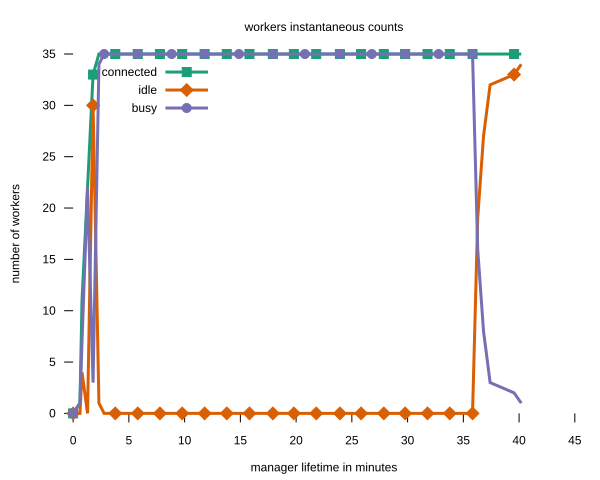

In [205]:
worker_svg

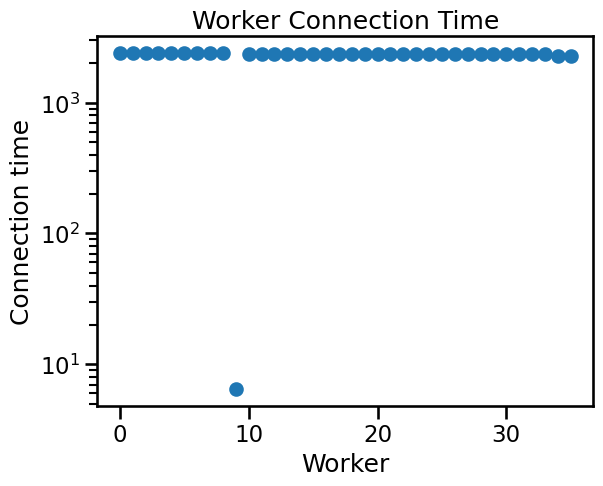

In [206]:
worker_conn_time = plot_worker_times(workers_t)

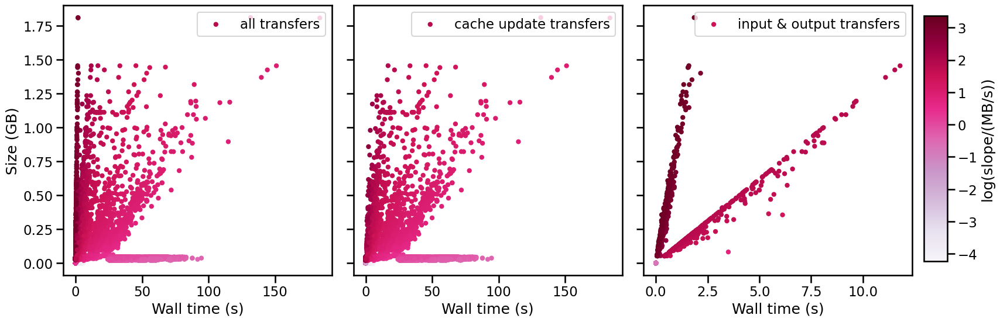

In [207]:
transfer_time_plot = transfer_time(transfers_t)

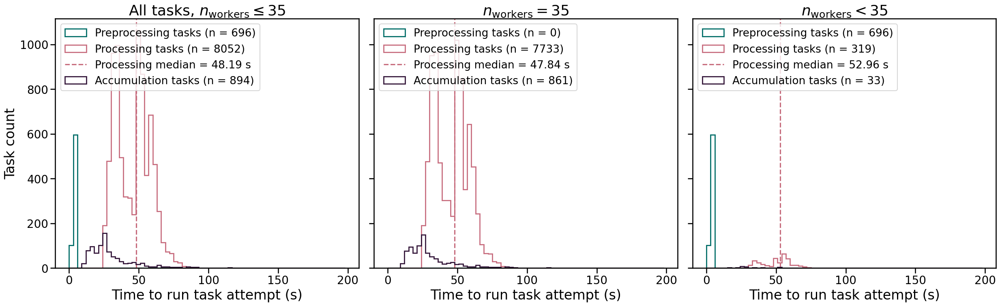

In [208]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 200, 3)
#task_time_hist.savefig("poster_figs/task_time_histogram_draft.png", dpi=500)

## Run 2025/07/17 205231

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* completed until server disconnection
* redirector: root://xrootd-local.unl.edu/

In [209]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-17T205231')

In [210]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-17T205231')

In [211]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 44
total workers active time = 33.27367718617121 mins, 0.5545612864361869 hours
Mean worker connection time = 29.51157625471101 mins, 0.4918596042451835 hours
# tasks on this run = 9642


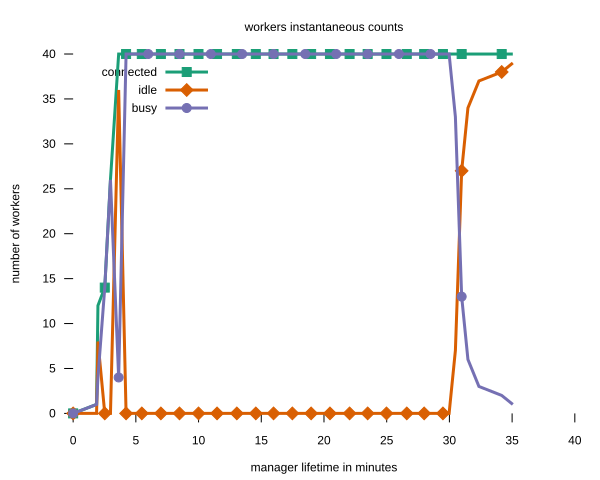

In [212]:
worker_svg

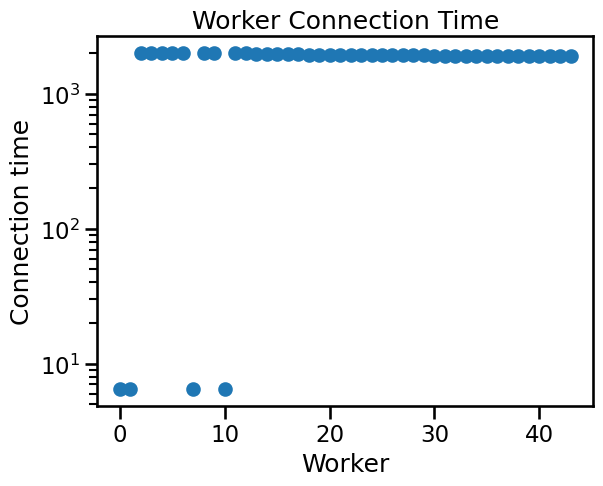

In [213]:
worker_conn_time = plot_worker_times(workers_t)

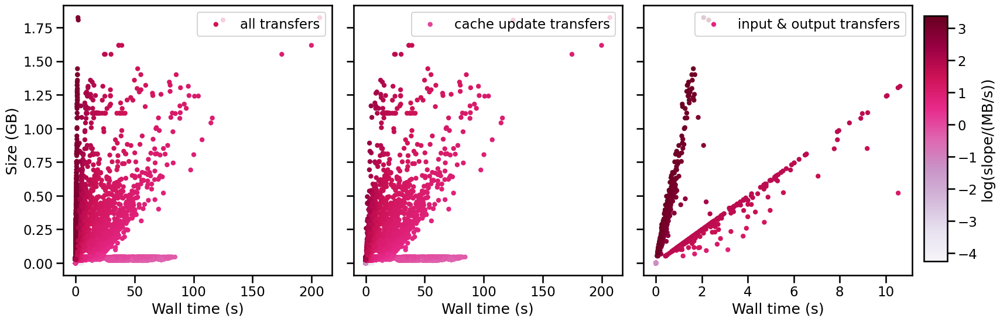

In [214]:
transfer_time_plot = transfer_time(transfers_t)

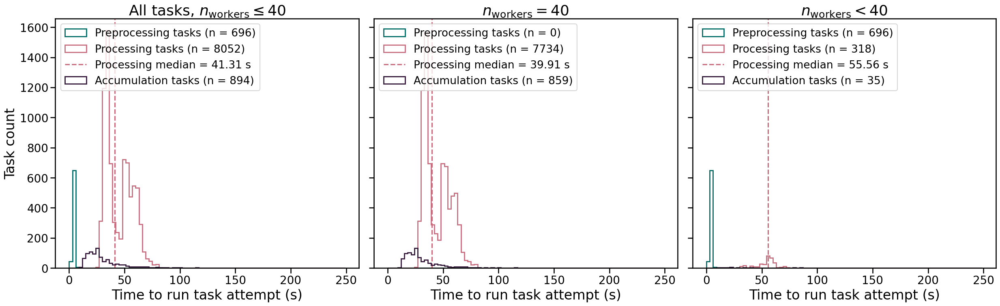

In [215]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 250, 3)

## Run 2025/07/17 201232

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* completed until server disconnection
* redirector: root://xrootd-local.unl.edu/

In [216]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-17T201232')

In [217]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-17T201232')

In [218]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 50
total workers active time = 34.47660338083903 mins, 0.5746100563473172 hours
Mean worker connection time = 30.673029639244078 mins, 0.511217160654068 hours
# tasks on this run = 9643


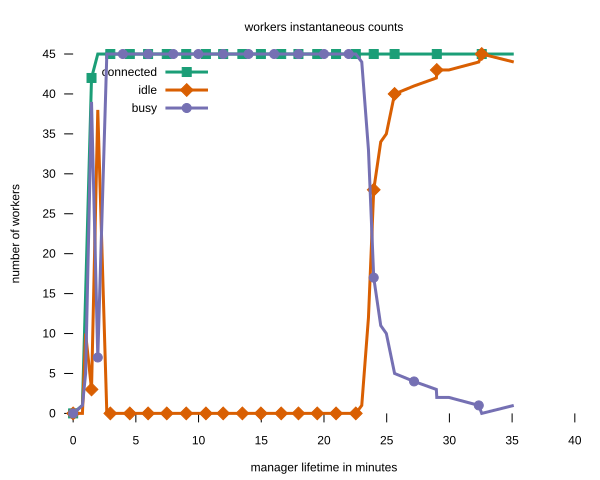

In [219]:
worker_svg

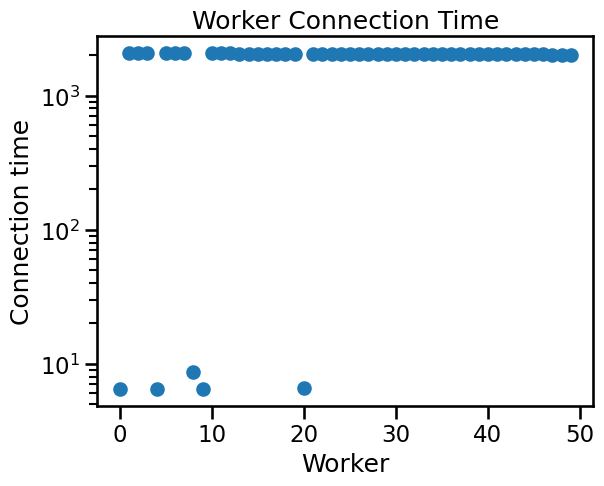

In [220]:
worker_conn_time = plot_worker_times(workers_t)

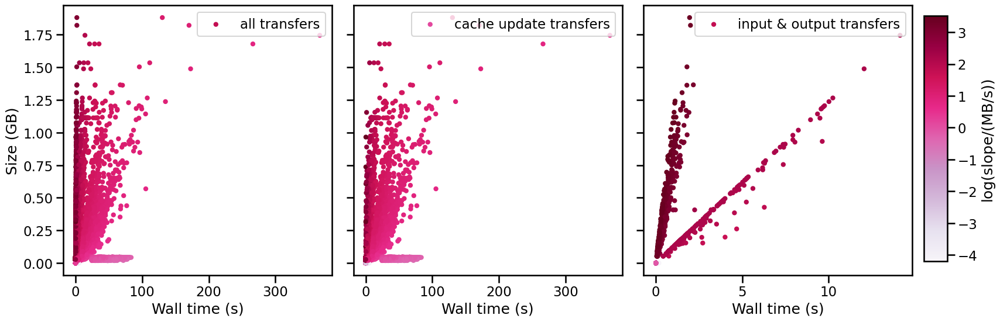

In [221]:
transfer_time_plot = transfer_time(transfers_t)

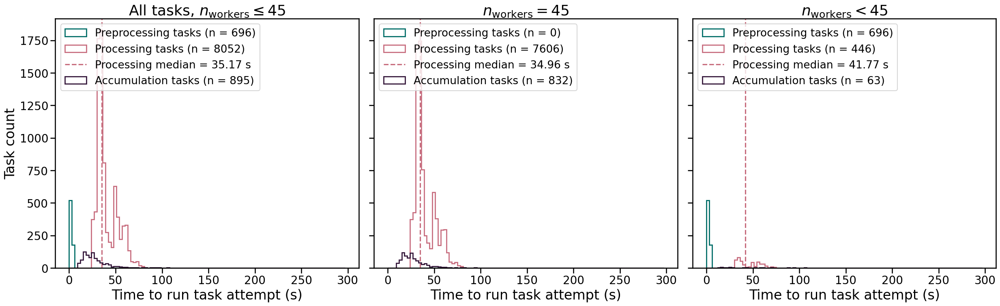

In [222]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 300, 3)

## Run 2025/07/17 193225

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* completed until server disconnection
* redirector: root://xrootd-local.unl.edu/

In [223]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-17T193225')

In [224]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-17T193225')

In [225]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 57
total workers active time = 27.900486183166503 mins, 0.46500810305277507 hours
Mean worker connection time = 27.649772037260714 mins, 0.4608295339543452 hours
# tasks on this run = 9643


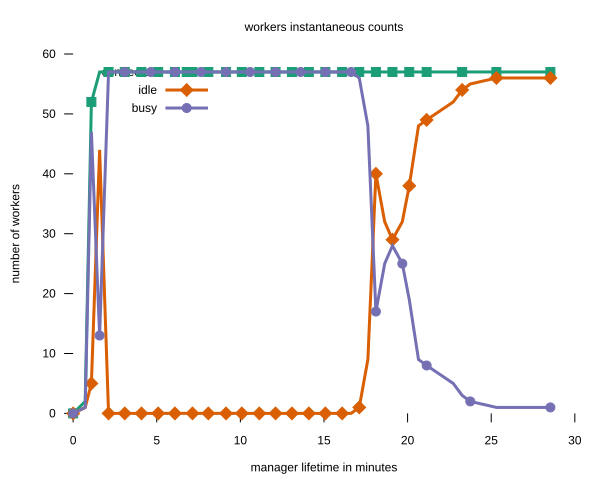

In [226]:
worker_svg

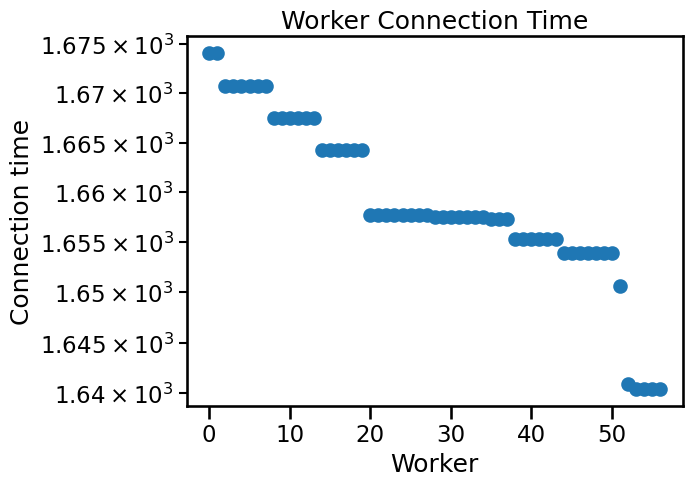

In [227]:
worker_conn_time = plot_worker_times(workers_t)

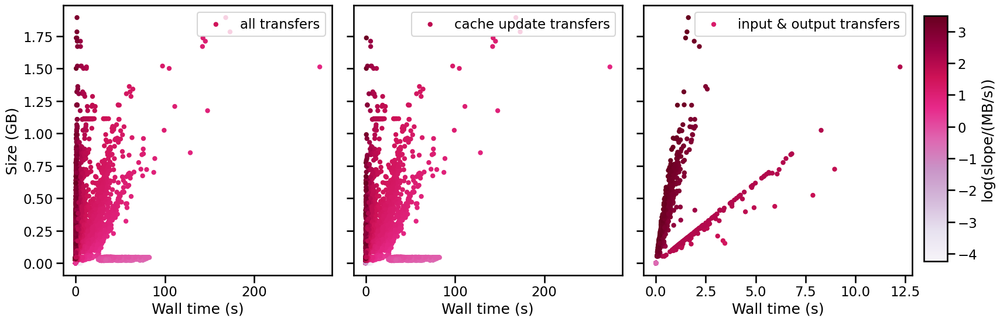

In [228]:
transfer_time_plot = transfer_time(transfers_t)

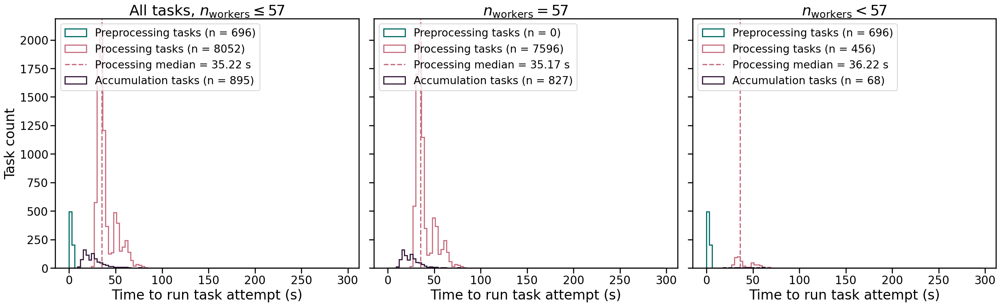

In [229]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 300, 3)

## Run 2025/07/17 184144

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* completed until server disconnection
* redirector: root://xrootd-local.unl.edu/

In [230]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-17T184144')

In [231]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-17T184144')

In [232]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 57
total workers active time = 38.62122875054677 mins, 0.6436871458424462 hours
Mean worker connection time = 33.103863613159334 mins, 0.5517310602193223 hours
# tasks on this run = 9732


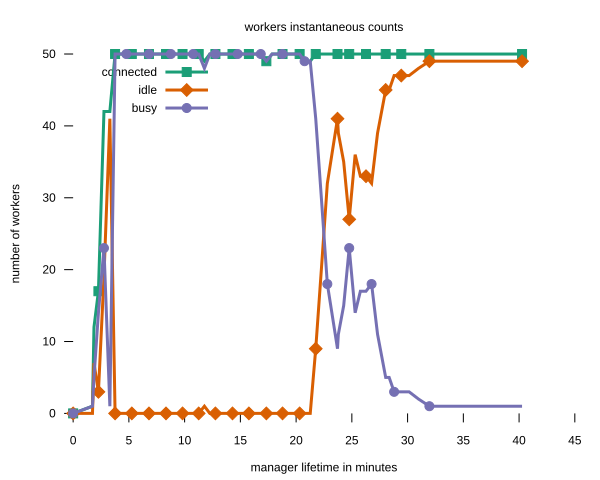

In [233]:
worker_svg

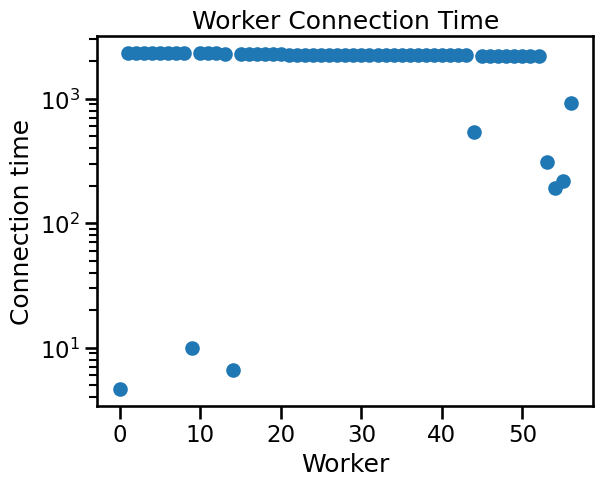

In [234]:
worker_conn_time = plot_worker_times(workers_t)

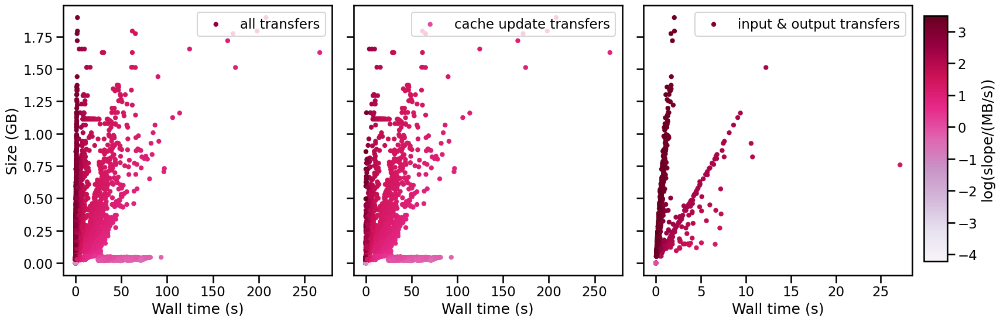

In [235]:
transfer_time_plot = transfer_time(transfers_t)

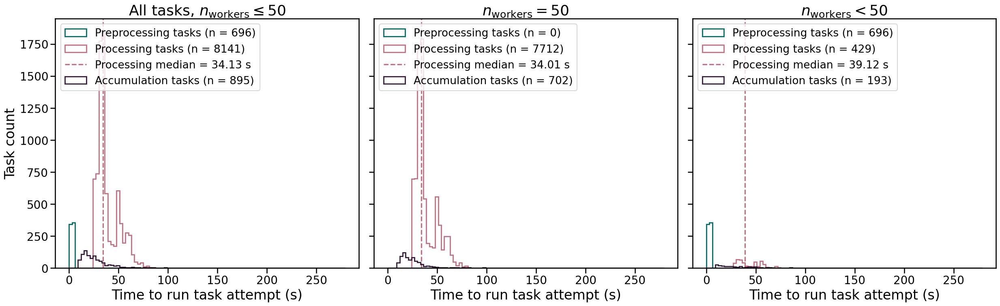

In [236]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 280, 3)

## REDIRECTOR SWITCH

## Run 2025/07/15 182557

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard interrupt @ 100%

In [237]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-15T182557')

In [238]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-15T182557')

In [239]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 55
total workers active time = 64.24580076535543 mins, 1.0707633460892572 hours
Mean worker connection time = 61.04950135165995 mins, 1.0174916891943324 hours
# tasks on this run = 9639


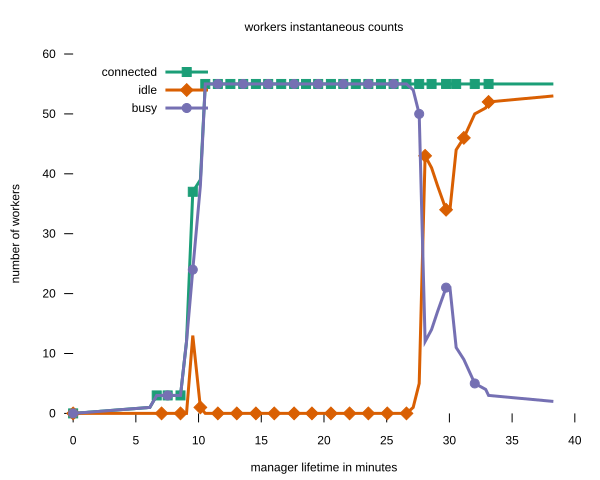

In [240]:
worker_svg

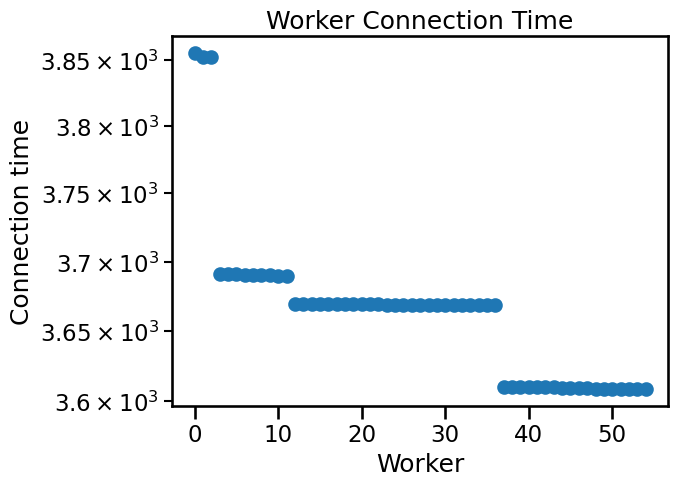

In [241]:
worker_conn_time = plot_worker_times(workers_t)

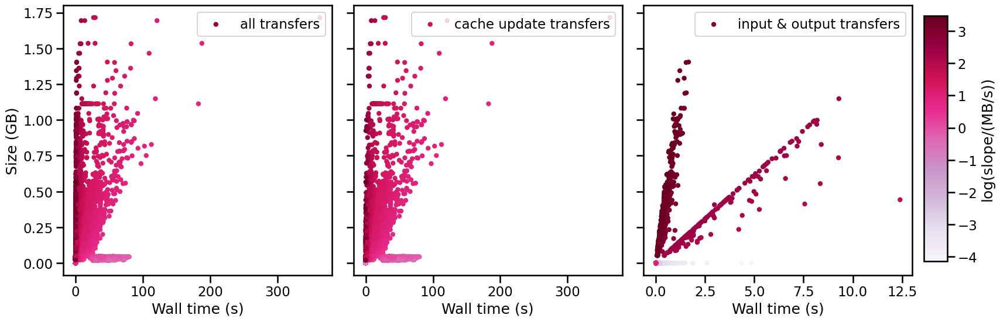

In [242]:
transfer_time_plot = transfer_time(transfers_t)

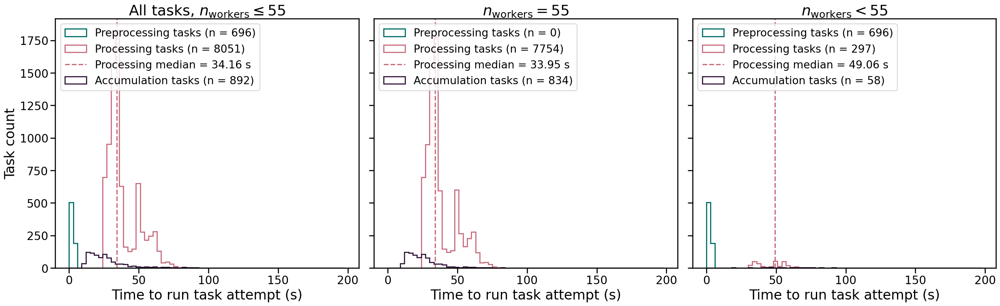

In [243]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 200, 3)

## Run 2025/07/15 165647

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard interrupt @ 100%

In [244]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-15T165647')

In [245]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-15T165647')

In [246]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 48
total workers active time = 81.35198639631271 mins, 1.3558664399385452 hours
Mean worker connection time = 75.69347507109245 mins, 1.2615579178515408 hours
# tasks on this run = 9638


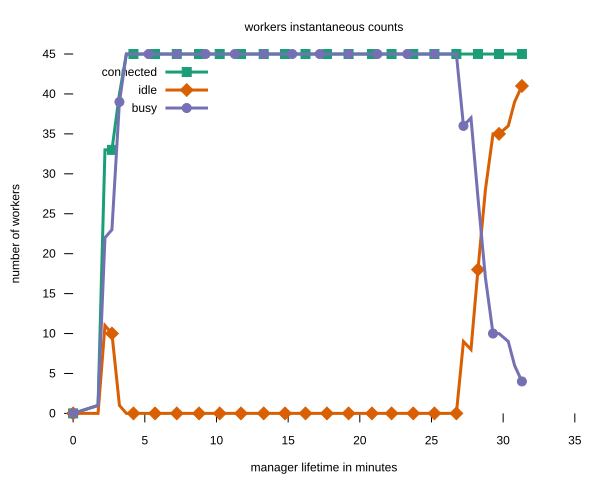

In [247]:
worker_svg

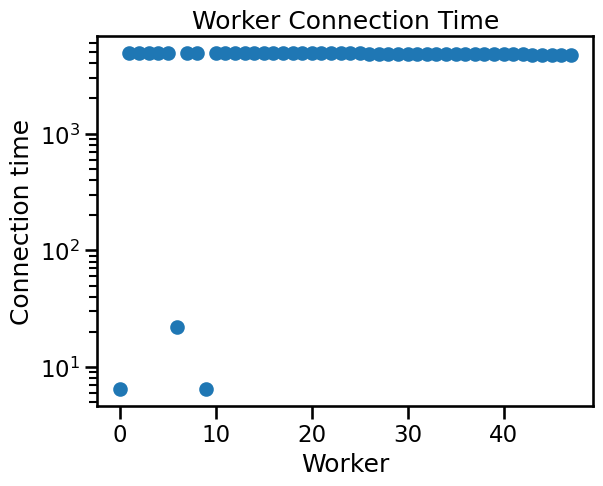

In [248]:
worker_conn_time = plot_worker_times(workers_t)

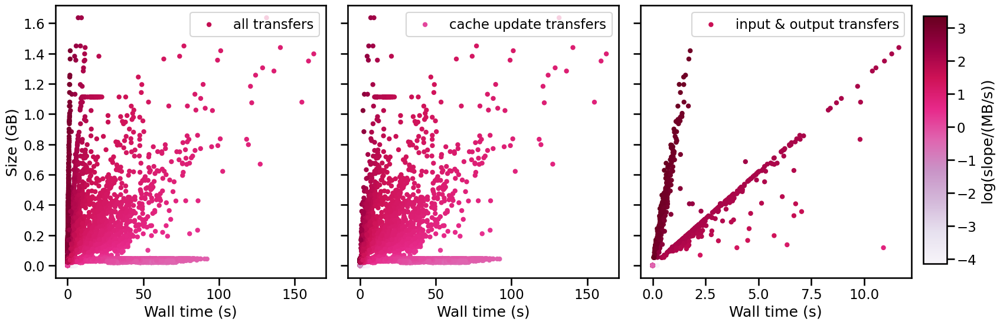

In [249]:
transfer_time_plot = transfer_time(transfers_t)

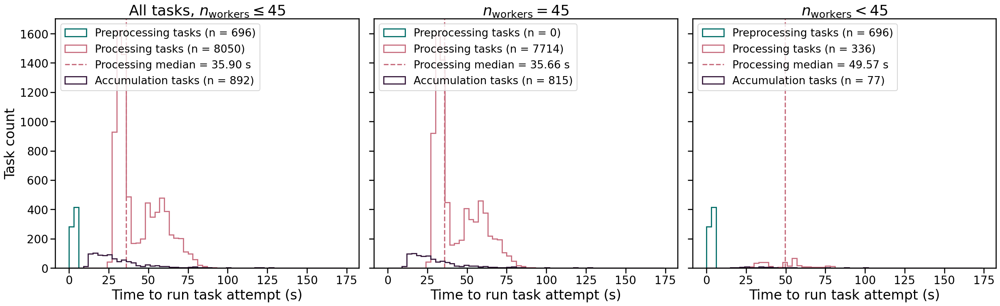

In [250]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 175, 3)

## Run 2025/07/15 150503

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* had to keyboard interrupt @ 100%

In [251]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-15T150503')

In [252]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-15T150503')

In [253]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 44
total workers active time = 107.11302508115769 mins, 1.7852170846859614 hours
Mean worker connection time = 97.02255079637874 mins, 1.617042513272979 hours
# tasks on this run = 9638


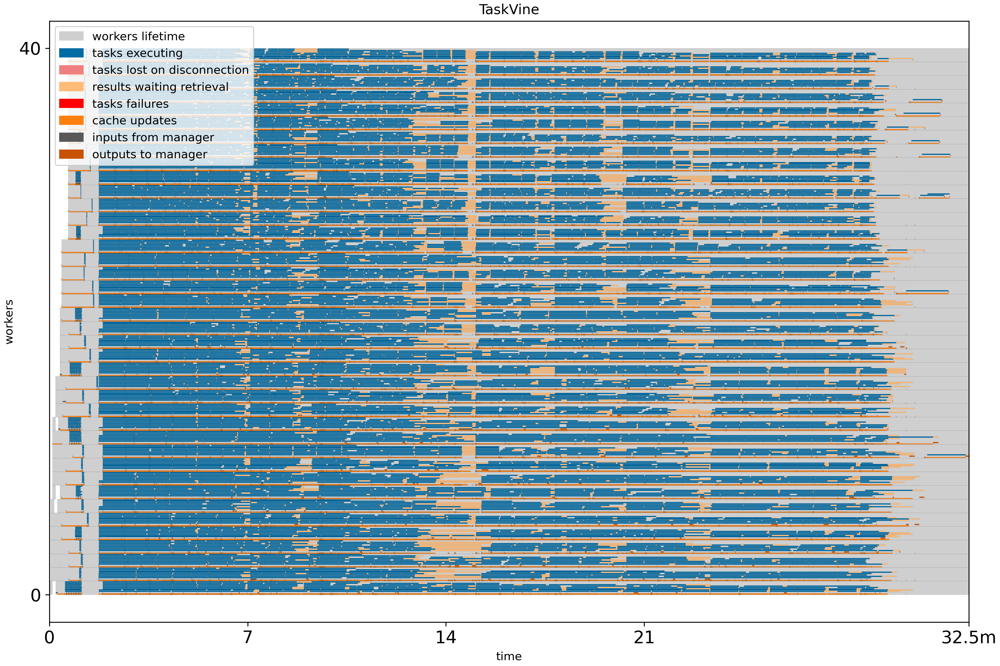

In [254]:
workers

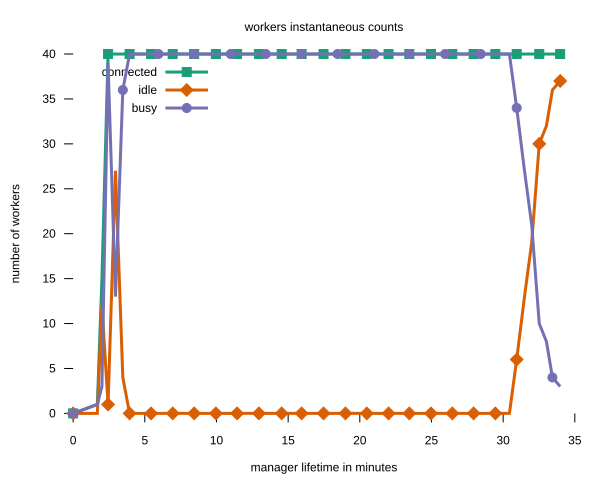

In [255]:
worker_svg

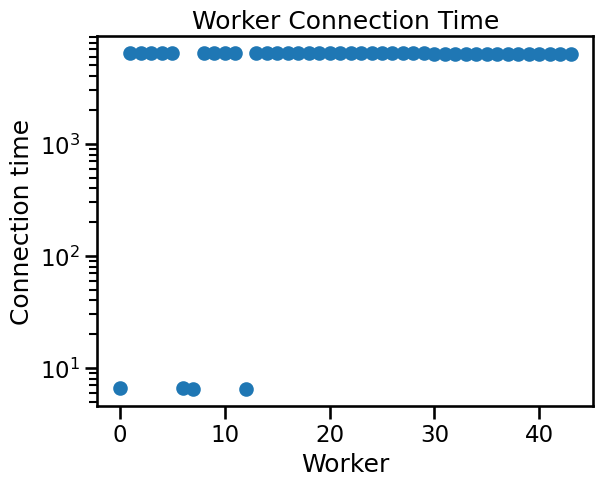

In [256]:
worker_conn_time = plot_worker_times(workers_t)

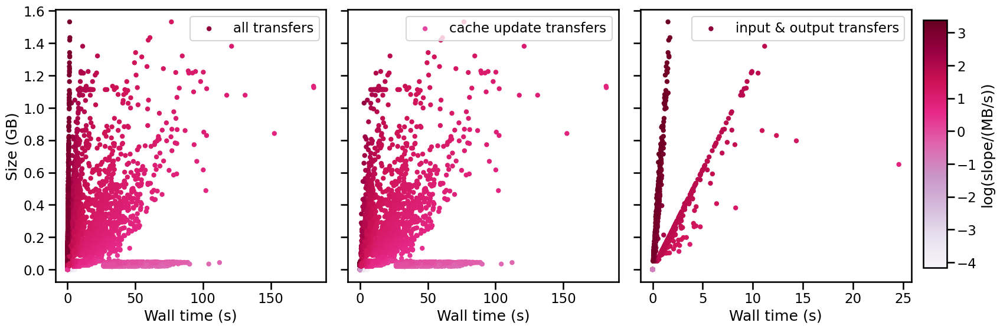

In [257]:
transfer_time_plot = transfer_time(transfers_t)

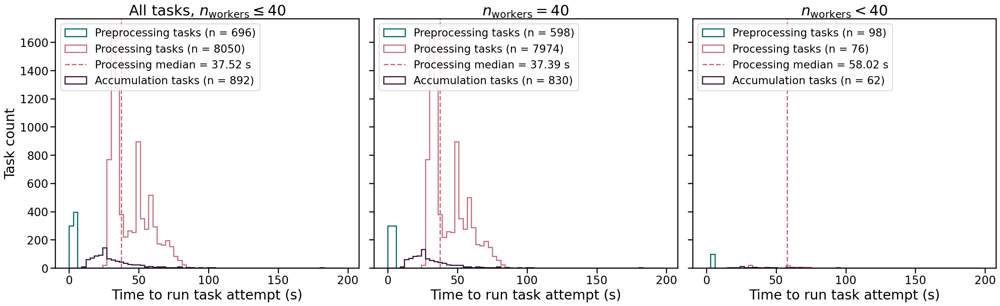

In [258]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 200, 3)

## Run 2025/07/15 142041

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* finished till server disconnection
* good workers for poster!

In [259]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-15T142041')

In [260]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-15T142041')

In [261]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 36
total workers active time = 38.670462266604105 mins, 0.6445077044434018 hours
Mean worker connection time = 37.17495538791021 mins, 0.6195825897985034 hours
# tasks on this run = 9642


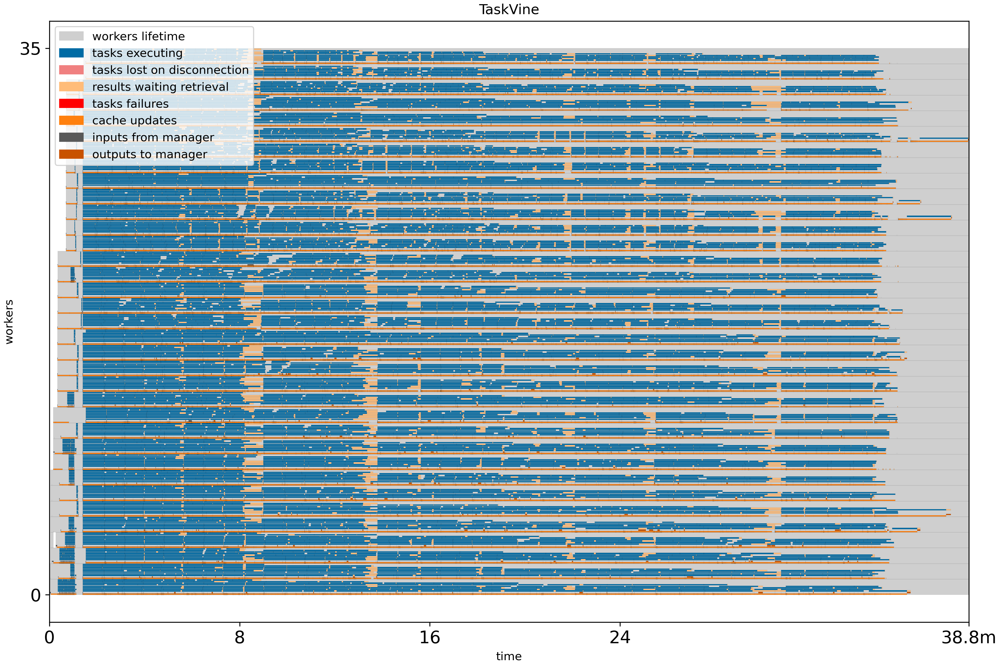

In [262]:
workers

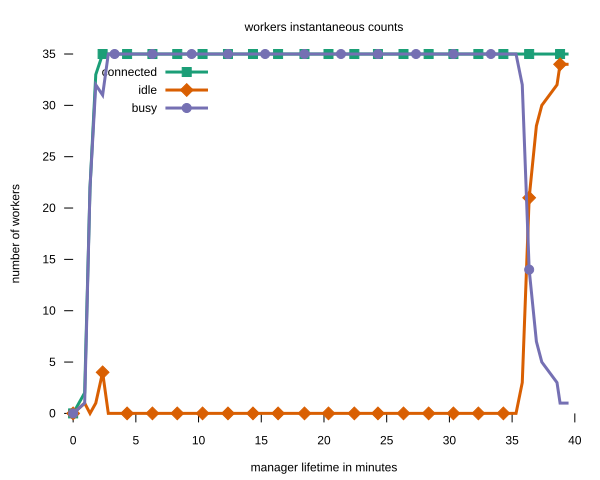

In [263]:
worker_svg

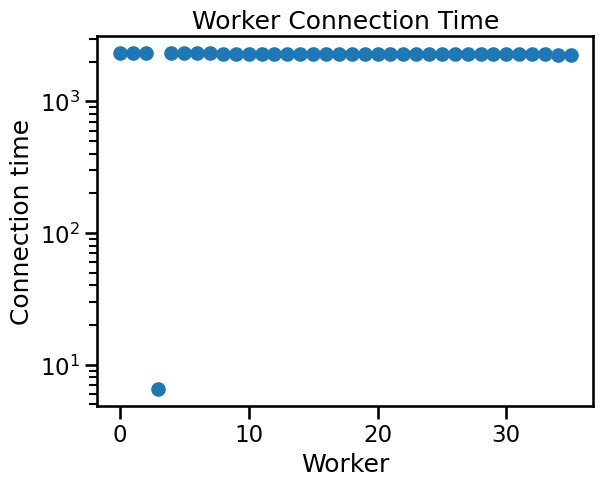

In [264]:
worker_conn_time = plot_worker_times(workers_t)

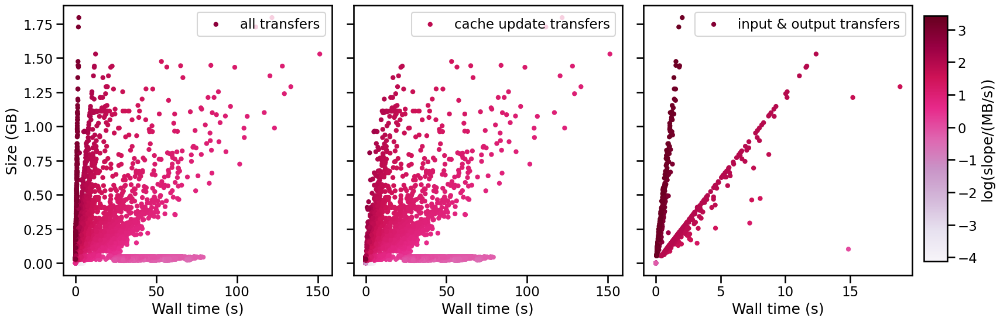

In [265]:
transfer_time_plot = transfer_time(transfers_t)

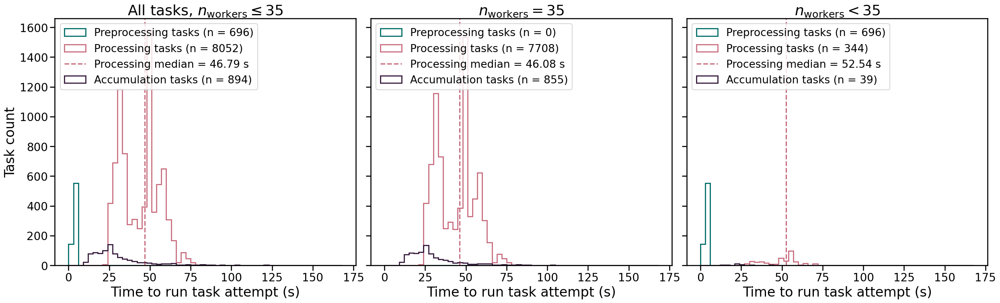

In [266]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 170, 3)

## Run 2025/07/15 025350

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* did not finish (like 60%)

In [267]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-15T025350')

In [268]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-15T025350')

In [269]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 7
total workers active time = 683.4205871502559 mins, 11.39034311917093 hours
Mean worker connection time = 585.1942257824398 mins, 9.753237096373997 hours
# tasks on this run = 6293


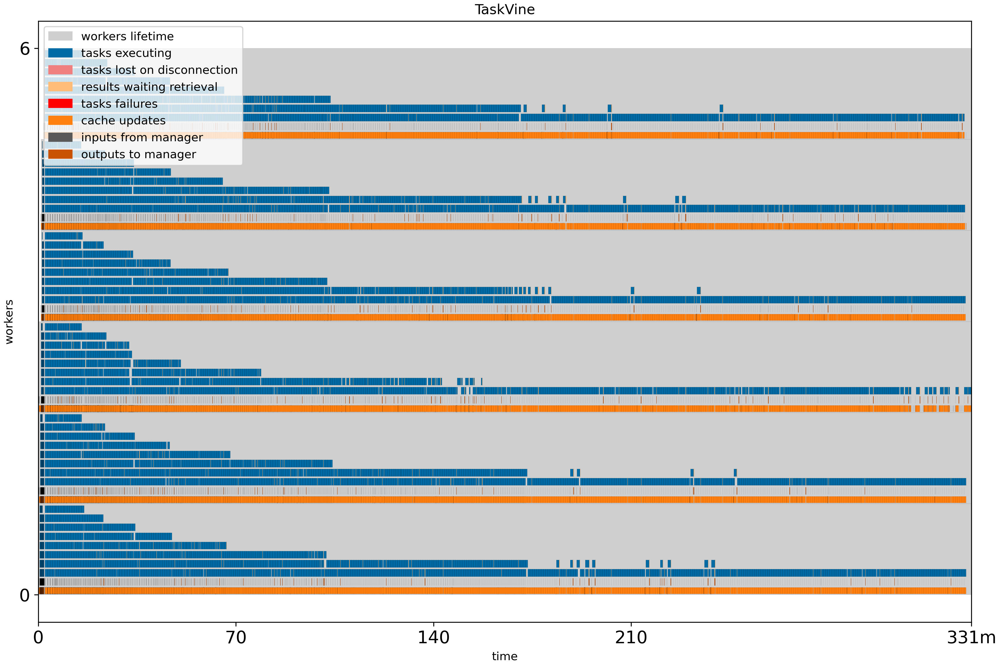

In [270]:
workers

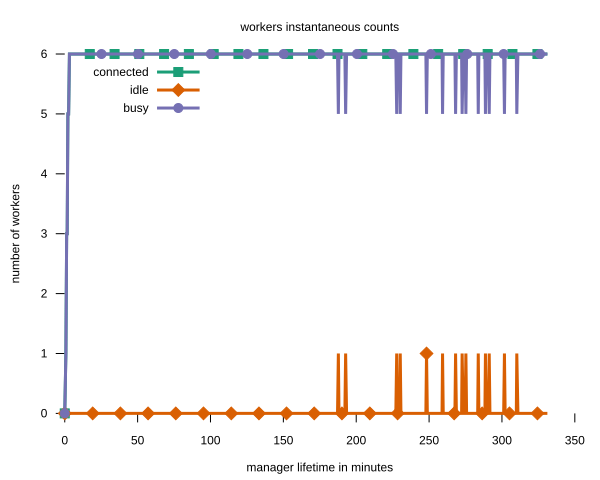

In [271]:
worker_svg

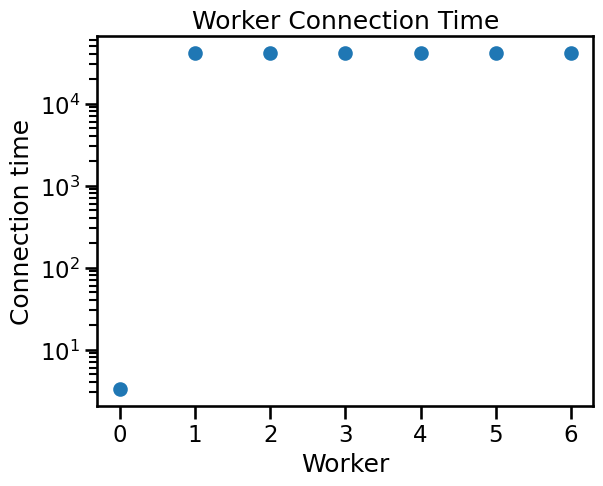

In [272]:
worker_conn_time = plot_worker_times(workers_t)

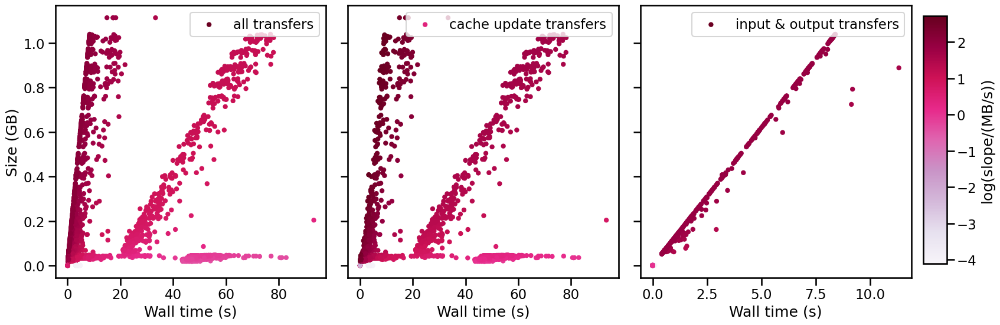

In [273]:
transfer_time_plot = transfer_time(transfers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


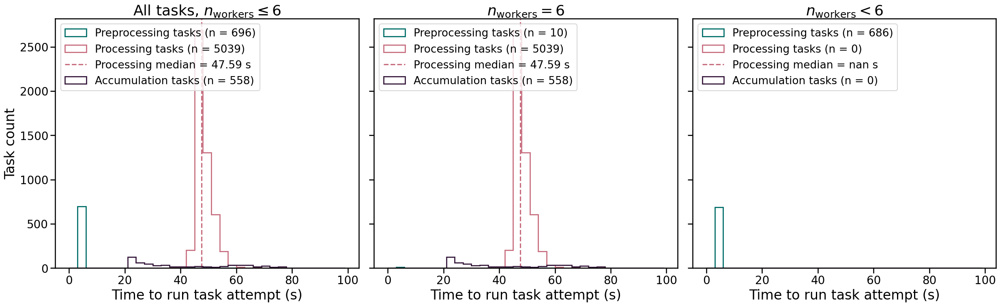

In [274]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 100, 3)

## Run 2025/07/14 203248

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* did not finish (like 60%)

In [275]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-14T203248')

In [276]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-14T203248')

In [277]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 6
total workers active time = 364.85890160004305 mins, 6.080981693334051 hours
Mean worker connection time = 303.7803518215816 mins, 5.063005863693026 hours
# tasks on this run = 5016


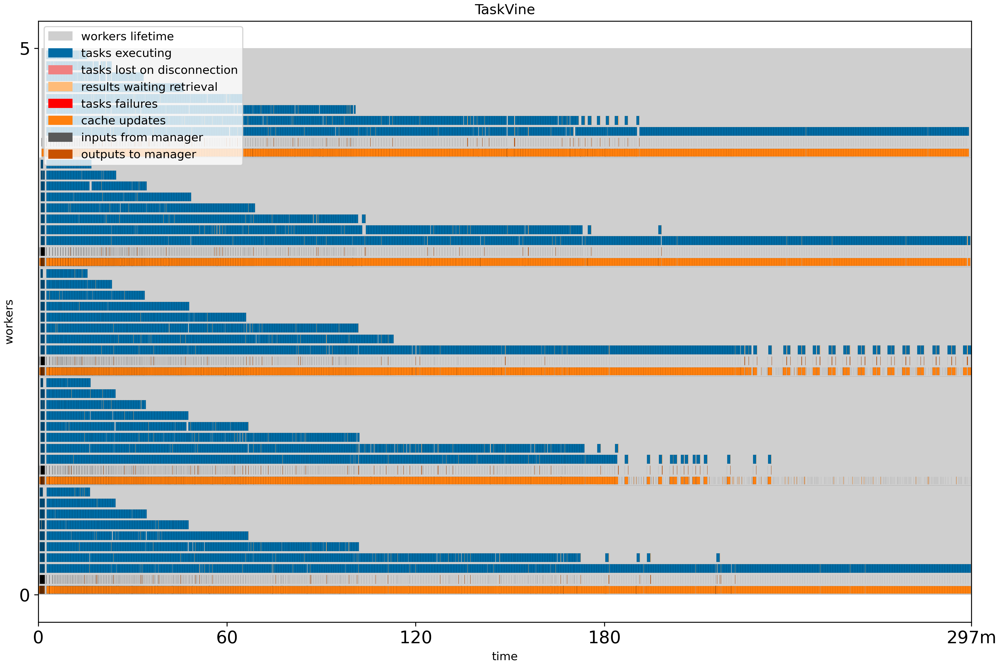

In [278]:
workers

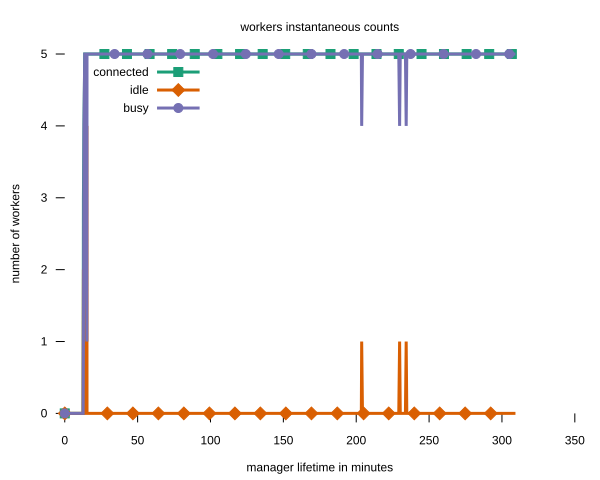

In [279]:
worker_svg

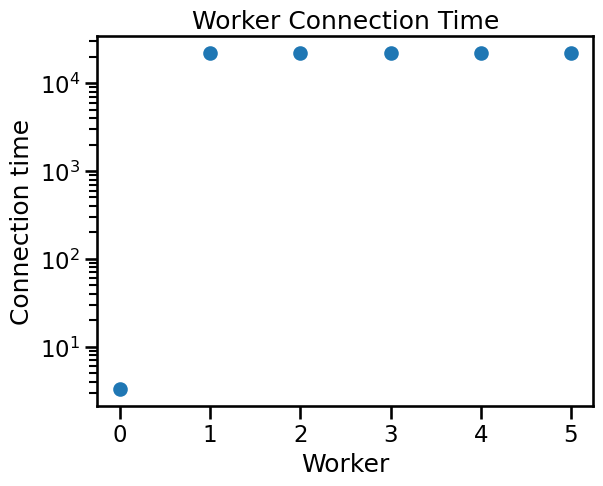

In [280]:
worker_conn_time = plot_worker_times(workers_t)

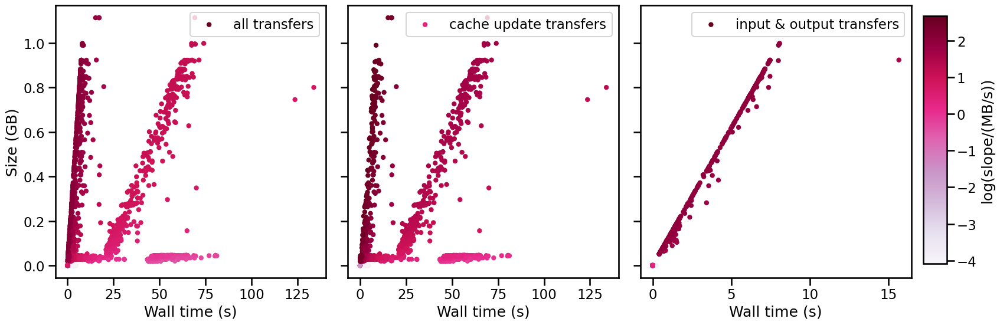

In [281]:
transfer_time_plot = transfer_time(transfers_t)

In [282]:
tasks_t

,task_id,attempt_number,category,READY,RUNNING,WAITING_RETRIEVAL,RETRIEVED,DONE,reason,exit_code,last_state,last_state_time,DISCONNECTION,requested_cores,requested_memory,requested_disk,requested_gpus,allocated_cores,allocated_memory,allocated_disk,allocated_gpus,measured_cores,measured_memory,measured_disk,measured_gpus,measured_wall_time,library,worker_id,time_input_mgr,time_output_mgr,size_input_mgr,size_output_mgr,time_worker_start,time_worker_end,time_commit_start,time_commit_end,slot
0,1,1,preprocessing,0.005154,815.781604,819.298058,819.301964,819.318425,SUCCESS,0.0,DONE,819.318425,NaN,1.0,3500.0,NaN,NaN,1.0,4100.0,14250.0,0.0,1.0,4100.0,14250.0,0.0,3.513406,NaN,worker-bea50258265c1c4b56f7f3f516ca6ca6,0.000305,0.002696,0.000288,0.000360,815.782756,819.296162,815.781273,815.781578,5
1,2,1,preprocessing,0.005949,827.615745,830.950333,830.951328,830.957985,SUCCESS,0.0,DONE,830.957985,NaN,1.0,3500.0,NaN,NaN,1.0,4100.0,15250.0,0.0,1.0,4100.0,15250.0,0.0,3.331040,NaN,worker-4625a00b267373bd5b5b4d3234c26b31,0.000226,0.000859,0.000292,0.000360,827.615719,830.946759,827.615493,827.615719,5
2,3,1,preprocessing,0.006661,799.064849,802.532956,802.536328,802.543254,SUCCESS,0.0,DONE,802.543254,NaN,1.0,3500.0,NaN,NaN,1.0,4100.0,13250.0,0.0,1.0,4100.0,13250.0,0.0,3.464471,NaN,worker-405c036a0c9c8bc46c59530d6efa2b55,0.000272,0.002235,0.000280,0.000357,799.064827,802.529298,799.064555,799.064827,5
3,4,1,preprocessing,0.007335,808.994703,812.481007,812.482540,812.498804,SUCCESS,0.0,DONE,812.498804,NaN,1.0,3500.0,NaN,NaN,1.0,4100.0,13750.0,0.0,1.0,4100.0,13750.0,0.0,3.483343,NaN,worker-bea50258265c1c4b56f7f3f516ca6ca6,0.000298,0.001412,0.000280,0.000357,808.994989,812.478332,808.994381,808.994679,4
4,5,1,preprocessing,0.008065,820.600842,824.222403,824.223170,824.229566,SUCCESS,0.0,DONE,824.229566,NaN,1.0,3500.0,NaN,NaN,1.0,4100.0,14750.0,0.0,1.0,4100.0,14750.0,0.0,3.617232,NaN,worker-405c036a0c9c8bc46c59530d6efa2b55,0.000271,0.000650,0.000288,0.000360,820.600819,824.218051,820.600548,820.600819,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5011,5112,1,processing,18416.567106,18427.149614,18490.015194,18490.015414,18490.061034,SUCCESS,0.0,DONE,18490.061034,NaN,1.0,3500.0,102500.0,0.0,6.0,26180.0,102500.0,0.0,6.0,26180.0,102500.0,0.0,49.822915,NaN,worker-bea50258265c1c4b56f7f3f516ca6ca6,0.000454,0.000057,0.000342,0.000000,18427.150661,18476.973576,18427.149134,18427.149588,1
5012,5113,1,processing,18430.869088,18450.703284,18498.717016,18498.717172,18498.717736,SUCCESS,0.0,DONE,18498.717736,NaN,1.0,3500.0,102500.0,0.0,6.0,26059.0,102500.0,0.0,6.0,26059.0,102500.0,0.0,48.009416,NaN,worker-405c036a0c9c8bc46c59530d6efa2b55,0.000432,0.000025,0.000342,0.000000,18450.704264,18498.713680,18450.702826,18450.703258,1
5013,5114,1,processing,18451.270411,18461.056004,18514.762535,18514.762739,18514.774453,SUCCESS,0.0,DONE,18514.774453,NaN,1.0,3500.0,102500.0,0.0,6.0,26322.0,102750.0,0.0,6.0,26322.0,102750.0,0.0,53.493212,NaN,worker-77ad417c629ec8ba1d16bbe95bcab84f,0.000436,0.000053,0.000342,0.000000,18461.058266,18514.551478,18461.055543,18461.055979,1
5014,5116,1,processing,18489.984954,18490.015794,18539.634847,18539.634999,18539.635467,SUCCESS,0.0,DONE,18539.635467,NaN,1.0,3500.0,102750.0,0.0,6.0,26252.0,102750.0,0.0,6.0,26252.0,102750.0,0.0,49.614275,NaN,worker-bea50258265c1c4b56f7f3f516ca6ca6,0.000228,0.000023,0.000344,0.000000,18490.016765,18539.631040,18490.015543,18490.015771,1


Text(0, 0.5, 'Allocated cores')

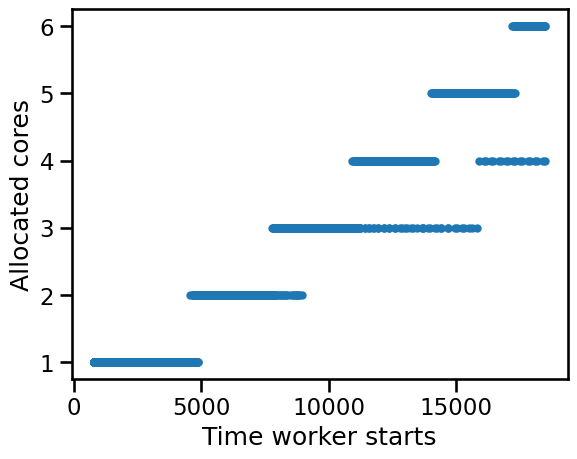

In [283]:
plt.scatter(tasks_t.time_worker_start, tasks_t.allocated_cores, marker='.')
plt.xlabel("Time worker starts")
plt.ylabel("Allocated cores")

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


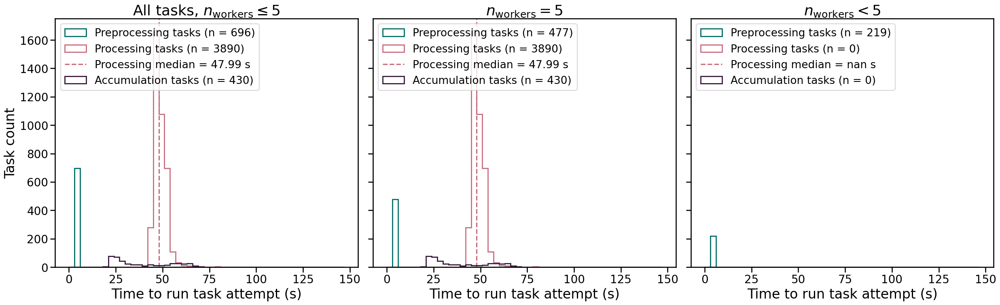

In [284]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 150, 3)

## Run 2025/07/14 181555 -- Chosen single run

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* stable run

In [105]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-14T181555')

In [106]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-14T181555')

In [107]:
workers

In [108]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 22
total workers active time = 128.6914315144221 mins, 2.144857191907035 hours
Mean worker connection time = 116.7439232710636 mins, 1.9457320545177266 hours
# tasks on this run = 9634


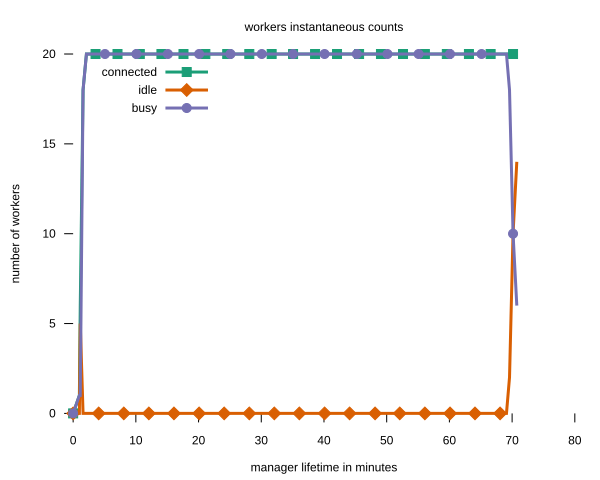

In [109]:
worker_svg

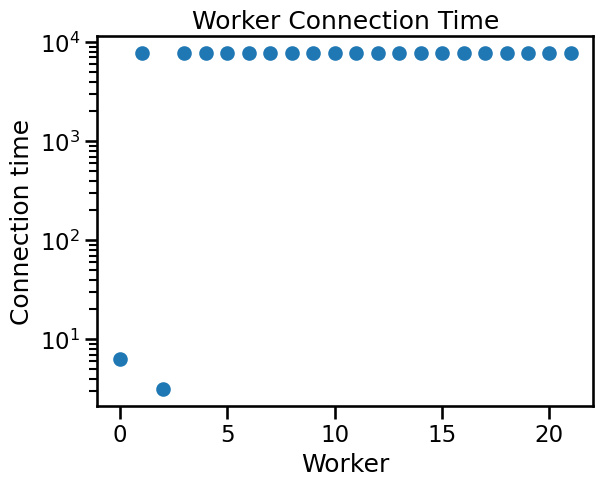

In [110]:
worker_conn_time = plot_worker_times(workers_t)

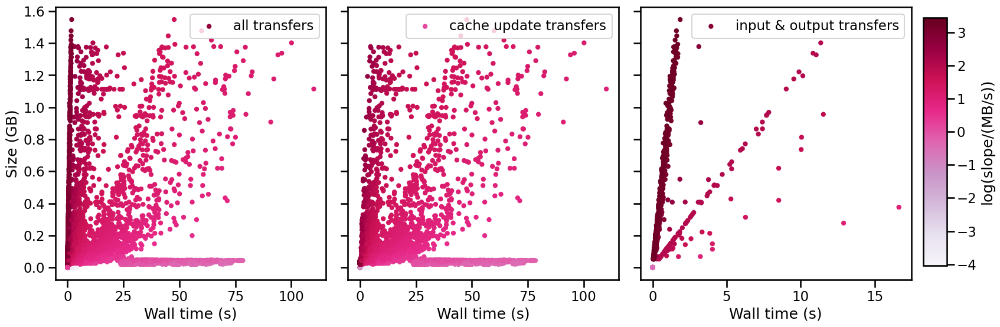

In [111]:
transfer_time_plot = transfer_time(transfers_t)
#transfer_time_plot.savefig('poster_figs/transfer_times.png', dpi=400)

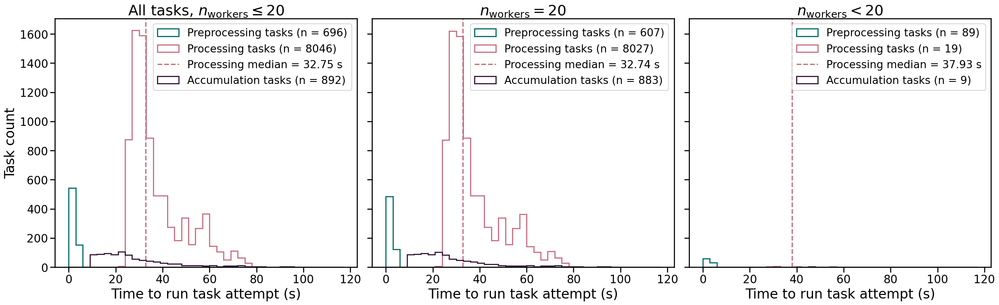

In [113]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 120, 3)
task_time_hist.savefig('poster_figs/task_time_hist.png', dpi=1000)
#task_time_hist.savefig('poster_figs/proc_time_med_hist.png', dpi=1000)
#task_time_hist.savefig('poster_figs/proc_time_quant_hist.png', dpi=1000)

In [293]:
performance_t

,timestamp,lifetime,workers_connected,workers_init,workers_idle,workers_busy,workers_able,workers_joined,workers_removed,workers_released,workers_idled_out,workers_blocked,workers_slow,workers_lost,tasks_waiting,tasks_on_workers,tasks_running,tasks_with_results,tasks_submitted,tasks_dispatched,tasks_done,tasks_failed,tasks_cancelled,tasks_exhausted_attempts,time_send,time_receive,time_send_good,time_receive_good,time_status_msgs,time_internal,time_polling,time_application,time_scheduling,time_execute,time_execute_good,time_execute_exhaustion,bytes_sent,bytes_received,bandwidth,capacity_tasks,capacity_cores,capacity_memory,capacity_disk,capacity_instantaneous,capacity_weighted,total_cores,total_memory,total_disk,committed_cores,committed_memory,committed_disk,max_cores,max_memory,max_disk,min_cores,min_memory,min_disk,inuse_cache
0,1752516955689542,0.000000e+00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.000000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1752516955689637,9.500000e+01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.000000,10,10,5120,10240,10,10,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1752517015428510,5.973897e+07,1,0,0,1,1,1,0,0,0,0,0,0,695,1,1,0,696,0,0,0,0,0,64372,192,0,0,11969,65682,55910318,478737,23145,0,0,0,407439305,0,1.000000,10,10,5120,10240,10,10,8,32800,131074,0,0,0,8,32800,131074,8,32800,131074,389
3,1752517018560057,6.287052e+07,7,0,2,5,7,7,0,0,0,0,0,0,663,33,33,0,696,33,0,0,0,0,6361332,201,0,0,53431,66060,55910380,478737,26193,0,0,0,814887849,0,122.162003,10,10,5120,10240,10,10,56,229600,917514,33,135300,406413,8,32800,131074,8,32800,131073,1943
4,1752517023944767,6.825522e+07,6,0,5,1,6,8,2,0,0,0,0,0,688,8,8,0,696,64,40,0,0,0,7709347,2463,0,0,63670,86741,59913755,478767,34589,0,0,0,1222336078,0,151.159134,10,10,41000,122560,0,10,48,196800,786440,8,32800,98439,8,32800,131074,8,32800,131073,389
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8161,1752521180309434,4.224620e+09,20,0,13,7,20,22,2,0,0,0,0,0,0,8,8,0,9640,9696,9672,0,0,0,242013186,761725610,0,759893041,2981642,3850707,3000902596,212804227,219773554,329311867835,329311867835,0,1701578641,334384436603,319.322718,12,29,147143,572694,2,2506,160,656000,2621463,14,75141,337112,8,32800,131074,8,32800,131073,33394
8162,1752521185844126,4.230155e+09,20,0,13,7,20,22,2,0,0,0,0,0,0,9,8,1,9640,9696,9672,0,0,0,242013187,761725629,0,759893041,2981792,3850767,3006380675,212860507,219773554,329359546035,329311867835,0,1701578641,334384436603,319.322712,12,29,147274,573245,22,2382,160,656000,2621463,14,75141,338589,8,32800,131074,8,32800,131073,33170
8163,1752521187705718,4.232016e+09,20,0,14,6,20,22,2,0,0,0,0,0,0,7,7,0,9640,9696,9673,0,0,0,242013187,763587141,0,761754076,2981890,3850805,3006380675,212860507,219773554,329359546035,329359546035,0,1701578641,335932301966,320.199538,12,29,147274,573245,22,2152,160,656000,2621463,11,62256,287299,8,32800,131074,8,32800,131073,33170
8164,1752521200554436,4.244865e+09,20,0,14,6,20,22,2,0,0,0,0,0,0,8,7,1,9640,9696,9673,0,0,0,242013188,763587178,0,761754076,2982096,3850930,3019167878,212921517,219773554,329399008336,329359546035,0,1701578641,335932301966,320.199526,11,27,135141,525924,4,2045,160,656000,2621463,11,62256,287991,8,32800,131074,8,32800,131073,29804


Text(0, 0.5, 'Number of workers')

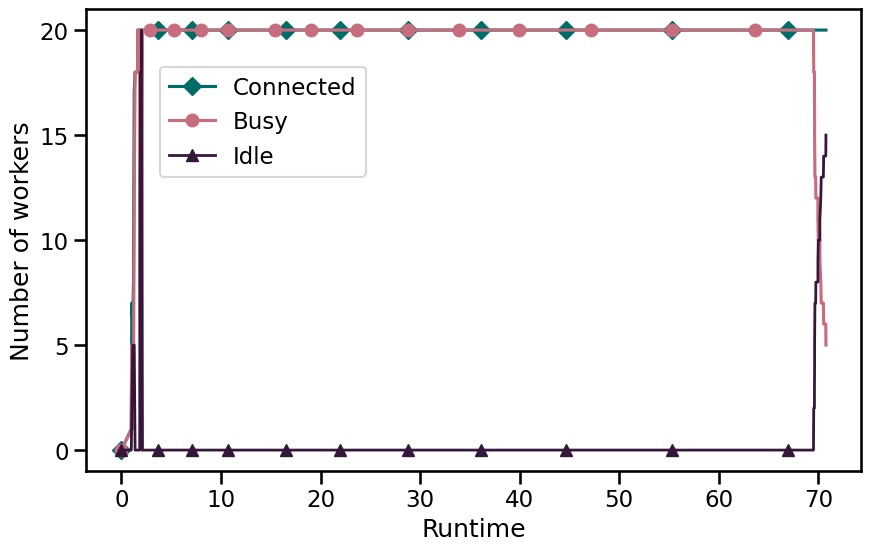

In [294]:
plt.figure(figsize=(10,6))

plt.plot(performance_t.lifetime/6e7, performance_t.workers_connected, marker='D', label="Connected", markevery=800, color='#006c67')
plt.plot(performance_t.lifetime/6e7, performance_t.workers_busy, marker='o', label="Busy", markevery=600, color='#c76d7e')
plt.plot(performance_t.lifetime/6e7, performance_t.workers_idle, marker='^', label="Idle", markevery=800, color='#34173a', linewidth=2)
plt.yticks(np.arange(0, 21, 5))
plt.legend(bbox_to_anchor=(0.08, 0.9), loc='upper left')
plt.xlabel("Runtime")
plt.ylabel("Number of workers")
#plt.savefig('poster_figs/worker_conn.png', dpi=1000)

## Run 2025/07/14 154126

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* stable run

In [295]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-14T154126')

In [296]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-14T154126')

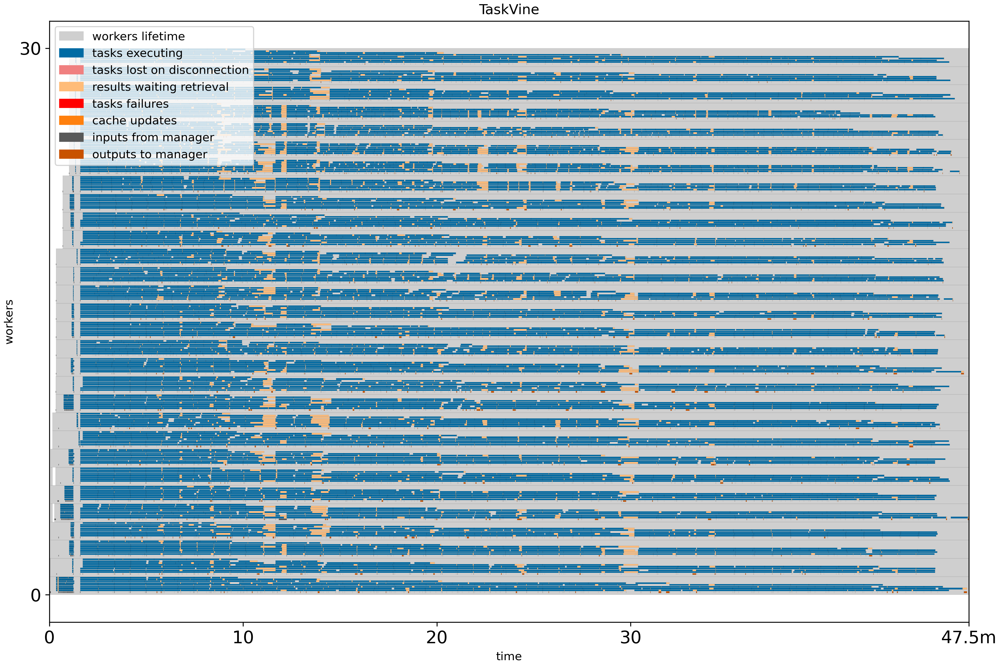

In [297]:
workers

In [298]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 32
total workers active time = 149.1581647157669 mins, 2.4859694119294486 hours
Mean worker connection time = 139.40019527338444 mins, 2.3233365878897407 hours
# tasks on this run = 9639


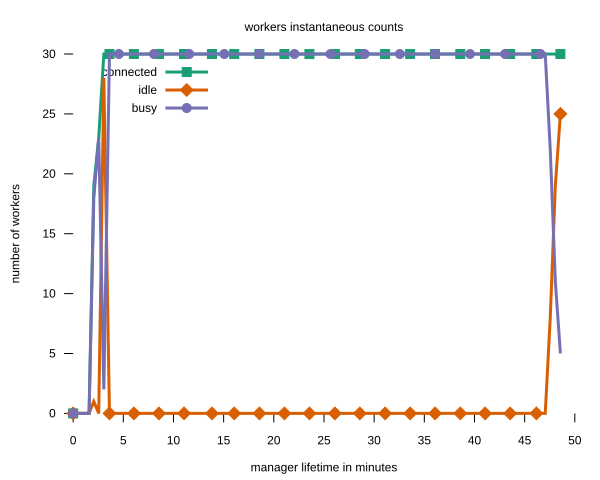

In [299]:
worker_svg

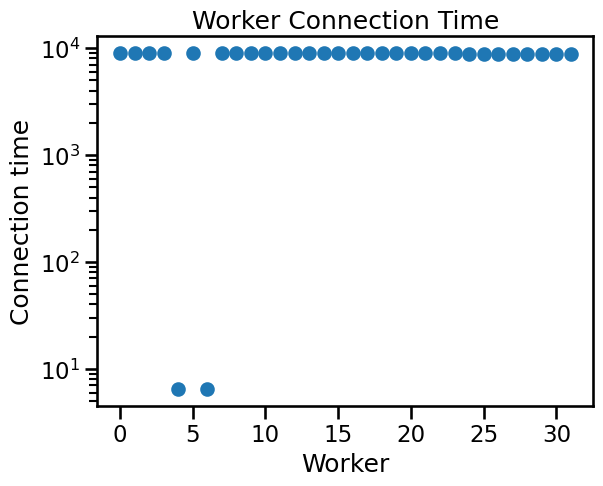

In [300]:
worker_conn_time = plot_worker_times(workers_t)

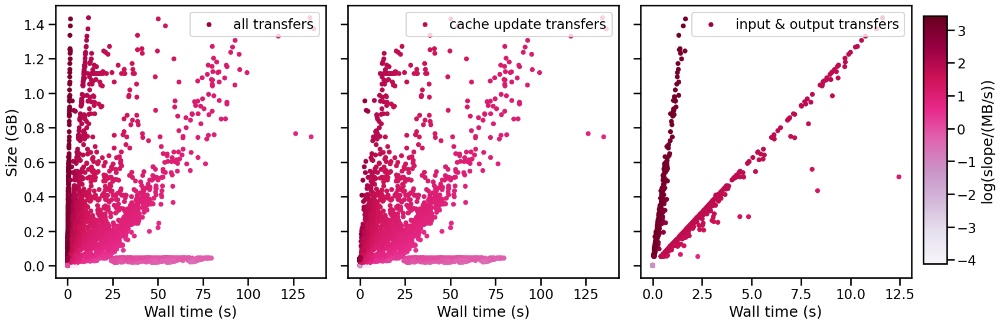

In [301]:
transfer_time_plot = transfer_time(transfers_t)

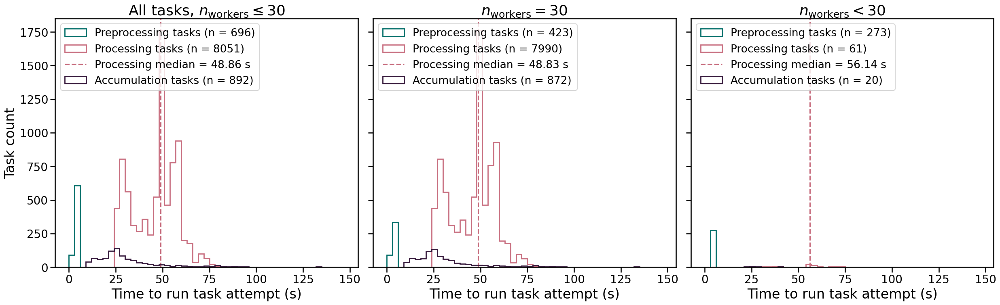

In [302]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 150, 3)

## Run 2025/07/14 011137

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* stable run

In [303]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-14T011137')

In [304]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-14T011137')

In [305]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 10
total workers active time = 630.0458237528802 mins, 10.50076372921467 hours
Mean worker connection time = 629.5965777480603 mins, 10.493276295801007 hours
# tasks on this run = 9492


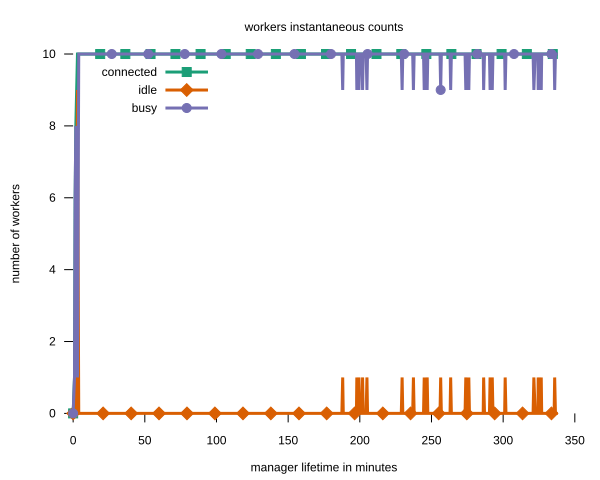

In [306]:
worker_svg

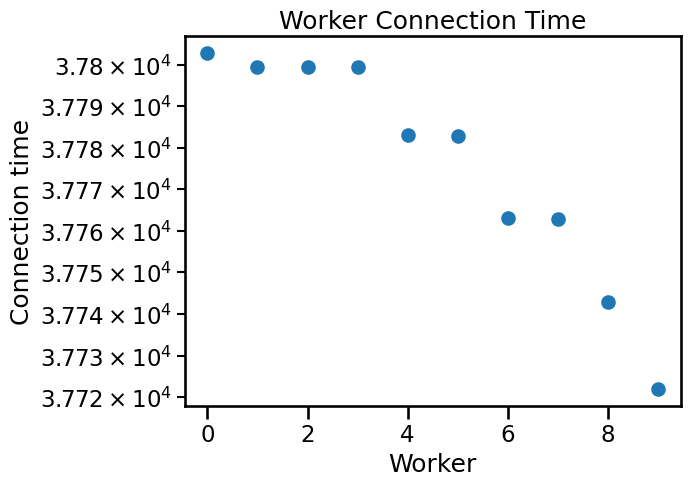

In [307]:
worker_conn_time = plot_worker_times(workers_t)

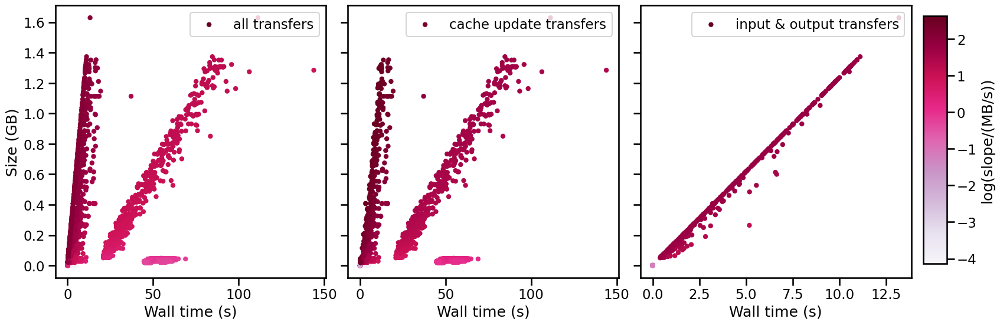

In [308]:
transfer_time_plot = transfer_time(transfers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


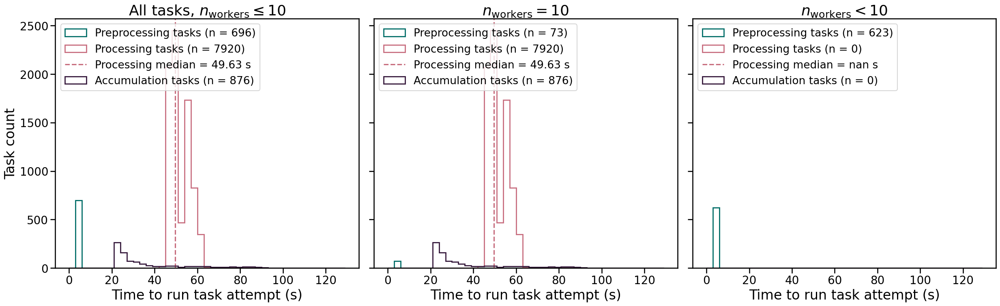

In [309]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 130, 3)

## Run 2025/07/13 210823

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* stable run

In [310]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-13T210823')

In [311]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-13T210823')

In [312]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 15
total workers active time = 239.71720589796698 mins, 3.9952867649661163 hours
Mean worker connection time = 222.84243981096475 mins, 3.714040663516079 hours
# tasks on this run = 9636


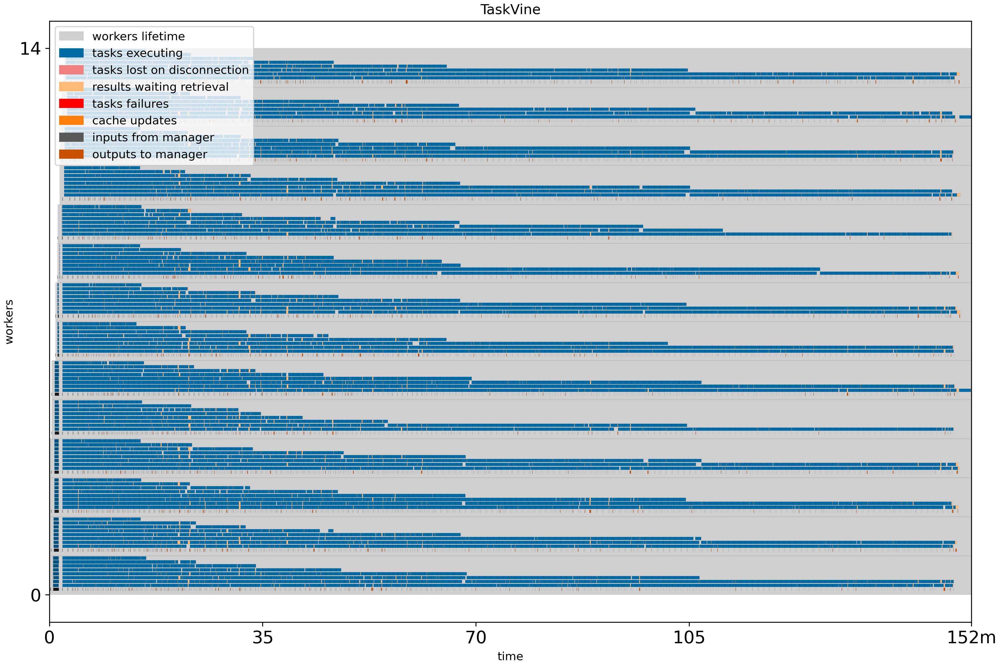

In [313]:
workers

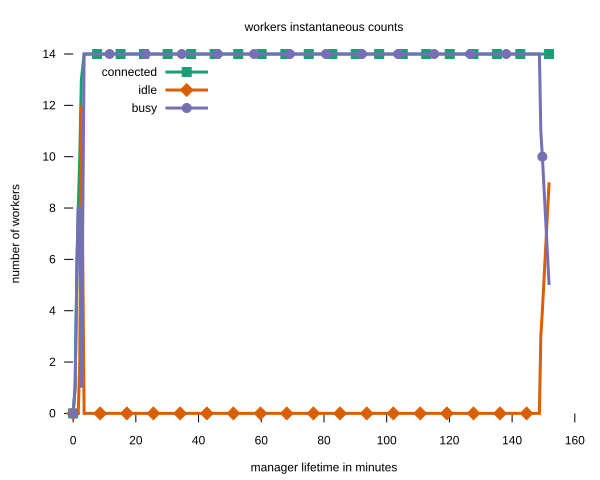

In [314]:
worker_svg

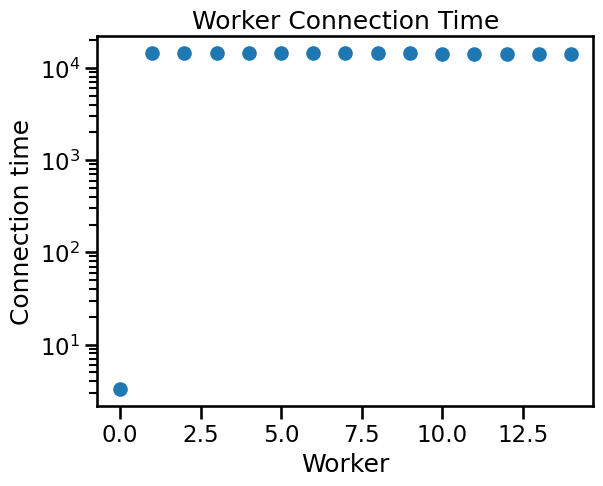

In [315]:
worker_conn_time = plot_worker_times(workers_t)

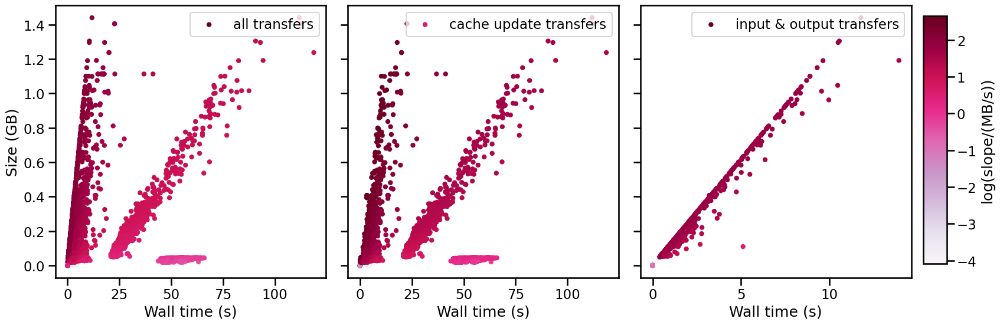

In [316]:
transfer_time_plot = transfer_time(transfers_t)

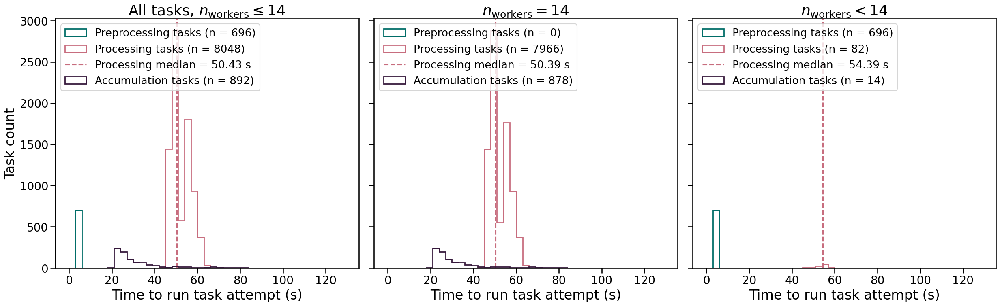

In [317]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 130, 3)

## Run 2025/07/13 183144

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* not a stable run

In [318]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-13T183144')

In [319]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-13T183144')

In [320]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 102
total workers active time = 153.28701023260754 mins, 2.5547835038767928 hours
Mean worker connection time = 91.45426862532017 mins, 1.524237810422003 hours
# tasks on this run = 9654


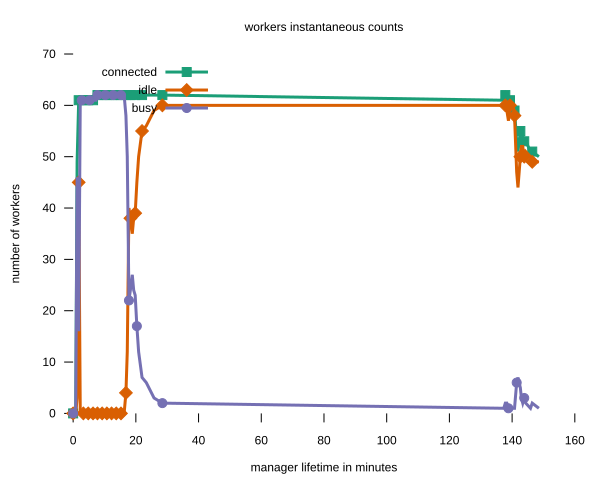

In [321]:
worker_svg

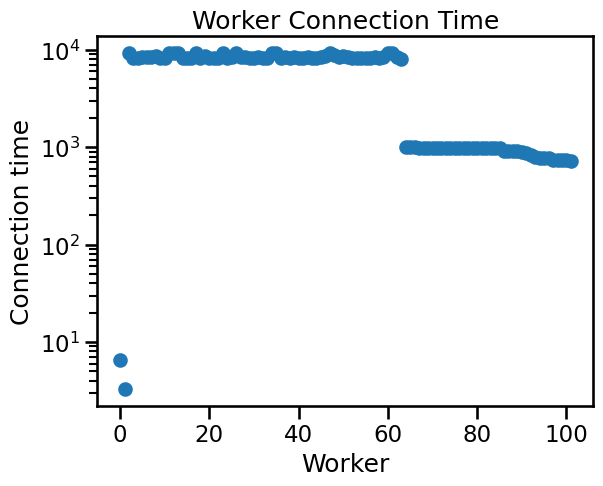

In [322]:
worker_conn_time = plot_worker_times(workers_t)

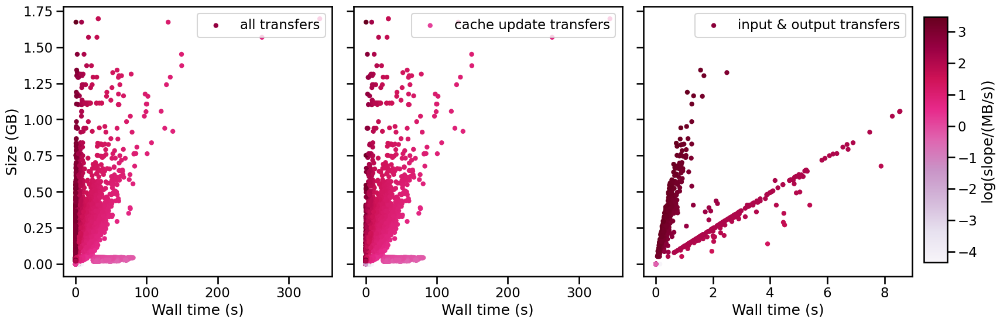

In [323]:
transfer_time_plot = transfer_time(transfers_t)

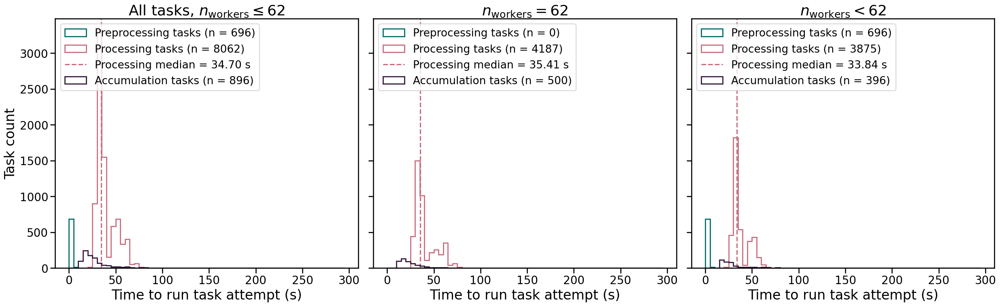

In [324]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 300, 5)

## Run 2025/07/13 061902

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* stable run

In [325]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-13T061902')

In [326]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-13T061902')

In [327]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 62
total workers active time = 24.193526351451872 mins, 0.40322543919086457 hours
Mean worker connection time = 24.054684032163312 mins, 0.4009114005360552 hours
# tasks on this run = 9643


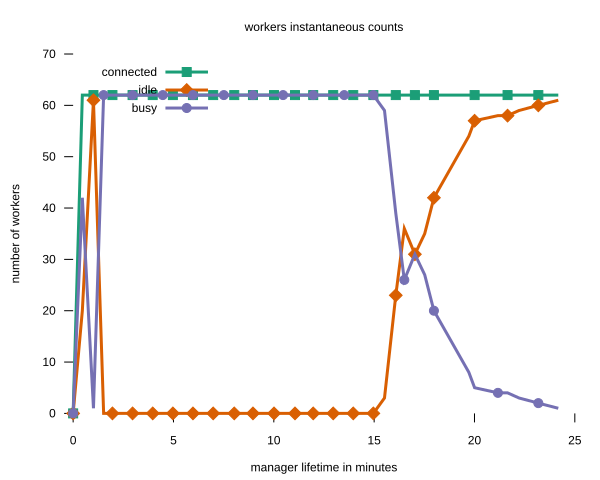

In [328]:
worker_svg

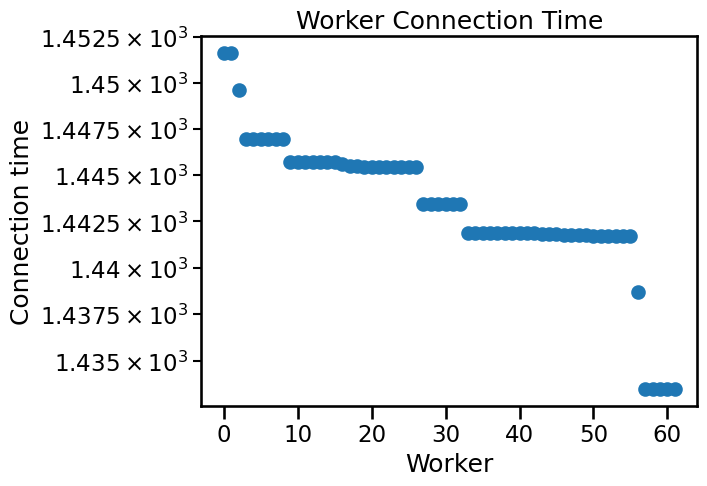

In [329]:
worker_conn_time = plot_worker_times(workers_t)

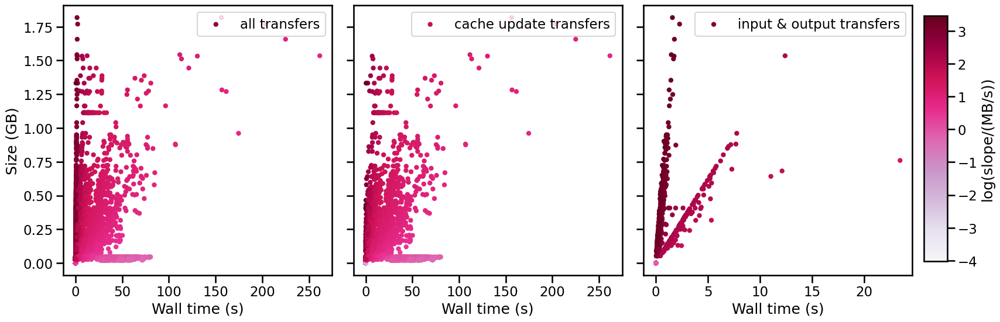

In [330]:
transfer_time_plot = transfer_time(transfers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


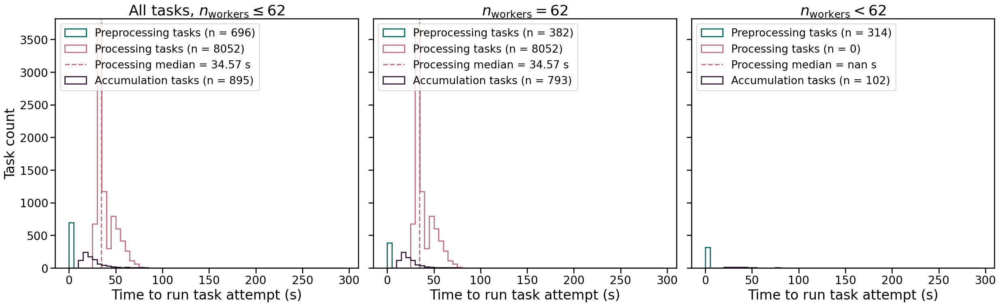

In [331]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 300, 5)

## Run 2025/07/13 054900

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* stable run

In [332]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-13T054900')

In [333]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-13T054900')

In [334]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 64
total workers active time = 25.434389166037242 mins, 0.4239064861006207 hours
Mean worker connection time = 24.514953460916878 mins, 0.40858255768194796 hours
# tasks on this run = 9644


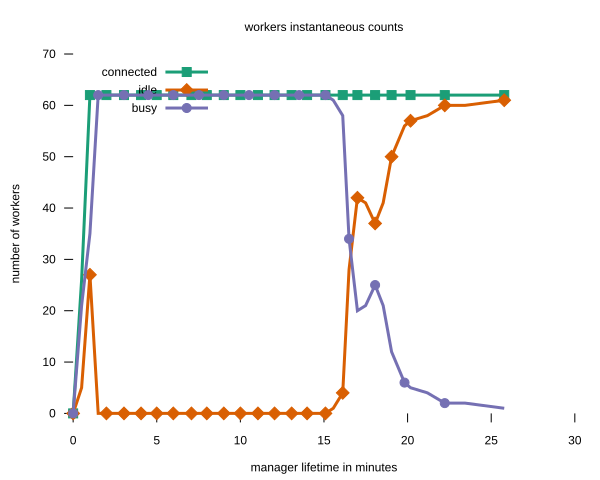

In [335]:
worker_svg

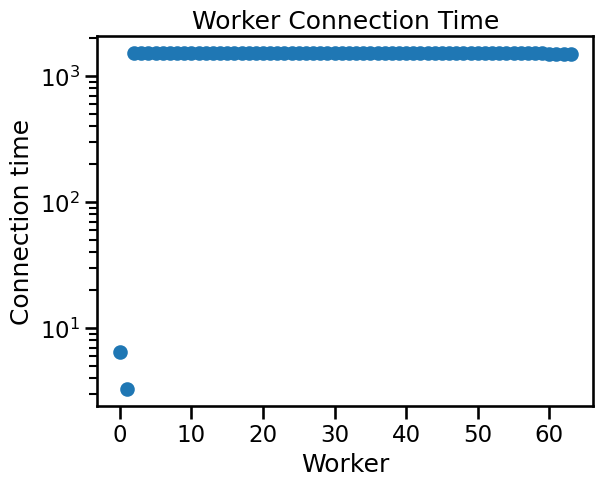

In [336]:
worker_conn_time = plot_worker_times(workers_t)

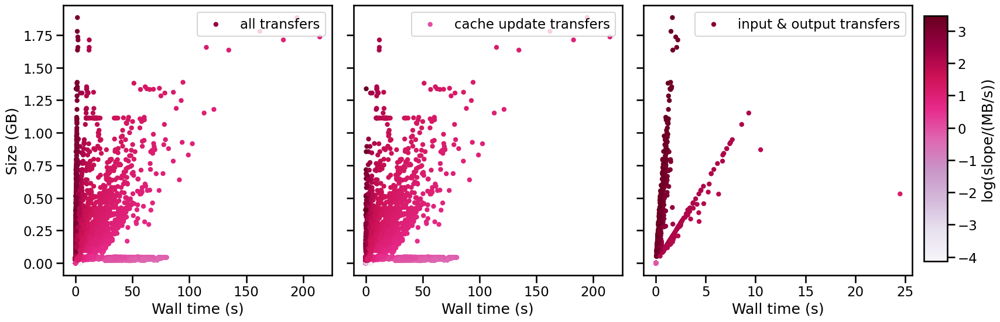

In [337]:
transfer_time_plot = transfer_time(transfers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


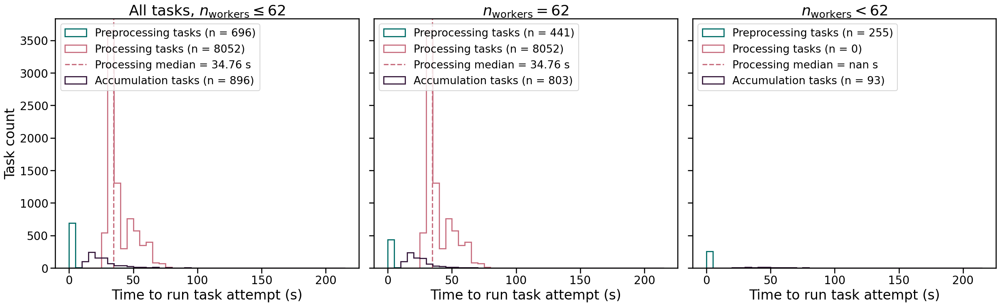

In [338]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 220, 5)

## Run 2025/07/11 181803

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* stable run

In [339]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-11T181803')

In [340]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-11T181803')

In [341]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 61
total workers active time = 33.21642226378124 mins, 0.5536070377296873 hours
Mean worker connection time = 32.459609194270904 mins, 0.5409934865711817 hours
# tasks on this run = 9639


In [342]:
tasks_t

,task_id,attempt_number,category,READY,RUNNING,WAITING_RETRIEVAL,RETRIEVED,DONE,reason,exit_code,last_state,last_state_time,DISCONNECTION,requested_cores,requested_memory,requested_disk,requested_gpus,allocated_cores,allocated_memory,allocated_disk,allocated_gpus,measured_cores,measured_memory,measured_disk,measured_gpus,measured_wall_time,library,worker_id,time_input_mgr,time_output_mgr,size_input_mgr,size_output_mgr,time_worker_start,time_worker_end,time_commit_start,time_commit_end,slot
0,1,1,preprocessing,0.005315,85.989022,105.329061,105.330070,105.335743,SUCCESS,0.0,DONE,105.335743,NaN,1.0,3500.0,NaN,NaN,1.0,4100.0,12251.0,0.0,1.0,4100.0,12251.0,0.0,1.745709,NaN,worker-241b7df9d718ea6b6171c22a9a370835,0.000259,0.000884,0.000288,0.000360,103.568237,105.313946,85.988742,85.989001,2
1,2,1,preprocessing,0.006130,86.889699,121.867184,121.869047,121.909303,SUCCESS,0.0,DONE,121.909303,NaN,1.0,3500.0,NaN,NaN,1.0,4100.0,12052.0,0.0,1.0,4100.0,12052.0,0.0,2.043412,NaN,worker-48dd910ce8cd362f7d70f89cba5e2ced,0.000289,0.000906,0.000292,0.000360,119.818748,121.862160,86.889388,86.889677,2
2,3,1,preprocessing,76.437874,98.907102,100.410366,100.411078,100.418060,SUCCESS,0.0,DONE,100.418060,NaN,1.0,3500.0,NaN,NaN,1.0,4100.0,14000.0,0.0,1.0,4100.0,14000.0,0.0,1.495341,NaN,worker-222520bb916fff2ba0ff9e0806b67add,0.000267,0.000596,0.000280,0.000357,98.907080,100.402421,98.906813,98.907080,8
3,4,1,preprocessing,0.007563,80.793216,105.757540,105.758531,105.764232,SUCCESS,0.0,DONE,105.764232,NaN,1.0,3500.0,NaN,NaN,1.0,4100.0,12251.0,0.0,1.0,4100.0,12251.0,0.0,3.633181,NaN,worker-9381d3e87e938b5efc10ae81acd63a99,0.000270,0.000864,0.000280,0.000357,102.116935,105.750116,80.792925,80.793195,2
4,5,1,preprocessing,0.008343,101.117603,102.709684,102.710291,102.728294,SUCCESS,0.0,DONE,102.728294,NaN,1.0,3500.0,NaN,NaN,1.0,4100.0,14500.0,0.0,1.0,4100.0,14500.0,0.0,1.579674,NaN,worker-49b86418da2dd4c8217f44faefa701da,0.000304,0.000491,0.000288,0.000360,101.117580,102.697254,101.117276,101.117580,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9634,9636,1,accumulating,1301.816385,1302.188430,1467.575137,1467.575618,1467.575822,SUCCESS,0.0,DONE,1467.575822,NaN,1.0,3500.0,21250.0,0.0,1.0,5831.0,21250.0,0.0,1.0,5831.0,21250.0,0.0,150.984592,NaN,worker-28835da9209367f389ac6e3a43f96859,0.000519,0.000120,0.000109,0.000000,1316.577427,1467.562019,1302.187876,1302.188395,1
9635,9637,1,accumulating,1303.947006,1306.034191,1429.813928,1429.814221,1429.814318,SUCCESS,0.0,DONE,1429.814318,NaN,1.0,3500.0,21250.0,0.0,1.0,5885.0,21250.0,0.0,1.0,5885.0,21250.0,0.0,110.455684,NaN,worker-d81e006dbab163656a32d2d63e035f84,0.000748,0.000057,0.000109,0.000000,1319.353988,1429.809672,1306.033371,1306.034119,1
9636,9638,1,accumulating,1303.952316,1305.083006,1447.171862,1447.172139,1447.172230,SUCCESS,0.0,DONE,1447.172230,NaN,1.0,3500.0,21250.0,0.0,1.0,5950.0,21250.0,0.0,1.0,5950.0,21250.0,0.0,129.442614,NaN,worker-22f9be3d81b69a48bad4ea825ba4117a,0.000774,0.000052,0.000109,0.000000,1317.725136,1447.167750,1305.082139,1305.082913,1
9637,9639,1,accumulating,1323.725183,1324.557292,1453.062246,1453.062543,1453.062638,SUCCESS,0.0,DONE,1453.062638,NaN,1.0,3500.0,21250.0,0.0,1.0,5801.0,21250.0,0.0,1.0,5801.0,21250.0,0.0,115.299305,NaN,worker-2598b410dffbda5e221f527bf8426c8c,0.000599,0.000050,0.000109,0.000000,1337.755960,1453.055265,1324.556642,1324.557241,1


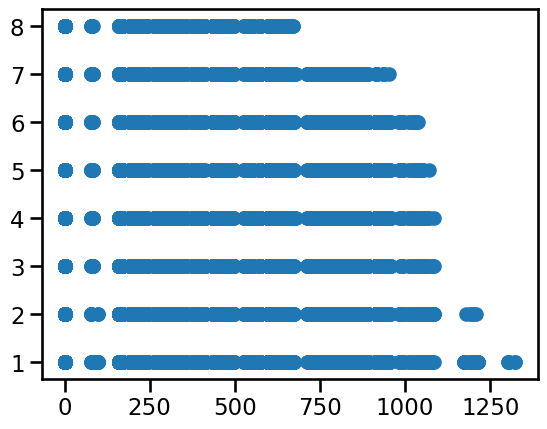

In [343]:
plt.scatter(tasks_t.READY, tasks_t.slot)

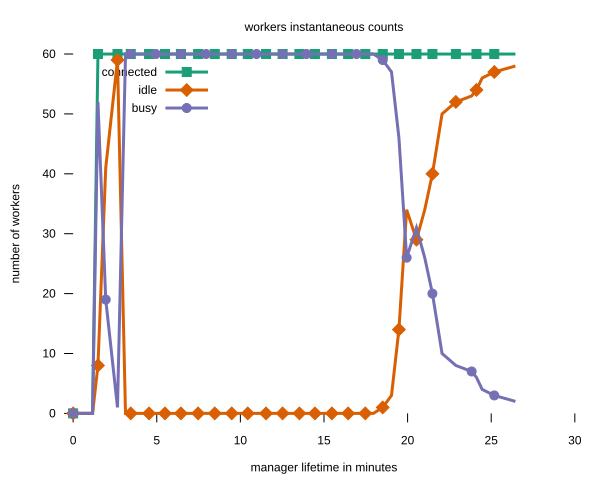

In [344]:
worker_svg

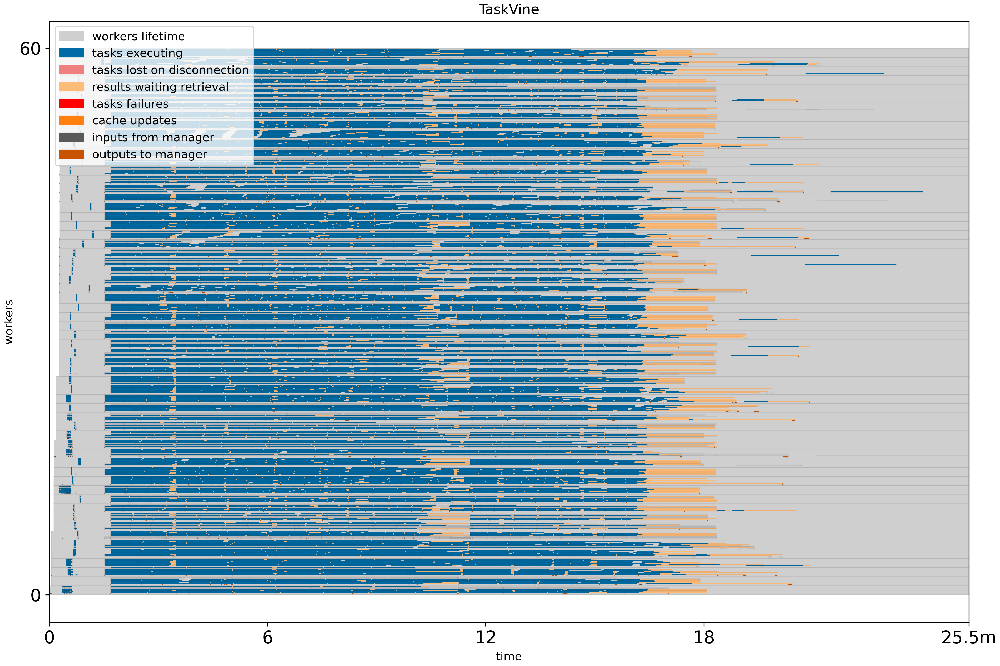

In [345]:
workers

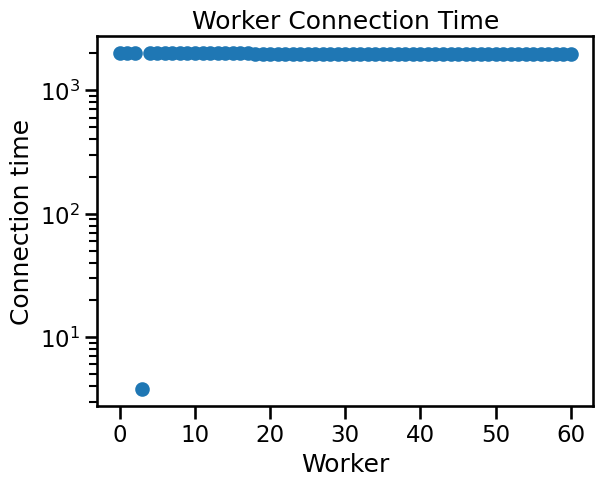

In [346]:
worker_conn_time = plot_worker_times(workers_t)

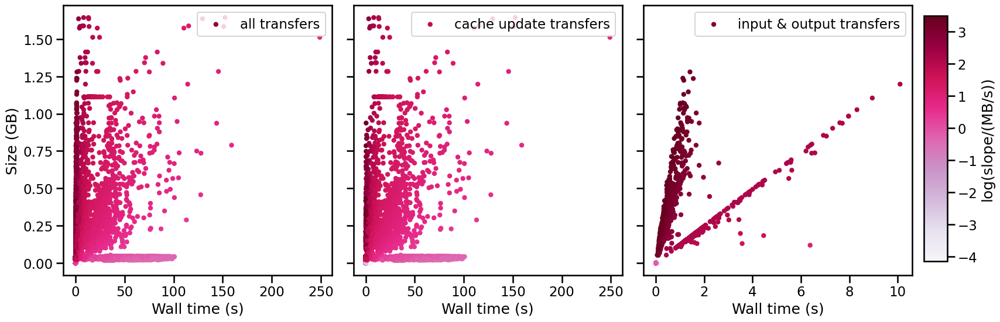

In [347]:
transfer_time_plot = transfer_time(transfers_t)

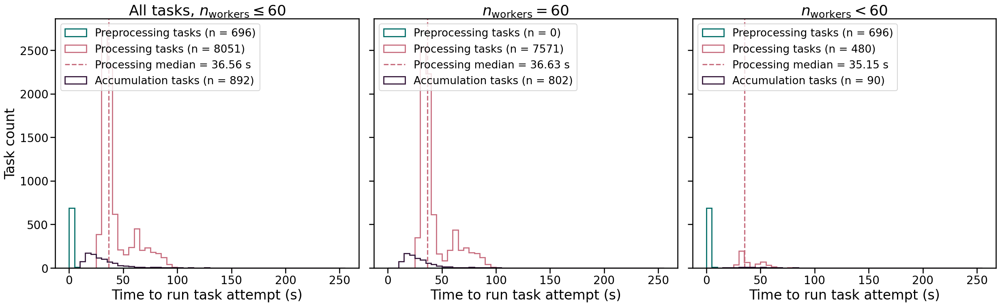

In [348]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 260, 5)

## Run 2025/07/11 165717

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* stable run

In [349]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-11T165717')

In [350]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-11T165717')

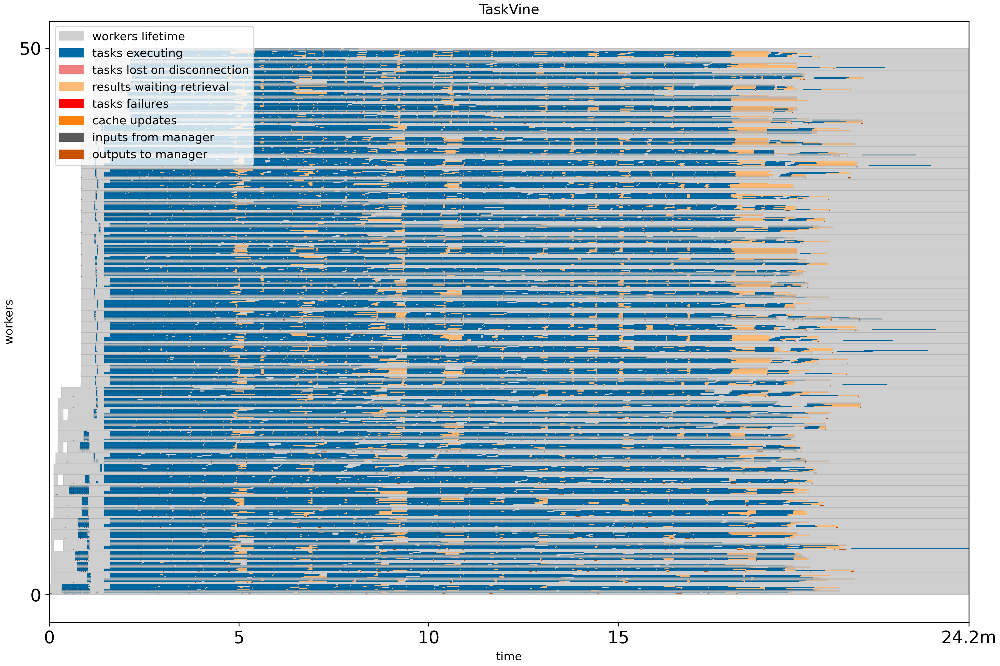

In [351]:
workers

In [352]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 54
total workers active time = 75.52675666411717 mins, 1.2587792777352862 hours
Mean worker connection time = 69.34946787784129 mins, 1.155824464630688 hours
# tasks on this run = 9639


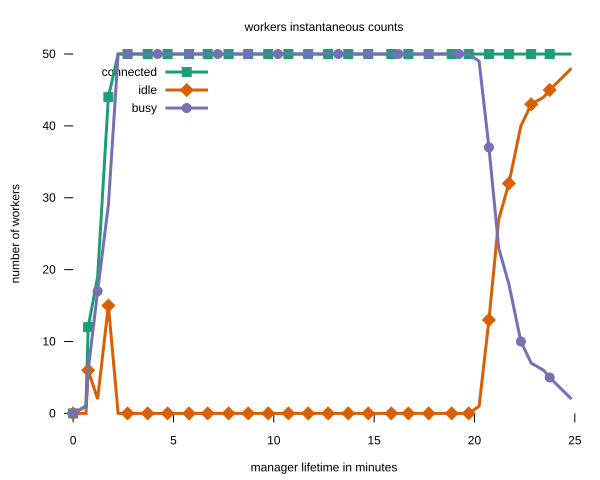

In [353]:
worker_svg

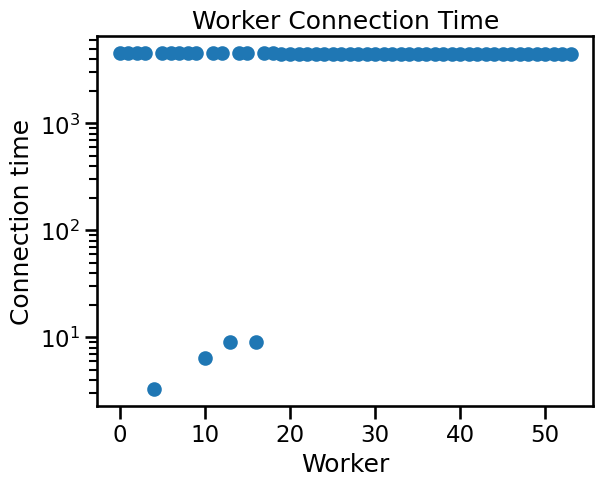

In [354]:
worker_conn_time = plot_worker_times(workers_t)

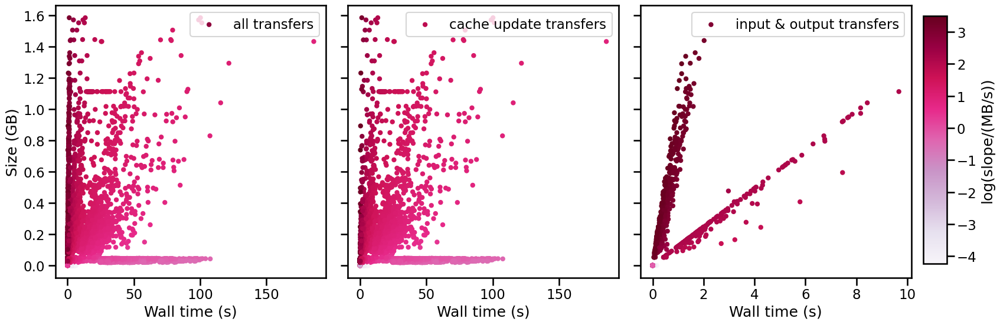

In [355]:
transfer_time_plot = transfer_time(transfers_t)

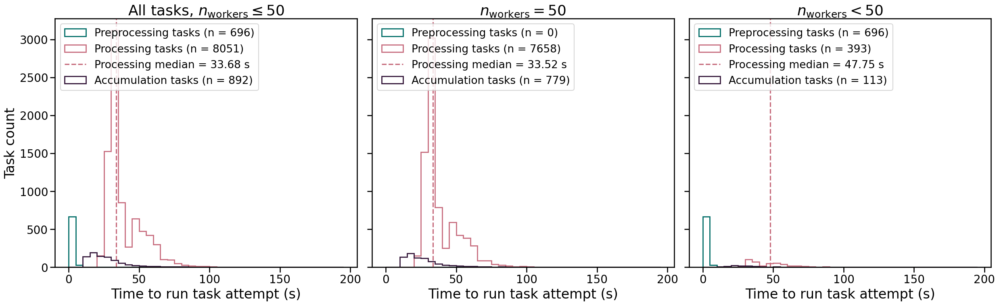

In [356]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 200, 5)

## Run 2025/07/11 150327

### Description

* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* stable run

In [357]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-11T150327')

In [358]:

tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-11T150327')

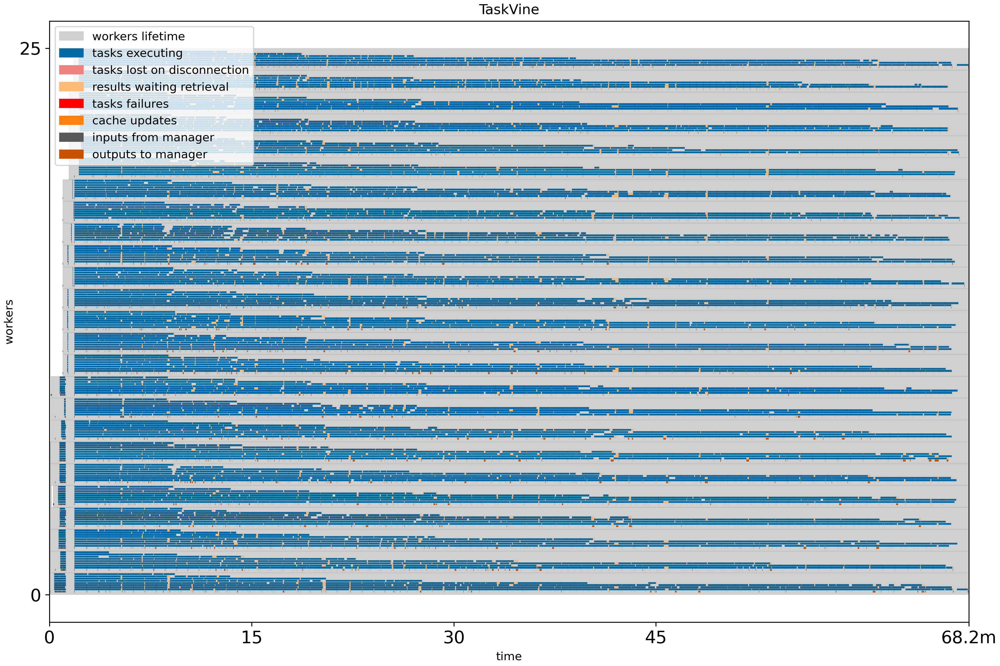

In [359]:
workers

In [360]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 26
total workers active time = 108.08034630219142 mins, 1.8013391050365235 hours
Mean worker connection time = 103.19119921250221 mins, 1.7198533202083703 hours
# tasks on this run = 9637


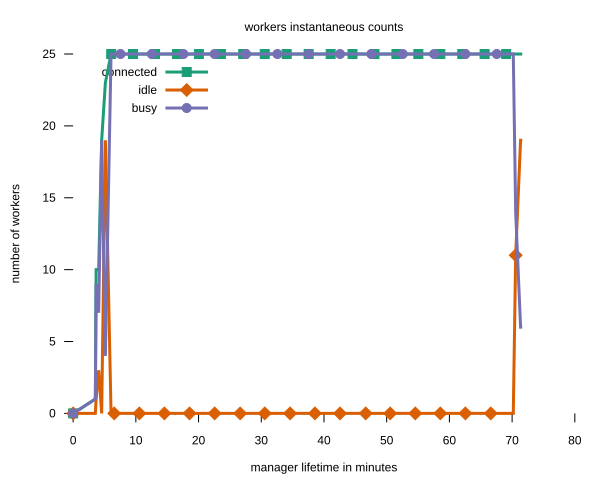

In [361]:
worker_svg

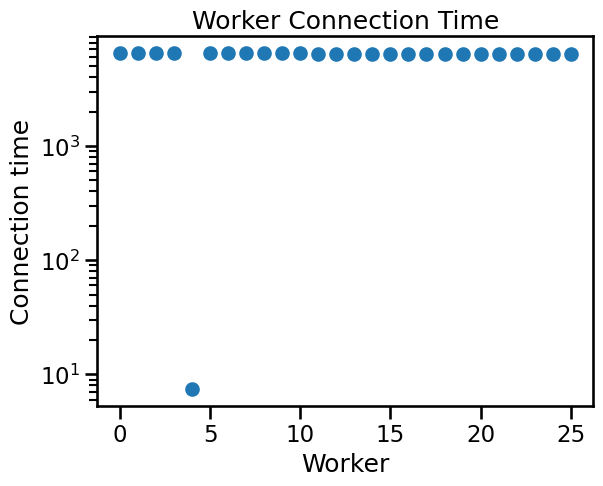

In [362]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


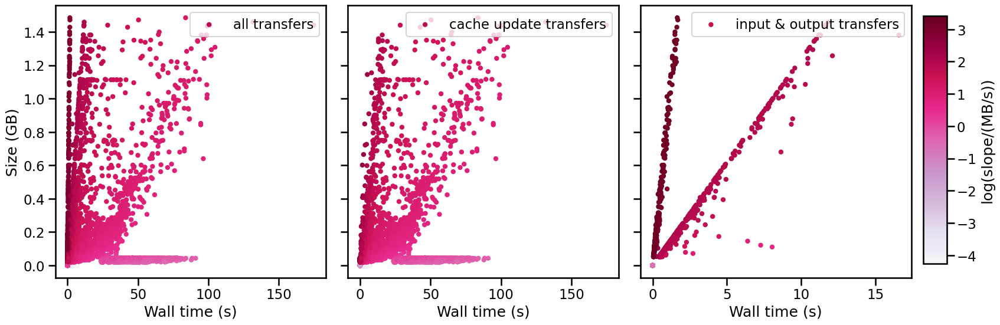

In [363]:
transfer_time_plot = transfer_time(transfers_t)

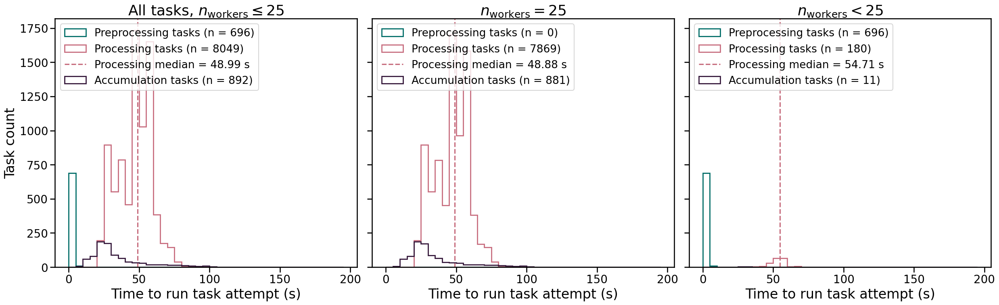

In [364]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 200, 5)

## Run 2025/07/11 124302

### Description

* Oksana ran this in my server so I assume it's like my run but not really
* she also started with 25 and randomly added 25 more workers, so the plateau is messed up
* 8 core workers, 16GB disk/worker
* cores: 1 on
* all datasets
* ndcctools 7.15.8
* worker transfers on
* chunksize = 10k
* finished last task

In [365]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-11T124302')

In [366]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-11T124302')

In [367]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 52
total workers active time = 75.3372243642807 mins, 1.255620406071345 hours
Mean worker connection time = 60.576536827362496 mins, 1.0096089471227083 hours
# tasks on this run = 9639


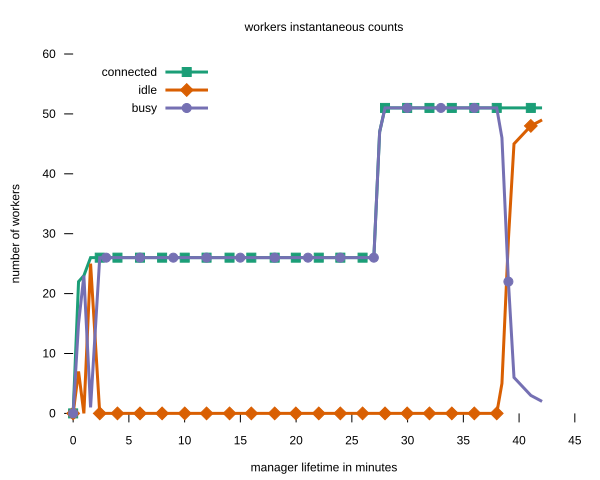

In [368]:
worker_svg

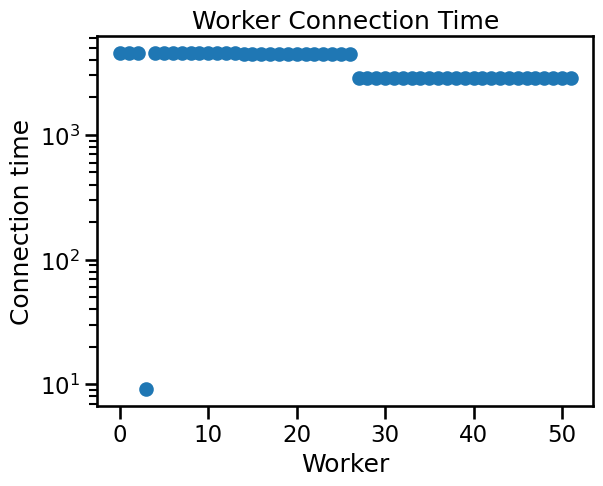

In [369]:
worker_conn_time = plot_worker_times(workers_t)

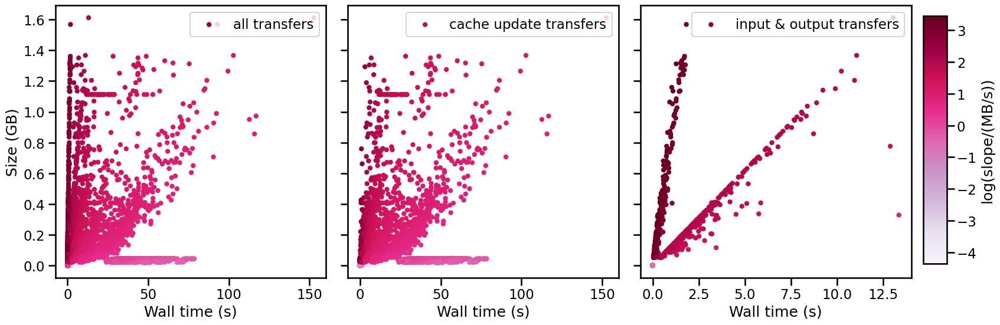

In [370]:
transfer_time_plot = transfer_time(transfers_t)

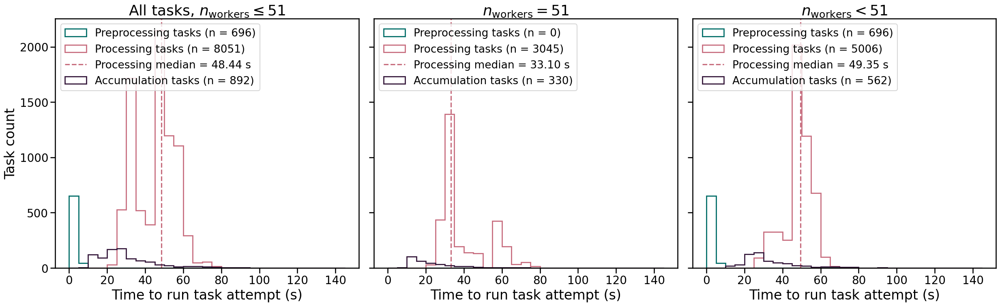

In [371]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 150, 5)

# Task comparison between runs

### Functions

In [67]:
BASE_PATH = '/home/cms-jovyan/topeft/analysis/topeft_run2/vine-run-info'

runs = ['2025-07-11T124302', '2025-07-11T150327', '2025-07-11T165717', '2025-07-11T181803', '2025-07-13T054900', '2025-07-13T061902', 
        '2025-07-13T183144', '2025-07-13T210823', '2025-07-14T011137', '2025-07-14T154126', '2025-07-14T181555', '2025-07-15T142041',
        '2025-07-14T203248', '2025-07-15T025350', '2025-07-15T150503', '2025-07-15T165647', '2025-07-15T182557',
        ## flag for xrootd-local redirect
        '2025-07-17T184144/', '2025-07-17T193225', '2025-07-17T201232', '2025-07-17T205231', '2025-07-17T220213', '2025-07-17T232202', 
        '2025-07-18T043307', '2025-07-18T144856', '2025-07-18T155413', '2025-07-18T171027', '2025-07-24T024241'
       ]
maybe_run = ['2025-07-14T203248', '2025-07-15T025350']
old_va = ['2025-07-18T200124', # xrootd coffea25, never finished
          '2025-07-18T212703', #xcache from here on
          '2025-07-19T053345', '2025-07-19T183420', '2025-07-20T000313', '2025-07-20T033705', '2025-07-20T062350']
new_va = ['2025-07-21T160746', '2025-07-21T181859', '2025-07-21T201025', '2025-07-21T215551', '2025-07-22T001121', '2025-07-22T022121',
         '2025-07-22T040108', '2025-07-22T081346', '2025-07-22T142752', '2025-07-22T165120', '2025-07-22T201157', '2025-07-22T220059',
          '2025-07-23T041103', '2025-07-23T145033/']

redirector_map = {
    '2025-07-11T124302': 'xcache',
    '2025-07-11T150327': 'xcache',
    '2025-07-11T165717': 'xcache',
    '2025-07-11T181803': 'xcache',
    '2025-07-13T054900': 'xcache',
    '2025-07-13T061902': 'xcache',
    '2025-07-13T183144': 'xcache',
    '2025-07-13T210823': 'xcache',
    '2025-07-14T011137': 'xcache',
    '2025-07-14T154126': 'xcache',
    '2025-07-14T181555': 'xcache',
    '2025-07-15T142041': 'xcache',
    '2025-07-14T203248': 'xcache',
    '2025-07-15T025350': 'xcache',
    '2025-07-15T150503': 'xcache',
    '2025-07-15T165647': 'xcache',
    '2025-07-15T182557': 'xcache',
    '2025-07-17T184144/': 'xrootd',
    '2025-07-17T193225': 'xrootd',
    '2025-07-17T201232': 'xrootd', 
    '2025-07-17T205231': 'xrootd',
    '2025-07-17T220213': 'xrootd', 
    '2025-07-17T232202': 'xrootd',
    '2025-07-18T043307': 'xrootd', 
    '2025-07-18T144856': 'xrootd',
    '2025-07-18T155413': 'xrootd',
    '2025-07-18T171027': 'xrootd', 
    '2025-07-24T024241': 'xrootd'
}

In [68]:
def read_tasks_and_perf(path):
    tasks_t = pd.read_csv(f'{BASE_PATH}/{path}/vine-logs/df_0_tasks.csv')
    with open(f'{BASE_PATH}/{path}/vine-logs/performance', 'r') as f:
        lines = f.readlines()
    lines[0] = lines[0][2:]
    perf_str = ''.join(lines)
    performance = pd.read_csv(io.StringIO(perf_str), sep=' ')

    performance['lifetime'] = performance['timestamp'] - performance['timestamp'].min()

    workers_t = pd.read_csv(f'{BASE_PATH}/{path}/vine-logs/df_0_workers.csv')

    return tasks_t, performance, workers_t

In [69]:
def compute_task_time(task_t, performance, workers_t):

    prepro = task_t[task_t.category == 'preprocessing']
    pro = task_t[task_t.category == 'processing']
    accum = task_t[task_t.category == 'accumulating']

    max_workers = performance['workers_busy'].max()
    plateau_window = performance[performance['workers_busy'] == max_workers]

    start = plateau_window['lifetime'].min() / 1e6
    end = plateau_window['lifetime'].max() / 1e6
    
    plateau = task_t[(task_t.time_worker_start >= start) & (task_t.time_worker_end  <= end)]
    prepro_pl = plateau[plateau.category == 'preprocessing']
    pro_pl = plateau[plateau.category == 'processing']
    accum_pl = plateau[plateau.category == 'accumulating']

    vary = task_t[(task_t.time_worker_start < start) | (task_t.time_worker_end > end)]
    prepro_vr = vary[vary.category == 'preprocessing']
    pro_vr = vary[vary.category == 'processing']
    accum_vr = vary[vary.category == 'accumulating']
    
    return {
        "n_max_workers": max_workers,
        "pre_tasks_plateau": len(prepro_pl),
        "proc_tasks_plateau": len(pro_pl),
        "accum_tasks_plateau": len(accum_pl),
        "total_tasks_plateau": len(plateau),
        "runtime": performance.loc[len(performance)-1, "lifetime"],
        
        "mean_plateau_proc_time": pro_pl['measured_wall_time'].mean(),
        "mean_plateau_pre_time": prepro_pl['measured_wall_time'].mean(),
        "mean_plateau_accum_time": accum_pl['measured_wall_time'].mean(),
        "mean_all_pre_time": prepro['measured_wall_time'].mean(),
        "mean_all_proc_time": pro['measured_wall_time'].mean(),
        "mean_all_accum_time": accum['measured_wall_time'].mean(),
        "mean_vr_proc_time": pro_vr['measured_wall_time'].mean(),
        "mean_vr_pre_time": prepro_vr['measured_wall_time'].mean(),
        "mean_vr_accum_time": accum_vr['measured_wall_time'].mean(),
        
        "std_plateau_proc_time": pro_pl['measured_wall_time'].std(),
        "std_plateau_pre_time": prepro_pl['measured_wall_time'].std(),
        "std_plateau_accum_time": accum_pl['measured_wall_time'].std(),
        "std_all_pre_time": prepro['measured_wall_time'].std(),
        "std_all_proc_time": pro['measured_wall_time'].std(),
        "std_all_accum_time": accum['measured_wall_time'].std(),
        "std_vr_proc_time": pro_vr['measured_wall_time'].std(),
        "std_vr_pre_time": prepro_vr['measured_wall_time'].std(),
        "std_vr_accum_time": accum_vr['measured_wall_time'].std(),

        "med_plateau_proc_time": pro_pl['measured_wall_time'].median(),
        "med_all_proc_time": pro['measured_wall_time'].median(),
        "med_vr_proc_time": pro_vr['measured_wall_time'].median(),
        "25q_plateau_proc_time": pro_pl['measured_wall_time'].quantile(.25),
        "25q_all_proc_time": pro['measured_wall_time'].quantile(.25),
        "25q_vr_proc_time": pro_vr['measured_wall_time'].quantile(.25),
        "75q_plateau_proc_time": pro_pl['measured_wall_time'].quantile(.75),
        "75q_all_proc_time": pro['measured_wall_time'].quantile(.75),
        "75q_vr_proc_time": pro_vr['measured_wall_time'].quantile(.75),
        
        "proc_tasks_per_s_plateau": (len(pro_pl))/(end-start),
        "pre_tasks_per_s_plateau": (len(prepro_pl))/(end-start),
        "accum_tasks_per_s_plateau": (len(accum_pl))/(end-start),
        "cores_per_workers": workers_t.cores.mean(),
        "cores_per_task": task_t.allocated_cores.mean()
    }

### Dataframe

In [70]:
summary_rows = []
for run in runs:
    try:
        tasks_t, performance, workers_t = read_tasks_and_perf(run)
        row = compute_task_time(tasks_t, performance, workers_t)
        row['run'] = run
        row['redirector'] = redirector_map.get(run, 'unknown')
        summary_rows.append(row)
    except Exception as e:
        print(f"Error in run {run}: {e}")

task_time_df = pd.DataFrame(summary_rows)
task_time_df

,n_max_workers,pre_tasks_plateau,proc_tasks_plateau,accum_tasks_plateau,total_tasks_plateau,runtime,mean_plateau_proc_time,mean_plateau_pre_time,mean_plateau_accum_time,mean_all_pre_time,mean_all_proc_time,mean_all_accum_time,mean_vr_proc_time,mean_vr_pre_time,mean_vr_accum_time,std_plateau_proc_time,std_plateau_pre_time,std_plateau_accum_time,std_all_pre_time,std_all_proc_time,std_all_accum_time,std_vr_proc_time,std_vr_pre_time,std_vr_accum_time,med_plateau_proc_time,med_all_proc_time,med_vr_proc_time,25q_plateau_proc_time,25q_all_proc_time,25q_vr_proc_time,75q_plateau_proc_time,75q_all_proc_time,75q_vr_proc_time,proc_tasks_per_s_plateau,pre_tasks_per_s_plateau,accum_tasks_per_s_plateau,cores_per_workers,cores_per_task,run,redirector
0,51,0,3045,330,3375,2536700108,39.788447,NaN,24.697639,3.233591,45.136506,30.600805,48.389571,3.233591,34.067077,12.742226,NaN,15.635758,1.118538,10.575047,16.926631,7.289360,1.118538,16.707410,33.101465,48.435717,49.353841,31.082708,33.904458,47.431069,48.461102,51.647492,51.845438,4.691065,0.000000,0.508391,8.0,1.000000,2025-07-11T124302,xcache
1,25,0,7869,881,8750,4301731817,46.732181,NaN,34.717359,3.423076,46.892431,34.838454,53.898034,3.423076,44.537045,12.087599,NaN,20.271494,0.496396,12.026539,20.268292,5.499387,0.496396,18.322188,48.880781,48.989682,54.706249,37.162809,37.459801,52.542358,56.007508,56.028883,56.372208,2.024670,0.000000,0.226679,8.0,1.234409,2025-07-11T150327,xcache
2,50,0,7658,779,8437,1489867422,38.214965,NaN,26.786290,3.025504,38.652879,28.042697,47.186072,3.025504,36.704125,12.297709,NaN,15.216942,1.059643,12.553283,17.088483,14.328295,1.059643,25.058762,33.518539,33.675996,47.748730,30.481172,30.625334,34.425132,45.446317,47.161543,55.097268,7.128838,0.000000,0.725172,8.0,1.000000,2025-07-11T165717,xcache
3,60,0,7571,802,8373,1586901767,43.154262,NaN,30.463553,2.253557,43.018022,33.013564,40.869134,2.253557,55.736995,15.474018,NaN,18.454029,0.997017,15.258604,22.313555,11.125021,0.997017,36.590012,36.629045,36.555678,35.153030,33.230767,33.171677,32.209347,44.297545,45.202750,50.314488,8.143039,0.000000,0.862596,8.0,1.000000,2025-07-11T181803,xcache
4,62,441,8052,803,9296,1548375841,39.627346,2.404812,24.839330,2.225855,39.627346,28.405712,NaN,1.916364,59.199310,10.432314,0.963278,11.275072,0.819957,10.432314,19.066118,NaN,0.283697,36.859201,34.760524,34.760524,NaN,32.477679,32.477679,NaN,48.398696,48.398696,NaN,9.116505,0.499302,0.909160,8.0,1.000000,2025-07-13T054900,xcache
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23,15,0,7766,870,8636,15931103691,53.914525,NaN,32.069701,3.631040,53.878075,32.826461,52.856156,3.631040,62.752899,4.728850,NaN,12.365030,0.297675,4.690587,15.040861,3.294838,0.297675,48.058786,52.500278,52.463332,51.618158,49.980649,49.991566,50.197870,57.542336,57.441842,55.573179,0.956204,0.000000,0.107120,8.0,1.297062,2025-07-18T043307,xrootd
24,30,0,7829,871,8700,3445711196,47.523509,NaN,32.988571,3.730407,47.717816,34.102286,54.539491,3.730407,76.278182,11.972416,NaN,18.085981,0.465054,11.949499,23.220366,8.719305,0.465054,83.915625,49.991096,50.091332,56.229365,36.540275,36.973134,50.477686,57.025245,57.094091,59.143449,2.899746,0.000000,0.322606,8.0,1.049575,2025-07-18T144856,xrootd
25,25,0,7837,870,8707,4268872254,51.191310,NaN,33.145995,3.612791,51.305726,33.837415,55.476325,3.612791,58.901400,8.678571,NaN,15.573215,0.446919,8.637616,18.978126,5.570813,0.446919,64.398265,50.991629,51.084239,56.199930,47.885520,48.030516,54.114460,57.442541,57.442544,57.406318,2.152674,0.000000,0.238972,8.0,1.113047,2025-07-18T155413,xrootd
26,20,0,7537,849,8386,5998045846,51.780112,NaN,34.460534,3.597287,51.835631,34.730860,52.648160,3.597287,39.831009,7.830944,NaN,16.720554,0.218249,7.631857,18.389959,3.537974,0.218249,38.046144,51.474201,51.467775,51.319693,48.876862,49.040305,50.179533,57.261928,57.094081,55.047232,1.415035,0.000000,0.15

### Plots

In [71]:
x = np.array(task_time_df.n_max_workers).reshape(-1, 1)
y = (task_time_df.mean_plateau_proc_time)
reg = LinearRegression().fit(x, y)
reg.coef_

array([-0.19139909])

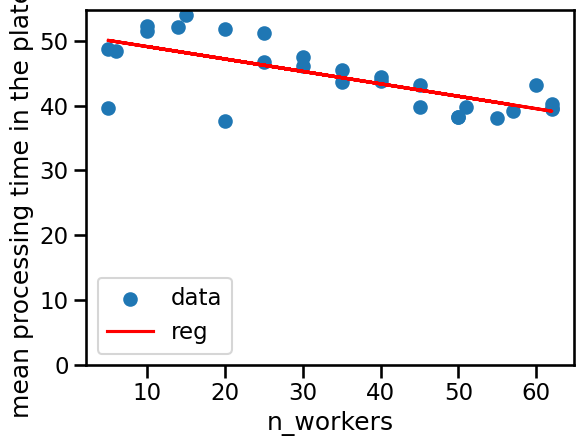

In [72]:
y_pred = reg.predict(x)
plt.scatter(x, y, label='data')
plt.plot(x, y_pred, color='red', label='reg')
plt.xlabel('n_workers')
plt.ylabel('mean processing time in the plateau')
plt.legend()
plt.tight_layout()
plt.ylim(0)
plt.show()

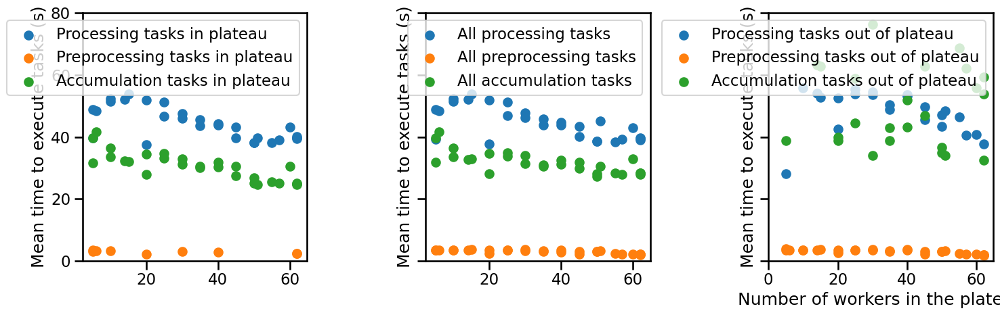

In [73]:
fig, axs = plt.subplots(1,3, figsize=(15, 5), sharey=True)
# error bars? one std?
axs[0].scatter(task_time_df.n_max_workers, task_time_df.mean_plateau_proc_time, label='Processing tasks in plateau')
axs[0].scatter(task_time_df.n_max_workers, task_time_df.mean_plateau_pre_time, label='Preprocessing tasks in plateau')
axs[0].scatter(task_time_df.n_max_workers, task_time_df.mean_plateau_accum_time, label='Accumulation tasks in plateau')
axs[0].set_ylabel("Mean time to execute tasks (s)")
axs[0].legend()

axs[1].scatter(task_time_df.n_max_workers, task_time_df.mean_all_proc_time, label='All processing tasks')
axs[1].scatter(task_time_df.n_max_workers, task_time_df.mean_all_pre_time, label='All preprocessing tasks')
axs[1].scatter(task_time_df.n_max_workers, task_time_df.mean_all_accum_time, label='All accumulation tasks')
axs[1].set_ylabel("Mean time to execute tasks (s)")
axs[1].legend()

axs[2].scatter(task_time_df.n_max_workers, task_time_df.mean_vr_proc_time, label='Processing tasks out of plateau')
axs[2].scatter(task_time_df.n_max_workers, task_time_df.mean_vr_pre_time, label='Preprocessing tasks out of plateau')
axs[2].scatter(task_time_df.n_max_workers, task_time_df.mean_vr_accum_time, label='Accumulation tasks out of plateau')
axs[2].legend()

axs[2].set_ylabel("Mean time to execute tasks (s)")
axs[2].set_xlabel("Number of workers in the plateau")
plt.tight_layout()
plt.xlim(0)
plt.ylim(0)
plt.show()

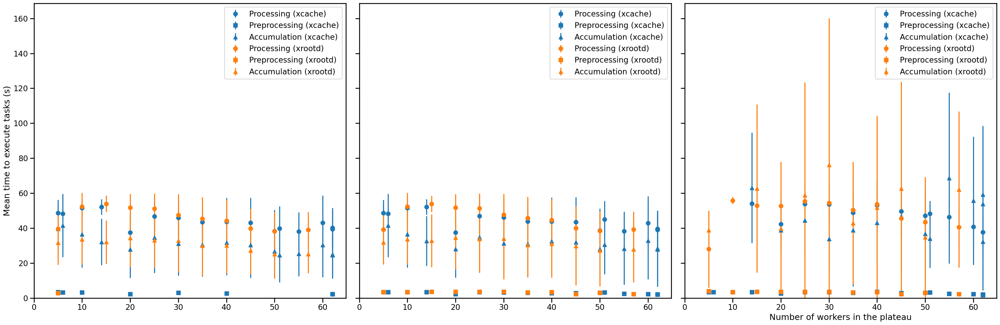

In [74]:
fig, axs = plt.subplots(1, 3, figsize=(30, 10), sharey=True)

col = {'xcache': 'tab:blue', 'xrootd': 'tab:orange', 'unknown': 'gray'}

for redirector in task_time_df['redirector'].unique():
    df = task_time_df[task_time_df['redirector'] == redirector]
    label_suffix = f" ({redirector})"
    
    axs[0].errorbar(x=df.n_max_workers, y=df.mean_plateau_proc_time, yerr=df.std_plateau_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=col[redirector], marker='o')
    axs[0].errorbar(df.n_max_workers, df.mean_plateau_pre_time, yerr=df.std_plateau_pre_time, linestyle=' ',
                   label='Preprocessing' + label_suffix, color=col[redirector], marker='s')
    axs[0].errorbar(df.n_max_workers, df.mean_plateau_accum_time, yerr=df.std_plateau_accum_time, linestyle=' ',
                   label='Accumulation' + label_suffix, color=col[redirector], marker='^')
    
    axs[1].errorbar(df.n_max_workers, df.mean_all_proc_time, yerr=df.std_all_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=col[redirector], marker='o')
    axs[1].errorbar(df.n_max_workers, df.mean_all_pre_time, yerr=df.std_all_pre_time, linestyle=' ',
                   label='Preprocessing' + label_suffix, color=col[redirector], marker='s')
    axs[1].errorbar(df.n_max_workers, df.mean_all_accum_time, yerr=df.std_all_accum_time, linestyle=' ',
                   label='Accumulation' + label_suffix, color=col[redirector], marker='^')
    
    axs[2].errorbar(df.n_max_workers, df.mean_vr_proc_time, yerr=df.std_vr_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=col[redirector], marker='o')
    axs[2].errorbar(df.n_max_workers, df.mean_vr_pre_time, yerr=df.std_vr_pre_time, linestyle=' ',
                   label='Preprocessing' + label_suffix, color=col[redirector], marker='s')
    axs[2].errorbar(df.n_max_workers, df.mean_vr_accum_time, yerr=df.std_vr_accum_time, linestyle=' ',
                   label='Accumulation' + label_suffix, color=col[redirector], marker='^')

axs[0].set_ylabel("Mean time to execute tasks (s)")
axs[2].set_xlabel("Number of workers in the plateau")

for ax in axs:
    ax.legend()
    ax.set_xlim(left=0)
    ax.set_ylim(bottom=0)

plt.tight_layout()
plt.show()

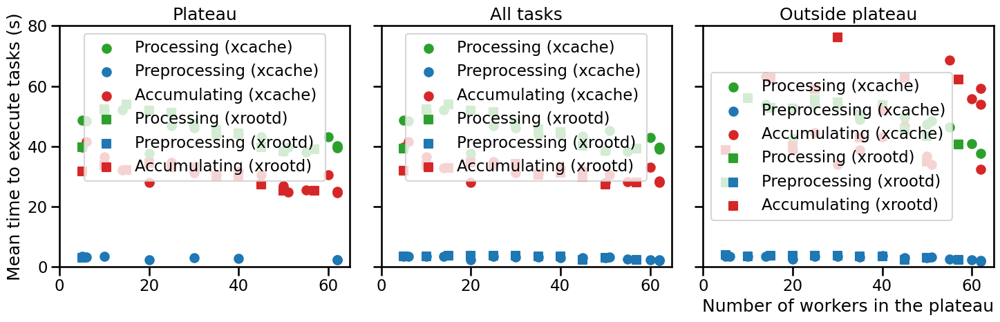

In [75]:
redirector_markers = {
    'xcache': 'o', 
    'xrootd': 's',
    'unknown': '^'
}

task_colors = {
    'preprocessing': 'tab:blue',
    'processing': 'tab:green',
    'accumulating': 'tab:red'
}

fig, axs = plt.subplots(1, 3, figsize=(15, 5), sharey=True)

for redirector in task_time_df['redirector'].unique():
    df = task_time_df[task_time_df['redirector'] == redirector]
    marker = redirector_markers.get(redirector, 'x')

    axs[0].scatter(df.n_max_workers, df.mean_plateau_proc_time, 
                   label=f'Processing ({redirector})', color=task_colors['processing'], marker=marker)
    axs[0].scatter(df.n_max_workers, df.mean_plateau_pre_time, 
                   label=f'Preprocessing ({redirector})', color=task_colors['preprocessing'], marker=marker)
    axs[0].scatter(df.n_max_workers, df.mean_plateau_accum_time, 
                   label=f'Accumulating ({redirector})', color=task_colors['accumulating'], marker=marker)
    axs[0].set_title("Plateau")

    axs[1].scatter(df.n_max_workers, df.mean_all_proc_time, 
                   label=f'Processing ({redirector})', color=task_colors['processing'], marker=marker)
    axs[1].scatter(df.n_max_workers, df.mean_all_pre_time, 
                   label=f'Preprocessing ({redirector})', color=task_colors['preprocessing'], marker=marker)
    axs[1].scatter(df.n_max_workers, df.mean_all_accum_time, 
                   label=f'Accumulating ({redirector})', color=task_colors['accumulating'], marker=marker)
    axs[1].set_title("All tasks")

    axs[2].scatter(df.n_max_workers, df.mean_vr_proc_time, 
                   label=f'Processing ({redirector})', color=task_colors['processing'], marker=marker)
    axs[2].scatter(df.n_max_workers, df.mean_vr_pre_time, 
                   label=f'Preprocessing ({redirector})', color=task_colors['preprocessing'], marker=marker)
    axs[2].scatter(df.n_max_workers, df.mean_vr_accum_time, 
                   label=f'Accumulating ({redirector})', color=task_colors['accumulating'], marker=marker)
    axs[2].set_title("Outside plateau")

# Labels and layout
axs[0].set_ylabel("Mean time to execute tasks (s)")
axs[2].set_xlabel("Number of workers in the plateau")

for ax in axs:
    ax.legend()
    ax.set_xlim(left=0)
    ax.set_ylim(bottom=0)

plt.tight_layout()
plt.show()


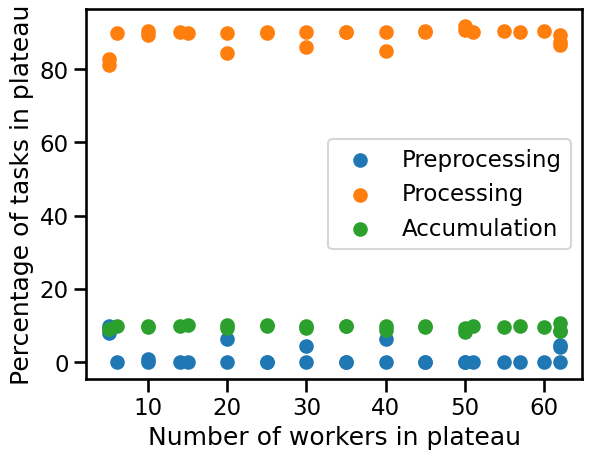

In [76]:

plt.scatter(task_time_df.n_max_workers, (task_time_df.pre_tasks_plateau/task_time_df.total_tasks_plateau)*100, label="Preprocessing")
plt.scatter(task_time_df.n_max_workers, (task_time_df.proc_tasks_plateau/task_time_df.total_tasks_plateau)*100, label="Processing")
plt.scatter(task_time_df.n_max_workers, (task_time_df.accum_tasks_plateau/task_time_df.total_tasks_plateau)*100, label="Accumulation")
plt.xlabel("Number of workers in plateau")
plt.ylabel("Percentage of tasks in plateau")
#plt.semilogy(())
plt.legend()
plt.show()

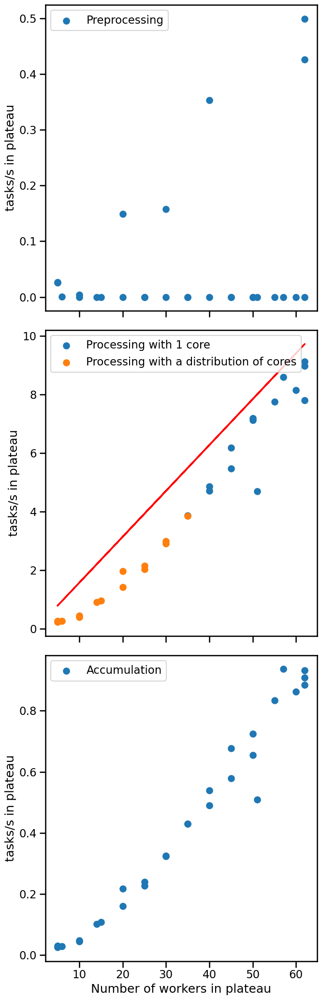

In [77]:
fig, axs = plt.subplots(3,1, figsize=(7, 21), sharex=True)

one_core = task_time_df[task_time_df.cores_per_task == 1]
not_one_core = task_time_df[task_time_df.cores_per_task != 1]

ideal_line =  (1/reg.intercept_)*np.array(task_time_df.n_max_workers)*8

axs[0].scatter(task_time_df.n_max_workers, task_time_df.pre_tasks_per_s_plateau, label="Preprocessing")
axs[0].set_ylabel("tasks/s in plateau")
axs[0].legend()

axs[1].scatter(one_core.n_max_workers, one_core.proc_tasks_per_s_plateau, label="Processing with 1 core")
axs[1].scatter(not_one_core.n_max_workers, not_one_core.proc_tasks_per_s_plateau, label="Processing with a distribution of cores")
axs[1].plot(task_time_df.n_max_workers, ideal_line, color='red')
axs[1].set_ylabel("tasks/s in plateau")
axs[1].legend()

axs[2].scatter(task_time_df.n_max_workers, task_time_df.accum_tasks_per_s_plateau, label="Accumulation")
axs[2].set_ylabel("tasks/s in plateau")
axs[2].legend()

axs[2].set_xlabel("Number of workers in plateau")
plt.tight_layout()

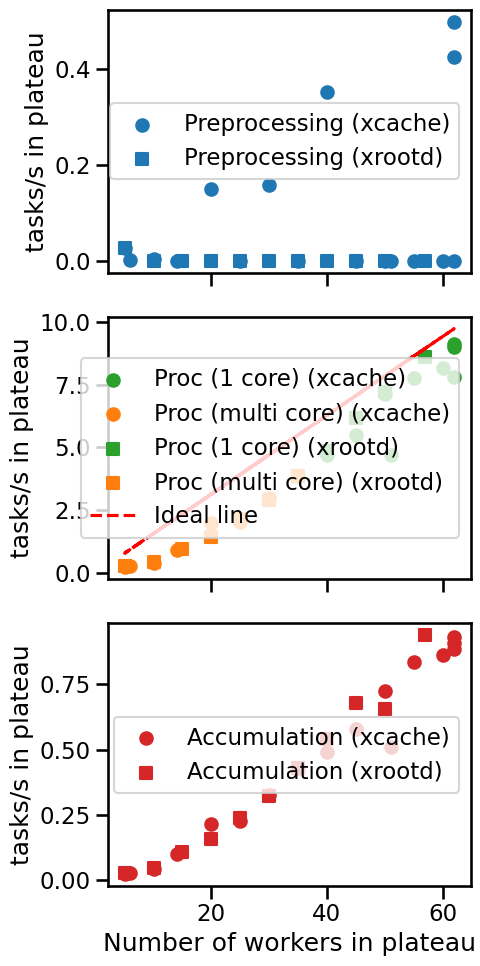

In [78]:
fig, axs = plt.subplots(3, 1, figsize=(5, 10), sharex=True)

redirector_markers = {
    'xcache': 'o',
    'xrootd': 's',
    'unknown': '^'
}

task_colors = {
    'preprocessing': 'tab:blue',
    'processing_1core': 'tab:green',
    'processing_multi': 'tab:orange',
    'accumulating': 'tab:red'
}

for redirector in task_time_df['redirector'].unique():
    df = task_time_df[task_time_df['redirector'] == redirector]
    marker = redirector_markers.get(redirector, 'x')
    axs[0].scatter(df.n_max_workers, df.pre_tasks_per_s_plateau, 
                   label=f"Preprocessing ({redirector})", 
                   color=task_colors['preprocessing'], marker=marker)

axs[0].set_ylabel("tasks/s in plateau")
axs[0].legend()

for redirector in task_time_df['redirector'].unique():
    df_one = task_time_df[(task_time_df['redirector'] == redirector) & (task_time_df.cores_per_task == 1)]
    df_multi = task_time_df[(task_time_df['redirector'] == redirector) & (task_time_df.cores_per_task != 1)]
    marker = redirector_markers.get(redirector, 'x')
    
    axs[1].scatter(df_one.n_max_workers, df_one.proc_tasks_per_s_plateau,
                   label=f"Proc (1 core) ({redirector})", 
                   color=task_colors['processing_1core'], marker=marker)
    
    axs[1].scatter(df_multi.n_max_workers, df_multi.proc_tasks_per_s_plateau,
                   label=f"Proc (multi core) ({redirector})", 
                   color=task_colors['processing_multi'], marker=marker)

try:
    ideal_line = (1 / reg.intercept_) * np.array(task_time_df.n_max_workers) * 8
    axs[1].plot(task_time_df.n_max_workers, ideal_line, color='red', linestyle='--', label='Ideal line')
except NameError:
    pass

axs[1].set_ylabel("tasks/s in plateau")
axs[1].legend()

for redirector in task_time_df['redirector'].unique():
    df = task_time_df[task_time_df['redirector'] == redirector]
    marker = redirector_markers.get(redirector, 'x')
    axs[2].scatter(df.n_max_workers, df.accum_tasks_per_s_plateau,
                   label=f"Accumulation ({redirector})",
                   color=task_colors['accumulating'], marker=marker)

axs[2].set_ylabel("tasks/s in plateau")
axs[2].set_xlabel("Number of workers in plateau")
axs[2].legend()

plt.tight_layout()
plt.show()


(0.0, 3.457080592635868)

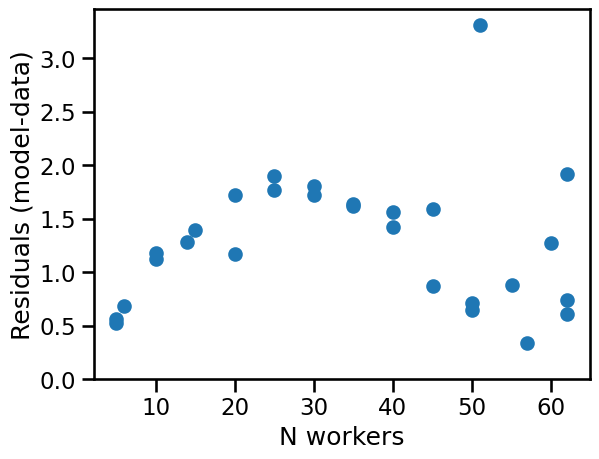

In [79]:
residuals = ideal_line - task_time_df.proc_tasks_per_s_plateau
plt.scatter(task_time_df.n_max_workers, residuals)
plt.xlabel("N workers")
plt.ylabel("Residuals (model-data)")
plt.ylim(0)

## Coffea 25 run analysis

In [80]:
summary_rows = []
for run in new_va:
    try:
        tasks_t, performance, workers_t = read_tasks_and_perf(run)
        row = compute_task_time(tasks_t, performance, workers_t)
        row['run'] = run
        #row['redirector'] = redirector_map.get(run, 'unknown')
        summary_rows.append(row)
    except Exception as e:
        print(f"Error in run {run}: {e}")

coffea25 = pd.DataFrame(summary_rows)
coffea25

,n_max_workers,pre_tasks_plateau,proc_tasks_plateau,accum_tasks_plateau,total_tasks_plateau,runtime,mean_plateau_proc_time,mean_plateau_pre_time,mean_plateau_accum_time,mean_all_pre_time,mean_all_proc_time,mean_all_accum_time,mean_vr_proc_time,mean_vr_pre_time,mean_vr_accum_time,std_plateau_proc_time,std_plateau_pre_time,std_plateau_accum_time,std_all_pre_time,std_all_proc_time,std_all_accum_time,std_vr_proc_time,std_vr_pre_time,std_vr_accum_time,med_plateau_proc_time,med_all_proc_time,med_vr_proc_time,25q_plateau_proc_time,25q_all_proc_time,25q_vr_proc_time,75q_plateau_proc_time,75q_all_proc_time,75q_vr_proc_time,proc_tasks_per_s_plateau,pre_tasks_per_s_plateau,accum_tasks_per_s_plateau,cores_per_workers,cores_per_task,run
0,62,0,7424,851,8275,4391095168,240.624693,NaN,30.529525,5.319057,243.708378,31.142988,280.279109,5.319057,43.876092,65.081824,NaN,15.198651,1.919561,67.715848,16.398980,85.408871,1.919561,30.123380,212.539730,213.431553,281.219691,197.348996,197.249146,195.101927,277.841213,282.729048,360.862734,1.858978,0.000000,0.213091,8.0,1.0,2025-07-21T160746
1,55,617,7743,846,9206,5165009710,256.160784,4.685909,32.188986,4.700833,256.632588,33.122733,268.532190,4.817391,50.295558,74.964934,1.084872,16.670869,1.091223,75.706562,17.986828,91.813239,1.140019,29.483608,224.335306,224.151417,206.342989,203.728969,202.985026,187.662605,307.415712,309.133614,350.714937,1.620705,0.129146,0.177078,8.0,1.0,2025-07-21T181859
2,50,0,7476,862,8338,5448105627,245.797370,NaN,30.905571,5.117878,247.273204,31.488323,266.395100,5.117878,48.232723,65.742910,NaN,14.972652,1.148082,66.288027,16.342567,70.293636,1.148082,35.352720,219.977912,221.213711,279.507109,198.707479,198.541230,186.824410,300.175573,300.938175,335.011926,1.481655,0.000000,0.170838,8.0,1.0,2025-07-21T201025
3,45,0,954,142,1096,7888872354,219.717305,NaN,28.030336,4.764484,226.149951,28.467266,227.014646,4.764484,28.549991,55.871138,NaN,16.842891,1.068423,55.483619,13.736331,55.378331,1.068423,13.077177,208.424730,208.818129,208.857928,173.967504,189.809034,191.089822,228.912393,273.533835,276.265317,1.194506,0.000000,0.177799,8.0,1.0,2025-07-21T215551
4,40,664,7907,867,9438,6906406509,254.284364,5.242177,30.985204,5.290902,254.196419,31.431191,249.333591,6.301946,46.898024,55.353331,1.066422,14.375914,1.066092,55.256984,15.197309,49.570691,0.228321,29.337973,267.289894,268.114275,270.269979,201.305460,201.317479,210.136531,300.679270,300.372024,274.222610,1.200222,0.100790,0.131604,8.0,1.0,2025-07-22T001121
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9,30,632,7944,876,9452,9654160313,264.149798,5.484676,30.380526,5.560423,264.253071,30.764702,272.066383,6.308427,51.798364,61.516747,0.940405,15.237478,0.930920,61.455538,15.865493,56.354023,0.276828,30.453220,278.482464,278.512713,297.317598,195.985092,198.218523,264.209016,309.398631,309.395808,309.080089,0.868437,0.069090,0.095764,8.0,1.0,2025-07-22T165120
10,47,639,7917,871,9427,6059261787,255.616366,5.010011,33.513955,5.104322,255.512101,33.715101,249.258538,6.161598,42.057883,73.277063,1.476800,17.746125,1.505560,73.263969,17.932666,72.474644,1.430063,23.501748,219.692999,219.914348,268.360343,199.480174,199.265716,168.617746,314.072971,314.104710,316.181298,1.398818,0.112902,0.153893,8.0,1.0,2025-07-22T201157
11,15,0,6143,682,6825,19174059086,341.297282,NaN,48.358193,7.179465,341.094065,48.358193,329.947960,7.179465,NaN,45.511653,NaN,23.183909,0.642178,45.498229,23.183909,43.514332,0.642178,NaN,347.868254,347.653138,326.870902,295.944529,295.871307,290.891344,375.871720,375.743638,358.856459,0.329029,0.000000,0.036529,8.0,1.0,2025-07-22T220059
12,10,670,4107,447,5224,37353459822,354.708082,7.390764,49.440155,7.406924,354.708082,49.440155,NaN,7.823352,NaN,31.708060,0.549760,17.308273,0.568906,31.708060,17.308273,NaN,0.849945,NaN,352.332376,352.332376,NaN,332.670483,332.670483,NaN,374.476524,374.47652

In [81]:
summary_rows = []
for run in old_va:
    try:
        tasks_t, performance, workers_t = read_tasks_and_perf(run)
        row = compute_task_time(tasks_t, performance, workers_t)
        row['run'] = run
        #row['redirector'] = redirector_map.get(run, 'unknown')
        summary_rows.append(row)
    except Exception as e:
        print(f"Error in run {run}: {e}")

checking = pd.DataFrame(summary_rows)
checking

,n_max_workers,pre_tasks_plateau,proc_tasks_plateau,accum_tasks_plateau,total_tasks_plateau,runtime,mean_plateau_proc_time,mean_plateau_pre_time,mean_plateau_accum_time,mean_all_pre_time,mean_all_proc_time,mean_all_accum_time,mean_vr_proc_time,mean_vr_pre_time,mean_vr_accum_time,std_plateau_proc_time,std_plateau_pre_time,std_plateau_accum_time,std_all_pre_time,std_all_proc_time,std_all_accum_time,std_vr_proc_time,std_vr_pre_time,std_vr_accum_time,med_plateau_proc_time,med_all_proc_time,med_vr_proc_time,25q_plateau_proc_time,25q_all_proc_time,25q_vr_proc_time,75q_plateau_proc_time,75q_all_proc_time,75q_vr_proc_time,proc_tasks_per_s_plateau,pre_tasks_per_s_plateau,accum_tasks_per_s_plateau,cores_per_workers,cores_per_task,run
0,50,655,7823,807,9285,4800731047,231.954656,4.966233,28.555331,4.898767,231.954656,28.555331,NaN,3.820953,NaN,59.633921,1.093130,14.566372,1.100145,59.633921,14.566372,NaN,0.476306,NaN,206.845848,206.845848,NaN,192.873919,192.873919,NaN,280.082987,280.082987,NaN,1.637807,0.137129,0.168952,8.0,1.0,2025-07-18T200124
1,50,576,7825,856,9257,28851096676,235.623540,4.759035,29.133799,4.797235,234.963690,29.469237,212.217748,4.980591,37.445225,55.888811,1.143948,14.534033,1.165046,56.029331,14.890764,56.239520,1.250264,20.403545,214.691003,214.318653,179.867097,195.271197,194.327336,171.503949,283.641221,281.311739,269.744838,1.626368,0.119717,0.177913,8.0,1.0,2025-07-18T212703
2,10,0,5309,588,5897,20769893261,286.390849,NaN,36.621697,6.026583,286.242791,36.621697,275.325591,6.026583,NaN,11.629245,NaN,15.182207,0.175786,11.625679,15.182207,2.890726,0.175786,NaN,290.827819,290.028987,275.362519,274.854569,274.819551,273.463554,296.723863,296.667599,277.657931,0.258588,0.000000,0.028640,8.0,1.0,2025-07-19T053345
3,20,0,7845,883,8728,14870867060,281.439921,NaN,34.900979,6.038914,281.342069,35.133355,277.651453,6.038914,57.932008,38.698921,NaN,17.209773,0.212823,38.294069,17.472761,16.682111,0.212823,27.538189,295.355658,295.041600,276.015717,274.460134,274.373173,272.686606,310.668985,310.333873,279.375562,0.544738,0.000000,0.061313,8.0,1.0,2025-07-19T183420
4,25,0,7820,882,8702,12210177235,287.500077,NaN,33.474334,5.946062,287.031035,33.627057,271.152625,5.946062,47.097254,37.598231,NaN,15.794893,0.362957,37.300696,15.904491,19.470372,0.362957,20.426734,295.104073,294.630829,274.589128,273.701679,273.535106,269.967939,311.570326,311.339624,277.021541,0.657425,0.000000,0.074150,8.0,1.0,2025-07-20T000313
5,40,0,7611,871,8482,6883743602,252.363035,NaN,31.987455,4.683184,252.086768,32.434343,247.297096,4.683184,50.969557,54.300396,NaN,14.720196,1.054072,54.195447,15.413655,52.169899,1.054072,28.089699,252.594281,256.673934,270.861750,202.636659,202.484915,192.290568,299.282214,298.485435,276.321449,1.176970,0.000000,0.134692,8.0,1.0,2025-07-20T033705
6,15,0,7264,803,8067,18878807096,294.343352,NaN,36.557771,6.008213,294.050597,36.557771,275.063341,6.008213,NaN,16.275620,NaN,17.373108,0.190023,16.328377,17.373108,3.492326,0.190023,NaN,296.072493,295.913814,275.409602,276.613411,276.455704,272.298204,309.783872,309.541870,277.863567,0.388398,0.000000,0.042935,8.0,1.0,2025-07-20T062350


In [82]:
coffea07_xcache = task_time_df[task_time_df.redirector == 'xcache']
len(coffea07_xcache)

17

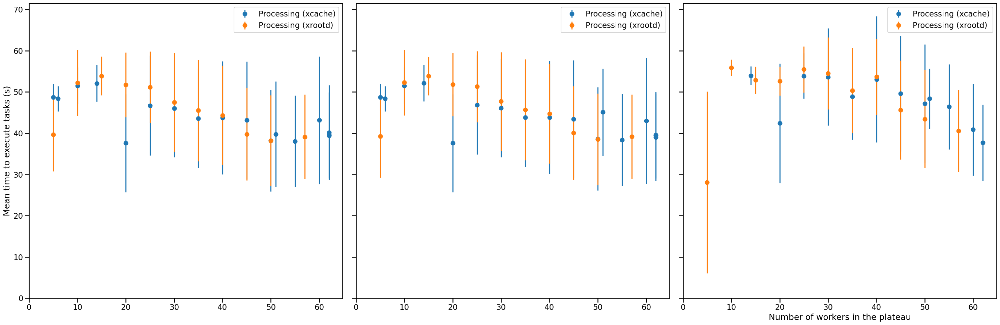

In [83]:
# reporting mean and std
fig, axs = plt.subplots(1, 3, figsize=(30, 10), sharey=True)

col = {'xcache': 'tab:blue', 'xrootd': 'tab:orange', 'unknown': 'gray'}

for redirector in task_time_df['redirector'].unique():
    df = task_time_df[task_time_df['redirector'] == redirector]
    label_suffix = f" ({redirector})"
    
    axs[0].errorbar(x=df.n_max_workers, y=df.mean_plateau_proc_time, yerr=df.std_plateau_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=col[redirector], marker='o')
   
    axs[1].errorbar(df.n_max_workers, df.mean_all_proc_time, yerr=df.std_all_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=col[redirector], marker='o')
   
    
    axs[2].errorbar(df.n_max_workers, df.mean_vr_proc_time, yerr=df.std_vr_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=col[redirector], marker='o')

axs[0].set_ylabel("Mean time to execute tasks (s)")
axs[2].set_xlabel("Number of workers in the plateau")

for ax in axs:
    ax.legend()
    ax.set_xlim(left=0)
    ax.set_ylim(bottom=0)

plt.tight_layout()
plt.show()

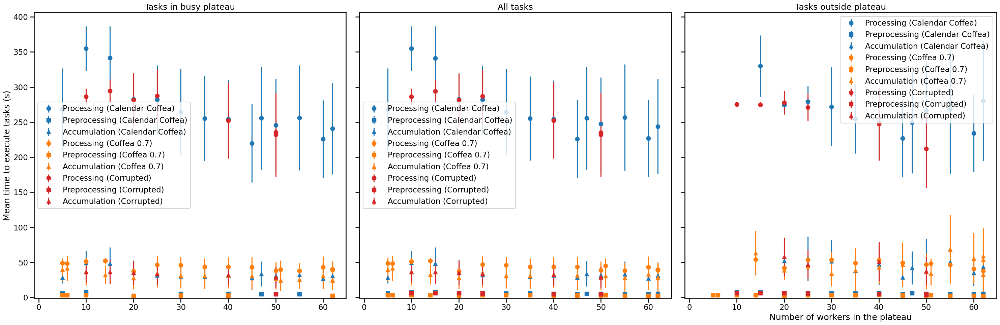

In [84]:
fig, axs = plt.subplots(1, 3, figsize=(30, 10), sharey=True)

datasets = {
    'Calendar Coffea': {'df': coffea25, 'color': 'tab:blue'},
    'Coffea 0.7': {'df': coffea07_xcache, 'color': 'tab:orange'},
    'Corrupted': {'df': checking, 'color': 'tab:red'}
}
marker = {'Processing': 'o', 'Preprocessing': 's', 'Accumulation': '^'}

for label, data in datasets.items():
    df = data['df']
    color = data['color']
    label_suffix = f" ({label})"

    axs[0].errorbar(df.n_max_workers, df.mean_plateau_proc_time, yerr= df.std_plateau_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=color, marker=marker['Processing'])
    axs[0].errorbar(df.n_max_workers, df.mean_plateau_pre_time, yerr= df.std_plateau_pre_time, linestyle=' ',
                   label='Preprocessing' + label_suffix, color=color, marker=marker['Preprocessing'])
    axs[0].errorbar(df.n_max_workers, df.mean_plateau_accum_time, yerr= df.std_plateau_accum_time, linestyle=' ',
                   label='Accumulation' + label_suffix, color=color, marker=marker['Accumulation'])

    axs[1].errorbar(df.n_max_workers, df.mean_all_proc_time, yerr= df.std_all_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=color, marker=marker['Processing'])
    axs[1].errorbar(df.n_max_workers, df.mean_all_pre_time, yerr= df.std_all_pre_time, linestyle=' ',
                   label='Preprocessing' + label_suffix, color=color, marker=marker['Preprocessing'])
    axs[1].errorbar(df.n_max_workers, df.mean_all_accum_time, yerr= df.std_all_accum_time, linestyle=' ',
                   label='Accumulation' + label_suffix, color=color, marker=marker['Accumulation'])

    axs[2].errorbar(df.n_max_workers, df.mean_vr_proc_time, yerr= df.std_vr_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=color, marker=marker['Processing'])
    axs[2].errorbar(df.n_max_workers, df.mean_vr_pre_time, yerr= df.std_vr_pre_time, linestyle=' ',
                   label='Preprocessing' + label_suffix, color=color, marker=marker['Preprocessing'])
    axs[2].errorbar(df.n_max_workers, df.mean_vr_accum_time, yerr= df.std_vr_accum_time, linestyle=' ',
                   label='Accumulation' + label_suffix, color=color, marker=marker['Accumulation'])

axs[0].set_ylabel("Mean time to execute tasks (s)")
axs[0].set_title("Tasks in busy plateau")
axs[1].set_title("All tasks")
axs[2].set_title("Tasks outside plateau")
axs[2].set_xlabel("Number of workers in the plateau")

for ax in axs:
    ax.legend()
    ax.set_xlim(left=-1)
    ax.set_ylim(bottom=-1)

plt.tight_layout()
plt.show()

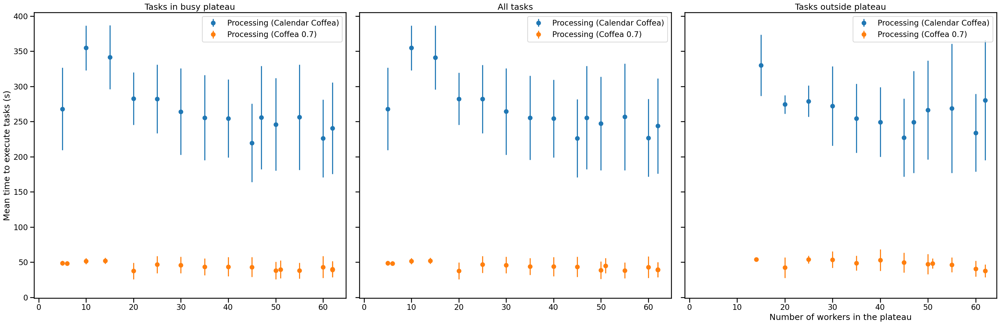

In [85]:
# reporting mean and std
fig, axs = plt.subplots(1, 3, figsize=(30, 10), sharey=True)

datasets = {
    'Calendar Coffea': {'df': coffea25, 'color': 'tab:blue'},
    'Coffea 0.7': {'df': coffea07_xcache, 'color': 'tab:orange'}
    #'Corrupted': {'df': checking, 'color': 'tab:red'}
}
marker = {'Processing': 'o', 'Preprocessing': 's', 'Accumulation': '^'}

for label, data in datasets.items():
    df = data['df']
    color = data['color']
    label_suffix = f" ({label})"

    axs[0].errorbar(df.n_max_workers, df.mean_plateau_proc_time, yerr= df.std_plateau_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=color, marker=marker['Processing'])

    axs[1].errorbar(df.n_max_workers, df.mean_all_proc_time, yerr= df.std_all_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=color, marker=marker['Processing'])

    axs[2].errorbar(df.n_max_workers, df.mean_vr_proc_time, yerr= df.std_vr_proc_time, linestyle=' ',
                   label='Processing' + label_suffix, color=color, marker=marker['Processing'])

axs[0].set_ylabel("Mean time to execute tasks (s)")
axs[0].set_title("Tasks in busy plateau")
axs[1].set_title("All tasks")
axs[2].set_title("Tasks outside plateau")
axs[2].set_xlabel("Number of workers in the plateau")

for ax in axs:
    ax.legend()
    ax.set_xlim(left=-1)
    ax.set_ylim(bottom=-1)

plt.tight_layout()
plt.show()

## Just processing comparison

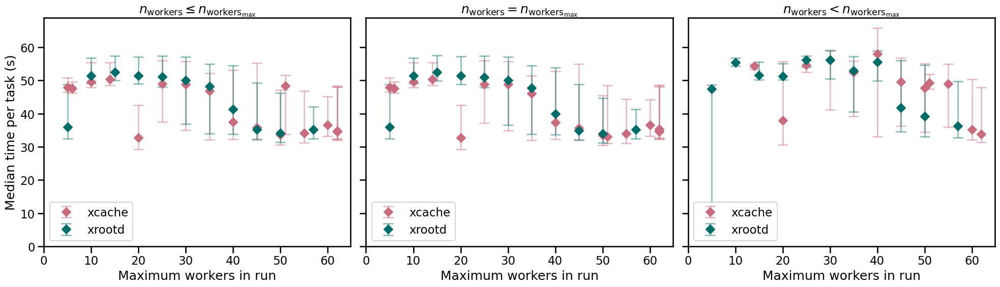

In [86]:
# reporting med and quantiles
fig, axs = plt.subplots(1, 3, figsize=(20, 20//3), sharey=True)

col = {'xcache':'#c76d7e' , 'xrootd':'#006c67', 'unknown': 'gray'}

for redirector in task_time_df['redirector'].unique():
    df = task_time_df[task_time_df['redirector'] == redirector]
    label_suffix = f"{redirector}"

   
    axs[0].errorbar(df.n_max_workers, df.med_all_proc_time,
                    yerr=np.vstack([(np.array(df.med_all_proc_time)-np.array(df['25q_all_proc_time'])),
                                    (np.array(df['75q_all_proc_time'] - np.array(df.med_all_proc_time)))]), 
                    linestyle=' ', label=label_suffix, color=col[redirector], marker='D', ecolor=col[redirector]+'70', 
                    elinewidth=2, capsize=7, capthick=2)
    axs[0].set_title(rf'$n_\mathrm{{workers}} \leq n_\mathrm{{workers_{{max}}}}$')

    
    axs[1].errorbar(x=df.n_max_workers, y=df.med_plateau_proc_time,
                    yerr=np.vstack([(np.array(df.med_plateau_proc_time)-np.array(df['25q_plateau_proc_time'])),
                                    (np.array(df['75q_plateau_proc_time'] - np.array(df.med_plateau_proc_time)))]), 
                    linestyle=' ', label=label_suffix, color=col[redirector], marker='D', ecolor=col[redirector]+'70', 
                    elinewidth=2, capsize=7, capthick=2)
    axs[1].set_title(rf'$n_\mathrm{{workers}} = n_\mathrm{{workers_{{max}}}}$')
    
    axs[2].errorbar(df.n_max_workers, df.med_vr_proc_time, 
                    yerr=np.vstack([(np.array(df.med_vr_proc_time)-np.array(df['25q_vr_proc_time'])),
                                    (np.array(df['75q_vr_proc_time'] - np.array(df.med_vr_proc_time)))]), 
                    linestyle=' ',label=label_suffix, color=col[redirector], marker='D', ecolor=col[redirector]+'70', 
                    elinewidth=2, capsize=7, capthick=2)
    axs[2].set_title(rf'$n_\mathrm{{workers}} < n_\mathrm{{workers_{{max}}}}$')
        
axs[0].set_ylabel("Median time per task (s)")
for ax in axs:
    ax.set_xlabel(rf'Maximum workers in run')
    ax.legend(loc='lower left')
    ax.set_xlim(left=0)
    ax.set_ylim(bottom=0)

#
plt.tight_layout()
fig.subplots_adjust(wspace=0.05)
#plt.savefig('poster_figs/coffea_redirector_comp.png', dpi=1000)
plt.show()

In [87]:
single_run = task_time_df[task_time_df.run == '2025-07-14T181555']
single_run

,n_max_workers,pre_tasks_plateau,proc_tasks_plateau,accum_tasks_plateau,total_tasks_plateau,runtime,mean_plateau_proc_time,mean_plateau_pre_time,mean_plateau_accum_time,mean_all_pre_time,mean_all_proc_time,mean_all_accum_time,mean_vr_proc_time,mean_vr_pre_time,mean_vr_accum_time,std_plateau_proc_time,std_plateau_pre_time,std_plateau_accum_time,std_all_pre_time,std_all_proc_time,std_all_accum_time,std_vr_proc_time,std_vr_pre_time,std_vr_accum_time,med_plateau_proc_time,med_all_proc_time,med_vr_proc_time,25q_plateau_proc_time,25q_all_proc_time,25q_vr_proc_time,75q_plateau_proc_time,75q_all_proc_time,75q_vr_proc_time,proc_tasks_per_s_plateau,pre_tasks_per_s_plateau,accum_tasks_per_s_plateau,cores_per_workers,cores_per_task,run,redirector
10,20,607,8027,883,9517,4245664104,37.610854,2.283612,27.983385,2.325858,37.622262,28.09264,42.442039,2.613992,38.811789,11.867517,0.594273,16.338183,0.601475,11.875612,16.340282,14.49112,0.573505,13.317705,32.740679,32.749693,37.933891,29.26359,29.265835,30.548728,42.554703,42.583158,55.758428,1.971118,0.149056,0.21683,8.0,1.258771,2025-07-14T181555,xcache


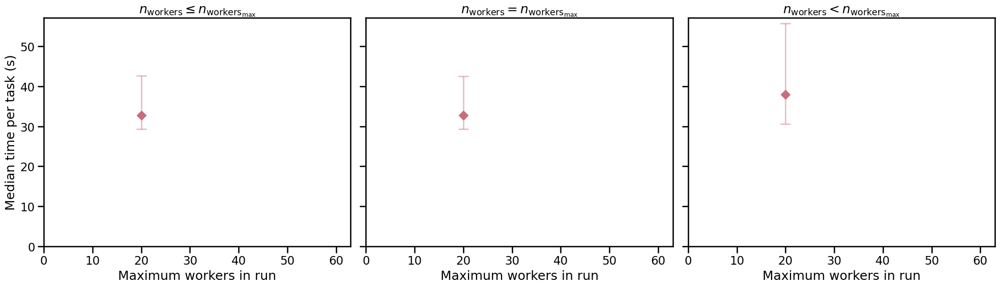

In [96]:
# reporting med and quantiles
fig, axs = plt.subplots(1, 3, figsize=(20, 20//3), sharey=True)

   
axs[0].errorbar(single_run.n_max_workers, single_run.med_all_proc_time,
                yerr=np.vstack([(np.array(single_run.med_all_proc_time)-np.array(single_run['25q_all_proc_time'])),
                                (np.array(single_run['75q_all_proc_time'] - np.array(single_run.med_all_proc_time)))]), 
                linestyle=' ', color='#c76d7e', marker='D', ecolor='#c76d7e70', 
                elinewidth=2, capsize=7, capthick=2)
axs[0].set_title(rf'$n_\mathrm{{workers}} \leq n_\mathrm{{workers_{{max}}}}$')

    
axs[1].errorbar(x=single_run.n_max_workers, y=single_run.med_plateau_proc_time,
                yerr=np.vstack([(np.array(single_run.med_plateau_proc_time)-np.array(single_run['25q_plateau_proc_time'])),
                                (np.array(single_run['75q_plateau_proc_time'] - np.array(single_run.med_plateau_proc_time)))]), 
                linestyle=' ', color='#c76d7e', marker='D', ecolor='#c76d7e70', 
                elinewidth=2, capsize=7, capthick=2)
axs[1].set_title(rf'$n_\mathrm{{workers}} = n_\mathrm{{workers_{{max}}}}$')
    
axs[2].errorbar(single_run.n_max_workers, single_run.med_vr_proc_time, 
                yerr=np.vstack([(np.array(single_run.med_vr_proc_time)-np.array(single_run['25q_vr_proc_time'])),
                                (np.array(single_run['75q_vr_proc_time'] - np.array(single_run.med_vr_proc_time)))]), 
                linestyle=' ', color='#c76d7e', marker='D', ecolor='#c76d7e70', 
                elinewidth=2, capsize=7, capthick=2)
axs[2].set_title(rf'$n_\mathrm{{workers}} < n_\mathrm{{workers_{{max}}}}$')
        
axs[0].set_ylabel("Median time per task (s)")
for ax in axs:
    ax.set_xlabel(rf'Maximum workers in run')
    #ax.legend(loc='lower left')
    ax.set_xlim(left=0, right=63)
    ax.set_ylim(bottom=0)

#
plt.tight_layout()
fig.subplots_adjust(wspace=0.05)
plt.savefig('poster_figs/single_point_scatter.png', dpi=400)
plt.show()

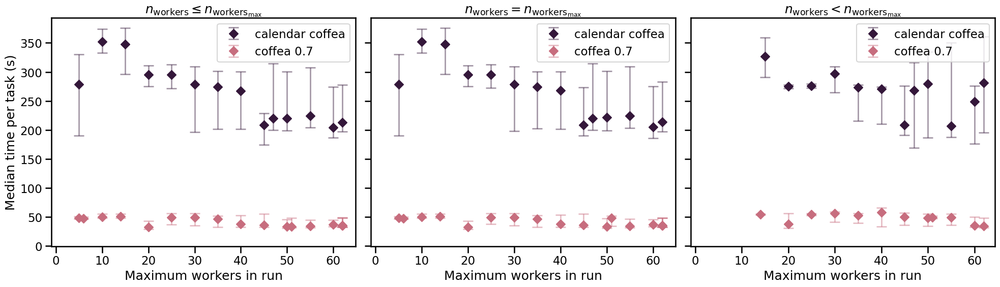

In [392]:
# reporting median and quantiles
fig, axs = plt.subplots(1, 3, figsize=(20, 20//3), sharey=True)

datasets = {
    'calendar coffea': {'df': coffea25, 'color': '#34173a'},
    'coffea 0.7': {'df': coffea07_xcache, 'color':'#c76d7e'}
    #'Corrupted': {'df': checking, 'color': 'tab:red'}
}
#marker = {'Processing': 'o', 'Preprocessing': 's', 'Accumulation': '^'}

for label, data in datasets.items():
    df = data['df']
    color = data['color']
    label_suffix = f"{label}"

    axs[0].errorbar(df.n_max_workers, df.med_plateau_proc_time,
                    yerr=np.vstack([(np.array(df.med_plateau_proc_time)-np.array(df['25q_plateau_proc_time'])),
                                    (np.array(df['75q_plateau_proc_time'] - np.array(df.med_plateau_proc_time)))]), 
                    linestyle=' ', label=label_suffix, color=color,  marker='D', ecolor=color+'70', 
                    elinewidth=2, capsize=7, capthick=2)

    axs[1].errorbar(df.n_max_workers, df.med_all_proc_time,
                    yerr=np.vstack([(np.array(df.med_all_proc_time)-np.array(df['25q_all_proc_time'])),
                                    (np.array(df['75q_all_proc_time'] - np.array(df.med_all_proc_time)))]), linestyle=' ',
                   label=label_suffix, color=color, marker='D', ecolor=color+'70', 
                    elinewidth=2, capsize=7, capthick=2)

    axs[2].errorbar(df.n_max_workers, df.med_vr_proc_time,
                    yerr=np.vstack([(np.array(df.med_vr_proc_time)-np.array(df['25q_vr_proc_time'])),
                                    (np.array(df['75q_vr_proc_time'] - np.array(df.med_vr_proc_time)))]), linestyle=' ',
                   label=label_suffix, color=color,  marker='D', ecolor=color+'70', 
                    elinewidth=2, capsize=7, capthick=2)

axs[0].set_ylabel("Median time per task (s)")
axs[0].set_title(rf'$n_\mathrm{{workers}} \leq n_\mathrm{{workers_{{max}}}}$')
axs[1].set_title(rf'$n_\mathrm{{workers}} = n_\mathrm{{workers_{{max}}}}$')
axs[2].set_title(rf'$n_\mathrm{{workers}} < n_\mathrm{{workers_{{max}}}}$')

for ax in axs:
    ax.set_xlabel(rf'Maximum workers in run')
    ax.legend(loc='upper right')
    ax.set_xlim(left=-1)
    ax.set_ylim(bottom=-1)

plt.tight_layout()
fig.subplots_adjust(wspace=0.05)
#plt.savefig('poster_figs/coffea_version_comp.png', dpi=1000)
plt.show()

In [393]:
x = np.array(coffea25.n_max_workers).reshape(-1, 1)
y = (coffea25.mean_plateau_proc_time)
reg = LinearRegression().fit(x, y)
reg.intercept_

323.0199295496169

In [394]:
reg.coef_

array([-1.55504237])

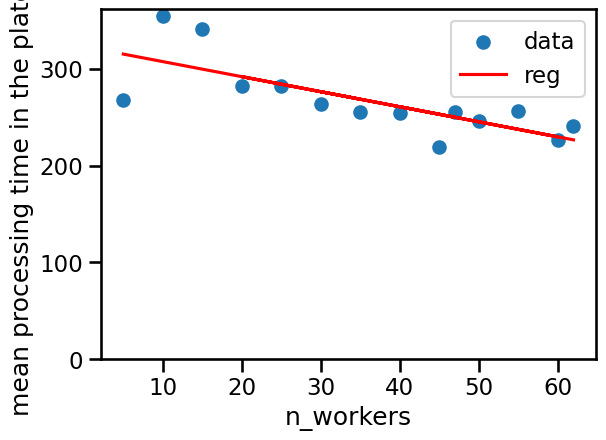

In [395]:
y_pred = reg.predict(x)
plt.scatter(x, y, label='data')
plt.plot(x, y_pred, color='red', label='reg')
plt.xlabel('n_workers')
plt.ylabel('mean processing time in the plateau')
plt.legend()
plt.tight_layout()
plt.ylim(0)
plt.show()

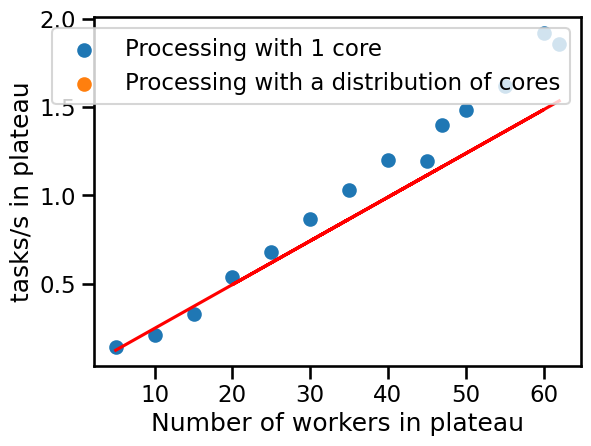

In [396]:
one_core = coffea25[coffea25.cores_per_task == 1]
not_one_core = coffea25[coffea25.cores_per_task != 1]

ideal_line =  (1/reg.intercept_)*np.array(coffea25.n_max_workers)*8

plt.scatter(one_core.n_max_workers, one_core.proc_tasks_per_s_plateau, label="Processing with 1 core")
plt.scatter(not_one_core.n_max_workers, not_one_core.proc_tasks_per_s_plateau, label="Processing with a distribution of cores")
plt.plot(coffea25.n_max_workers, ideal_line, color='red')
plt.ylabel("tasks/s in plateau")
plt.legend()
plt.ylabel("tasks/s in plateau")
plt.xlabel("Number of workers in plateau")
plt.tight_layout()

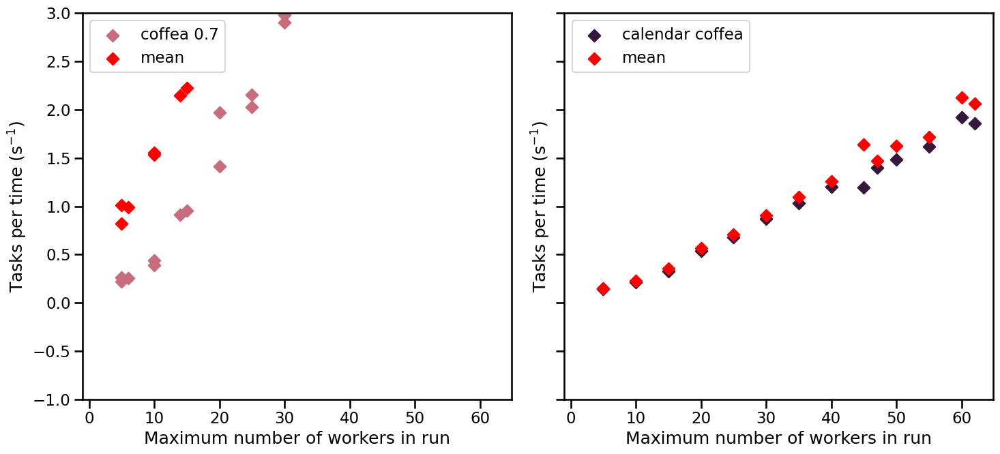

In [397]:
fig, axs = plt.subplots(1,2, figsize=(15, 15//2), sharey=True)
## error bars????

#one_core = task_time_df[task_time_df.cores_per_task == 1]
#not_one_core = task_time_df[task_time_df.cores_per_task != 1]

#ideal_line =  (1/reg.intercept_)*np.array(task_time_df.n_max_workers)*8

axs[0].scatter(task_time_df.n_max_workers, task_time_df.proc_tasks_per_s_plateau, label="coffea 0.7", marker='D', color='#c76d7e')
axs[0].scatter(task_time_df.n_max_workers, (1/task_time_df.mean_plateau_proc_time)*8*task_time_df.n_max_workers, label="mean", marker='D', color='red')
axs[0].set_ylabel(r"Tasks per time ($\mathrm{s}^{-1}$)")
axs[0].legend()

axs[1].scatter(coffea25.n_max_workers, coffea25.proc_tasks_per_s_plateau, label="calendar coffea", marker='D', color='#34173a')
axs[1].scatter(coffea25.n_max_workers, (1/coffea25.mean_plateau_proc_time)*8*coffea25.n_max_workers, label="mean", marker='D', color='red')
axs[1].set_ylabel(r"Tasks per time ($\mathrm{s}^{-1}$)")
axs[1].legend()

for ax in axs:
    ax.set_xlabel(rf'Maximum number of workers in run')
    ax.legend(loc='upper left')
    ax.set_xlim(left=-1)
    ax.set_ylim(bottom=-1, top=3)
plt.tight_layout()

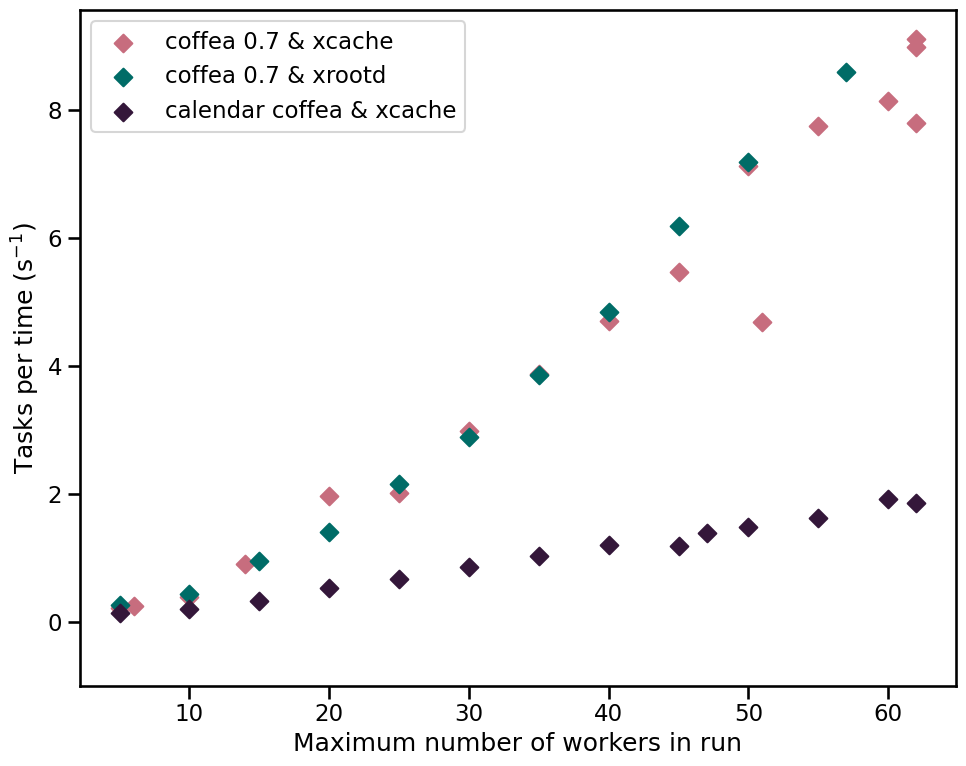

In [398]:
plt.figure(figsize=(10, 8))

col = {'xcache':'#c76d7e' , 'xrootd':'#006c67', 'unknown': 'gray'}

for redirector in task_time_df['redirector'].unique():
    df = task_time_df[task_time_df['redirector'] == redirector]
    label_suffix = f"{redirector}"
    plt.scatter(df.n_max_workers, df.proc_tasks_per_s_plateau, label="coffea 0.7 & " + label_suffix, marker='D', color=col[redirector])

plt.scatter(coffea25.n_max_workers, coffea25.proc_tasks_per_s_plateau, label="calendar coffea & xcache", marker='D', color='#34173a')
plt.ylabel(r"Tasks per time ($\mathrm{s}^{-1}$)")
plt.xlabel(rf'Maximum number of workers in run')
plt.legend(loc='upper left')
plt.ylim(bottom=-1)
#plt.savefig("poster_figs/tasks_per_s_proc_plateau.png", dpi=1000)
plt.tight_layout()

## Runtime

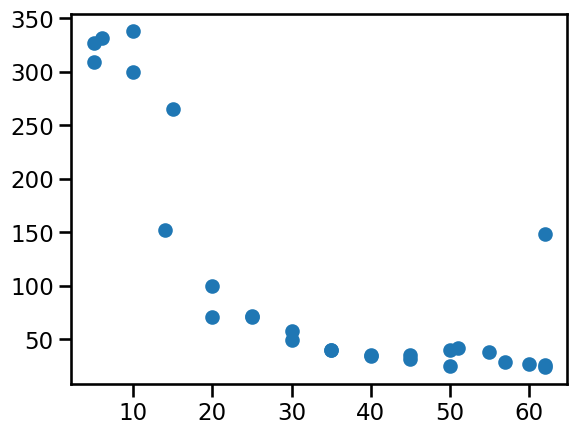

In [399]:
plt.scatter(task_time_df.n_max_workers, task_time_df.runtime/6e7)

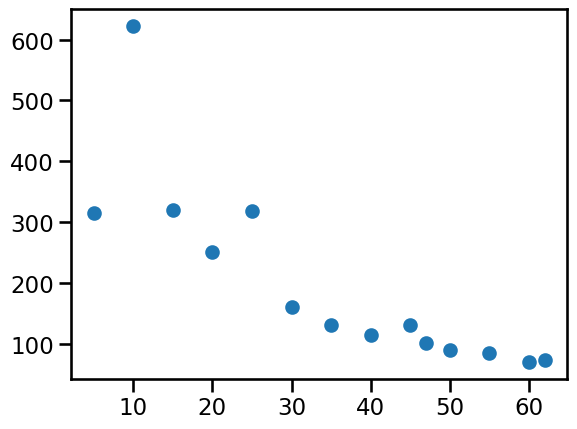

In [400]:
plt.scatter(coffea25.n_max_workers, coffea25.runtime/6e7)

In [401]:
print(f'Min runtime for coffea25: {np.min(coffea25.runtime/6e7)} min')
print(f'Max runtime for coffea25: {np.max(coffea25.runtime/3.6e9)} h')
print(f'Min runtime for coffea07: {np.min(task_time_df.runtime/6e7)} min')
print(f'Max runtime for coffea07: {np.max(task_time_df.runtime/3.6e9)} h')

Min runtime for coffea25: 70.75594843333333 min
Max runtime for coffea25: 10.375961061666667 h
Min runtime for coffea07: 24.202554983333332 min
Max runtime for coffea07: 5.637703223888889 h


In [402]:
all_run = pd.concat([task_time_df, coffea25], ignore_index=True)

In [403]:
print(f'Total time running: {sum(all_run.runtime)/3.6e9}')

Total time running: 97.42405423972222


In [404]:
print(f'Total workers for all runs: {sum(all_run.n_max_workers)}')

Total workers for all runs: 1463


In [405]:
.37*60

22.2

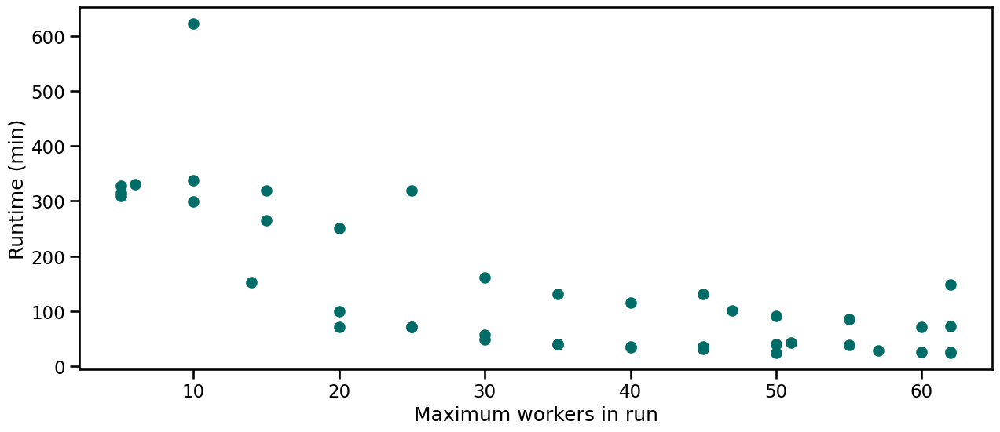

In [406]:
plt.figure(figsize=(15, 6))
plt.scatter(all_run.n_max_workers, all_run.runtime/6e7, marker='o', color='#006c67')
plt.xlabel('Maximum workers in run')
plt.ylabel('Runtime (min)')
plt.savefig('poster_figs/runtime_worker_quick.png', dpi=400)

# This is where the ndcctools update works, and the runs are now stable
* dfs generated with vine_plot_txn_log_bad, which worked for this version of ndcctools

## Run 2025/07/08 141924

### Description

* 8 core workers, 16GB disk/worker
* all datasets
* ndcctools 7.15.5
* worker transfers on
* chunksize = 10k
* finished last task

In [407]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-08T141924')

In [408]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-08T141924')

In [409]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 61
total workers active time = 41.67510133186977 mins, 0.6945850221978295 hours
Mean worker connection time = 37.939094316829106 mins, 0.6323182386138184 hours
# tasks on this run = 9642


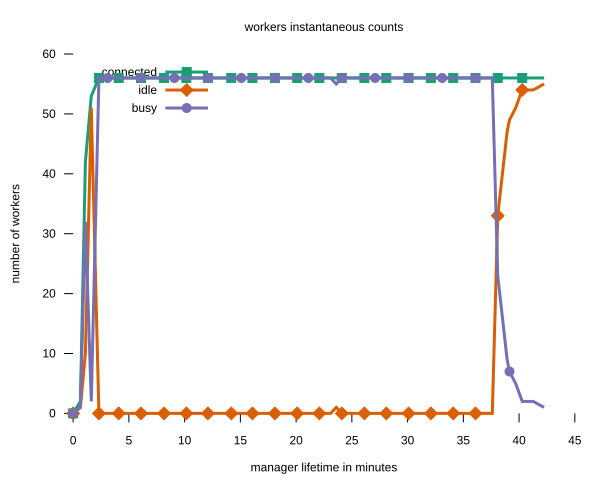

In [410]:
worker_svg

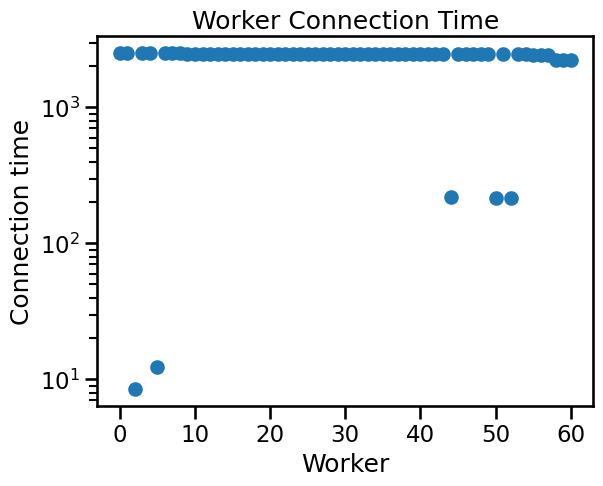

In [411]:
worker_conn_time = plot_worker_times(workers_t)

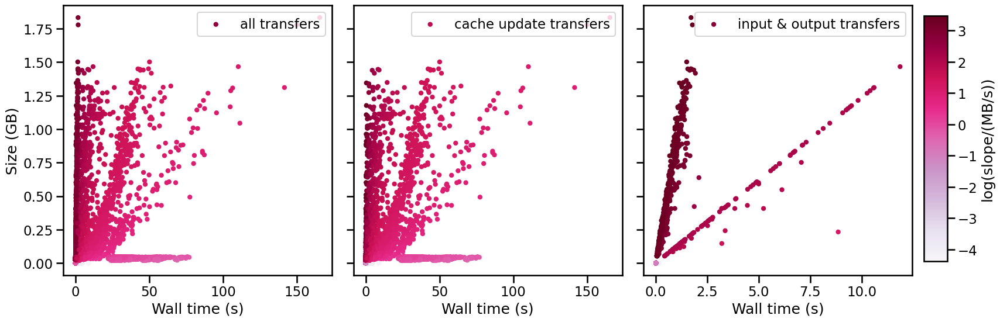

In [412]:
transfer_time_plot = transfer_time(transfers_t)

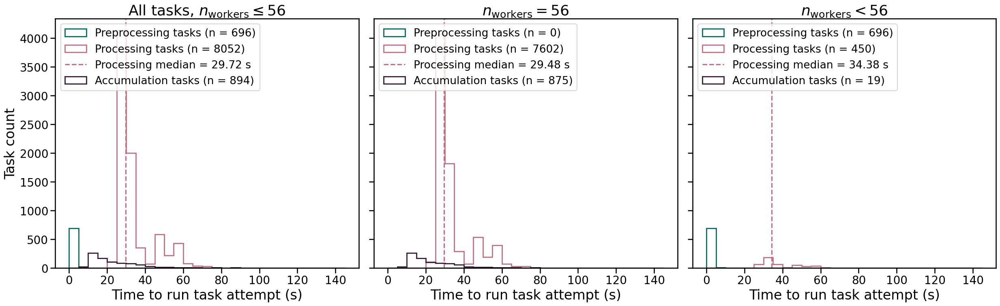

In [413]:
task_time_hist = task_hist(tasks_t, performance_t, 0, 150, 5)

### Transfers plot and slope

Text(0.5, 1.0, 'Transfer Time vs Size')

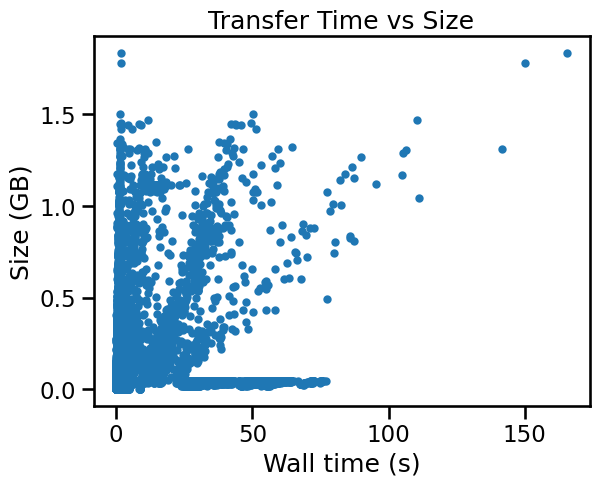

In [414]:
plt.scatter(transfers_t.wall_time, transfers_t['size']/1000, marker='.')
plt.xlabel('Wall time (s)')
plt.ylabel('Size (GB)')
plt.title('Transfer Time vs Size')

In [415]:
'''col = transfers_t.columns.get_loc('wall_time')
transfers_t.insert(col+1, 'size_per_time', np.nan)
transfers_t.loc[:, ('size_per_time')] = (transfers_t.loc[:, ('size')]) /  (transfers_t.loc[:, ('wall_time')])
#transfer = transfers_t[transfers_t.wall_time <= 1]'''

"col = transfers_t.columns.get_loc('wall_time')\ntransfers_t.insert(col+1, 'size_per_time', np.nan)\ntransfers_t.loc[:, ('size_per_time')] = (transfers_t.loc[:, ('size')]) /  (transfers_t.loc[:, ('wall_time')])\n#transfer = transfers_t[transfers_t.wall_time <= 1]"

Text(0.5, 1.0, 'Transfer Time vs Size')

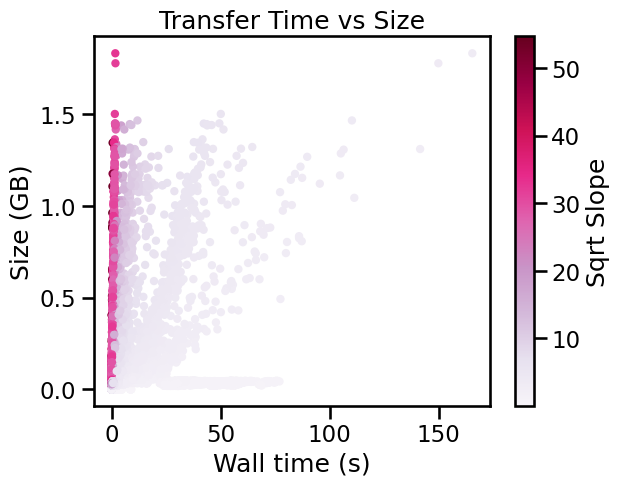

In [416]:
fig, ax = plt.subplots()
scatter = plt.scatter(transfers_t.wall_time, transfers_t['size']/1000, marker='.', c=np.sqrt(transfers_t.size_per_time), cmap='PuRd')
fig.colorbar(scatter, ax=ax, label='Sqrt Slope')
plt.xlabel('Wall time (s)')
plt.ylabel('Size (GB)')
plt.title('Transfer Time vs Size')

Text(0.5, 1.0, 'Transfer Time vs Size')

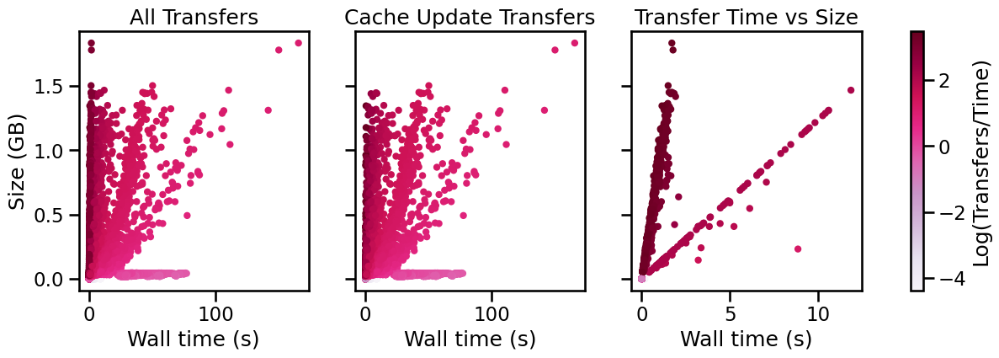

In [417]:
transfer_cache = transfers_t[transfers_t.direction == 'CACHE_UPDATE']
transfer_notcache = transfers_t[transfers_t.direction != 'CACHE_UPDATE']

fig, ax = plt.subplots(1, 3, figsize=(15, 4), sharey=True)
global_min = min(transfers_t.size_per_time.min(), transfer_cache.size_per_time.min(), transfer_notcache.size_per_time.min())
global_max = max(transfers_t.size_per_time.max(), transfer_cache.size_per_time.max(), transfer_notcache.size_per_time.max())
norm = colors.Normalize(vmin=global_min, vmax=global_max)

im1 = ax[0].scatter(transfers_t.wall_time, transfers_t['size']/1000, marker='.', cmap='PuRd', c=np.log10(transfers_t.size_per_time))
ax[0].set_title('All Transfers')
ax[0].set_xlabel('Wall time (s)')
ax[0].set_ylabel('Size (GB)')

im2 = ax[1].scatter(transfer_cache.wall_time, transfer_cache['size']/1000, marker='.', cmap='PuRd', c=np.log10(transfer_cache.size_per_time))
ax[1].set_title('Cache Update Transfers')
ax[1].set_xlabel('Wall time (s)')

im3 = ax[2].scatter(transfer_notcache.wall_time, transfer_notcache['size']/1000, marker='.', cmap='PuRd', c=np.log10(transfer_notcache.size_per_time))
ax[2].set_title('Inputs & Outputs Transfers')
ax[2].set_xlabel('Wall time (s)')

fig.colorbar(im1, ax=ax.ravel().tolist(), orientation='vertical', shrink=1, label='Log(Transfers/Time)')


#plt.ylim(0,0.05)
#plt.xlim(20,150)
plt.title('Transfer Time vs Size')

Text(0.5, 1.0, 'Transfer Time vs Size of Cache Updates')

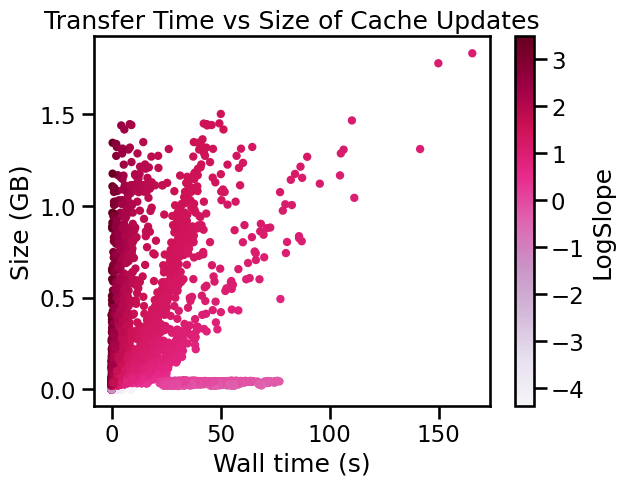

In [418]:
fig, ax = plt.subplots()
scatter = plt.scatter(transfer_cache.wall_time, transfer_cache['size']/1000, marker='.', c=np.log10(transfer_cache.size_per_time), cmap='PuRd')
fig.colorbar(scatter, ax=ax, label='LogSlope')
plt.xlabel('Wall time (s)')
plt.ylabel('Size (GB)')
#plt.ylim(0,0.05)
#plt.xlim(20,150)
plt.title('Transfer Time vs Size of Cache Updates')

Text(0.5, 1.0, 'Transfer Time vs Size of Inputs & Outputs')

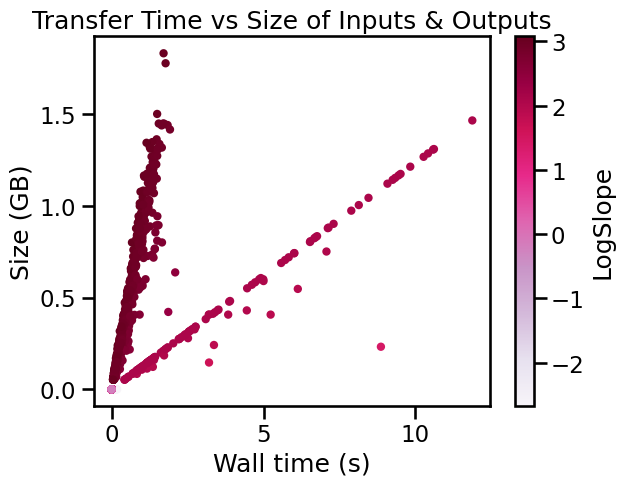

In [419]:
fig, ax = plt.subplots()
scatter = plt.scatter(transfer_notcache.wall_time, transfer_notcache['size']/1000, marker='.', c=np.log10(transfer_notcache.size_per_time), cmap='PuRd')
fig.colorbar(scatter, ax=ax, label='LogSlope')
plt.xlabel('Wall time (s)')
plt.ylabel('Size (GB)')
#plt.ylim(0,0.05)
#plt.xlim(20,150)
plt.title('Transfer Time vs Size of Inputs & Outputs')

In [420]:
transfer_notcache

,worker_id,hostport,time,direction,filetype,filename,size,wall_time,size_per_time,start_time
0,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,35.943277,INPUT,file,analysis_processor.py,0.063801,0.000154,414.292208,35.943121
1,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,39.142049,INPUT,file,package.tar.gz,407.320470,3.198714,127.338821,35.943299
2,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,39.142318,INPUT,w_adec4169,w_adec4169-7031-40e2-b178-26d24312d060,0.000549,0.000036,15.250000,39.142281
3,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,39.142348,INPUT,f_adec4169,f_adec4169-7031-40e2-b178-26d24312d060,0.000261,0.000017,15.352941,39.142330
4,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,39.142392,INPUT,a_adec4169,a_adec4169-7031-40e2-b178-26d24312d060,0.000291,0.000031,9.387097,39.142360
...,...,...,...,...,...,...,...,...,...,...
45933,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2208.993920,INPUT,a_50ce9cc0,a_50ce9cc0-5c1c-4342-9417-cea11a3141eb,0.000114,0.000204,0.558824,2208.993713
45947,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2220.487822,OUTPUT,o_50ce9cc0,o_50ce9cc0-5c1c-4342-9417-cea11a3141eb,112.391682,0.128795,872.640102,2220.358951
45948,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2220.489316,INPUT,a_009d09ad,a_009d09ad-a443-4fe4-b46a-2fa8ba60a301,0.000352,0.000210,1.676190,2220.489103
45953,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2249.172667,INPUT,a_0b70b10f,a_0b70b10f-21a8-4c1d-83fe-806e654d7fde,0.000114,0.000186,0.612903,2249.172479


In [421]:
transfer_cache

,worker_id,hostport,time,direction,filetype,filename,size,wall_time,size_per_time,start_time
12,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,65.991610,CACHE_UPDATE,task,task-rnd-lgsjbjvrekdnwuk,1112.635891,16.842525,66.061110,39.241409
13,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,65.993664,CACHE_UPDATE,file,file-rnd-hhjtsfkfrjopgoj,0.000374,3.548069,0.000105,56.242035
14,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,65.995895,CACHE_UPDATE,file,file-rnd-msdoacfjtewnmyj,0.000378,4.353383,0.000087,56.240627
15,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,65.998249,CACHE_UPDATE,file,file-rnd-kxursaqzkzgfkvy,0.000378,4.530257,0.000083,56.239209
16,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,66.000824,CACHE_UPDATE,file,file-rnd-sziktjnuvmsiuva,0.000373,4.540698,0.000082,56.239915
...,...,...,...,...,...,...,...,...,...,...
45959,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2249.839194,CACHE_UPDATE,temp,temp-rnd-orcizkvbttegzyd,20.404059,0.665210,30.673109,2249.168181
45960,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2251.549386,CACHE_UPDATE,file,file-rnd-subnbgmrkywrlmj,99.231798,2.373559,41.807176,2249.169811
45961,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2269.776794,CACHE_UPDATE,file,file-rnd-ducpgwlgxkalxlp,148.041423,11.656191,12.700669,2251.544760
45963,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2280.013367,CACHE_UPDATE,temp,temp-rnd-ncheavwmdzcryjn,26.671026,0.078751,338.675395,2279.839791


Text(0.5, 1.0, 'Transfer Time vs Size')

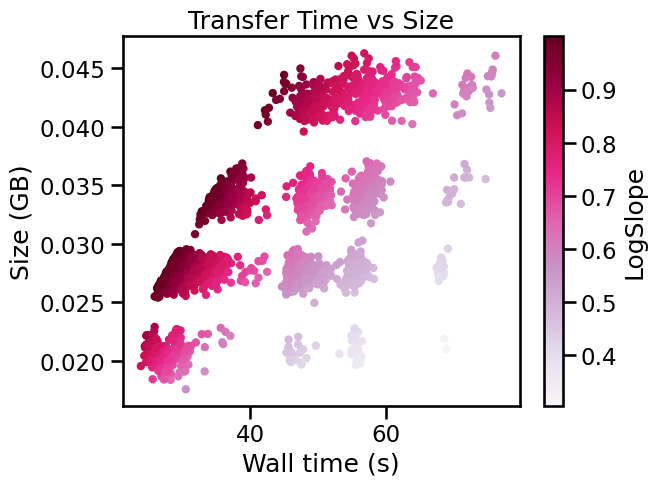

In [422]:
transfer1 = transfers_t[(transfers_t.size_per_time < 1) & (transfers_t.wall_time >=20)]
fig, ax = plt.subplots()
scatter = plt.scatter(transfer1.wall_time, transfer1['size']/1000, marker='.', c=transfer1.size_per_time, cmap='PuRd')
fig.colorbar(scatter, ax=ax, label='LogSlope')
plt.xlabel('Wall time (s)')
plt.ylabel('Size (GB)')
plt.title('Transfer Time vs Size')

In [423]:
#pd.set_option('display.max_rows', None)
#pd.reset_option('display.max_rows')
transfer1

,worker_id,hostport,time,direction,filetype,filename,size,wall_time,size_per_time,start_time
109,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,166.869044,CACHE_UPDATE,temp,temp-rnd-qopualjyingvbde,45.383842,55.489784,0.817877,111.227847
110,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,167.050889,CACHE_UPDATE,temp,temp-rnd-ocabwcoorvtievu,44.435074,55.639938,0.798618,111.207456
113,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,167.887016,CACHE_UPDATE,temp,temp-rnd-qfmbftdwygehebq,43.443412,56.647588,0.766907,111.184124
114,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,167.991224,CACHE_UPDATE,temp,temp-rnd-huvjlkfhsfgdsxm,46.269444,56.785817,0.814806,111.134150
117,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,168.253780,CACHE_UPDATE,temp,temp-rnd-nnmwpmjqgvxnvup,43.714214,56.863620,0.768755,111.212234
...,...,...,...,...,...,...,...,...,...,...
45903,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2105.790549,CACHE_UPDATE,temp,temp-rnd-rrjoegjaxmjgfjk,28.143392,28.666974,0.981736,2077.117215
45908,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2135.659361,CACHE_UPDATE,temp,temp-rnd-avuknfurarkkplr,28.139255,29.699212,0.947475,2105.954173
45926,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2180.265545,CACHE_UPDATE,temp,temp-rnd-gtaaiaisruhskie,21.600168,29.550446,0.730959,2150.709055
45932,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2208.978401,CACHE_UPDATE,temp,temp-rnd-pptkxijitkcbhgj,21.686872,28.692249,0.755844,2180.280137


Text(0.5, 1.0, 'Transfer Time vs Size')

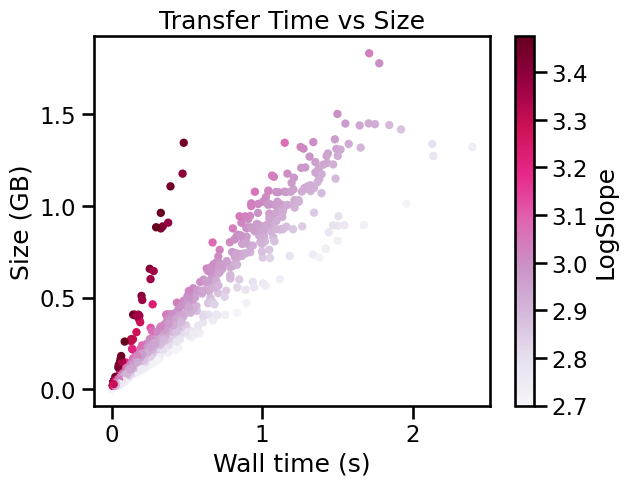

In [424]:
transferbig = transfers_t[transfers_t.size_per_time >= 500]
fig, ax = plt.subplots()
scatter = plt.scatter(transferbig.wall_time, transferbig['size']/1000, marker='.', c=np.log10(transferbig.size_per_time), cmap='PuRd')
fig.colorbar(scatter, ax=ax, label='LogSlope')
plt.xlabel('Wall time (s)')
plt.ylabel('Size (GB)')
plt.title('Transfer Time vs Size')

In [425]:
print(f'Transfers/s not cache direction counts: \n {transfer_notcache.direction.value_counts()}')
print('_______')
print(f'Transfers/s < 1MB/s direction counts: \n {transfer1.direction.value_counts()}')
print('_______')
print(f'Transfers/s < 1MB/s direction percentage: \n {(transfer1.direction.value_counts()*100)/len(transfer1)}')
print('_______')

print(f'Transfers/s < 1MB/s filetype counts: \n {transfer1.filetype.value_counts()}')
print('____________________________________________')
print(f'Transfers/s >= 500MB/s direction counts: \n {transferbig.direction.value_counts()}')
print('_______')
print(f'Transfers/s >= 500MB/s direction percentage: \n {(transferbig.direction.value_counts()*100)/len(transferbig)}')
print('_______')
print(f'Transfers/s >= 500MB/s filetype counts: \n {transferbig.filetype.value_counts()}')

Transfers/s not cache direction counts: 
 direction
INPUT     9780
OUTPUT    1588
Name: count, dtype: int64
_______
Transfers/s < 1MB/s direction counts: 
 direction
CACHE_UPDATE    2940
Name: count, dtype: int64
_______
Transfers/s < 1MB/s direction percentage: 
 direction
CACHE_UPDATE    100.0
Name: count, dtype: float64
_______
Transfers/s < 1MB/s filetype counts: 
 filetype
temp    2940
Name: count, dtype: int64
____________________________________________
Transfers/s >= 500MB/s direction counts: 
 direction
CACHE_UPDATE    4692
OUTPUT           760
INPUT              2
Name: count, dtype: int64
_______
Transfers/s >= 500MB/s direction percentage: 
 direction
CACHE_UPDATE    86.028603
OUTPUT          13.934727
INPUT            0.036670
Name: count, dtype: float64
_______
Transfers/s >= 500MB/s filetype counts: 
 filetype
temp          4574
file           120
o_7dc7b4bc       1
o_0d12ce74       1
o_7435f7e4       1
              ... 
o_9804f012       1
o_af3ebbef       1
o_5f4b7029 

In [426]:
transfers_t

,worker_id,hostport,time,direction,filetype,filename,size,wall_time,size_per_time,start_time
0,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,35.943277,INPUT,file,analysis_processor.py,0.063801,0.000154,414.292208,35.943121
1,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,39.142049,INPUT,file,package.tar.gz,407.320470,3.198714,127.338821,35.943299
2,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,39.142318,INPUT,w_adec4169,w_adec4169-7031-40e2-b178-26d24312d060,0.000549,0.000036,15.250000,39.142281
3,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,39.142348,INPUT,f_adec4169,f_adec4169-7031-40e2-b178-26d24312d060,0.000261,0.000017,15.352941,39.142330
4,worker-534149803768f8ef355f12d72b28cd97,192.168.41.157:46288,39.142392,INPUT,a_adec4169,a_adec4169-7031-40e2-b178-26d24312d060,0.000291,0.000031,9.387097,39.142360
...,...,...,...,...,...,...,...,...,...,...
45960,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2251.549386,CACHE_UPDATE,file,file-rnd-subnbgmrkywrlmj,99.231798,2.373559,41.807176,2249.169811
45961,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2269.776794,CACHE_UPDATE,file,file-rnd-ducpgwlgxkalxlp,148.041423,11.656191,12.700669,2251.544760
45962,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2275.095066,OUTPUT,o_0b70b10f,o_0b70b10f-21a8-4c1d-83fe-806e654d7fde,148.041423,0.172097,860.220823,2274.922917
45963,worker-4c7f39da1cc81c352a2e2bb4695aa6df,192.168.41.157:43386,2280.013367,CACHE_UPDATE,temp,temp-rnd-ncheavwmdzcryjn,26.671026,0.078751,338.675395,2279.839791


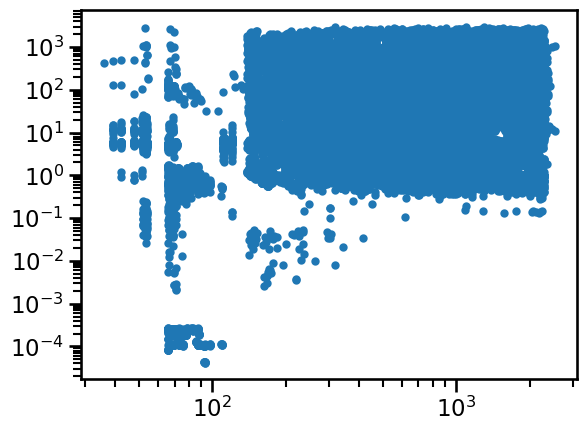

In [427]:
plt.scatter(transfers_t.time, transfers_t.size_per_time, marker='.')
plt.semilogy(())
plt.semilogx(())

Text(0, 0.5, 'Log Size (GB)')

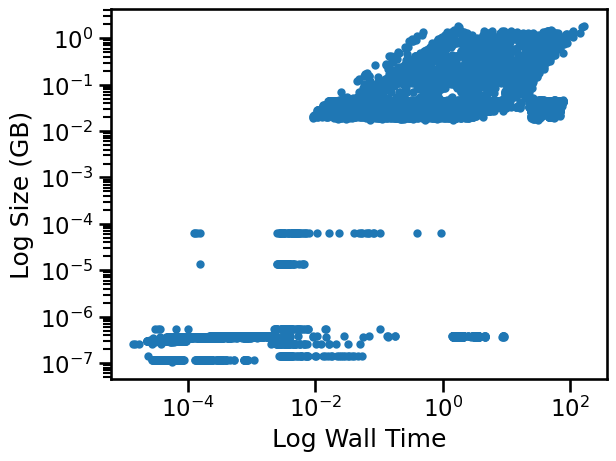

In [428]:
plt.scatter(transfers_t.wall_time, transfers_t['size']/1000, marker='.')
plt.semilogy(())
plt.semilogx(())
plt.xlabel('Log Wall Time')
plt.ylabel('Log Size (GB)')

### Messing with performance plots

In [429]:
performance_t

,timestamp,lifetime,workers_connected,workers_init,workers_idle,workers_busy,workers_able,workers_joined,workers_removed,workers_released,workers_idled_out,workers_blocked,workers_slow,workers_lost,tasks_waiting,tasks_on_workers,tasks_running,tasks_with_results,tasks_submitted,tasks_dispatched,tasks_done,tasks_failed,tasks_cancelled,tasks_exhausted_attempts,time_send,time_receive,time_send_good,time_receive_good,time_status_msgs,time_internal,time_polling,time_application,time_scheduling,time_execute,time_execute_good,time_execute_exhaustion,bytes_sent,bytes_received,bandwidth,capacity_tasks,capacity_cores,capacity_memory,capacity_disk,capacity_instantaneous,capacity_weighted,total_cores,total_memory,total_disk,committed_cores,committed_memory,committed_disk,max_cores,max_memory,max_disk,min_cores,min_memory,min_disk,inuse_cache
0,1751984364987577,0.000000e+00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.000000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1751984364987661,8.400000e+01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.000000,10,10,5120,10240,10,10,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1751984404130170,3.914259e+07,2,0,1,1,1,2,0,0,0,0,0,0,695,1,1,0,696,0,0,0,0,0,41229,115,0,0,17052,57012,35334896,492436,14813,0,0,0,407385372,0,1.000000,10,10,5120,10240,10,10,8,32800,131074,0,0,0,8,32800,131074,8,32800,131074,389
3,1751984407390132,4.240256e+07,9,0,5,4,9,9,0,0,0,0,0,0,671,25,25,0,696,25,0,0,0,0,6458767,122,0,0,57976,57862,35334957,492436,17926,0,0,0,814777606,0,120.304355,10,10,5120,10240,10,10,72,295200,1179666,25,102500,307979,8,32800,131074,8,32800,131074,1166
4,1751984412637861,4.765028e+07,9,0,3,6,9,9,0,0,0,0,0,0,655,41,41,0,696,56,16,0,0,0,6469953,1021,0,0,58374,58126,35335044,492559,21159,0,0,0,1222172244,0,180.120377,10,10,41000,122562,0,10,72,295200,1179666,40,164000,492172,8,32800,131074,8,32800,131074,2332
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6551,1751986781949584,2.416962e+09,56,0,54,2,56,61,5,0,0,0,0,3,0,2,2,0,9642,9756,9720,0,0,0,507352864,761897371,0,760166231,13807573,3194590,918425966,211932050,468271788,294053517940,294053517940,0,2825473838,344251790285,260.782833,10,54,245000,718045,3,249,448,1836800,7340115,12,56750,255501,8,32800,131074,8,32800,131073,90909
6552,1751986841338140,2.476351e+09,56,0,54,2,56,61,5,0,0,0,0,3,0,3,2,1,9642,9756,9720,0,0,0,507352869,761897622,0,760166231,13809614,3213218,977666301,212059004,468271788,294203433658,294053517940,0,2825473838,344251790285,260.782781,10,54,245103,718352,5,122,448,1836800,7340115,12,56750,256885,8,32800,131074,8,32800,131073,88632
6553,1751986843116461,2.478129e+09,56,0,55,1,56,61,5,0,0,0,0,3,0,1,1,0,9642,9756,9721,0,0,0,507352869,763675876,0,761943806,13809778,3213228,977666301,212059004,468271788,294203433658,294203433658,0,2825473838,346030206705,261.752304,10,54,245103,718352,5,112,448,1836800,7340115,6,28500,174884,8,32800,131074,8,32800,131073,88632
6554,1751986899723700,2.534736e+09,56,0,55,1,56,61,5,0,0,0,0,3,0,2,1,1,9642,9756,9721,0,0,0,507352874,763676103,0,761943806,13815870,3231989,1034074604,212232561,468271788,294368931244,294203433658,0,2825473838,346030206705,261.752256,10,55,246378,721818,6,60,448,1836800,7340115,6,28500,157183,8,32800,131074,8,32800,131073,74906


In [430]:
performance_t[performance_t.tasks_failed > 0]

,timestamp,lifetime,workers_connected,workers_init,workers_idle,workers_busy,workers_able,workers_joined,workers_removed,workers_released,workers_idled_out,workers_blocked,workers_slow,workers_lost,tasks_waiting,tasks_on_workers,tasks_running,tasks_with_results,tasks_submitted,tasks_dispatched,tasks_done,tasks_failed,tasks_cancelled,tasks_exhausted_attempts,time_send,time_receive,time_send_good,time_receive_good,time_status_msgs,time_internal,time_polling,time_application,time_scheduling,time_execute,time_execute_good,time_execute_exhaustion,bytes_sent,bytes_received,bandwidth,capacity_tasks,capacity_cores,capacity_memory,capacity_disk,capacity_instantaneous,capacity_weighted,total_cores,total_memory,total_disk,committed_cores,committed_memory,committed_disk,max_cores,max_memory,max_disk,min_cores,min_memory,min_disk,inuse_cache


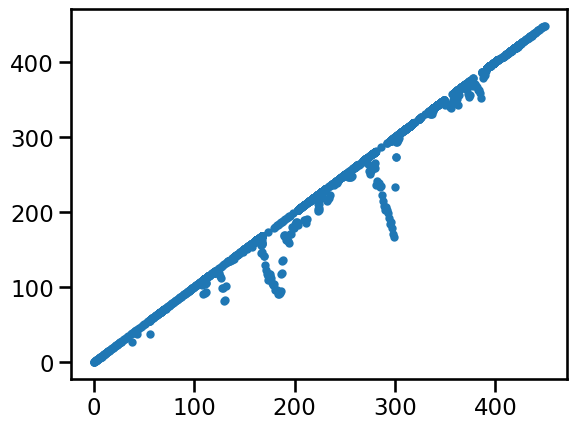

In [431]:
plt.scatter(performance_t.tasks_on_workers, performance_t.tasks_running, marker='.')

Text(0, 0.5, 'Running tasks')

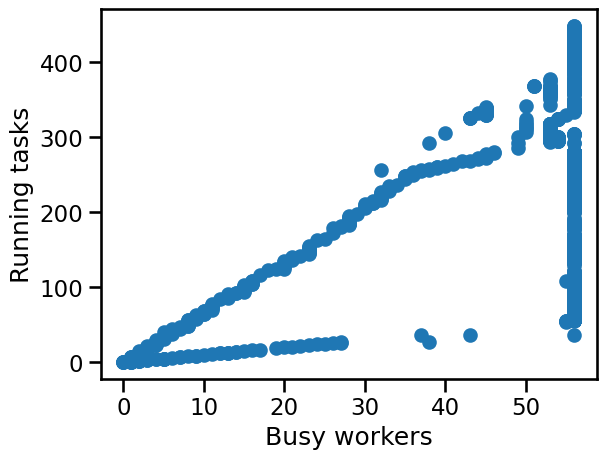

In [432]:
plt.scatter(performance_t.workers_busy, performance_t.tasks_running)
plt.xlabel('Busy workers')
plt.ylabel('Running tasks')

In [433]:
#col = performance_t.columns.get_loc('tasks_done')
#performance_t.insert(col+1, 'tasks_remaining', np.nan)
performance_t.loc[:, ('tasks_remaining')] = performance_t.tasks_done.max() - performance_t.loc[:, ('tasks_done')]

In [434]:
tasks_t


,READY,last_state,last_state_time,task_id,attempt_number,category,requested_cores,requested_memory,requested_disk,requested_gpus,library,RUNNING,worker_id,allocated_cores,allocated_memory,allocated_disk,allocated_gpus,time_input_mgr,time_output_mgr,size_input_mgr,size_output_mgr,time_worker_start,time_worker_end,time_commit_start,time_commit_end,DISCONNECTION,WAITING_RETRIEVAL,RETRIEVED,reason,exit_code,measured_cores,measured_memory,measured_disk,measured_gpus,DONE,measured_wall_time,slot
0,0.005700,DONE,67.987573,1,1,preprocessing,1.0,NaN,NaN,NaN,NaN,53.271556,worker-b0ca8e68177bdcc742b07015c44114fa,1.0,4100.0,12251.0,0.0,0.000288,0.000908,0.000288,0.000360,66.193147,67.796102,53.271247,53.271535,NaN,67.817460,67.818507,SUCCESS,0.0,1.0,4100.0,12251.0,0.0,67.987573,1.602955,2
1,0.006534,DONE,88.080235,2,1,preprocessing,1.0,NaN,NaN,NaN,NaN,66.134668,worker-607fe708b6964974116d02c0b5794435,1.0,4250.0,12500.0,0.0,0.000285,0.000586,0.000292,0.000360,84.795723,88.082357,66.134361,66.134646,NaN,88.079452,88.080175,SUCCESS,0.0,1.0,4250.0,12500.0,0.0,88.080235,3.286634,2
2,0.007274,DONE,66.967379,3,1,preprocessing,1.0,NaN,NaN,NaN,NaN,52.201506,worker-46fe76be6f60be63a100a4fb5a7204b0,1.0,4100.0,12251.0,0.0,0.000276,0.000338,0.000280,0.000357,62.324588,64.781038,52.201210,52.201486,NaN,65.997098,65.998735,SUCCESS,0.0,1.0,4100.0,12251.0,0.0,66.967379,2.456450,2
3,0.008030,DONE,77.898658,4,1,preprocessing,1.0,NaN,NaN,NaN,NaN,53.235405,worker-f3a2745697e285683758fca8864f58e6,1.0,4100.0,12251.0,0.0,0.000270,0.001407,0.000280,0.000357,75.795645,77.841474,53.235114,53.235384,NaN,77.853435,77.856200,SUCCESS,0.0,1.0,4100.0,12251.0,0.0,77.898658,2.045829,2
4,0.008778,DONE,75.853697,5,1,preprocessing,1.0,NaN,NaN,NaN,NaN,53.900462,worker-8887c9371ae8035892b7f466dd53202b,1.0,4100.0,12251.0,0.0,0.000292,0.001000,0.000288,0.000360,72.224258,75.846916,53.900148,53.900440,NaN,75.852495,75.853650,SUCCESS,0.0,1.0,4100.0,12251.0,0.0,75.853697,3.622658,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9637,2280.427140,DONE,2308.919401,9638,1,accumulating,1.0,28000.0,82000.0,0.0,NaN,2280.439478,worker-609babd4c80c7f973c0e9d6303ab09d4,6.0,28000.0,82000.0,0.0,0.000564,0.513248,0.000109,511.368867,2283.107142,2308.333152,2280.438881,2280.439445,NaN,2308.405834,2308.919294,SUCCESS,0.0,6.0,28000.0,82000.0,0.0,2308.919401,25.226010,1
9638,2296.237047,DONE,2351.715712,9639,1,accumulating,1.0,28250.0,82000.0,0.0,NaN,2296.256665,worker-1e782e5dd3bb8583d3068e69f8a2345a,6.0,28250.0,82000.0,0.0,0.000489,1.654187,0.000109,1257.380670,2297.153834,2340.614270,2296.256117,2296.256606,NaN,2348.507426,2351.715313,SUCCESS,0.0,6.0,28250.0,82000.0,0.0,2351.715712,43.460436,1
9639,2296.242664,DONE,2351.769973,9640,1,accumulating,1.0,28250.0,82000.0,0.0,NaN,2296.255104,worker-85ff591649de426dd839b090dd7bf8fa,6.0,28250.0,82000.0,0.0,0.000688,1.552575,0.000109,1382.441236,2300.189589,2342.475238,2296.254355,2296.255043,NaN,2348.507451,2350.060507,SUCCESS,0.0,6.0,28250.0,82000.0,0.0,2351.769973,42.285649,1
9640,2299.557876,DONE,2478.136253,9641,1,accumulating,1.0,28250.0,82000.0,0.0,NaN,2299.856600,worker-909cdc790b120a5b7d6d211af7e25996,6.0,28250.0,82000.0,0.0,0.000583,1.777575,0.000109,1696.030064,2326.428330,2476.344048,2299.855974,2299.856557,NaN,2476.350530,2478.128456,SUCCESS,0.0,6.0,28250.0,82000.0,0.0,2478.136253,149.915718,1


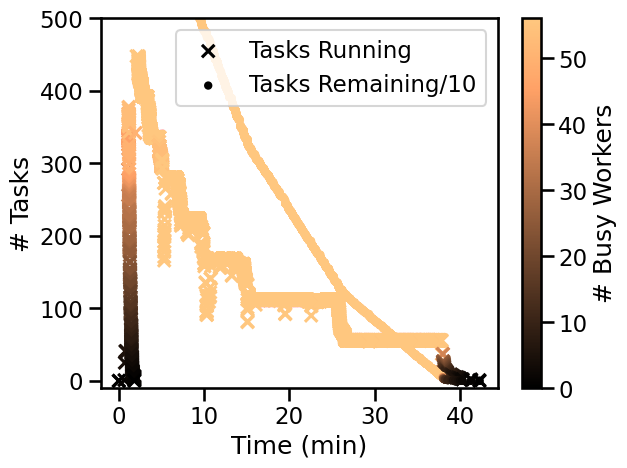

In [435]:
fig, ax = plt.subplots()
scatter = plt.scatter(performance_t.lifetime/6e7, performance_t.tasks_running, marker='x', c=performance_t.workers_busy, 
                      cmap='copper', label='Tasks Running')
scatter2 = plt.scatter(performance_t.lifetime/6e7, performance_t.tasks_remaining/10, marker='.', c=performance_t.workers_busy, 
                       cmap='copper', label='Tasks Remaining/10')
fig.colorbar(scatter, ax=ax, label='# Busy Workers')
#plt.semilogy(())
plt.ylim(-10,500)
plt.xlabel('Time (min)')
plt.ylabel('# Tasks')
plt.legend()

#overlay tasks remaining

Text(0, 0.5, '# Tasks Running')

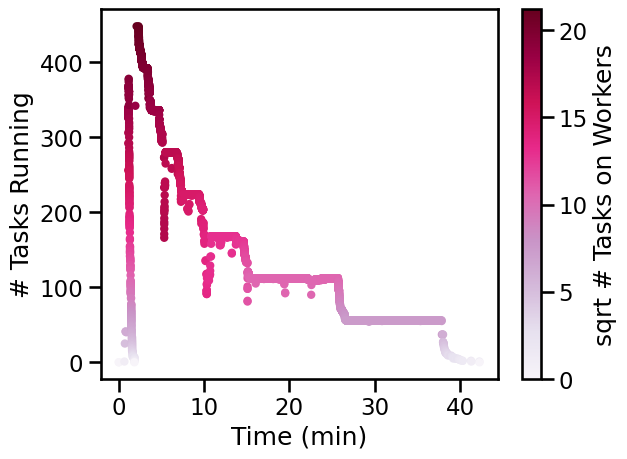

In [436]:
fig, ax = plt.subplots()
scatter = plt.scatter(performance_t.lifetime/6e7, performance_t.tasks_running, marker='.', c=np.sqrt(performance_t.tasks_on_workers), cmap='PuRd')
fig.colorbar(scatter, ax=ax, label='sqrt # Tasks on Workers')
plt.xlabel('Time (min)')
plt.ylabel('# Tasks Running')

Text(0, 0.5, '# Tasks Running')

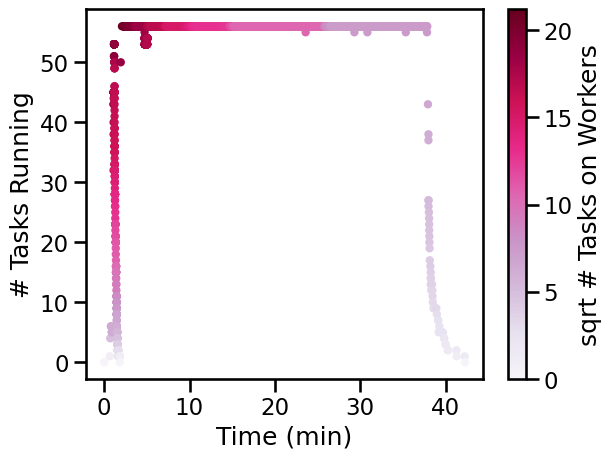

In [437]:
fig, ax = plt.subplots()
scatter = plt.scatter(performance_t.lifetime/6e7, performance_t.workers_busy, marker='.', c=np.sqrt(performance_t.tasks_on_workers), cmap='PuRd')
fig.colorbar(scatter, ax=ax, label='sqrt # Tasks on Workers')
plt.xlabel('Time (min)')
plt.ylabel('# Tasks Running')

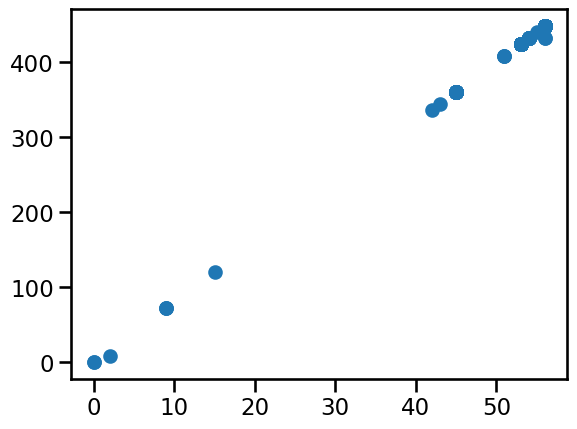

In [438]:
plt.scatter(performance_t.workers_connected, performance_t.total_cores)

Text(0, 0.5, 'Committed Memory (GB)')

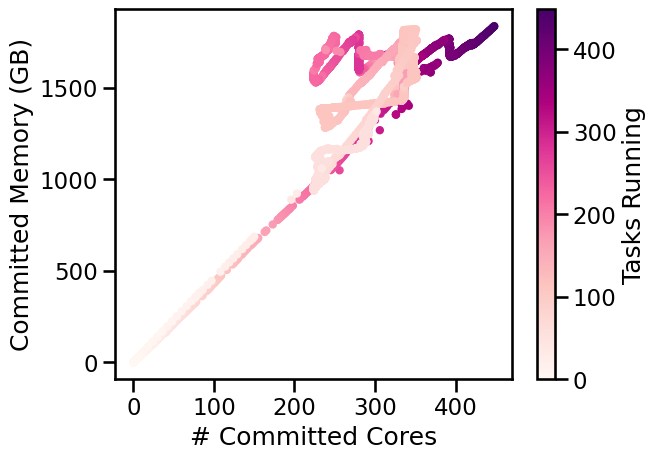

In [439]:
fig, ax = plt.subplots()
scatter = plt.scatter(performance_t.committed_cores, performance_t.committed_memory/1000, marker='.', c=performance_t.tasks_running, cmap='RdPu')
fig.colorbar(scatter, ax=ax, label='Tasks Running')
plt.xlabel('# Committed Cores')
plt.ylabel('Committed Memory (GB)')

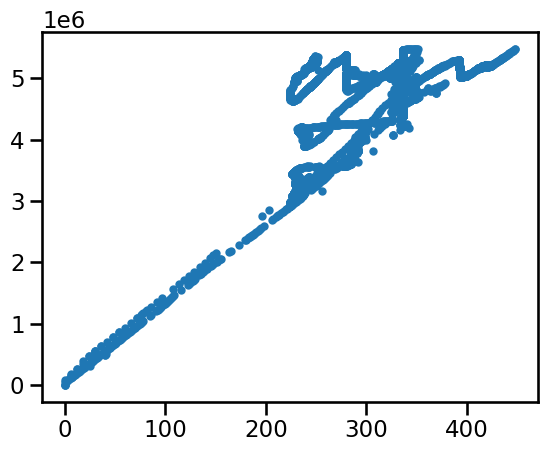

In [440]:
plt.scatter(performance_t.committed_cores, performance_t.committed_disk, marker='.')

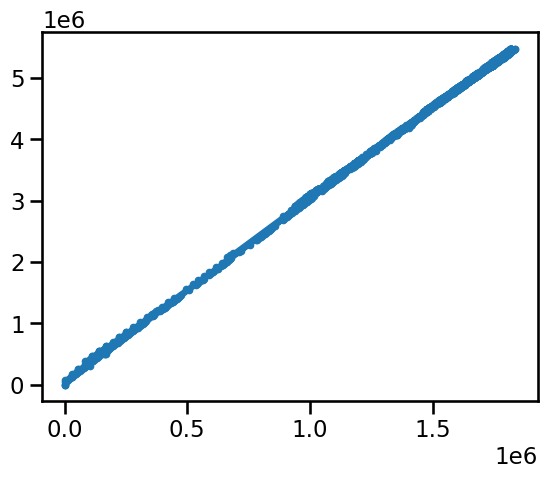

In [441]:
plt.plot(performance_t.committed_memory, performance_t.committed_disk, marker='.')

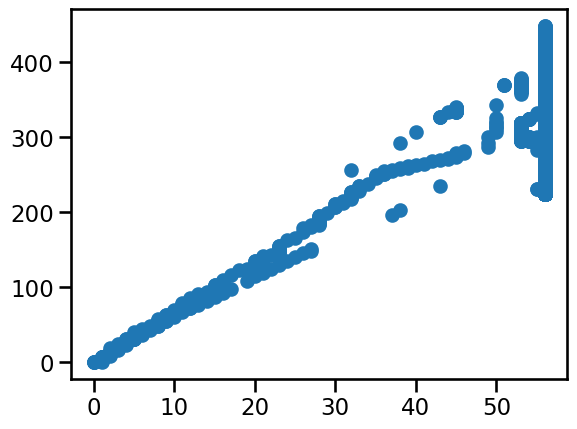

In [442]:
plt.scatter(performance_t.workers_busy, performance_t.committed_cores)

Text(0, 0.5, 'Tasks Running')

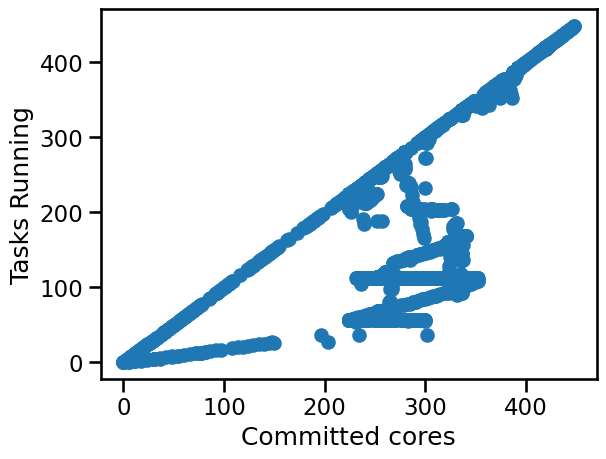

In [443]:
plt.scatter(performance_t.committed_cores, performance_t.tasks_running)
plt.xlabel('Committed cores')
plt.ylabel('Tasks Running')

Text(0, 0.5, 'GB sent by manager')

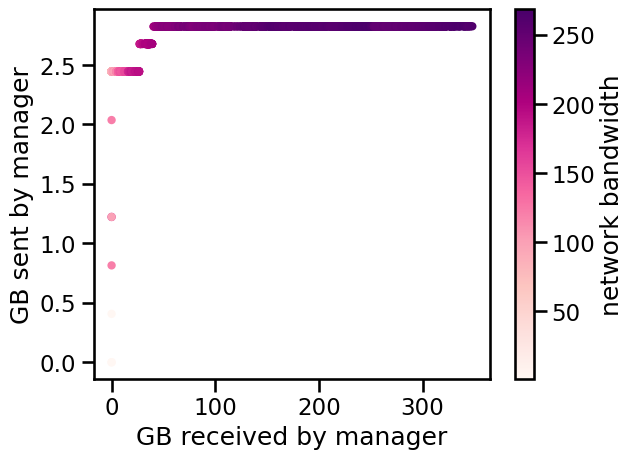

In [444]:
fig, ax = plt.subplots()
scatter = plt.scatter(performance_t.bytes_received/1e9, performance_t.bytes_sent/1e9, c=performance_t.bandwidth, cmap='RdPu', marker='.')
fig.colorbar(scatter, ax=ax, label='network bandwidth')
plt.xlabel('GB received by manager')
plt.ylabel('GB sent by manager')

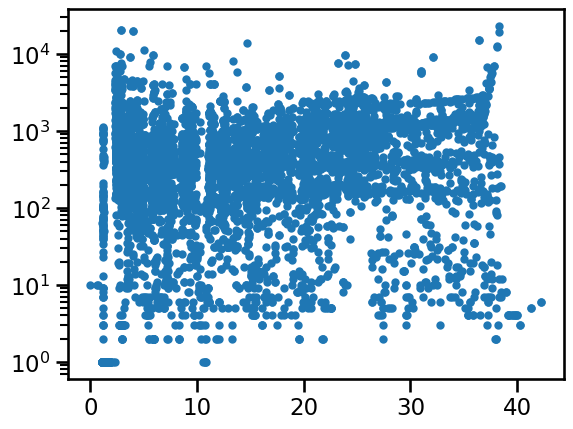

In [445]:
plt.scatter(performance_t.lifetime/6e7, performance_t.capacity_instantaneous, marker='.')
plt.semilogy(())

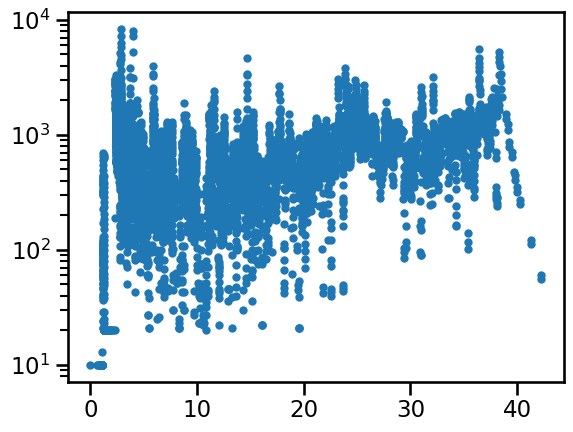

In [446]:
plt.scatter(performance_t.lifetime/6e7, performance_t.capacity_weighted, marker='.')
plt.semilogy(())

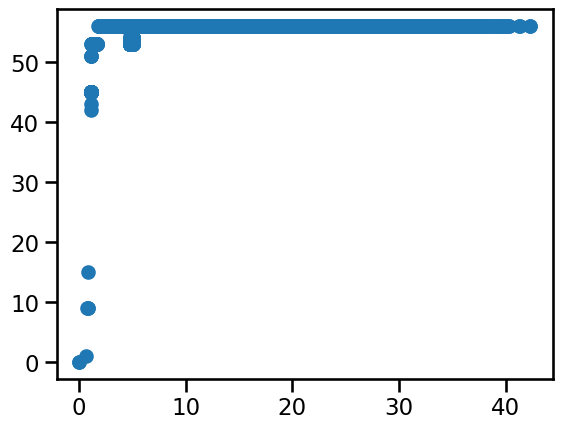

In [447]:
plt.scatter(performance_t.lifetime/6e7, performance_t.workers_able)

## Run 2025/07/07 194309

### Description

* 8 core workers, 16GB disk/worker
* all datasets
* ndcctools 7.15.5
* worker transfers on
* chunksize = 10k
* diabolical 18h run, did not finish

In [448]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-07T194309')

In [449]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-07T194309')

In [450]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 150
total workers active time = 719.2060033003489 mins, 11.986766721672481 hours
Mean worker connection time = 107.93354441385799 mins, 1.798892406897633 hours
# tasks on this run = 9144


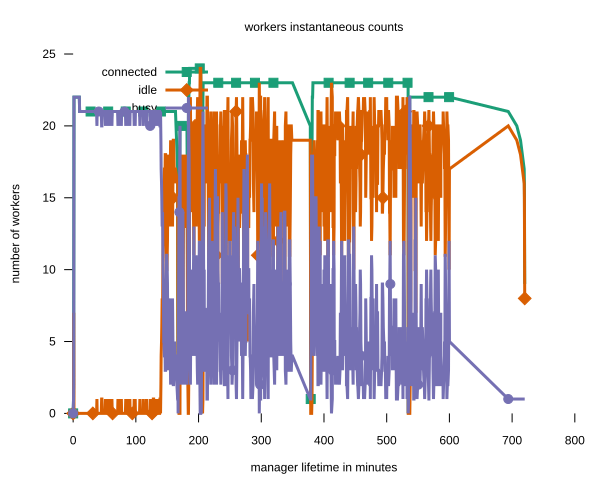

In [451]:
worker_svg

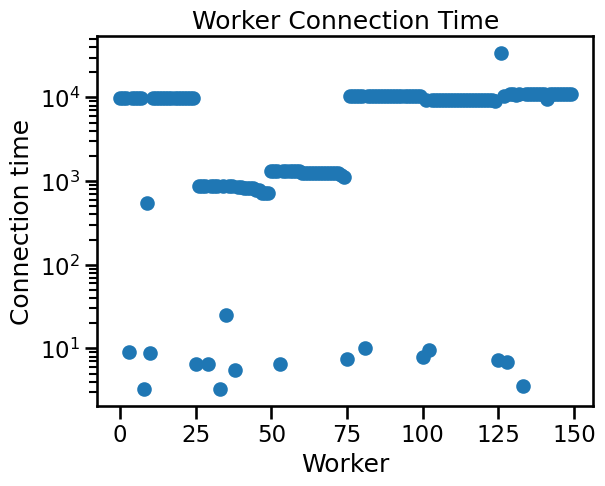

In [452]:
worker_conn_time = plot_worker_times(workers_t)

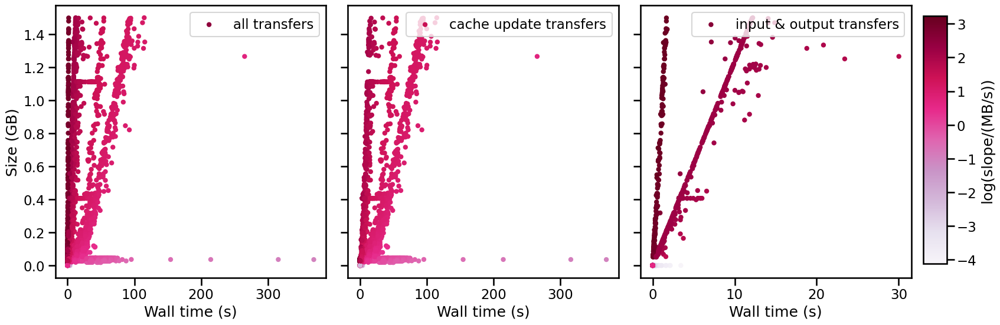

In [453]:
transfer_time_plot = transfer_time(transfers_t)

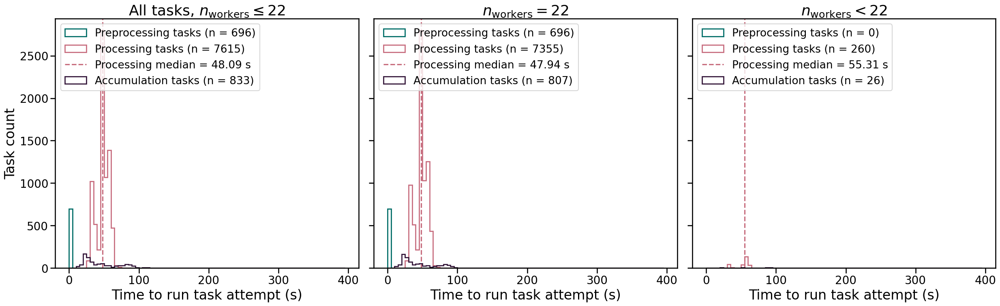

In [454]:
task_time_hist = task_hist(tasks_t, performance_t, bin_min=0, bin_max=400, bin_step=5)

## Run 2025/07/07 142503

### Description:
* 8 core workers, 8GB disk/worker
* all datasets
* ndcctools 7.15.5
* worker transfers on
* chunksize = 10k
* did not finish, had to resubmit

In [455]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-07T142503')

In [456]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-07T142503')

In [457]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 100
total workers active time = 312.7417259335518 mins, 5.212362098892529 hours
Mean worker connection time = 74.45940399769941 mins, 1.2409900666283236 hours
# tasks on this run = 7614


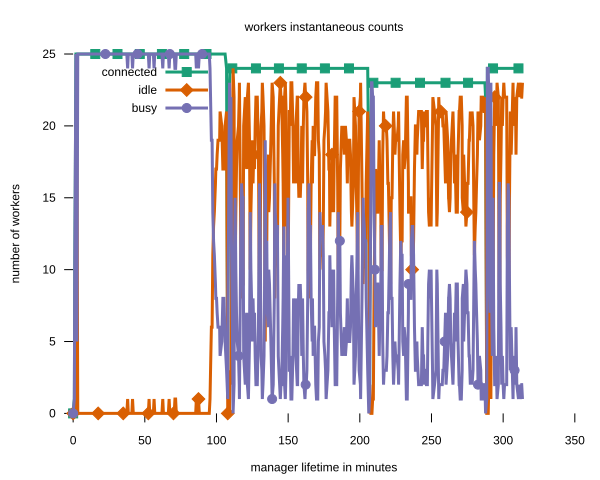

In [458]:
worker_svg

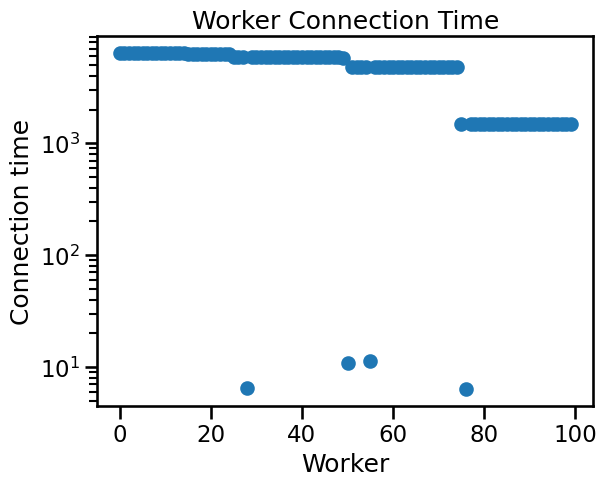

In [459]:
worker_conn_time = plot_worker_times(workers_t)

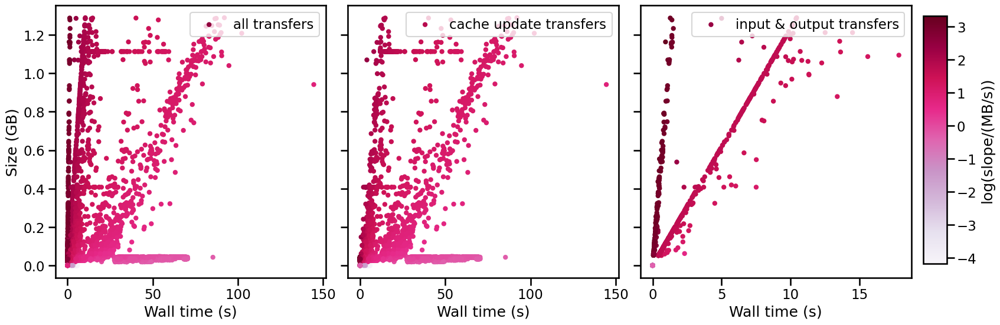

In [460]:
transfer_time_plot = transfer_time(transfers_t)

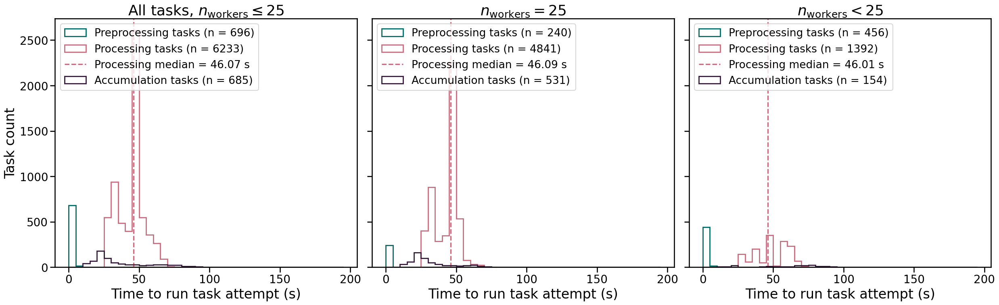

In [461]:
task_time_hist = task_hist(tasks_t, performance_t, bin_min=0, bin_max=200, bin_step=5)

## Run 2025/07/03 160434 (double check)

### Description

* 8 core workers, 8GB disk/worker
* all datasets
* ndcctools 7.15.5
* worker transfers on
* chunksize = 10k
* i don't think this run finished

In [462]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-03T160434')

In [463]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-03T160434')

In [464]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 50
total workers active time = 328.1500045021375 mins, 5.469166741702292 hours
Mean worker connection time = 148.7133956475258 mins, 2.47855659412543 hours
# tasks on this run = 6352


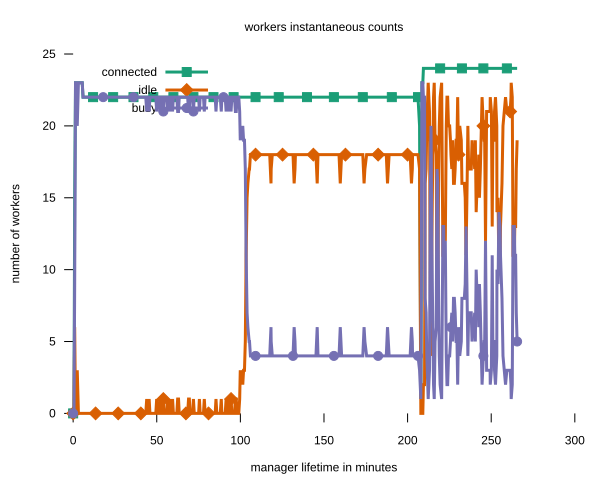

In [465]:
worker_svg

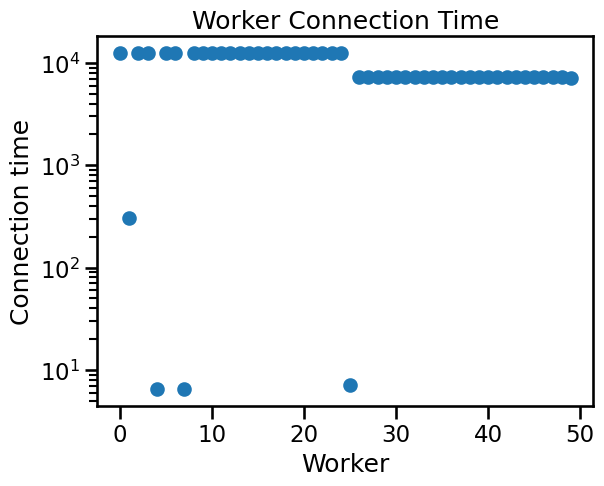

In [466]:
worker_conn_time = plot_worker_times(workers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


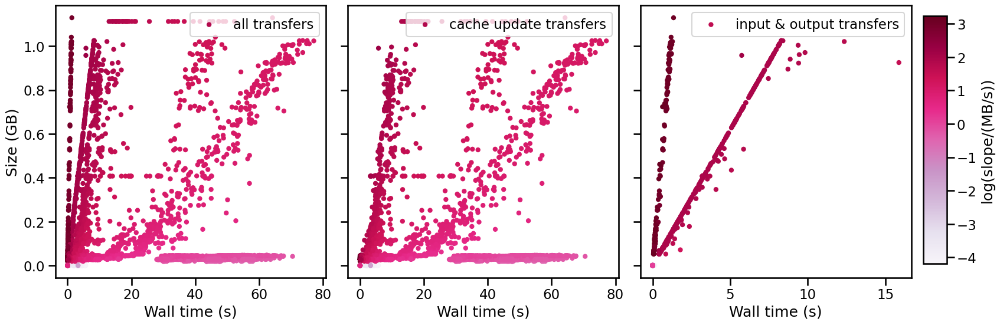

In [467]:
transfer_time_plot = transfer_time(transfers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


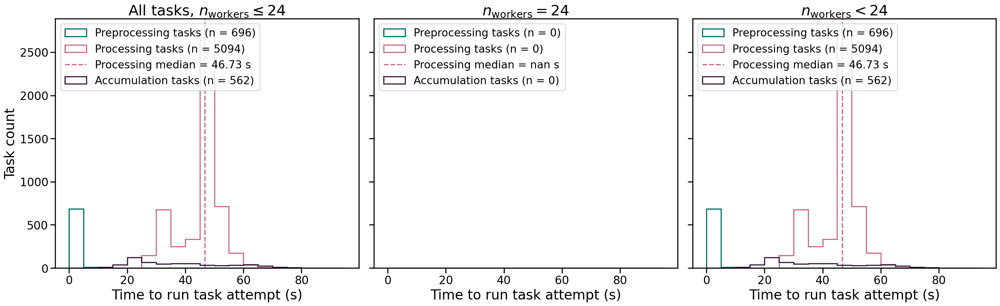

In [468]:
task_time_hist = task_hist(tasks_t, performance_t, bin_min=0, bin_max=100, bin_step=5)

## Run 2025/07/03 033939

### Description

* 8 core workers, 8GB disk/worker
* all datasets
* ndcctools 7.15.5
* worker transfers on
* chunksize = 10k
* i wrote down that this was a bad run?

In [469]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-03T033939')

In [470]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-03T033939')

In [471]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 25
total workers active time = 390.5376519362132 mins, 6.508960865603553 hours
Mean worker connection time = 383.3554621969859 mins, 6.389257703283098 hours
# tasks on this run = 6801


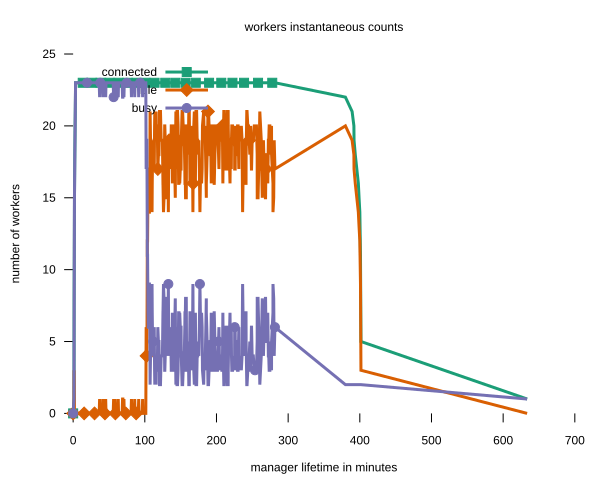

In [472]:
worker_svg

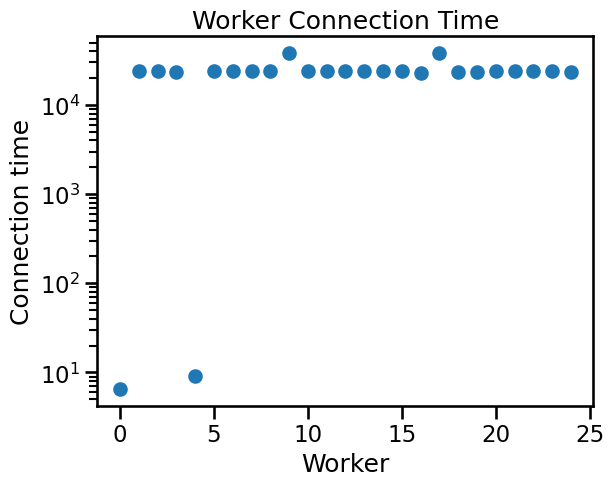

In [473]:
worker_conn_time = plot_worker_times(workers_t)

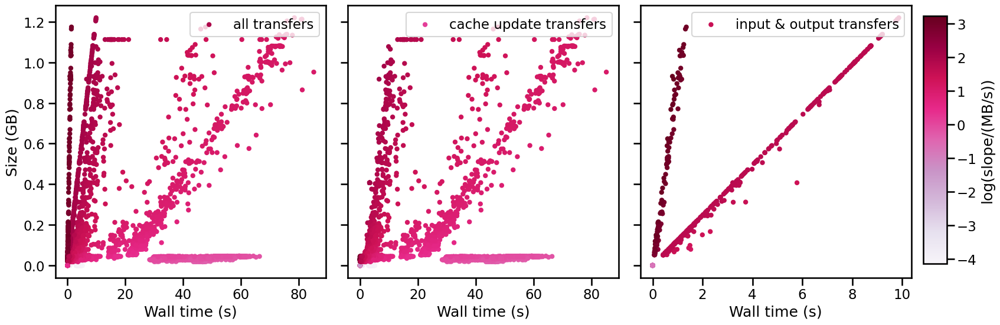

In [474]:
transfer_time_plot = transfer_time(transfers_t)

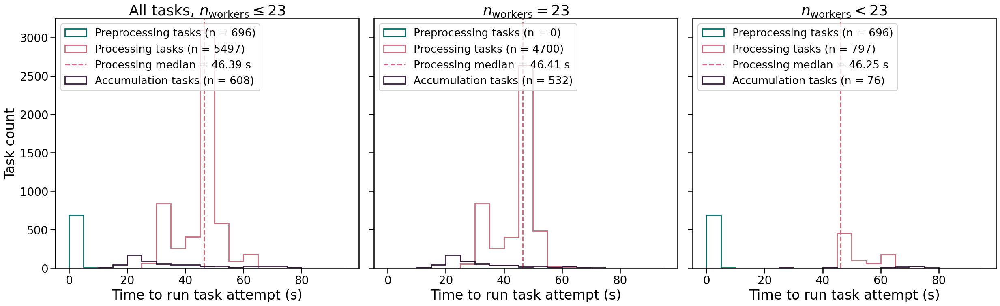

In [475]:
task_time_hist = task_hist(tasks_t, performance_t, bin_min=0, bin_max=100, bin_step=5)

## Run 2025/07/03 024942

### Description

* 8 core workers, 8GB disk/worker
* all datasets
* ndcctools 7.15.5
* worker transfers on
* chunksize = 10k

In [476]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-03T024942')

In [477]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-03T024942')

In [478]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 138
total workers active time = 45.62577561934789 mins, 0.7604295936557982 hours
Mean worker connection time = 21.515543656879 mins, 0.3585923942813167 hours
# tasks on this run = 9645


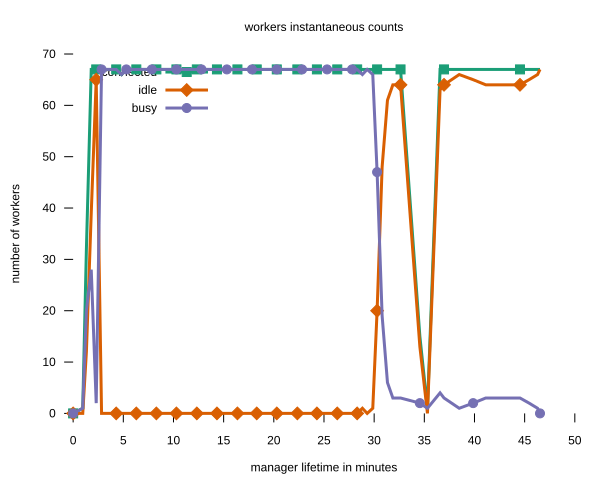

In [479]:
worker_svg

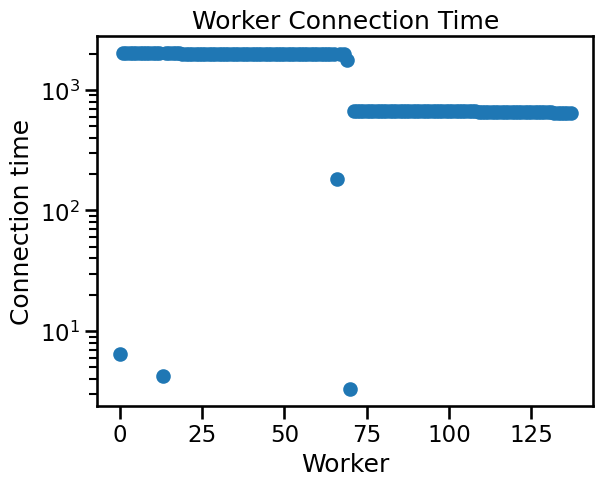

In [480]:
worker_conn_time = plot_worker_times(workers_t)

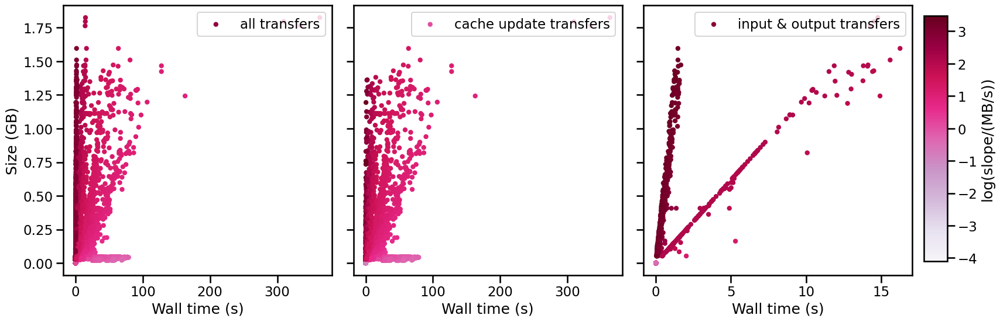

In [481]:
transfer_time_plot = transfer_time(transfers_t)

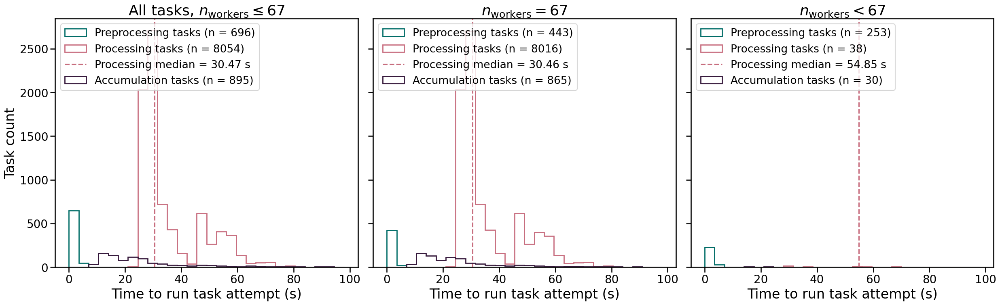

In [482]:
task_time_hist = task_hist(tasks_t, performance_t, bin_min=0, bin_max=100, bin_step=3.5)

## Run 2025/07/02 172516

### Run description

* 8 core workers, 8GB disk/worker
* all datasets
* ndcctools 7.15.5
* worker transfers on
* chunksize = 10k

In [483]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-02T172516')

In [484]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-02T172516')

In [485]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 54
total workers active time = 108.3060870329539 mins, 1.8051014505492315 hours
Mean worker connection time = 89.66281338908054 mins, 1.4943802231513423 hours
# tasks on this run = 9646


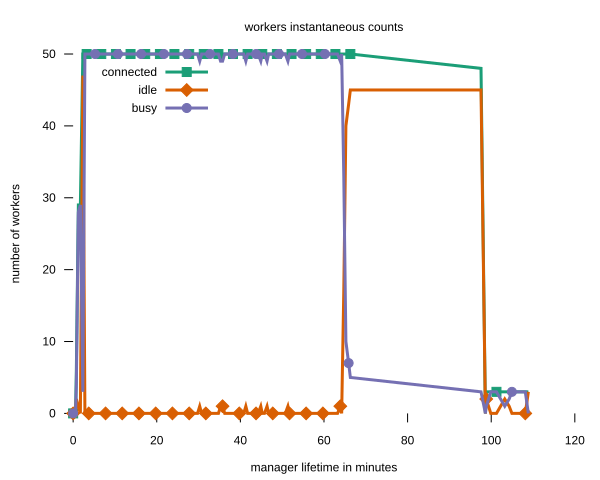

In [486]:
worker_svg

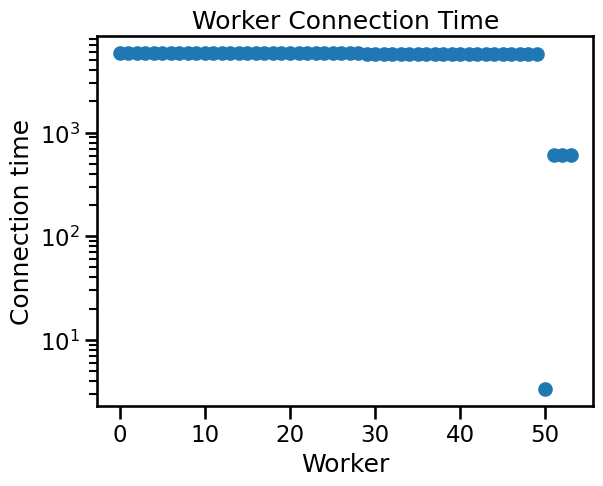

In [487]:
worker_conn_time = plot_worker_times(workers_t)

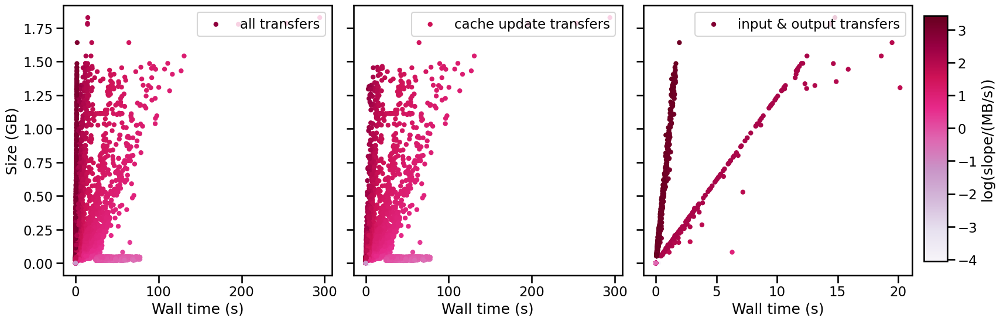

In [488]:
transfer_time_plot = transfer_time(transfers_t)

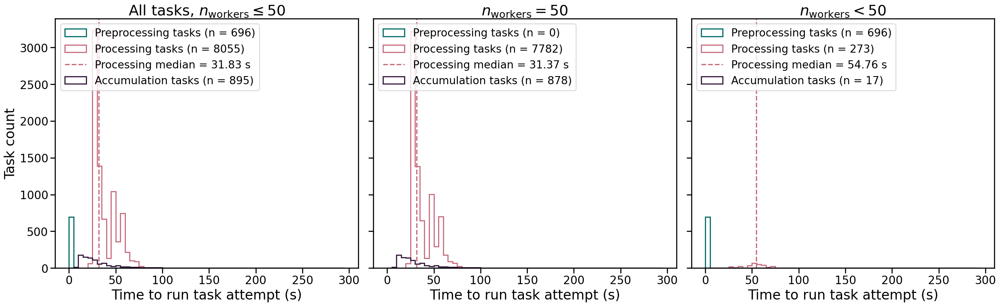

In [489]:
task_time_hist = task_hist(tasks_t, performance_t, bin_min=0, bin_max=300, bin_step=5)

## Run 2025/07/02 171525

### Description

* 8 core workers, 8GB disk/worker
* 3 datasets
* ndcctools 7.15.5
* worker transfers on
* chunksize = 10k

In [490]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-02T171525')

In [491]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-02T171525')

In [492]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 50
total workers active time = 4.976222030321757 mins, 0.08293703383869595 hours
Mean worker connection time = 4.098846005042394 mins, 0.0683141000840399 hours
# tasks on this run = 1486


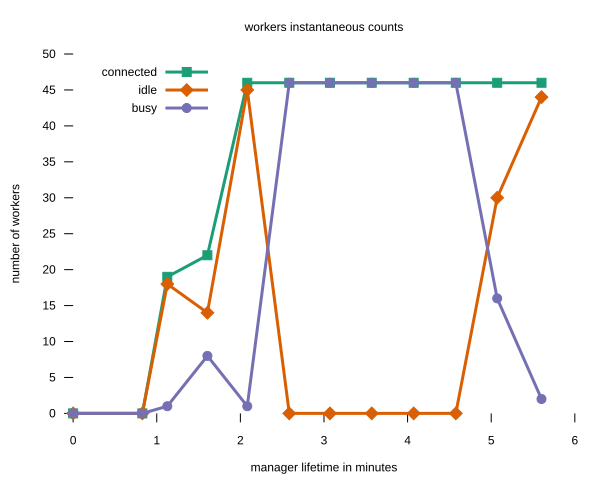

In [493]:
worker_svg

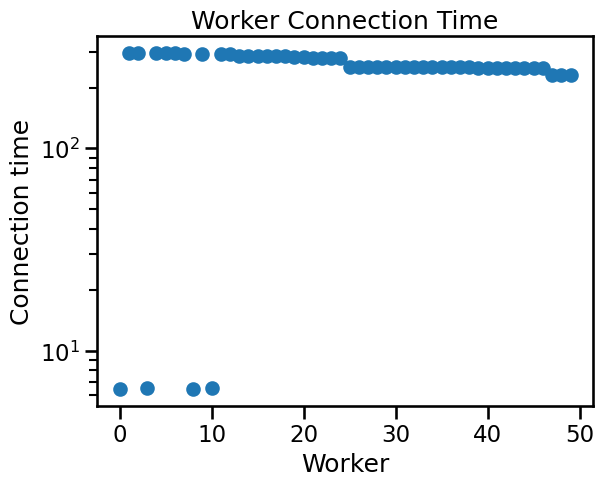

In [494]:
worker_conn_time = plot_worker_times(workers_t)

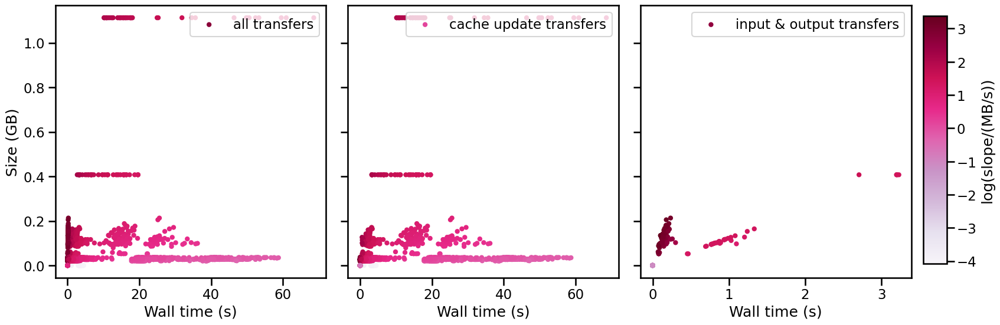

In [495]:
transfer_time_plot = transfer_time(transfers_t)

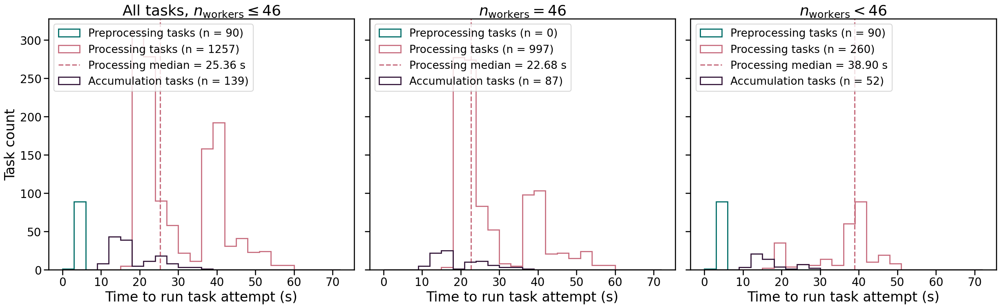

In [496]:
task_time_hist = task_hist(tasks_t, performance_t, bin_min=0, bin_max=75, bin_step=3)

## Run 2025/07/02 170357

### Description

* 8 core workers, 8GB disk/worker
* 2 datasets
* ndcctools 7.15.5
* worker transfers on
* chunksize = 10k

In [497]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-02T170357')

In [498]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-02T170357')

In [499]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 50
total workers active time = 4.0617666681607565 mins, 0.06769611113601261 hours
Mean worker connection time = 3.553363635460536 mins, 0.0592227272576756 hours
# tasks on this run = 1150


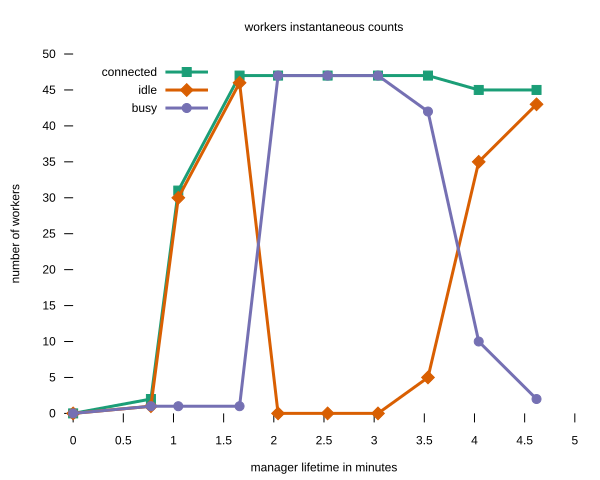

In [500]:
worker_svg

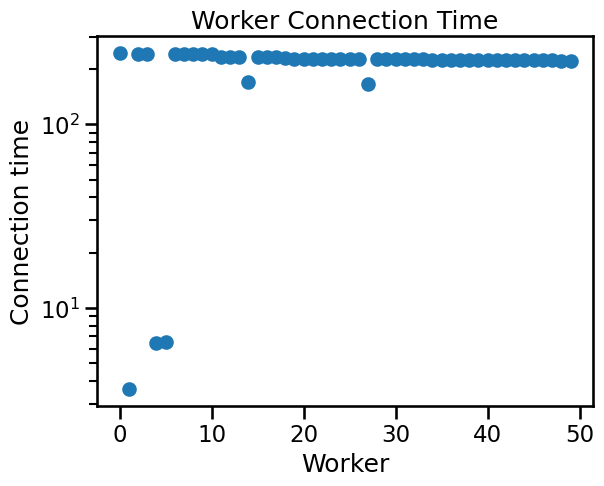

In [501]:
worker_conn_time = plot_worker_times(workers_t)

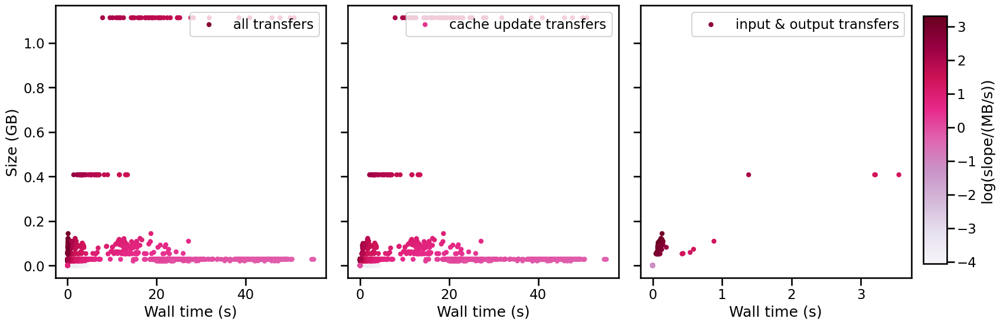

In [502]:
transfer_time_plot = transfer_time(transfers_t)

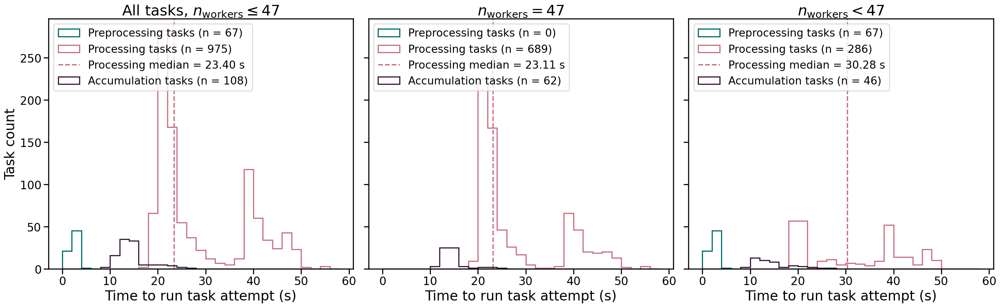

In [503]:
task_time_hist = task_hist(tasks_t, performance_t, bin_min=0, bin_max=60, bin_step=2)

## Run 2025/07/01 182524

### Description

* 1 core worker
* 2 datasets
* ndcctools 7.15.3
* worker transfers off
* chunksize = 100k

In [504]:
workers, accum_tasks, task_cap, tasks, time_man, time_work, time_stack, transfer, work_accum, work_disk, worker_svg = plots('2025-07-01T182524')

In [505]:
tasks_t, transfers_t, workers_t, performance_t = tables('2025-07-01T182524')

In [506]:
print_properties(tasks_t, transfers_t, workers_t, performance_t)

Workers on this run = 101
total workers active time = 17.436186985174814 mins, 0.29060311641958025 hours
Mean worker connection time = 12.747187708352659 mins, 0.2124531284725443 hours
# tasks on this run = 195


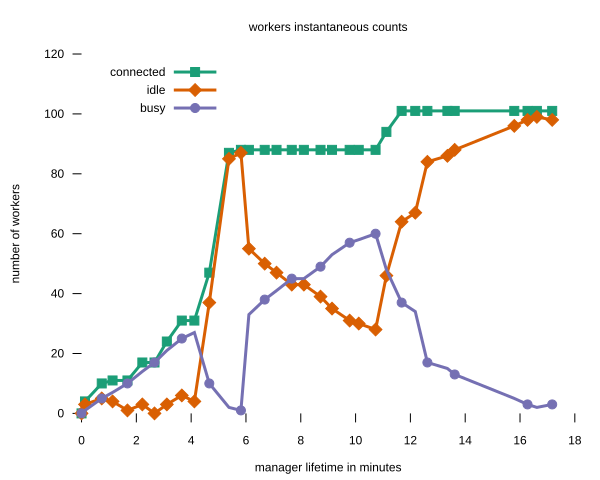

In [507]:
worker_svg

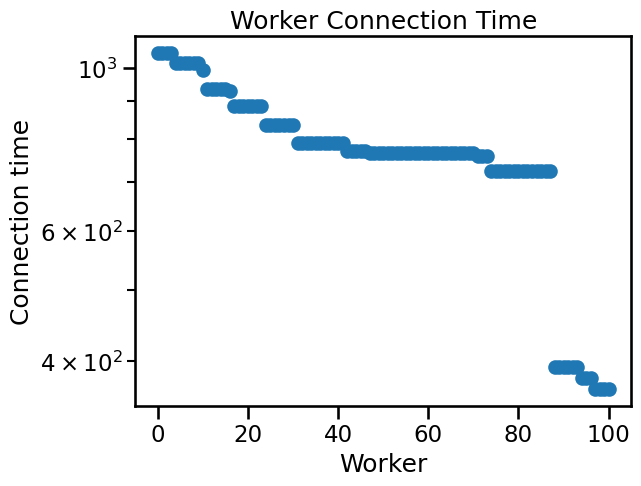

In [508]:
worker_conn_time = plot_worker_times(workers_t)

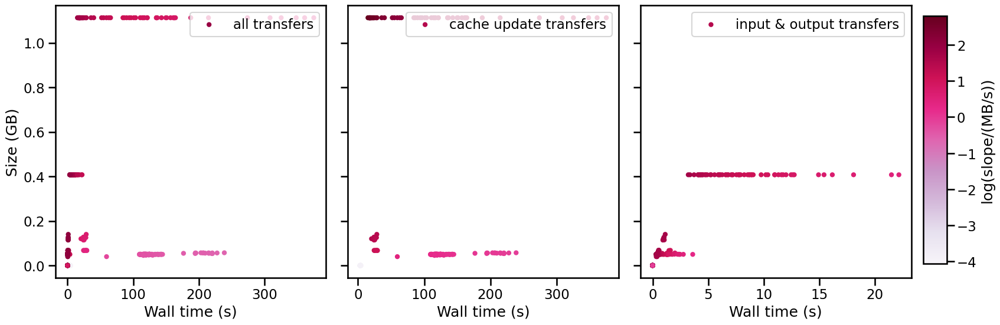

In [509]:
transfer_time_plot = transfer_time(transfers_t)

/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/cms-jovyan/coffea-v07-env/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


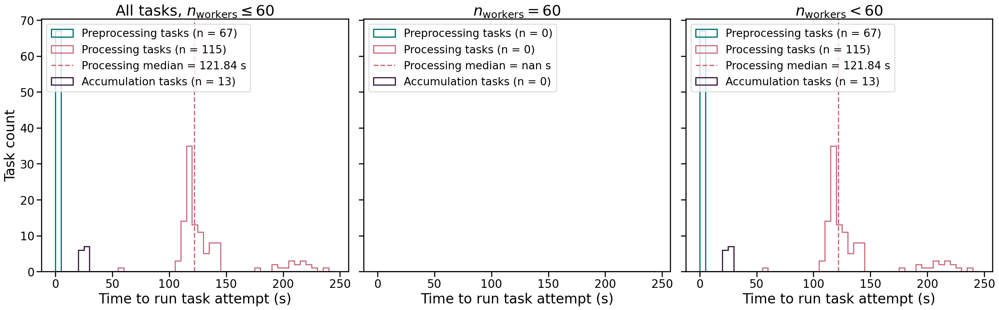

In [510]:
task_time_hist = task_hist(tasks_t, performance_t, bin_min=0, bin_max=250, bin_step=5)